
# Prediction model

Purpose is to define and test a prediction model.  
As data analysis shows that outgoing is quite linear versus time, we propose tu use a basic linear model for prediction.  
Two approaches will be evaluated:
 1. Fit a linear model based on studied account only, with 2 variants:
    1. Based on last 6 months outgoing
    2. Based on last 6 months outgoing & income: as data analysis show that balances are quite stable versus time, for most accounts, we could expect that outgoing and income are equal over the considered period (6 months of history + 1 next month to predict) 
 2. Fit a linear model based on a large sample of accounts
  
  
> Intuitively, first approach (fit linear model based on studied account only) seems better, as we deal with human behavior (each person has a specific economic context) without any information to categorize users (profession, ...)... Moreover, data analysis didn't reveal evident trend between all accounts.  
>We'll see if this intuition is good or not!



In [1]:
import pandas as pd
import numpy as np
%matplotlib inline
import matplotlib.pyplot as plt
import Account_synthesis as Acc
from sklearn import linear_model as lin_mdl
from sklearn import metrics
from sklearn.model_selection import train_test_split

In [2]:
accounts = pd.read_csv("data/accounts.csv")
accounts.loc[:,'update_date'] = pd.to_datetime(accounts.update_date,format="%Y-%m-%d")
transactions = pd.read_csv("data/transactions.csv")
transactions.loc[:,'date'] = pd.to_datetime(transactions.date,format="%Y-%m-%d")

***   
## Linear model based on studied account
  

In [3]:
my_id=1
my_account=accounts[accounts.id==my_id]
my_transactions=transactions[transactions.account_id==my_id]

my_account_synthesis=Acc.Account_synthesis(my_account,my_transactions)
my_account_synthesis.get_last_6_month(my_account_synthesis.update_date-np.timedelta64(30,'D'))
print(my_account_synthesis)

Account synthesis:
  @ Update date (2021-07-02): 12.91€ - 235 days of history
  @ Analysis date (2021-06-02): 205 days of history


In [4]:
my_account_synthesis.last_6_month

,income_cumsum,outgoing_cumsum,balance,monthly_income,monthly_outgoing
date,,,,,
2021-01-03,6636.49,6636.40,-911.760000,5846.49,5889.08
2021-02-02,11456.89,11444.45,18.836667,4820.40,4808.05
2021-03-04,17849.22,17847.69,-34.256154,6392.33,6403.24
2021-04-03,21749.22,21654.03,751.291429,3900.00,3806.34
2021-05-03,23914.22,23819.84,372.058000,2165.00,2165.81
2021-06-02,29910.22,29819.84,354.428824,5996.00,6000.00


In [5]:
my_account_synthesis.next_monthly_outgoing

date
2021-07-02    1644.5
Freq: 30D, Name: monthly_outgoing, dtype: float64

### Variant 1: based on last 6 month outgoing  
  
Principle:
 1. Linear prediction of outgoing (with saturation to >=0 values)

In [6]:
mdl_1=lin_mdl.LinearRegression()

In [7]:
#Train set (last 6 months outgoing)
X_train=np.arange(1,7).reshape(-1,1) #6 months
Y_train=my_account_synthesis.last_6_month.monthly_outgoing.values.reshape(-1,1) #Associated monthly outgoing
#Test set (next monthly outgoing)
X_test=[[7]]
Y_test=my_account_synthesis.next_monthly_outgoing.values.reshape(-1,1)

In [8]:
mdl_1.fit(X_train,Y_train)

LinearRegression()

In [9]:
Y_predict=np.maximum(0,mdl_1.predict(X_test)) #Ensure >=0 prediction

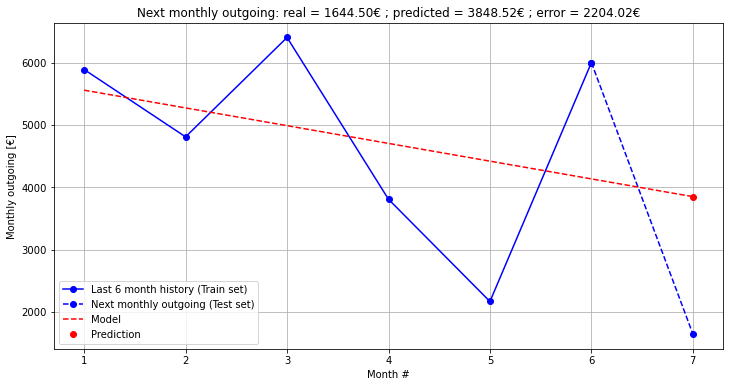

In [10]:
plt.figure(figsize=(12,6))
plt.plot(X_train,Y_train,'bo-',label='Last 6 month history (Train set)')
plt.plot(np.concatenate((X_train[-1],X_test[0])),np.concatenate((Y_train[-1],Y_test[0])),'bo--',label='Next monthly outgoing (Test set)')
plt.plot(np.concatenate((X_train,X_test)),np.maximum(0,mdl_1.predict(np.concatenate((X_train,X_test)))),'r--',label='Model')
plt.plot(X_test,Y_predict,'ro',label='Prediction')
plt.legend()
plt.xlabel('Month #')
plt.ylabel('Monthly outgoing [€]')
plt.grid()
plt.title("Next monthly outgoing: real = {:.2f}€ ; predicted = {:.2f}€ ; error = {:.2f}€".format(Y_test[0,0],Y_predict[0,0],Y_predict[0,0]-Y_test[0,0]))
plt.show()

  
#### Call prediction function with ```predict_next_monthly_outgoing``` method of class ```Account_synthesis```  
  

In [11]:
my_account_synthesis.predict_next_monthly_outgoing("Linear model based on studied account ; Extrapolate outgoing")

3848.518

### Variant 2: based on last 6 month outgoing & income

Principle: 2 steps:
 1. Linear prediction of income (with saturation to >=0 values)
 3. Prediction of outgoing such as cumulated outgoing and income (on the 6 months of history + next month prediction) are equal

In [12]:
mdl_2=lin_mdl.LinearRegression() #Linear model for income

In [13]:
#Train set (last 6 months)
X_train=np.arange(1,7).reshape(-1,1) #6 months
Y_train_income=my_account_synthesis.last_6_month.monthly_income.values.reshape(-1,1) #Associated monthly income
Y_train_outgoing=my_account_synthesis.last_6_month.monthly_outgoing.values.reshape(-1,1) #Associated monthly outgoing
#Test set (next monthly outgoing)
X_test=[[7]] #7th month
Y_test_outgoing=my_account_synthesis.next_monthly_outgoing.values.reshape(-1,1) #Next monthly outgoing

In [14]:
mdl_2.fit(X_train,Y_train_income) #Fit income model
Y_predict_income = np.maximum(0,mdl_2.predict(X_test)) #Predict next monthly income, and ensure >=0 prediction
Y_predict_outgoing = np.maximum(0,np.sum(Y_train_income)+Y_predict_income[0,0]-np.sum(Y_train_outgoing)) #Predict next monthly outgoing

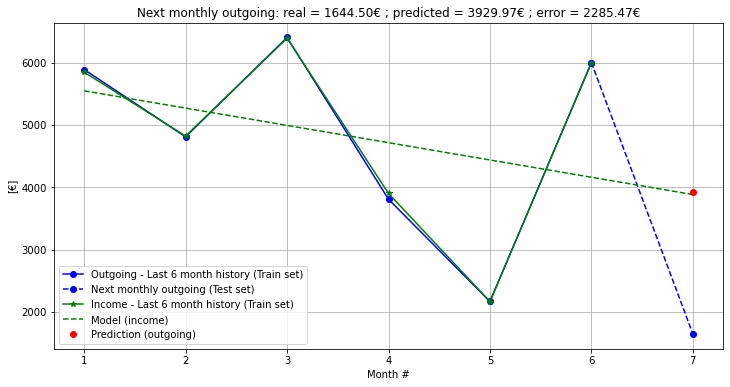

In [15]:
plt.figure(figsize=(12,6))
plt.plot(X_train,Y_train_outgoing,'bo-',label='Outgoing - Last 6 month history (Train set)')
plt.plot(np.concatenate((X_train[-1],X_test[0])),np.concatenate((Y_train_outgoing[-1],Y_test_outgoing[0])),'bo--',label='Next monthly outgoing (Test set)')
plt.plot(X_train,Y_train_income,'g*-',label='Income - Last 6 month history (Train set)')
plt.plot(np.concatenate((X_train,X_test)),np.maximum(0,mdl_2.predict(np.concatenate((X_train,X_test)))),'g--',label='Model (income)')
plt.plot(X_test,Y_predict_outgoing,'ro',label='Prediction (outgoing)')
plt.legend()
plt.xlabel('Month #')
plt.ylabel('[€]')
plt.grid()
plt.title("Next monthly outgoing: real = {:.2f}€ ; predicted = {:.2f}€ ; error = {:.2f}€".format(Y_test_outgoing[0,0],Y_predict_outgoing,Y_predict_outgoing-Y_test_outgoing[0,0]))
plt.show()

  
#### Call prediction function with ```predict_next_monthly_outgoing``` method of class ```Account_synthesis```  
  

In [16]:
my_account_synthesis.predict_next_monthly_outgoing("Linear model based on studied account ; Extrapolate income and ensure stable balance")

3929.971999999998

***   
## Linear model based on a large sample of accounts
  
We will build a linear model based on 12 variables (6 last months outgoing, 6 last months income)  
  
  
First, we build the data (12 variables (X), and next monthly outgoing (Y) to predict), based on all accounts, at all analysis date (where history length is sufficient to have 6 months of history at analysis date, and next month history to have real next month outgoing, which will be compared to predicted value)

In [17]:
#Initialisation
X=np.array([]) #Matrix where 1 row = 12 columns (6 last months outgoing, 6 last months income)
Y=np.array([]) #Real values of next monthly outgoing

#Loop on accounts
for my_id in range(len(accounts.index)):
    print("Account #{}".format(my_id))
    #Account info
    my_account=accounts[accounts.id==my_id]
    #Transactions history
    my_transactions=transactions[transactions.account_id==my_id]
    
    #Account synthesis
    my_account_synthesis=Acc.Account_synthesis(my_account,my_transactions)
    #Get real next monthly outgoing, for all possible analysis date
    X_analysis_date, Y_next_monthly_outgoing = my_account_synthesis.monthly_outgoing_to_predict()
    
    if not(X_analysis_date is None):
        #Loop on analysis date
        Y_mdl_1=np.array([]) #Predicted values, model n°1
        Y_mdl_2=np.array([]) #Predicted values, model n°2
        Y_mdl_3=np.array([]) #Predicted values, model n°3
        for analysis_date in X_analysis_date:
            my_account_synthesis.get_last_6_month(analysis_date)
            if X.size==0:
                X=np.hstack((my_account_synthesis.last_6_month.monthly_outgoing.values,my_account_synthesis.last_6_month.monthly_income.values))
            else:          
                X=np.vstack((X,np.hstack((my_account_synthesis.last_6_month.monthly_outgoing.values,my_account_synthesis.last_6_month.monthly_income.values))))
        
        Y=np.hstack((Y,Y_next_monthly_outgoing))

Account #0
Account #1
Account #2
No sufficient history for validation of prediction model
Account #3
No sufficient history for validation of prediction model
Account #4
Account #5
No sufficient history for validation of prediction model
Account #6
No sufficient history for validation of prediction model
Account #7
Account #8
Account #9
No sufficient history for validation of prediction model
Account #10
Account #11
No sufficient history for validation of prediction model
Account #12
Account #13
No sufficient history for validation of prediction model
Account #14
No sufficient history for validation of prediction model
Account #15
Account #16
Account #17
Account #18
Account #19
Account #20
No sufficient history for validation of prediction model
Account #21
No sufficient history for validation of prediction model
Account #22
No sufficient history for validation of prediction model
Account #23
Account #24
Account #25
Account #26
Account #27
Account #28
Account #29
Account #30
No sufficie

Account #218
Account #219
No sufficient history for validation of prediction model
Account #220
No sufficient history for validation of prediction model
Account #221
Account #222
Account #223
Account #224
Account #225
Account #226
No sufficient history for validation of prediction model
Account #227
Account #228
Account #229
No sufficient history for validation of prediction model
Account #230
Account #231
Account #232
Account #233
Account #234
No sufficient history for validation of prediction model
Account #235
Account #236
Account #237
No sufficient history for validation of prediction model
Account #238
No sufficient history for validation of prediction model
Account #239
No sufficient history for validation of prediction model
Account #240
Account #241
Account #242
No sufficient history for validation of prediction model
Account #243
Account #244
No sufficient history for validation of prediction model
Account #245
Account #246
No sufficient history for validation of prediction mo

Account #437
Account #438
No sufficient history for validation of prediction model
Account #439
Account #440
Account #441
No sufficient history for validation of prediction model
Account #442
No sufficient history for validation of prediction model
Account #443
No sufficient history for validation of prediction model
Account #444
Account #445
Account #446
Account #447
Account #448
Account #449
No sufficient history for validation of prediction model
Account #450
No sufficient history for validation of prediction model
Account #451
Account #452
Account #453
Account #454
Account #455
No sufficient history for validation of prediction model
Account #456
No sufficient history for validation of prediction model
Account #457
Account #458
Account #459
Account #460
No sufficient history for validation of prediction model
Account #461
Account #462
Account #463
No sufficient history for validation of prediction model
Account #464
Account #465
No sufficient history for validation of prediction mo

Account #673
No sufficient history for validation of prediction model
Account #674
No sufficient history for validation of prediction model
Account #675
No sufficient history for validation of prediction model
Account #676
No sufficient history for validation of prediction model
Account #677
Account #678
Account #679
Account #680
No sufficient history for validation of prediction model
Account #681
Account #682
Account #683
Account #684
Account #685
Account #686
Account #687
No sufficient history for validation of prediction model
Account #688
Account #689
No sufficient history for validation of prediction model
Account #690
Account #691
Account #692
Account #693
Account #694
Account #695
Account #696
Account #697
Account #698
Account #699
No sufficient history for validation of prediction model
Account #700
Account #701
Account #702
Account #703
Account #704
Account #705
Account #706
Account #707
Account #708
Account #709
Account #710
Account #711
No sufficient history for validation 

Account #947
Account #948
No sufficient history for validation of prediction model
Account #949
No sufficient history for validation of prediction model
Account #950
No sufficient history for validation of prediction model
Account #951
Account #952
No sufficient history for validation of prediction model
Account #953
Account #954
Account #955
No sufficient history for validation of prediction model
Account #956
No sufficient history for validation of prediction model
Account #957
No sufficient history for validation of prediction model
Account #958
Account #959
No sufficient history for validation of prediction model
Account #960
Account #961
Account #962
Account #963
Account #964
Account #965
Account #966
Account #967
Account #968
Account #969
No sufficient history for validation of prediction model
Account #970
No sufficient history for validation of prediction model
Account #971
Account #972
Account #973
Account #974
No sufficient history for validation of prediction model
Account #

Account #1233
Account #1234
Account #1235
Account #1236
No sufficient history for validation of prediction model
Account #1237
Account #1238
Account #1239
No sufficient history for validation of prediction model
Account #1240
Account #1241
Account #1242
Account #1243
Account #1244
Account #1245
Account #1246
Account #1247
Account #1248
Account #1249
Account #1250
Account #1251
Account #1252
Account #1253


In [18]:
print("X shape:",X.shape,"Y shape:",Y.shape)

X shape: (224034, 12) Y shape: (224034,)


We split the data in 2 sets : train (80%) and test (20%)

In [19]:
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, random_state=0, train_size=0.8) #random_state is set to ensure repetitive split

In [20]:
print("X train shape:",X_train.shape,"X test shape:",X_test.shape)

X train shape: (179227, 12) X test shape: (44807, 12)


We build the linear model

In [21]:
mdl_3=lin_mdl.LinearRegression()

We fit the model

In [22]:
mdl_3.fit(X_train,Y_train)

LinearRegression()

We test the model on the test set

In [23]:
Y_predict = np.maximum(0,mdl_3.predict(X_test)) #Ensure >=0 prediction

Here is the R² score

In [24]:
metrics.r2_score(Y_test,Y_predict)

0.4594348104924164

> The prediction doesn't seem very good, as we sensed. But it will be interesting to compare it to the previous models

We save the model parameters in JSON format, to restore it later (we could use pickle, but we avoid it here for this simple case, because pickle is not secure)

In [25]:
import json
mdl_param={}
mdl_param['coef'] = list(mdl_3.coef_)
mdl_param['intercept'] = mdl_3.intercept_
json_txt = json.dumps(mdl_param)
f=open('mdl_3_param.txt','w')
f.write(json_txt)
f.close()

  
#### Call prediction function with ```predict_next_monthly_outgoing``` method of class ```Account_synthesis```  
  

In [26]:
#Test for account 1
my_id=1
my_account=accounts[accounts.id==my_id]
my_transactions=transactions[transactions.account_id==my_id]
my_account_synthesis=Acc.Account_synthesis(my_account,my_transactions)
my_account_synthesis.get_last_6_month(my_account_synthesis.update_date-np.timedelta64(30,'D'))

In [27]:
my_account_synthesis.predict_next_monthly_outgoing("Linear model based on large sample of accounts")

5452.175306844201

***   
## Comparison of models accuracy
  
Models accuracy will be evaluated on all accounts, at all analysis date (where history length is sufficient to have 6 months of history at analysis date, and next month history to have real next month outgoing, which will be compared to predicted value)

Account #0


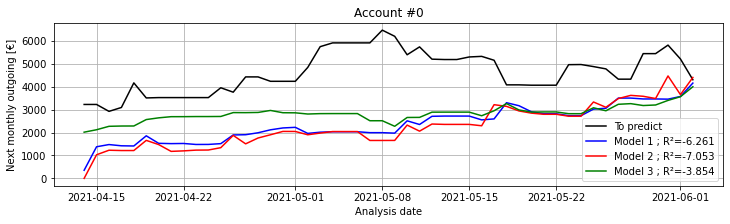

Account #1


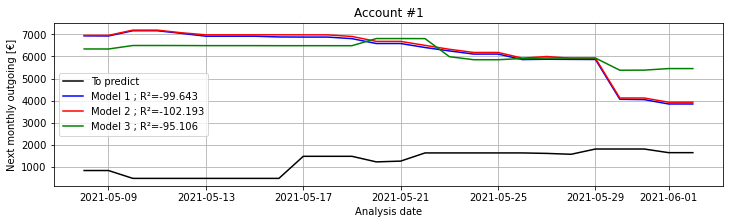

Account #2
No sufficient history for validation of prediction model
Account #3
No sufficient history for validation of prediction model
Account #4


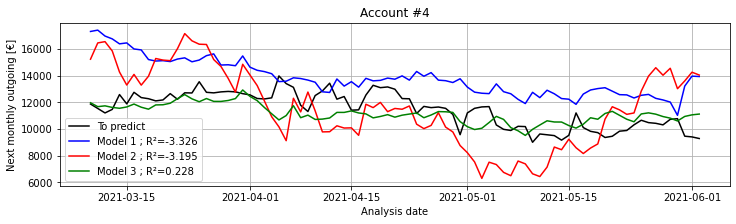

Account #5
No sufficient history for validation of prediction model
Account #6
No sufficient history for validation of prediction model
Account #7


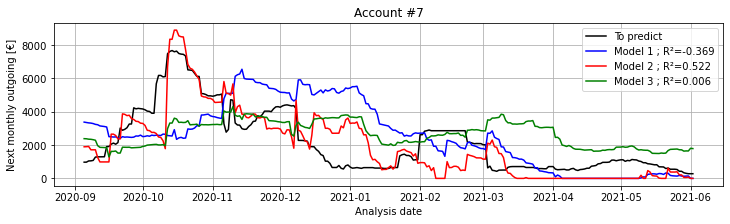

Account #8


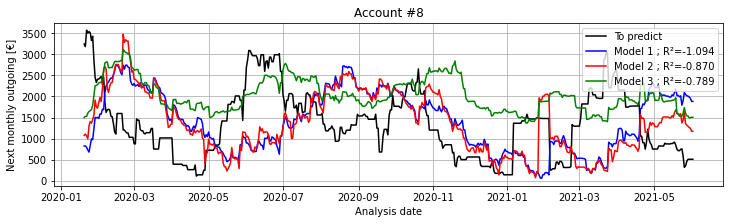

Account #9
No sufficient history for validation of prediction model
Account #10


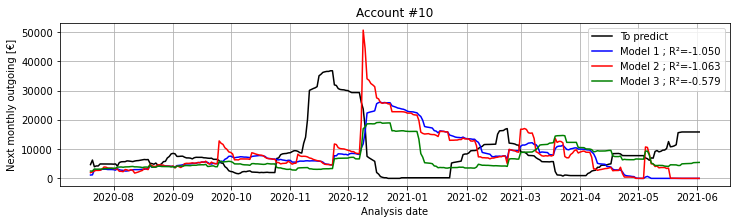

Account #11
No sufficient history for validation of prediction model
Account #12


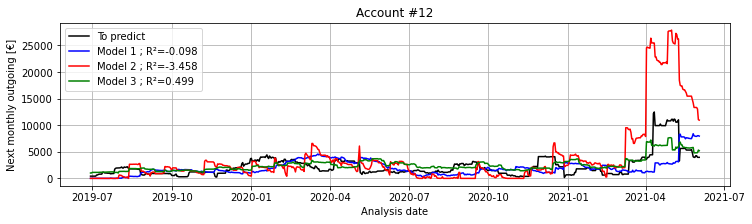

Account #13
No sufficient history for validation of prediction model
Account #14
No sufficient history for validation of prediction model
Account #15


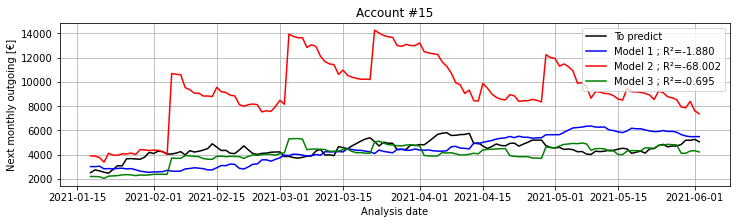

Account #16


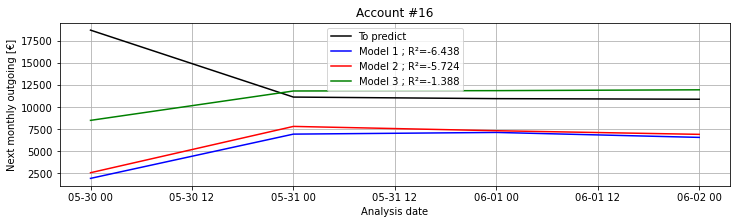

Account #17


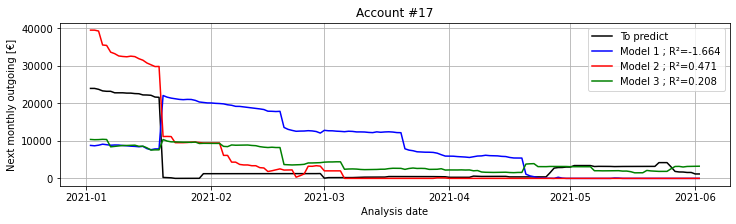

Account #18


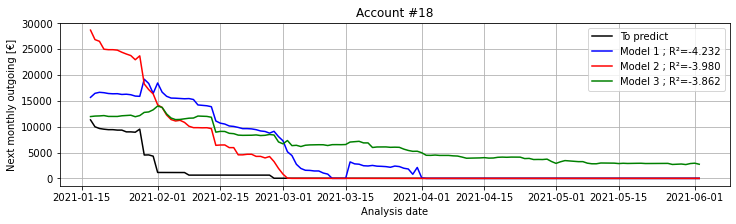

Account #19


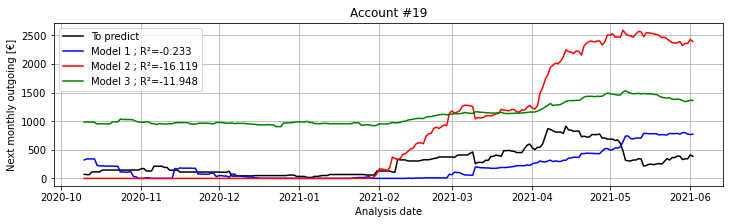

Account #20
No sufficient history for validation of prediction model
Account #21
No sufficient history for validation of prediction model
Account #22
No sufficient history for validation of prediction model
Account #23


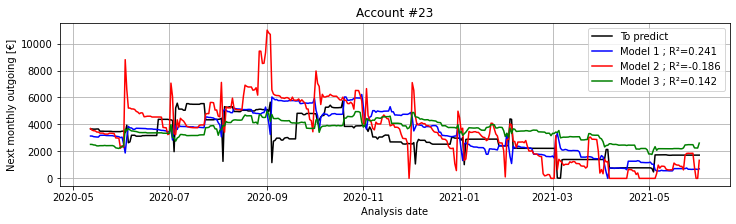

Account #24


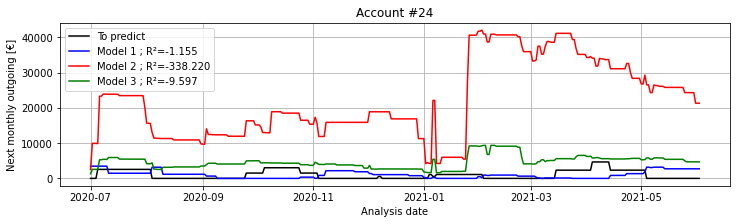

Account #25


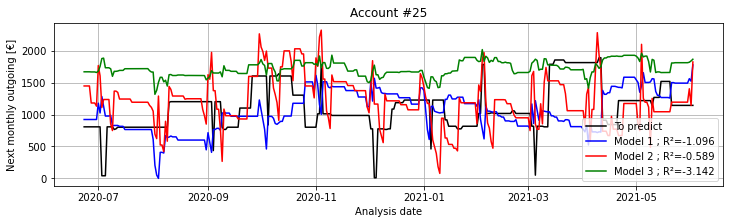

Account #26


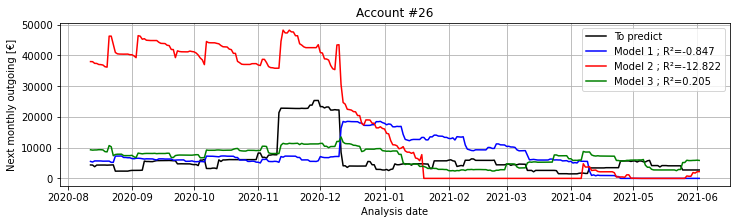

Account #27


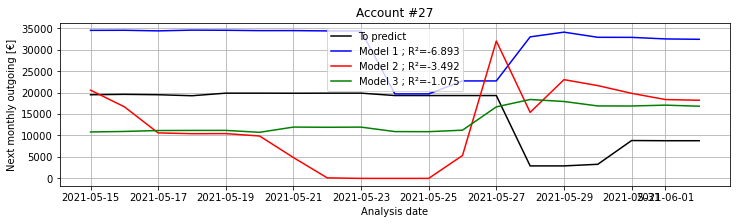

Account #28


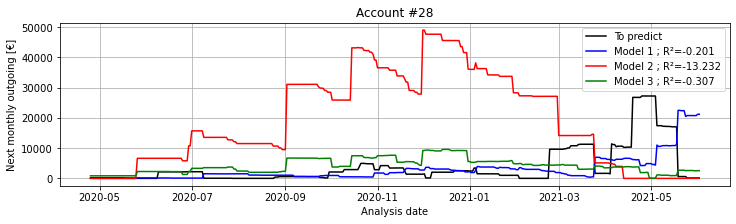

Account #29


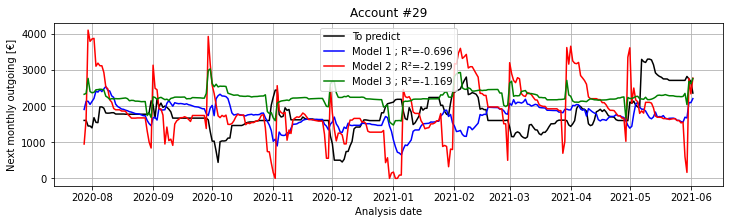

Account #30
No sufficient history for validation of prediction model
Account #31


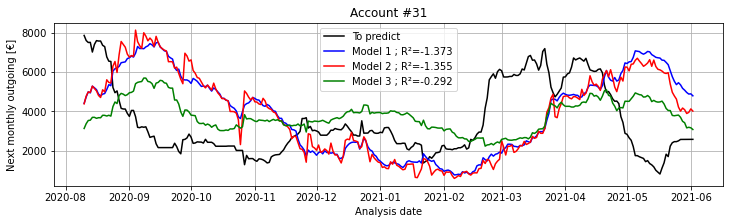

Account #32
No sufficient history for validation of prediction model
Account #33
No sufficient history for validation of prediction model
Account #34


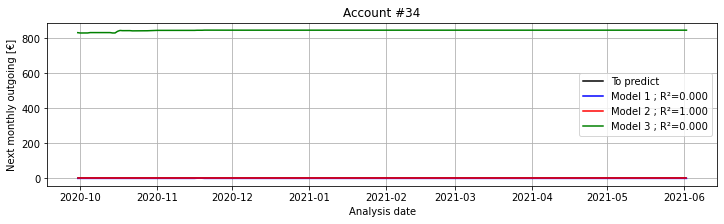

Account #35


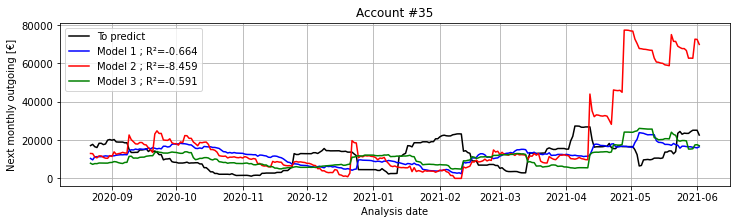

Account #36
No sufficient history for validation of prediction model
Account #37


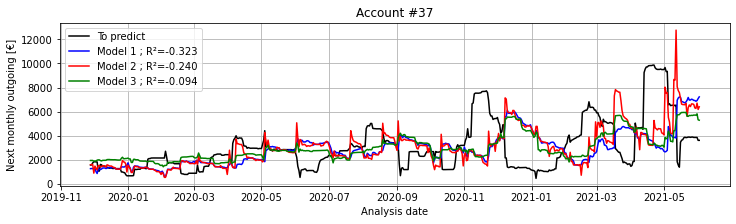

Account #38


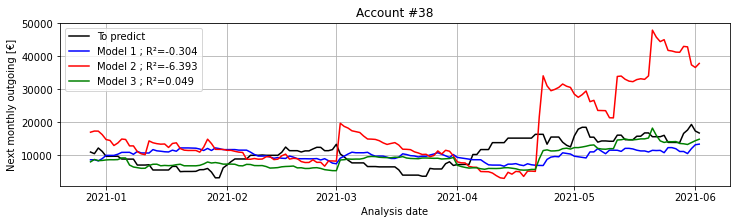

Account #39


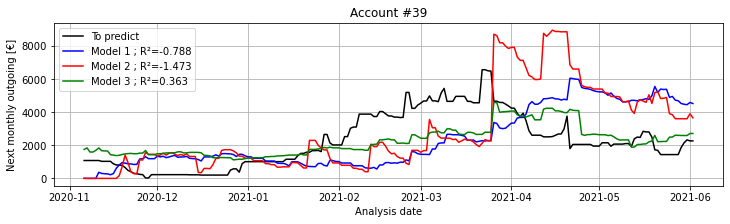

Account #40


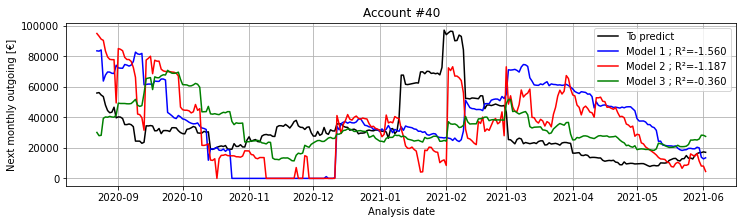

Account #41


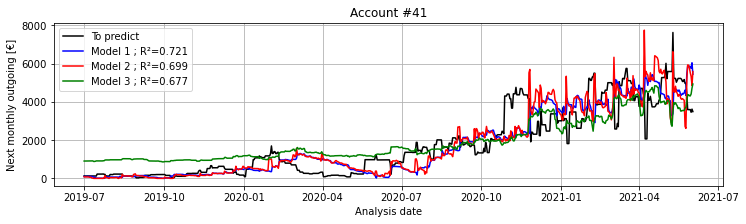

Account #42
No sufficient history for validation of prediction model
Account #43
No sufficient history for validation of prediction model
Account #44
No sufficient history for validation of prediction model
Account #45


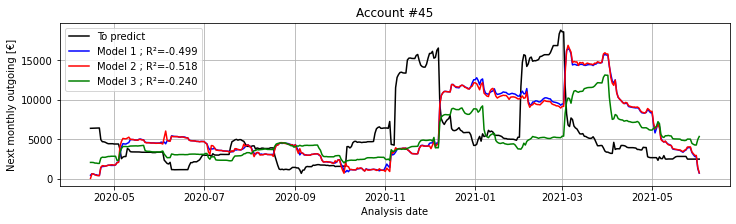

Account #46


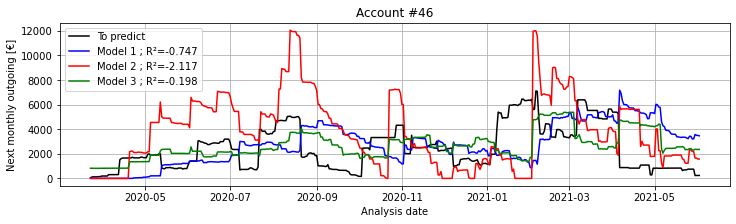

Account #47


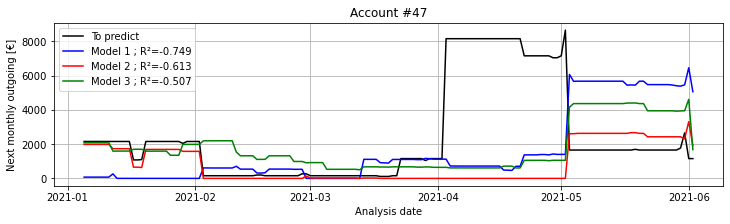

Account #48


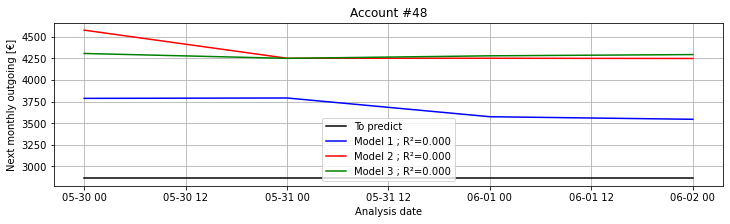

Account #49


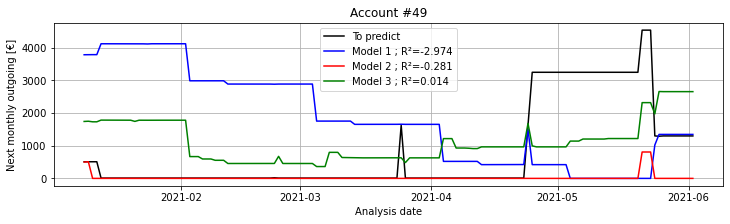

Account #50


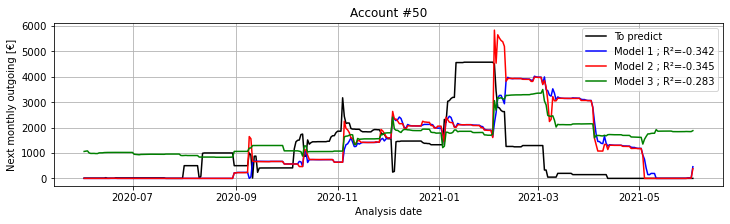

Account #51


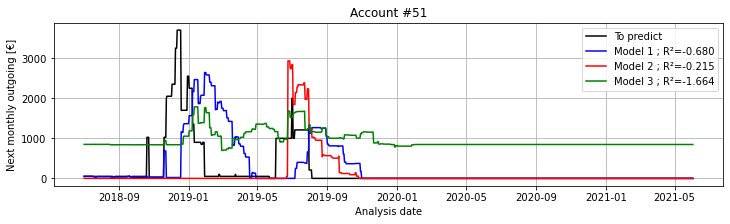

Account #52
No sufficient history for validation of prediction model
Account #53


C:\Anaconda3\envs\DataScientist\lib\site-packages\sklearn\metrics\_regression.py:781: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
C:\Anaconda3\envs\DataScientist\lib\site-packages\sklearn\metrics\_regression.py:781: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
C:\Anaconda3\envs\DataScientist\lib\site-packages\sklearn\metrics\_regression.py:781: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


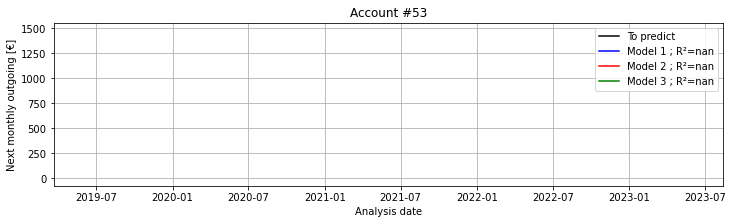

Account #54


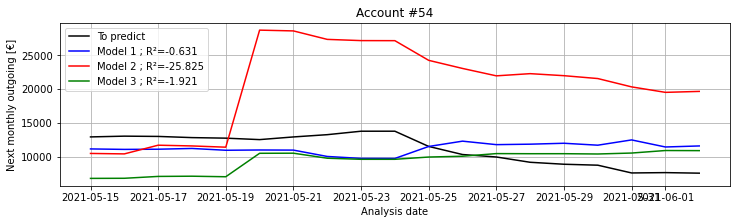

Account #55


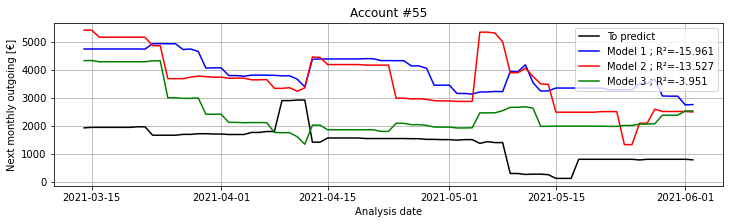

Account #56
No sufficient history for validation of prediction model
Account #57


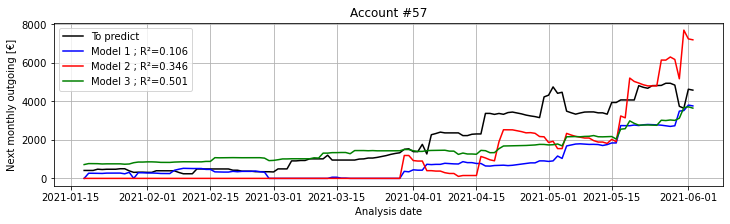

Account #58


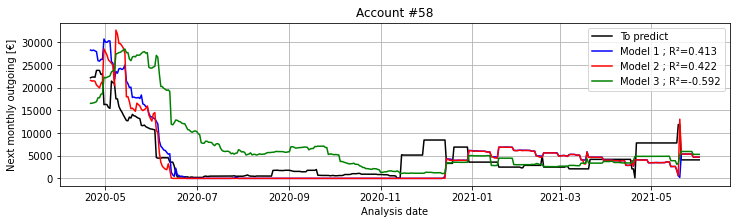

Account #59


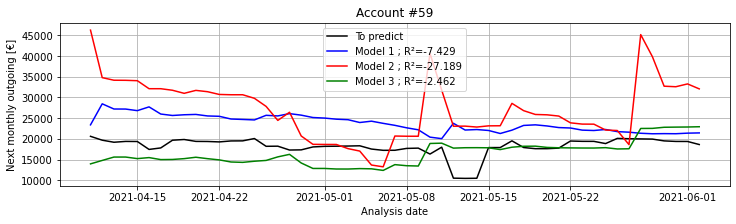

Account #60
No sufficient history for validation of prediction model
Account #61


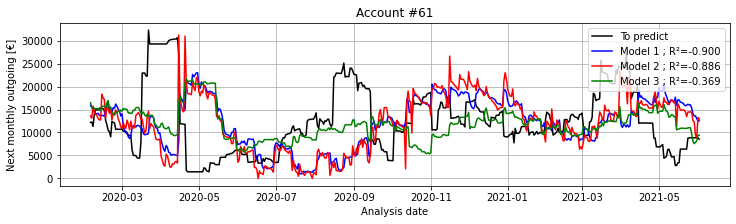

Account #62


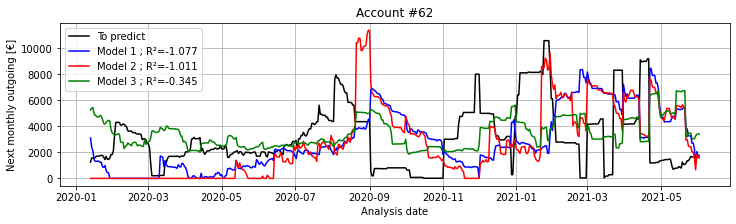

Account #63
No sufficient history for validation of prediction model
Account #64


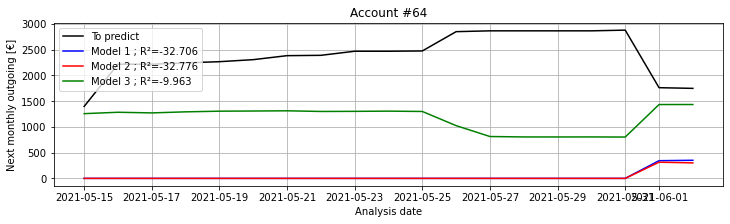

Account #65
No sufficient history for validation of prediction model
Account #66


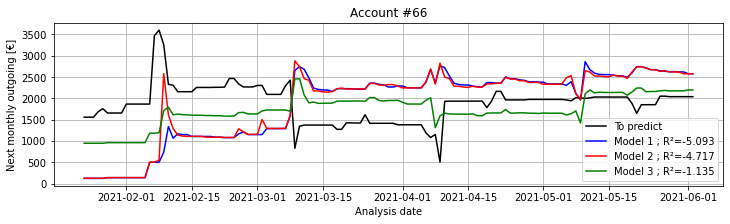

Account #67
No sufficient history for validation of prediction model
Account #68


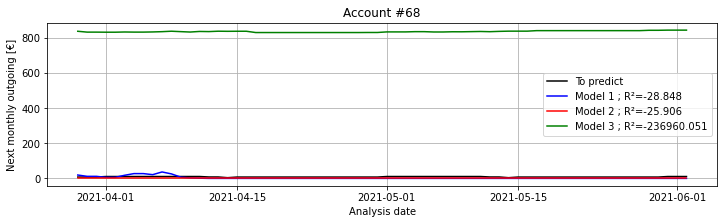

Account #69
No sufficient history for validation of prediction model
Account #70
No sufficient history for validation of prediction model
Account #71
No sufficient history for validation of prediction model
Account #72
No sufficient history for validation of prediction model
Account #73
No sufficient history for validation of prediction model
Account #74


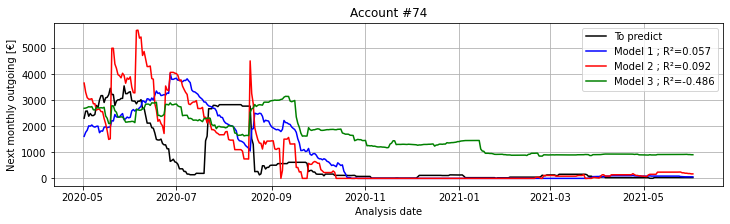

Account #75
No sufficient history for validation of prediction model
Account #76
No sufficient history for validation of prediction model
Account #77
No sufficient history for validation of prediction model
Account #78
No sufficient history for validation of prediction model
Account #79
No sufficient history for validation of prediction model
Account #80


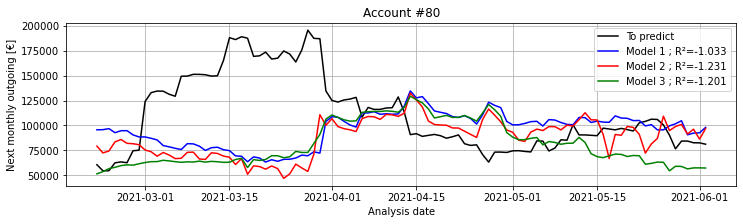

Account #81


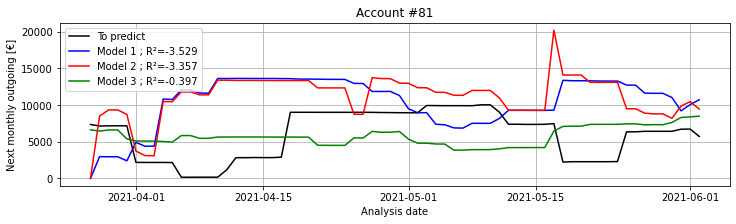

Account #82
No sufficient history for validation of prediction model
Account #83


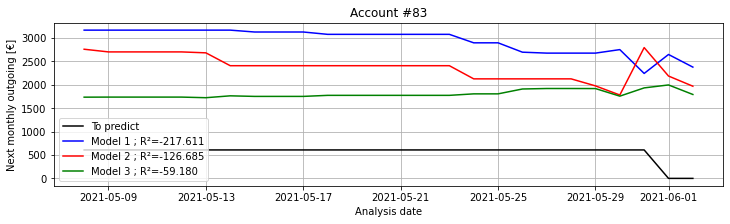

Account #84


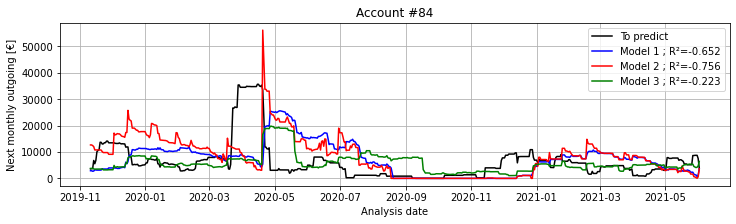

Account #85


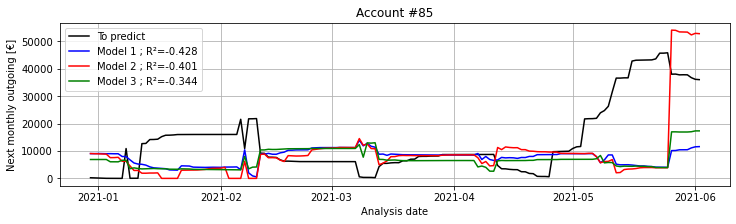

Account #86
No sufficient history for validation of prediction model
Account #87
No sufficient history for validation of prediction model
Account #88
No sufficient history for validation of prediction model
Account #89
No sufficient history for validation of prediction model
Account #90


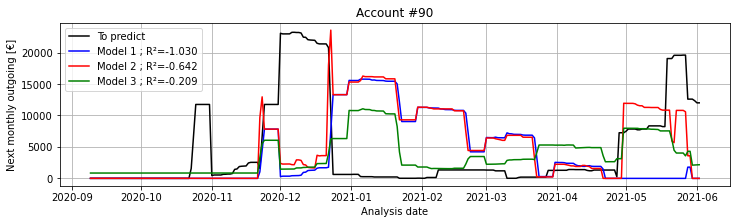

Account #91


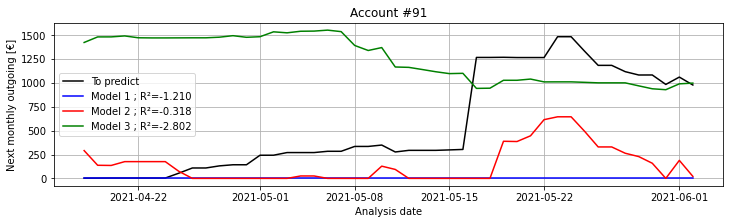

Account #92


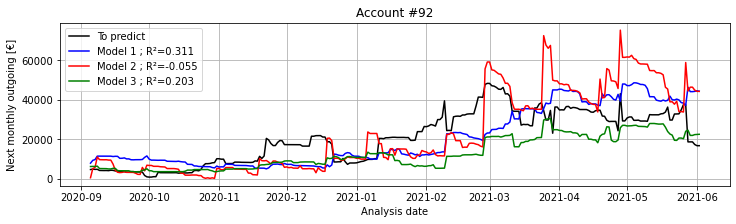

Account #93


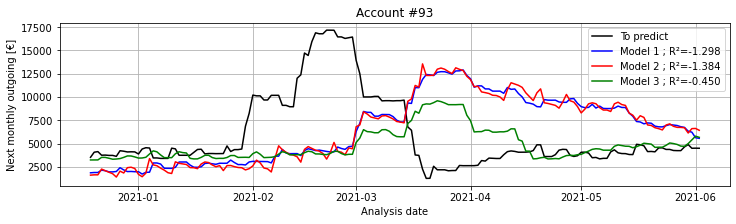

Account #94


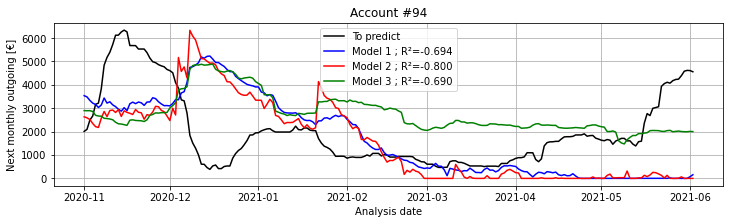

Account #95
No sufficient history for validation of prediction model
Account #96
No sufficient history for validation of prediction model
Account #97


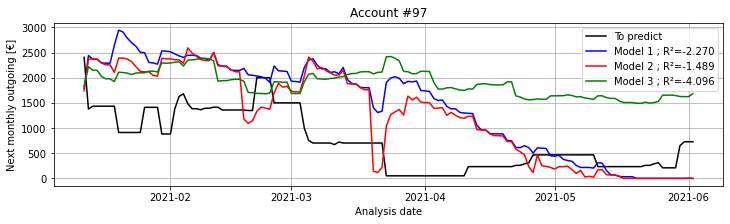

Account #98
No sufficient history for validation of prediction model
Account #99


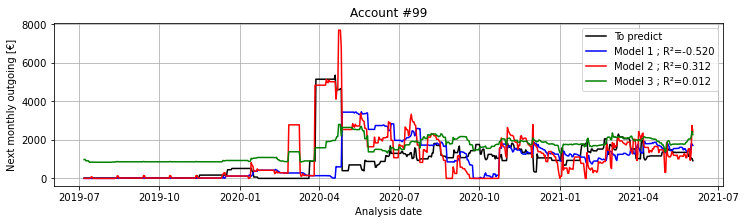

Account #100


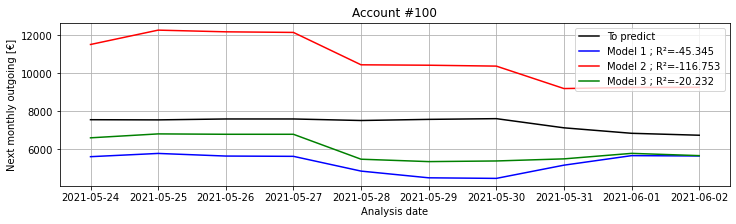

Account #101


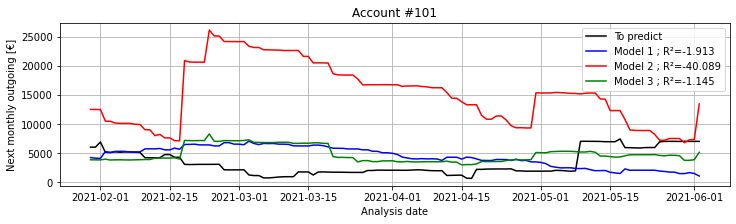

Account #102
No sufficient history for validation of prediction model
Account #103
No sufficient history for validation of prediction model
Account #104
No sufficient history for validation of prediction model
Account #105
No sufficient history for validation of prediction model
Account #106


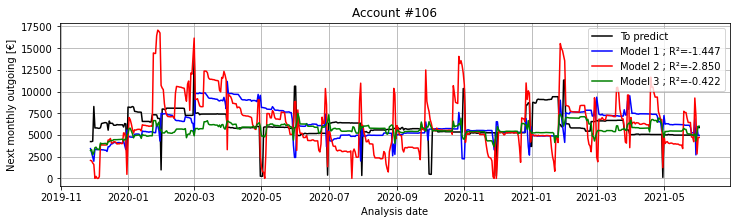

Account #107


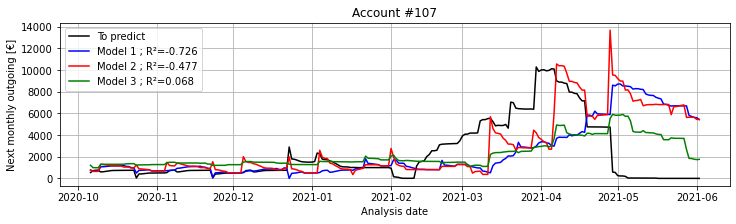

Account #108
No sufficient history for validation of prediction model
Account #109


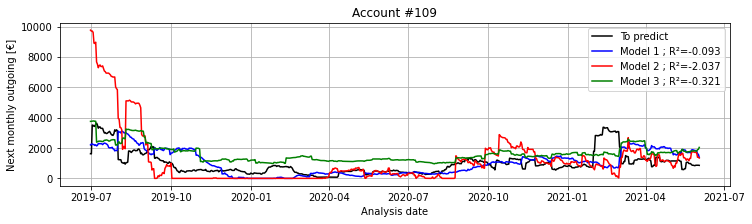

Account #110


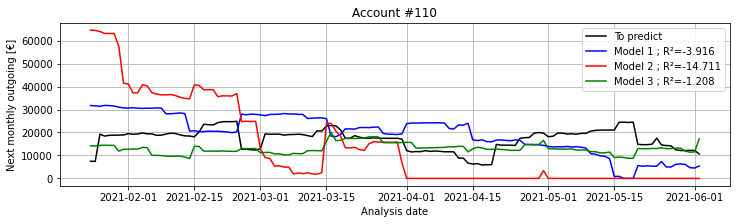

Account #111


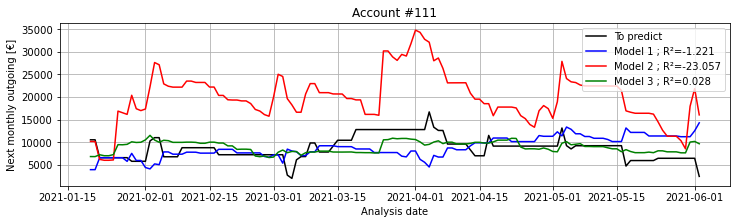

Account #112


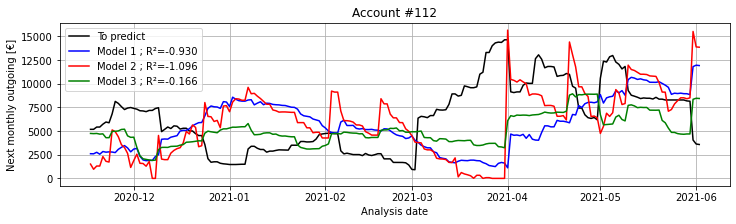

Account #113
No sufficient history for validation of prediction model
Account #114
No sufficient history for validation of prediction model
Account #115
No sufficient history for validation of prediction model
Account #116


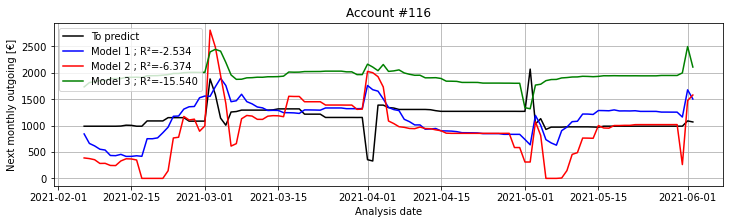

Account #117
No sufficient history for validation of prediction model
Account #118


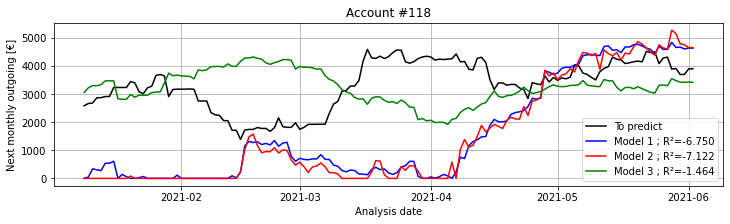

Account #119
No sufficient history for validation of prediction model
Account #120
No sufficient history for validation of prediction model
Account #121
No sufficient history for validation of prediction model
Account #122
No sufficient history for validation of prediction model
Account #123


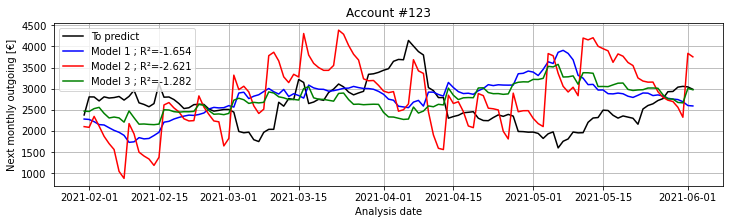

Account #124


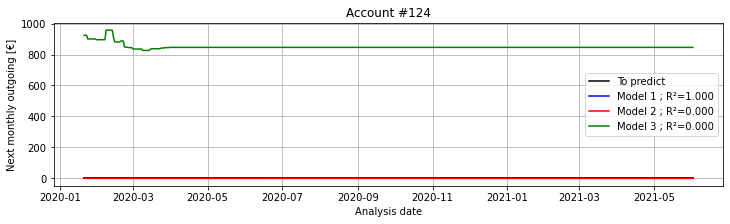

Account #125
No sufficient history for validation of prediction model
Account #126


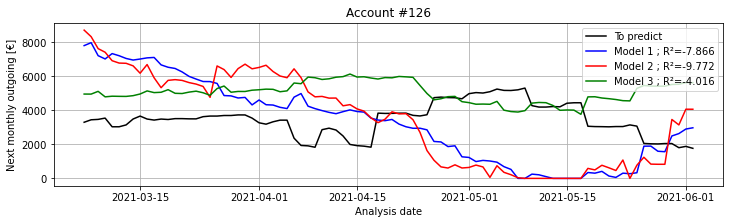

Account #127
No sufficient history for validation of prediction model
Account #128


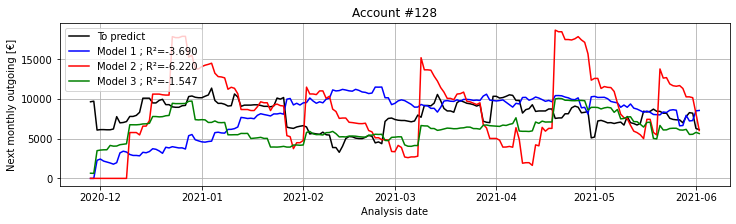

Account #129


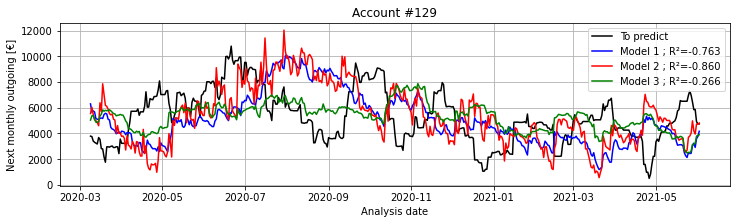

Account #130
No sufficient history for validation of prediction model
Account #131


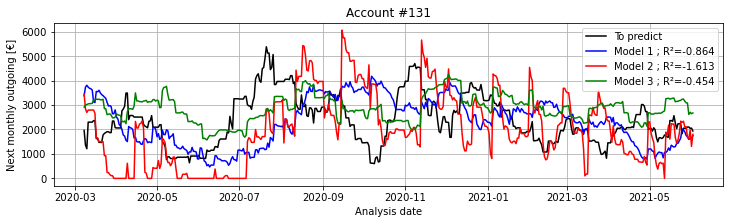

Account #132
No sufficient history for validation of prediction model
Account #133
No sufficient history for validation of prediction model
Account #134


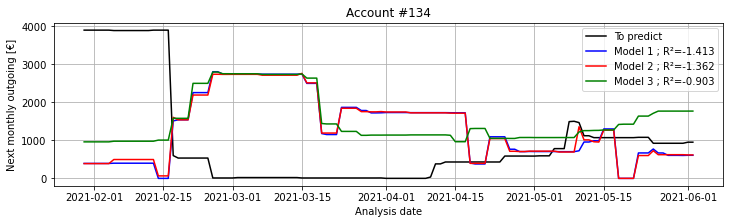

Account #135
No sufficient history for validation of prediction model
Account #136
No sufficient history for validation of prediction model
Account #137
No sufficient history for validation of prediction model
Account #138
No sufficient history for validation of prediction model
Account #139
No sufficient history for validation of prediction model
Account #140
No sufficient history for validation of prediction model
Account #141


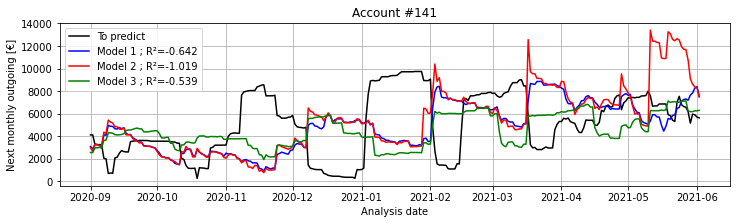

Account #142
No sufficient history for validation of prediction model
Account #143


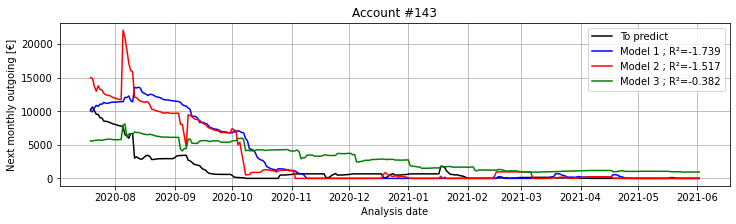

Account #144


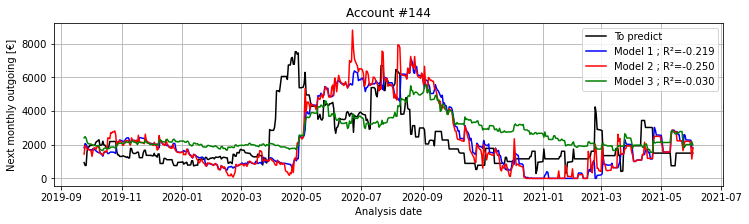

Account #145


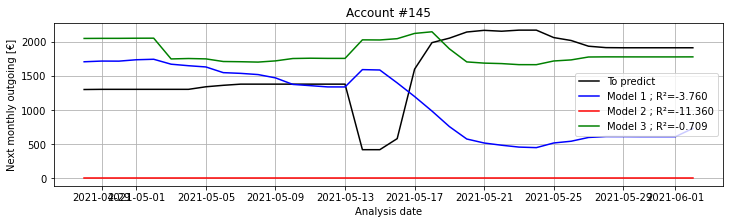

Account #146
No sufficient history for validation of prediction model
Account #147


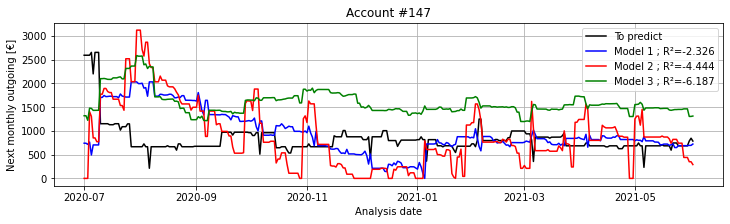

Account #148


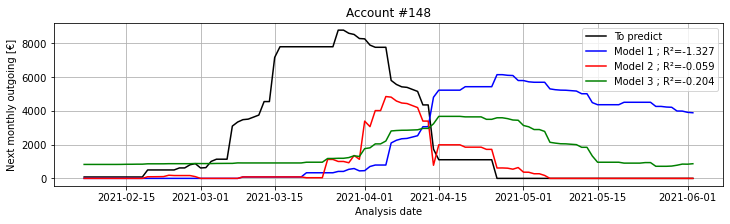

Account #149


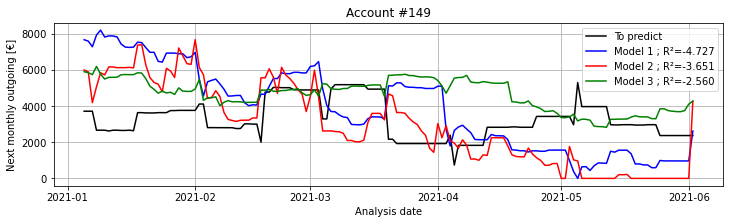

Account #150


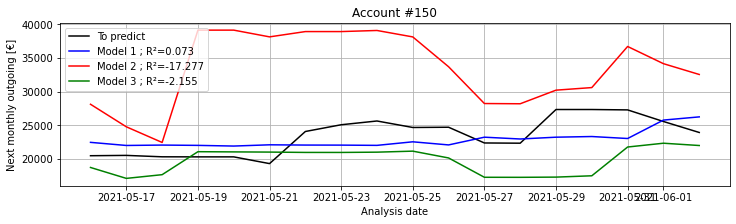

Account #151
No sufficient history for validation of prediction model
Account #152


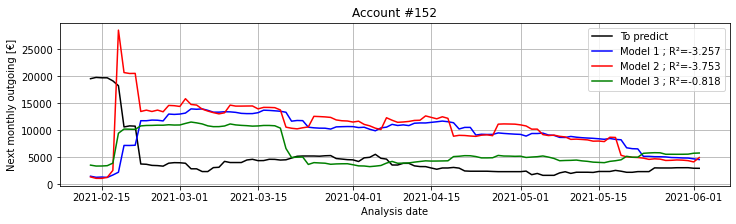

Account #153
No sufficient history for validation of prediction model
Account #154
No sufficient history for validation of prediction model
Account #155


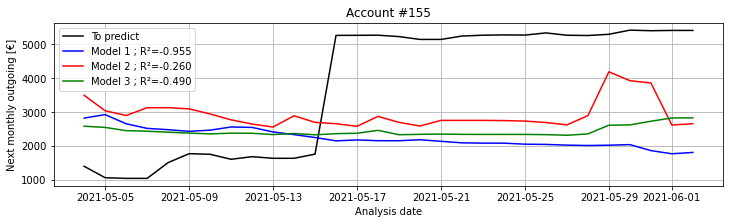

Account #156


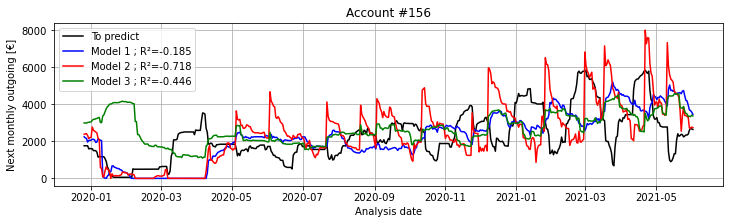

Account #157


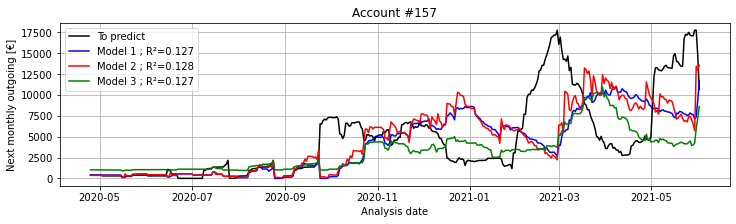

Account #158


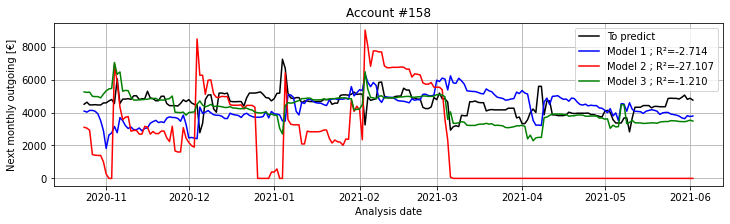

Account #159
No sufficient history for validation of prediction model
Account #160
No sufficient history for validation of prediction model
Account #161


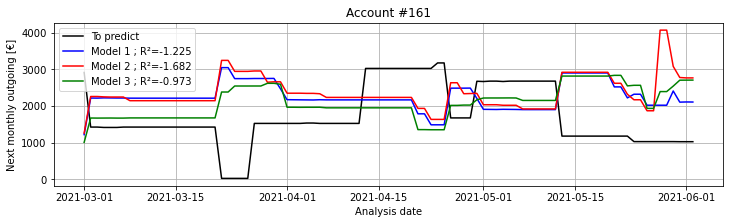

Account #162


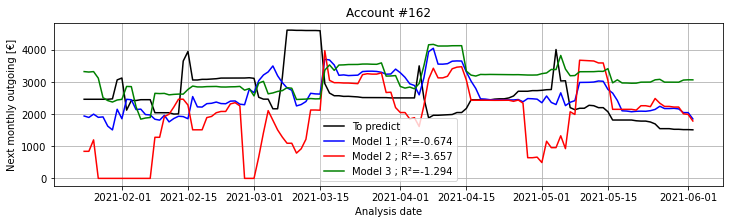

Account #163


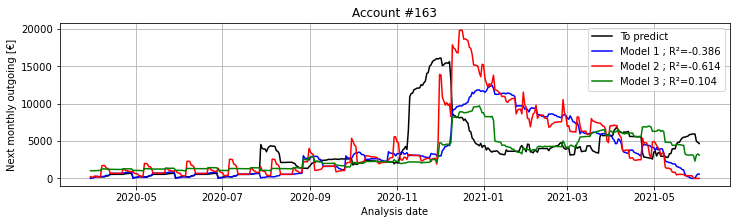

Account #164


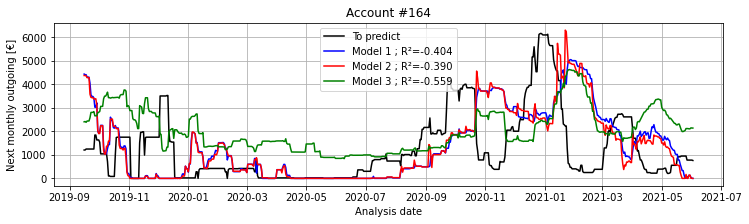

Account #165


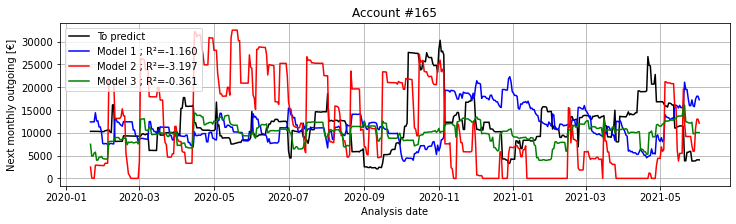

Account #166


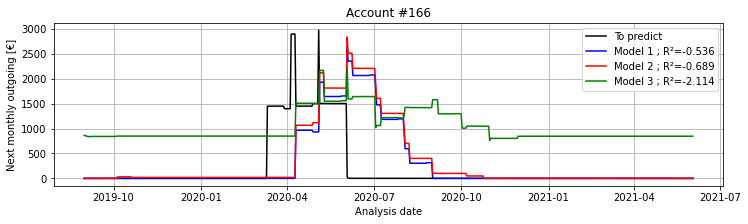

Account #167
No sufficient history for validation of prediction model
Account #168
No sufficient history for validation of prediction model
Account #169


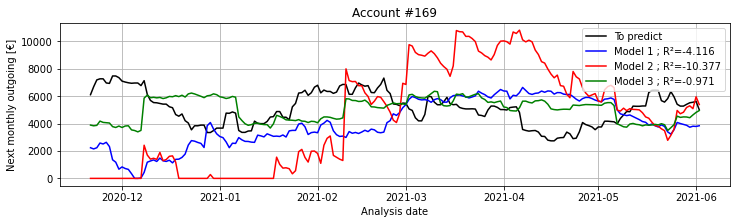

Account #170
No sufficient history for validation of prediction model
Account #171
No sufficient history for validation of prediction model
Account #172


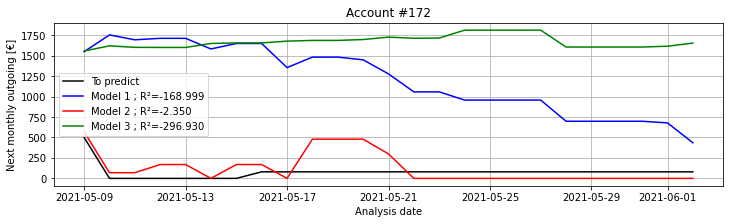

Account #173


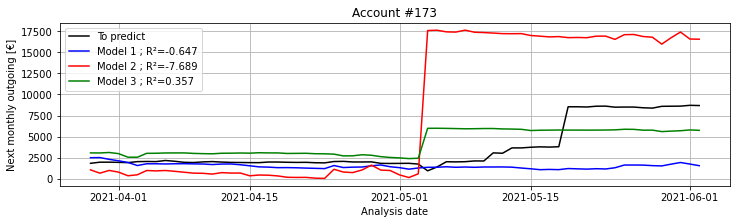

Account #174
No sufficient history for validation of prediction model
Account #175


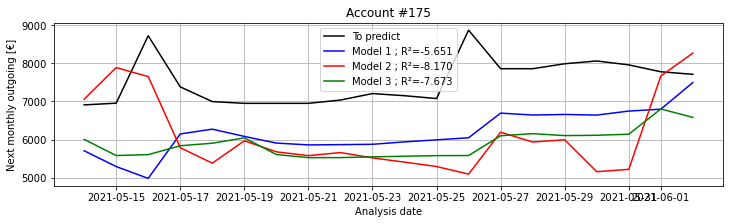

Account #176
No sufficient history for validation of prediction model
Account #177


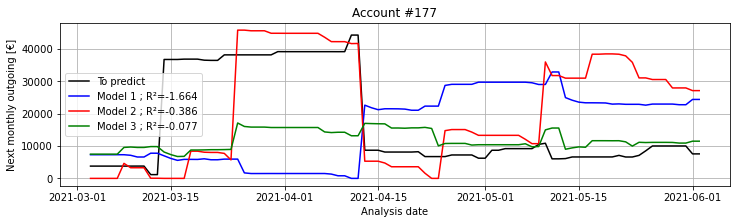

Account #178


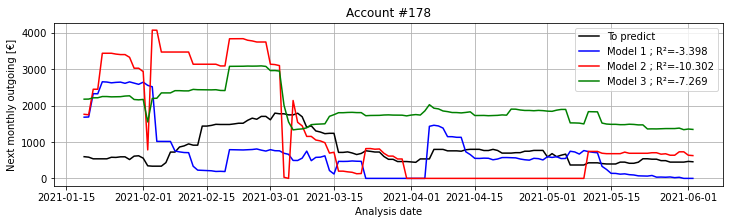

Account #179


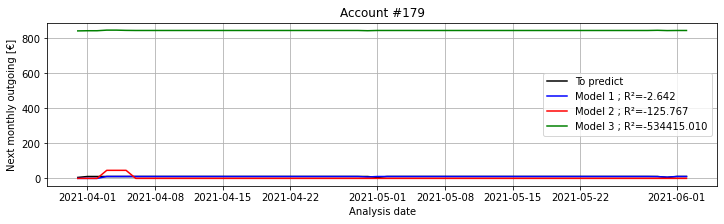

Account #180


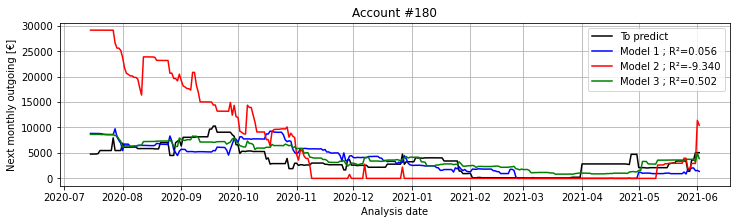

Account #181


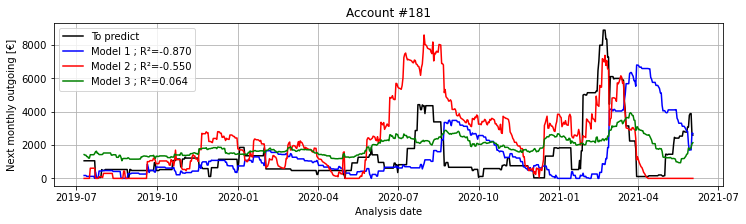

Account #182


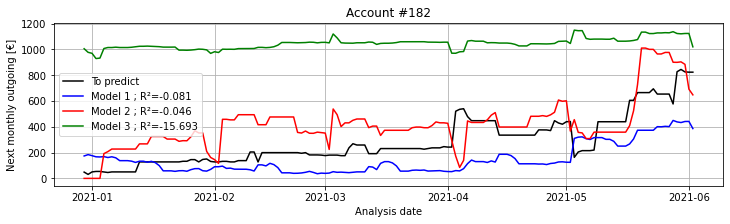

Account #183
No sufficient history for validation of prediction model
Account #184


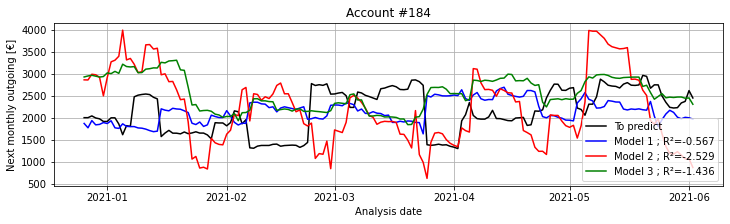

Account #185


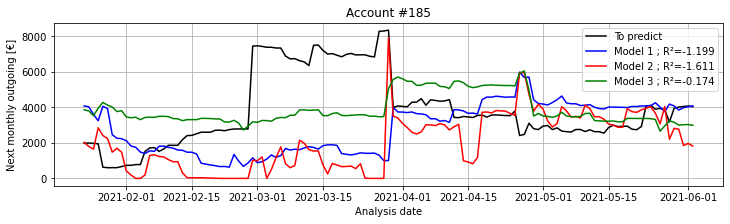

Account #186


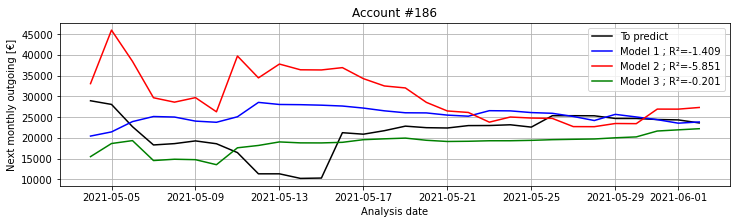

Account #187


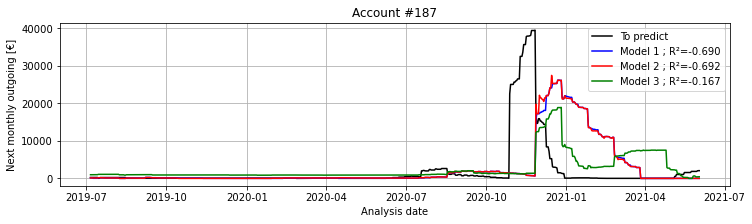

Account #188
No sufficient history for validation of prediction model
Account #189


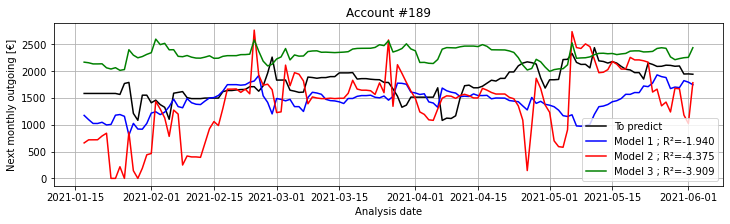

Account #190


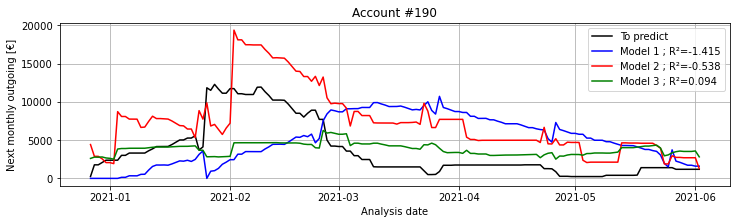

Account #191
No sufficient history for validation of prediction model
Account #192


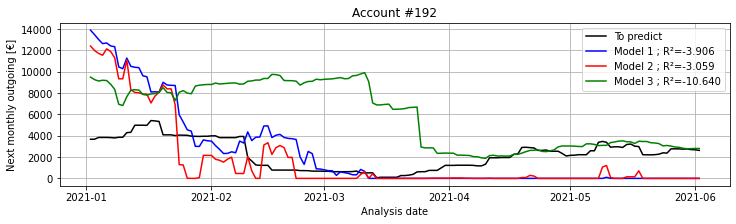

Account #193
No sufficient history for validation of prediction model
Account #194
No sufficient history for validation of prediction model
Account #195
No sufficient history for validation of prediction model
Account #196


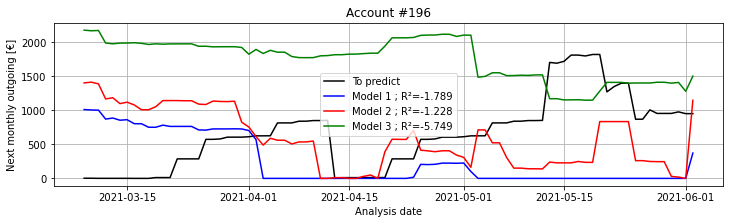

Account #197
No sufficient history for validation of prediction model
Account #198
No sufficient history for validation of prediction model
Account #199


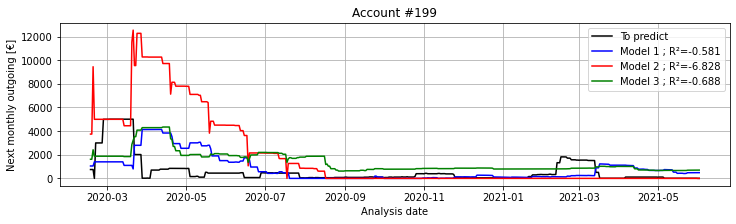

Account #200


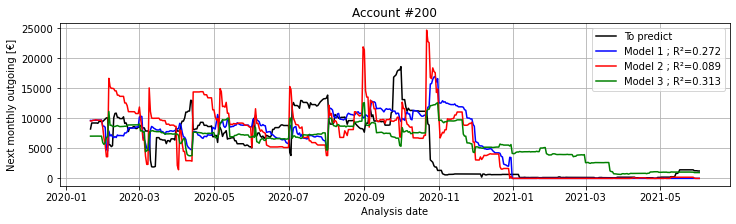

Account #201
No sufficient history for validation of prediction model
Account #202


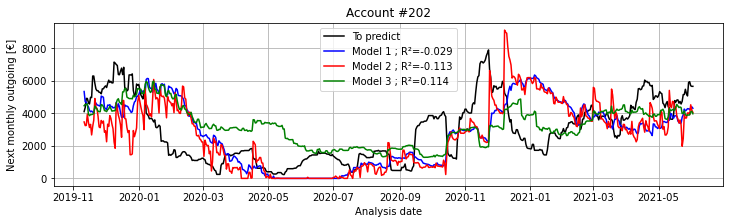

Account #203


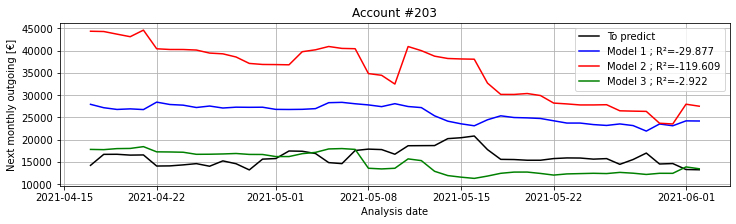

Account #204
No sufficient history for validation of prediction model
Account #205


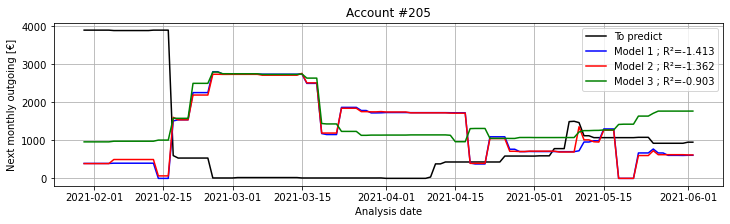

Account #206
No sufficient history for validation of prediction model
Account #207
No sufficient history for validation of prediction model
Account #208
No sufficient history for validation of prediction model
Account #209


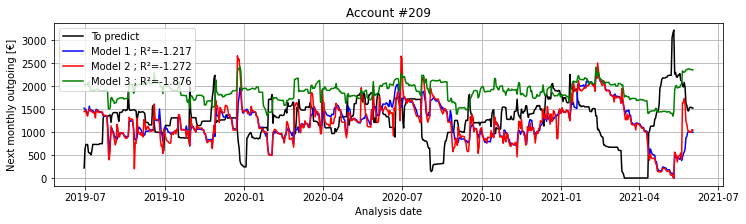

Account #210


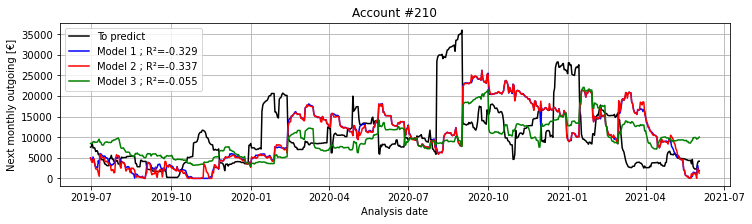

Account #211
No sufficient history for validation of prediction model
Account #212
No sufficient history for validation of prediction model
Account #213
No sufficient history for validation of prediction model
Account #214


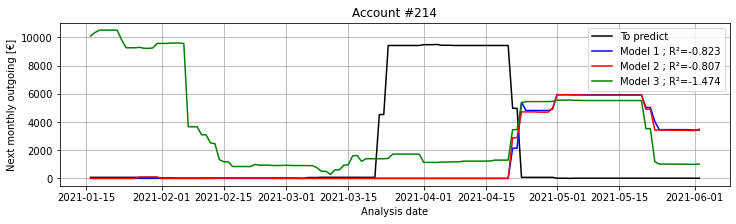

Account #215
No sufficient history for validation of prediction model
Account #216
No sufficient history for validation of prediction model
Account #217


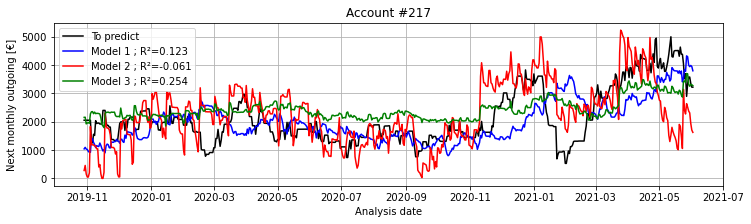

Account #218


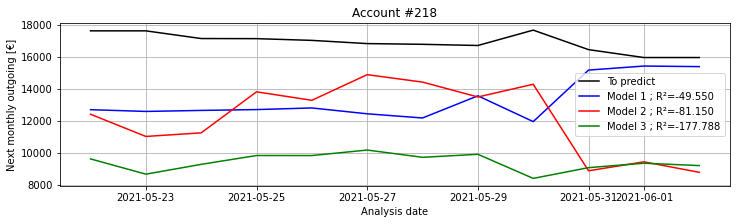

Account #219
No sufficient history for validation of prediction model
Account #220
No sufficient history for validation of prediction model
Account #221


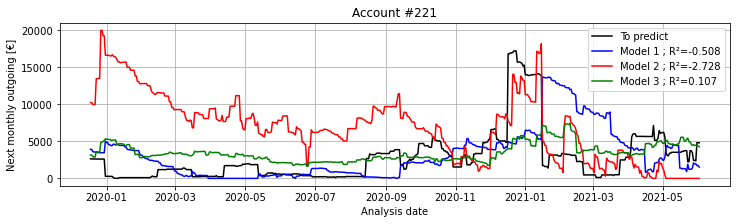

Account #222


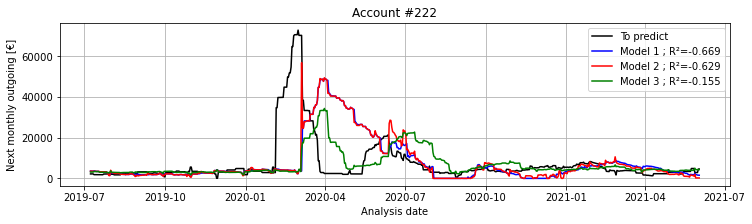

Account #223


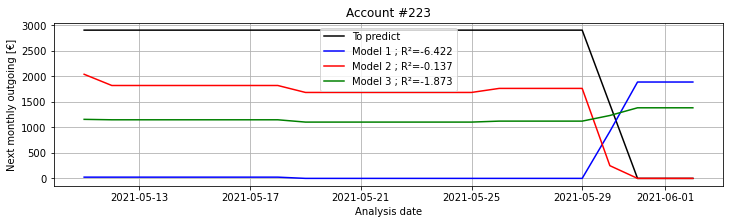

Account #224


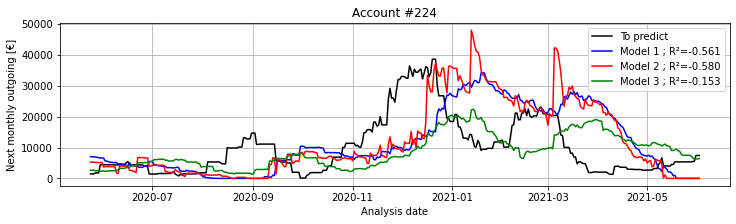

Account #225


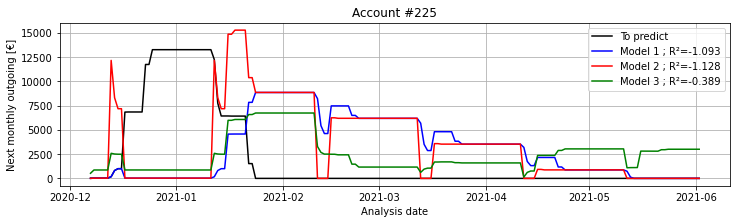

Account #226
No sufficient history for validation of prediction model
Account #227


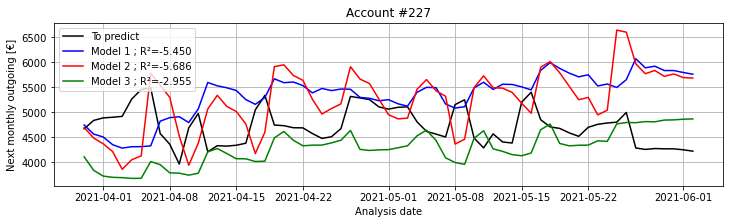

Account #228


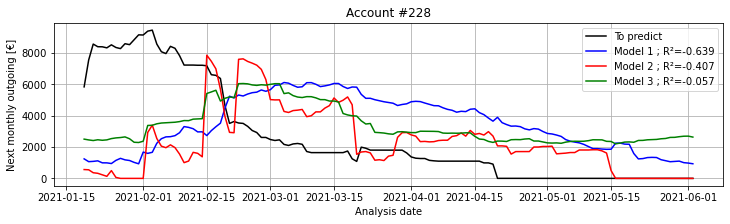

Account #229
No sufficient history for validation of prediction model
Account #230


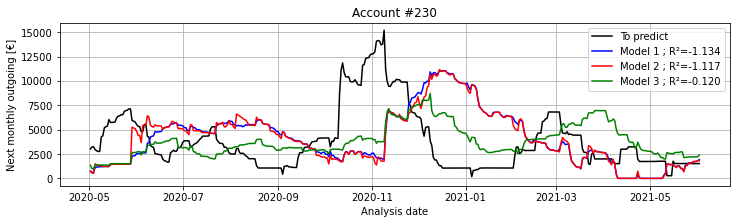

Account #231


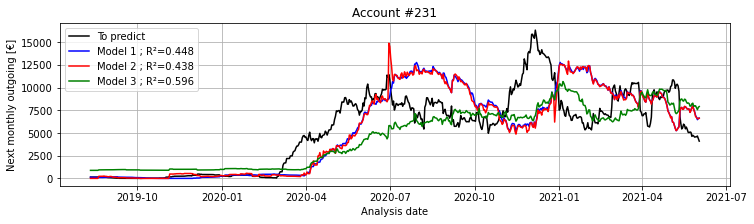

Account #232


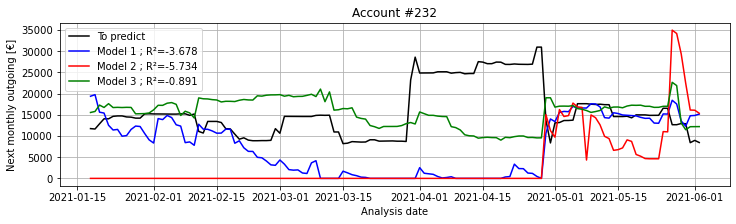

Account #233


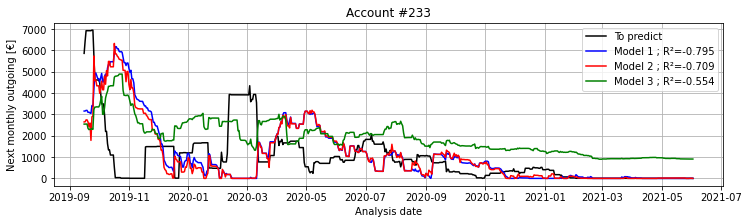

Account #234
No sufficient history for validation of prediction model
Account #235


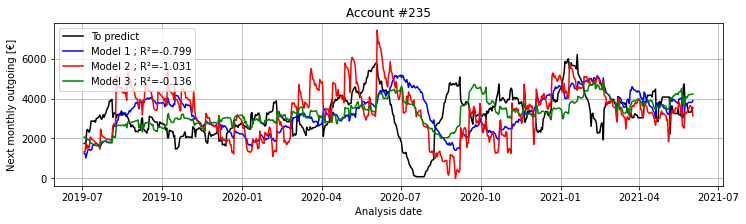

Account #236


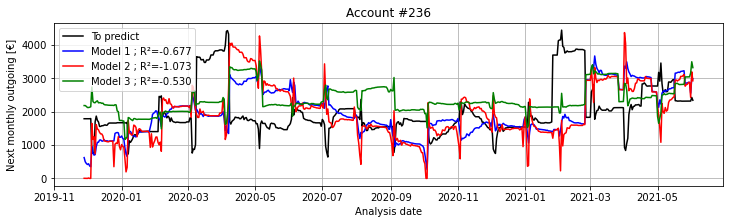

Account #237
No sufficient history for validation of prediction model
Account #238
No sufficient history for validation of prediction model
Account #239
No sufficient history for validation of prediction model
Account #240


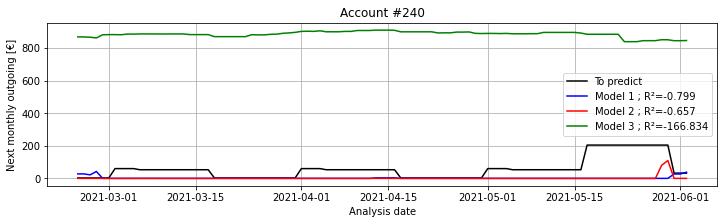

Account #241


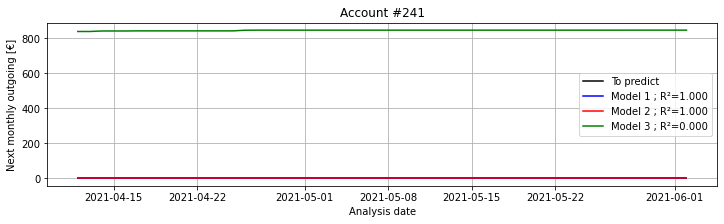

Account #242
No sufficient history for validation of prediction model
Account #243


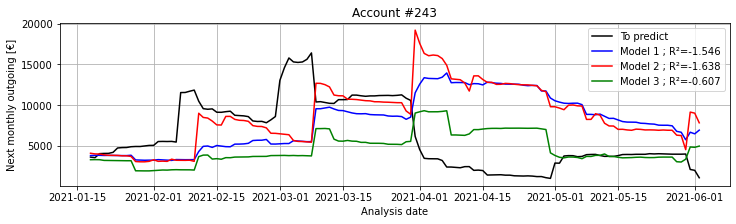

Account #244
No sufficient history for validation of prediction model
Account #245


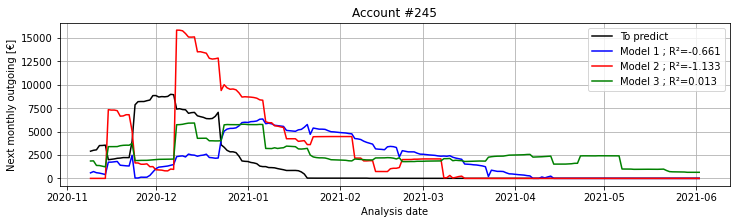

Account #246
No sufficient history for validation of prediction model
Account #247
No sufficient history for validation of prediction model
Account #248
No sufficient history for validation of prediction model
Account #249
No sufficient history for validation of prediction model
Account #250
No sufficient history for validation of prediction model
Account #251


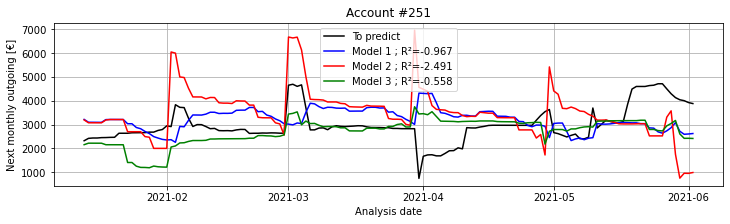

Account #252
No sufficient history for validation of prediction model
Account #253


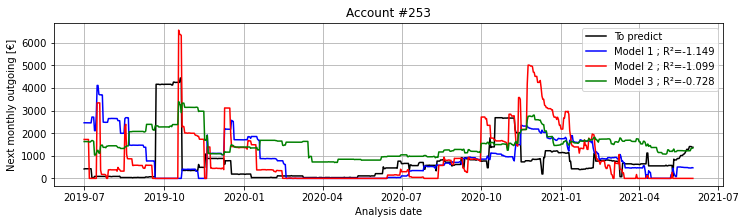

Account #254


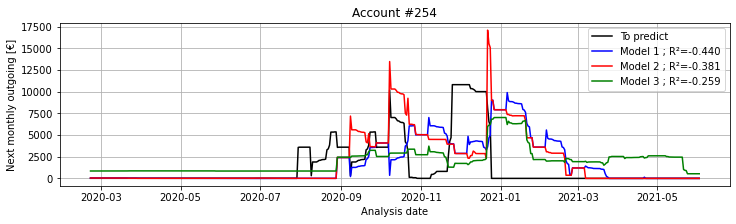

Account #255
No sufficient history for validation of prediction model
Account #256
No sufficient history for validation of prediction model
Account #257


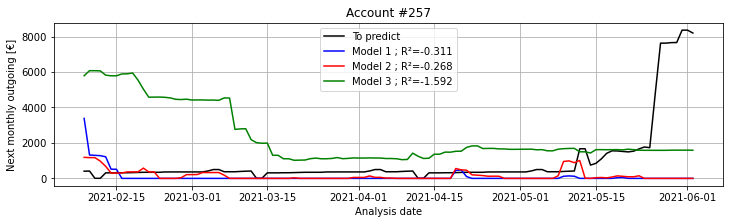

Account #258


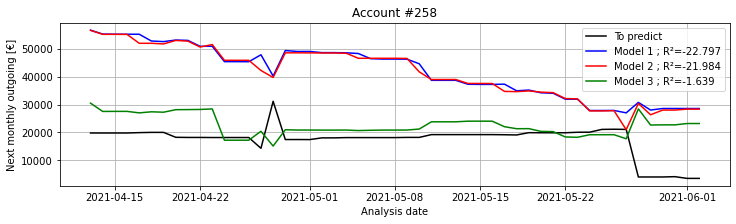

Account #259
No sufficient history for validation of prediction model
Account #260
No sufficient history for validation of prediction model
Account #261


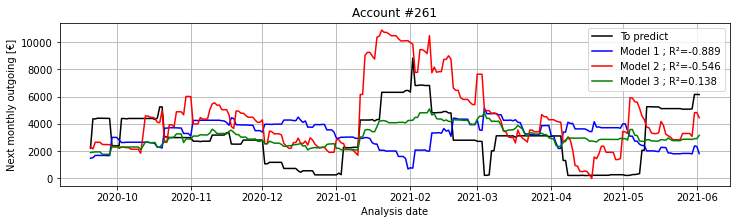

Account #262
No sufficient history for validation of prediction model
Account #263


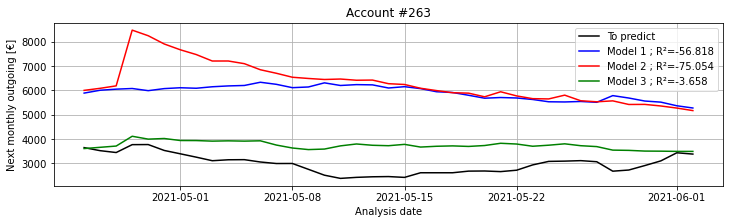

Account #264
No sufficient history for validation of prediction model
Account #265


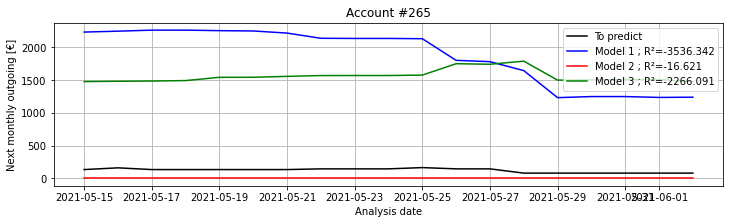

Account #266
No sufficient history for validation of prediction model
Account #267


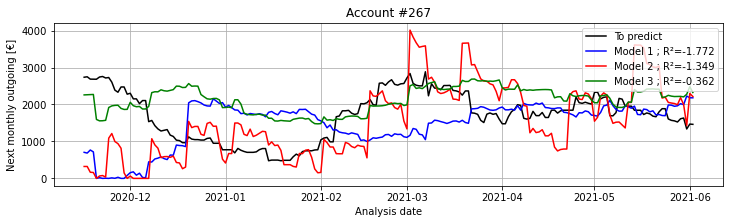

Account #268


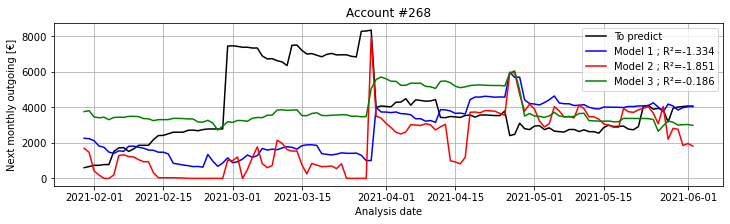

Account #269


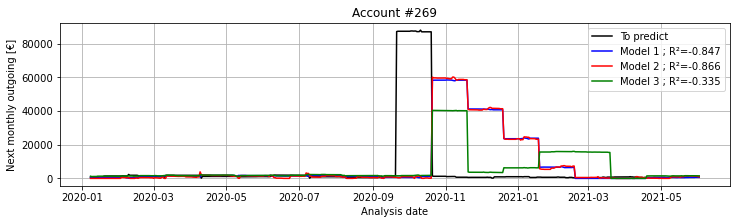

Account #270


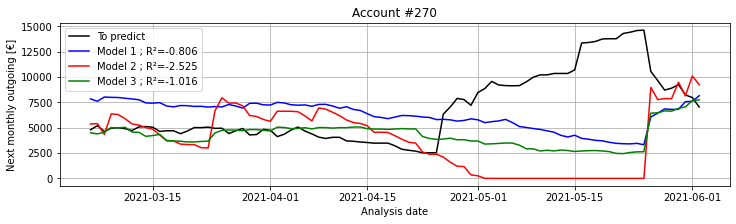

Account #271
No sufficient history for validation of prediction model
Account #272
No sufficient history for validation of prediction model
Account #273
No sufficient history for validation of prediction model
Account #274


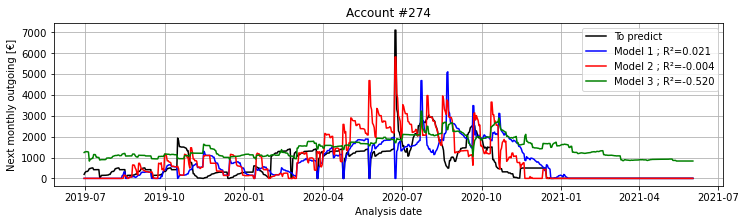

Account #275


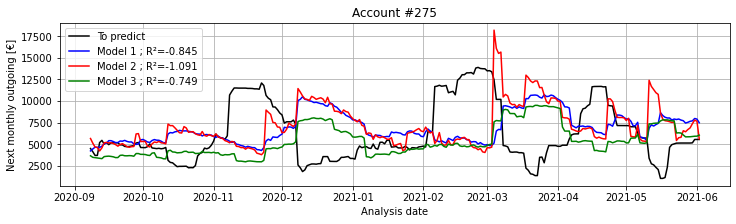

Account #276


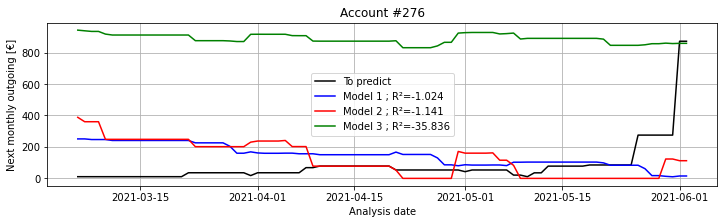

Account #277
No sufficient history for validation of prediction model
Account #278


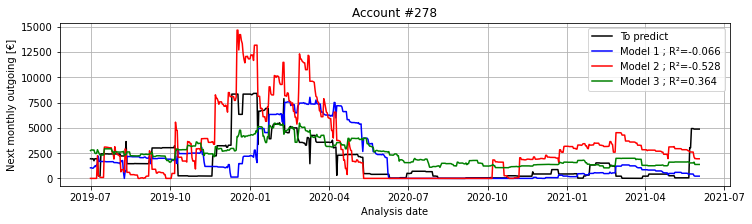

Account #279


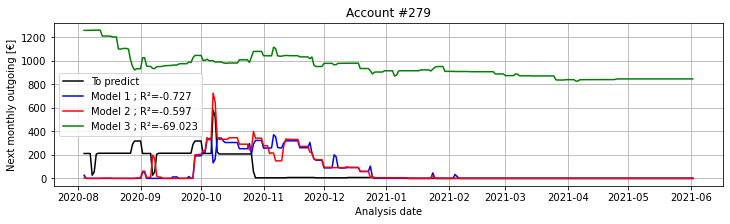

Account #280
No sufficient history for validation of prediction model
Account #281
No sufficient history for validation of prediction model
Account #282
No sufficient history for validation of prediction model
Account #283


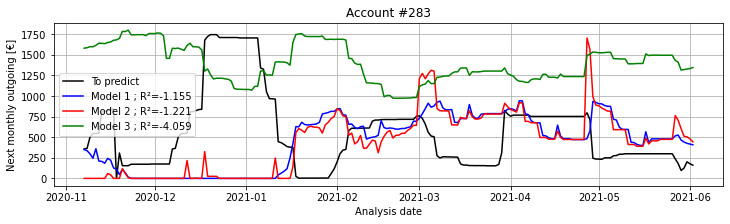

Account #284


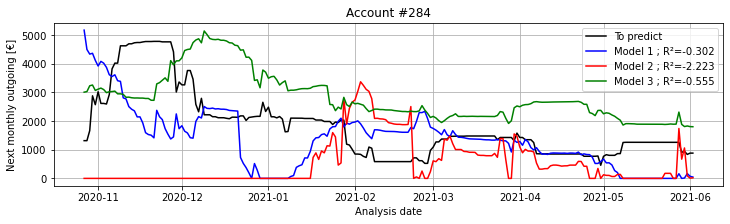

Account #285


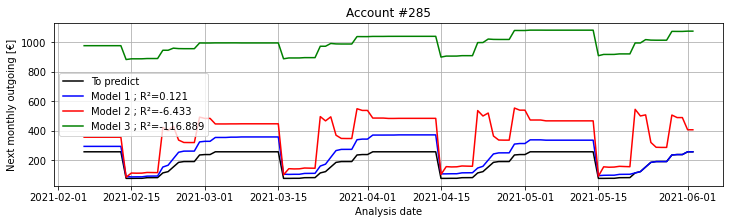

Account #286


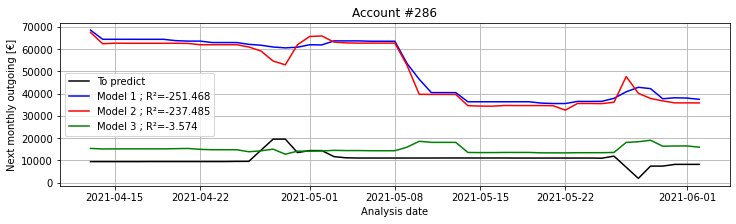

Account #287


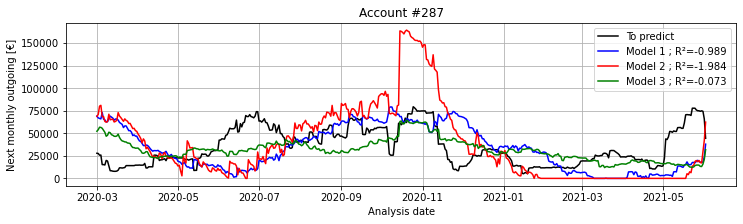

Account #288


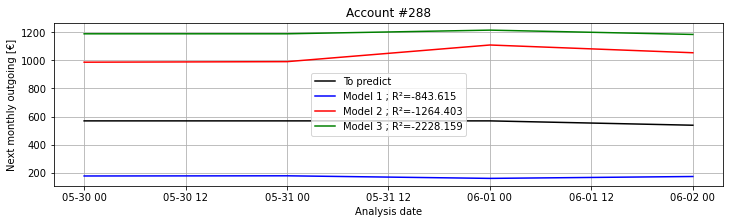

Account #289


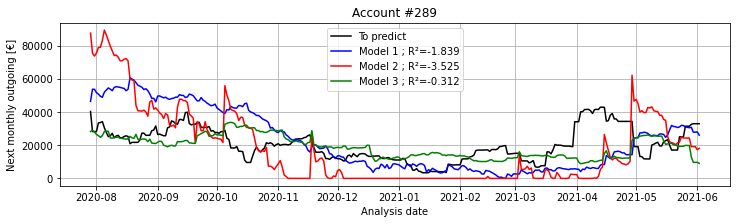

Account #290
No sufficient history for validation of prediction model
Account #291
No sufficient history for validation of prediction model
Account #292


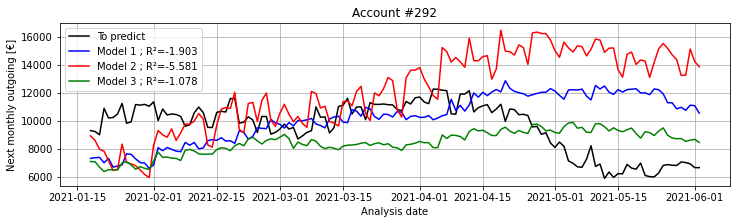

Account #293


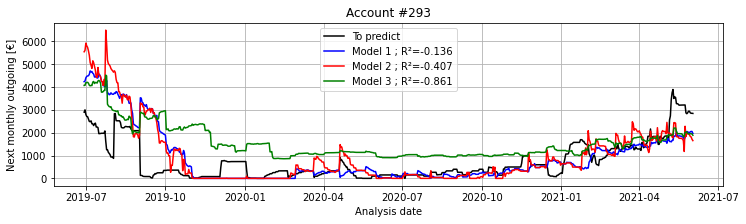

Account #294
No sufficient history for validation of prediction model
Account #295


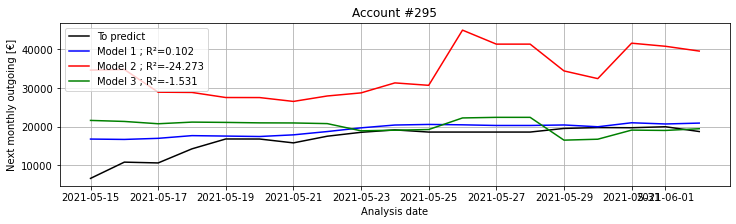

Account #296


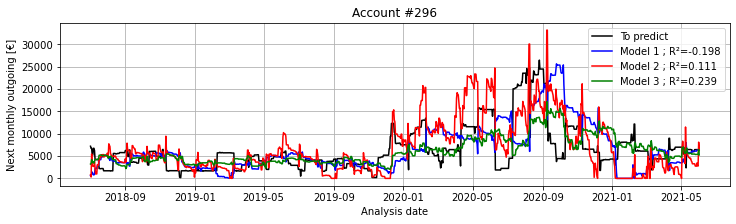

Account #297
No sufficient history for validation of prediction model
Account #298
No sufficient history for validation of prediction model
Account #299
No sufficient history for validation of prediction model
Account #300


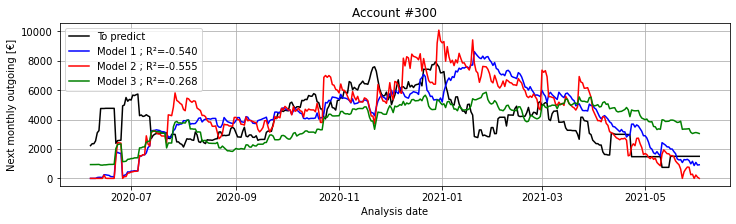

Account #301


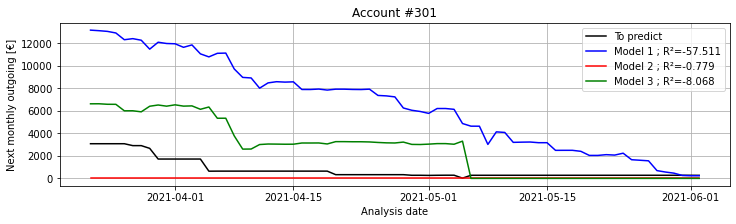

Account #302


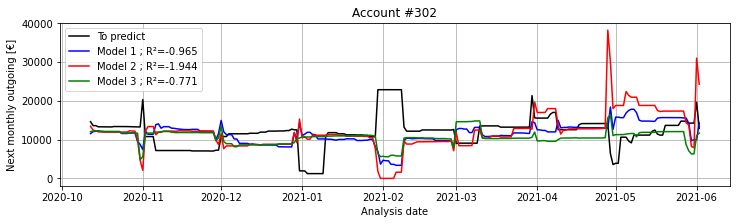

Account #303
No sufficient history for validation of prediction model
Account #304


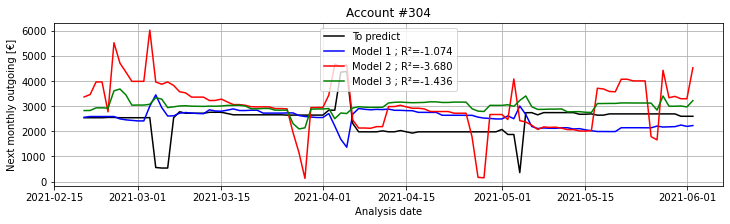

Account #305


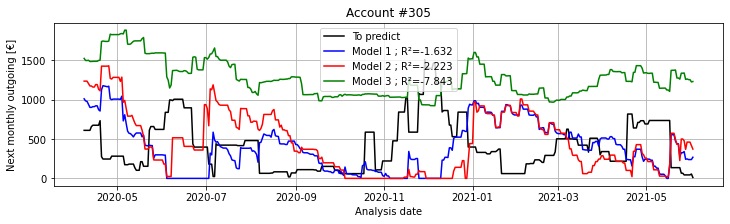

Account #306
No sufficient history for validation of prediction model
Account #307


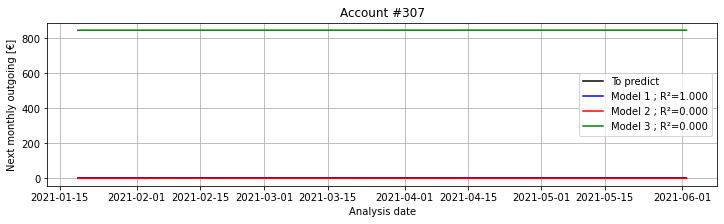

Account #308


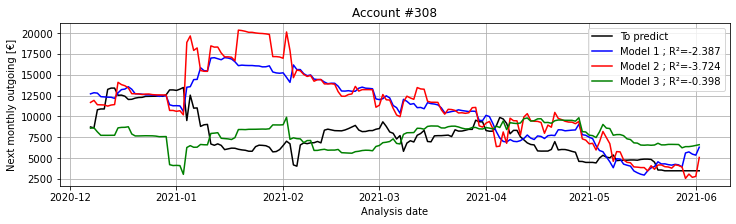

Account #309
No sufficient history for validation of prediction model
Account #310
No sufficient history for validation of prediction model
Account #311


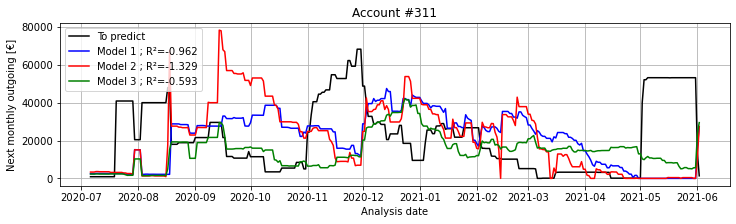

Account #312


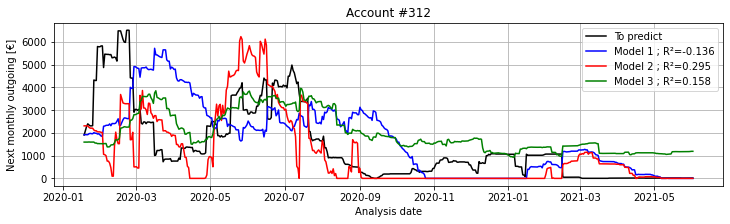

Account #313
No sufficient history for validation of prediction model
Account #314
No sufficient history for validation of prediction model
Account #315


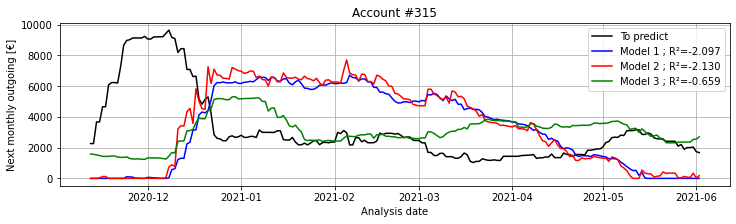

Account #316


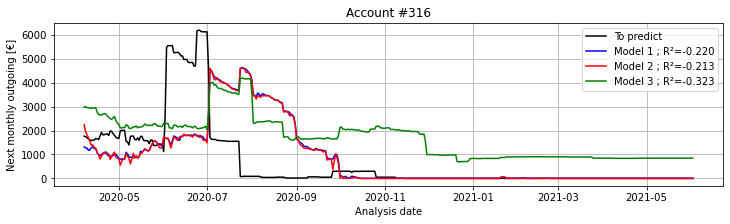

Account #317
No sufficient history for validation of prediction model
Account #318


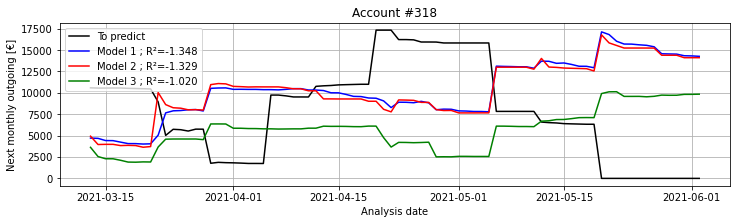

Account #319


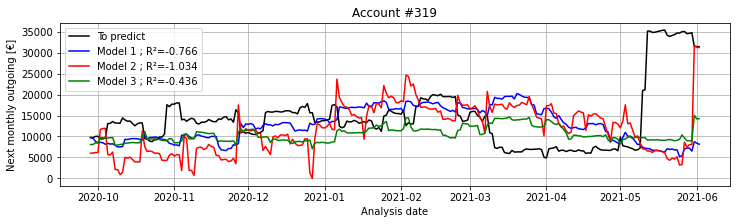

Account #320
No sufficient history for validation of prediction model
Account #321


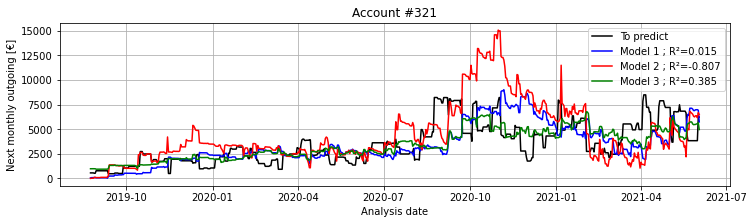

Account #322


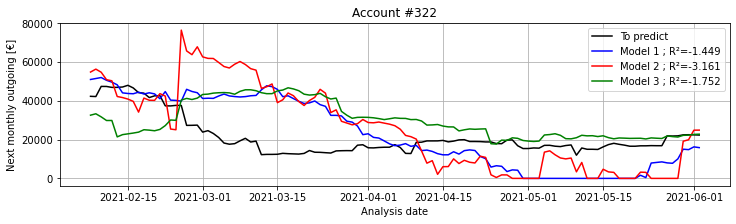

Account #323


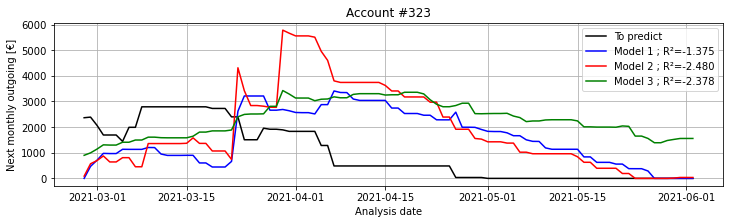

Account #324
No sufficient history for validation of prediction model
Account #325


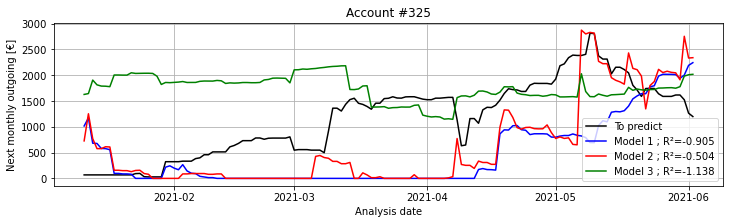

Account #326


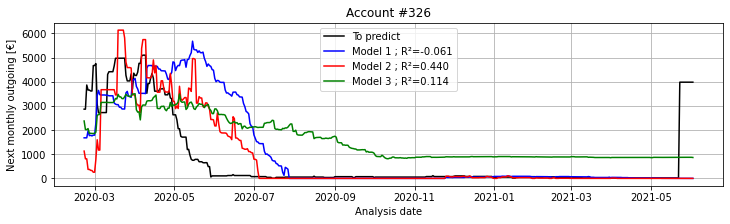

Account #327


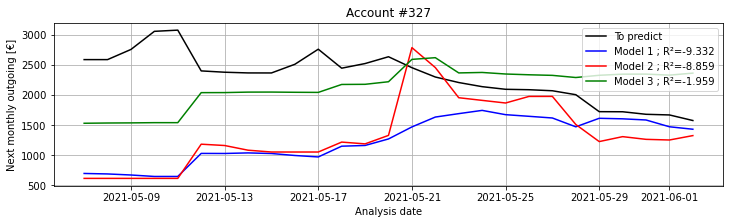

Account #328


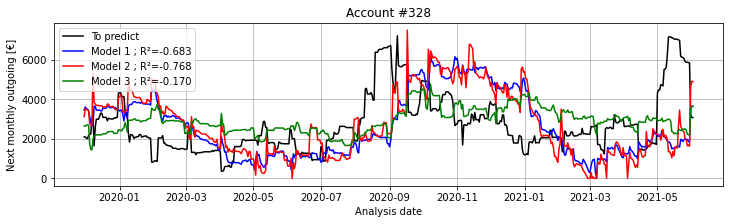

Account #329
No sufficient history for validation of prediction model
Account #330


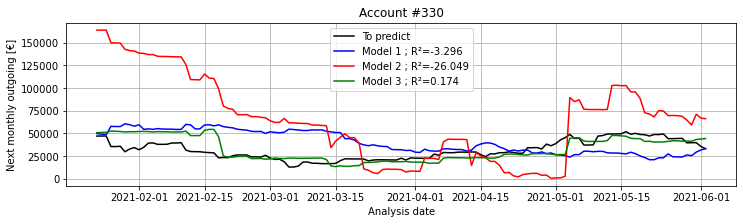

Account #331


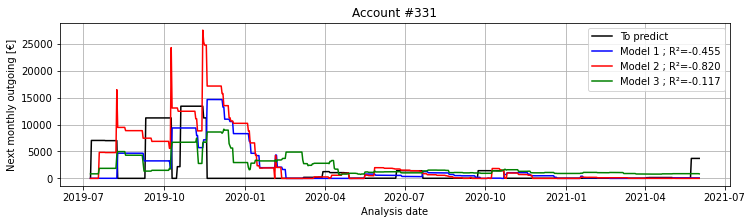

Account #332
No sufficient history for validation of prediction model
Account #333
No sufficient history for validation of prediction model
Account #334
No sufficient history for validation of prediction model
Account #335


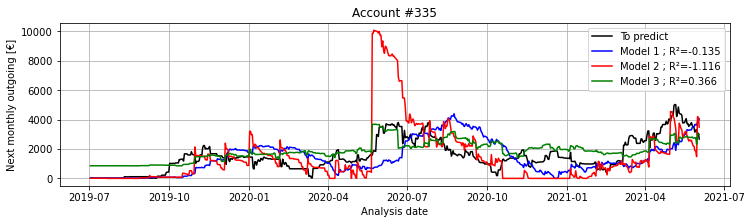

Account #336


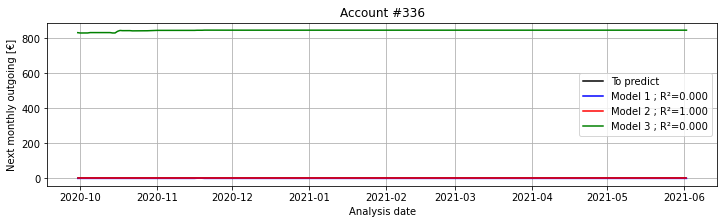

Account #337
No sufficient history for validation of prediction model
Account #338
No sufficient history for validation of prediction model
Account #339


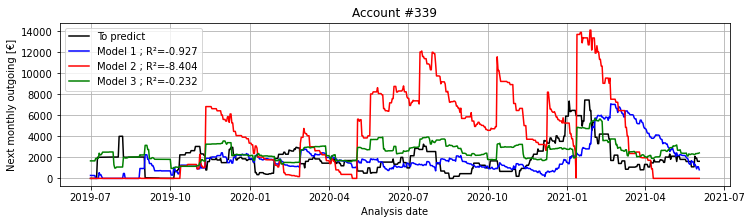

Account #340


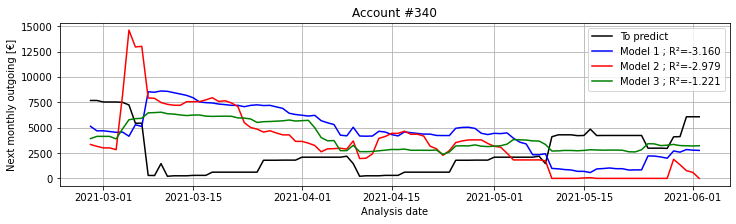

Account #341
No sufficient history for validation of prediction model
Account #342
No sufficient history for validation of prediction model
Account #343


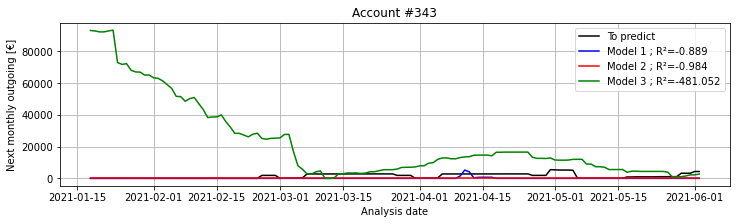

Account #344
No sufficient history for validation of prediction model
Account #345
No sufficient history for validation of prediction model
Account #346
No sufficient history for validation of prediction model
Account #347
No sufficient history for validation of prediction model
Account #348


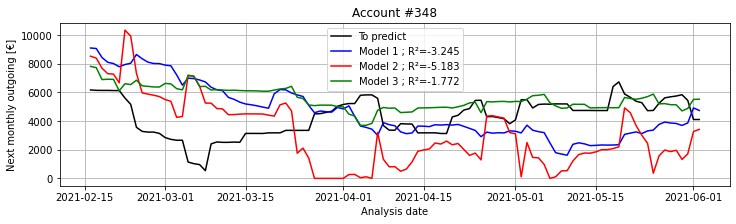

Account #349
No sufficient history for validation of prediction model
Account #350
No sufficient history for validation of prediction model
Account #351
No sufficient history for validation of prediction model
Account #352


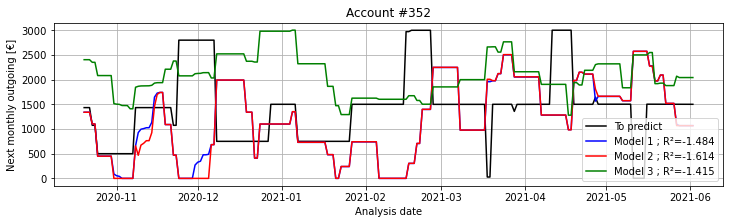

Account #353
No sufficient history for validation of prediction model
Account #354
No sufficient history for validation of prediction model
Account #355


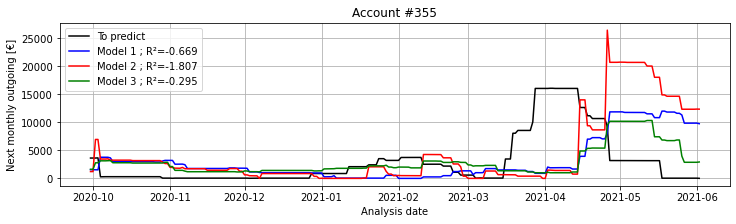

Account #356
No sufficient history for validation of prediction model
Account #357
No sufficient history for validation of prediction model
Account #358
No sufficient history for validation of prediction model
Account #359


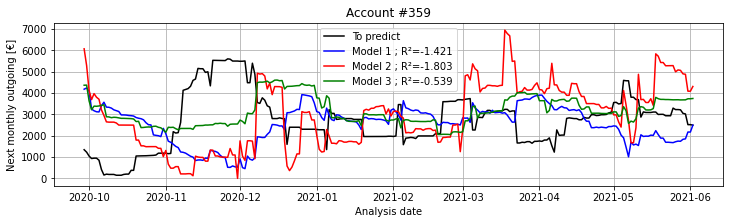

Account #360


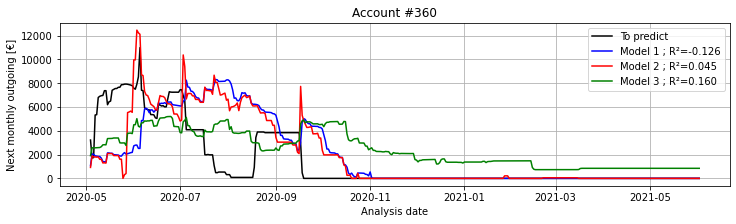

Account #361
No sufficient history for validation of prediction model
Account #362


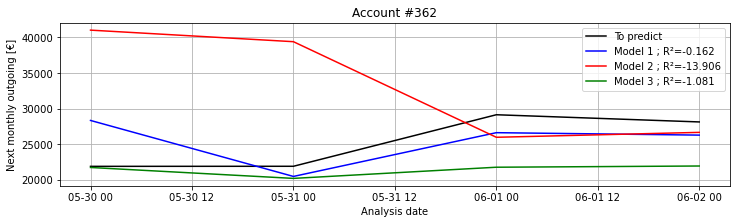

Account #363


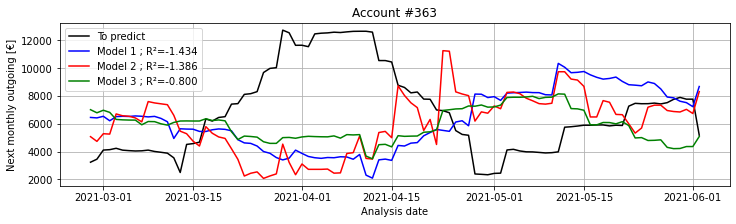

Account #364
No sufficient history for validation of prediction model
Account #365
No sufficient history for validation of prediction model
Account #366


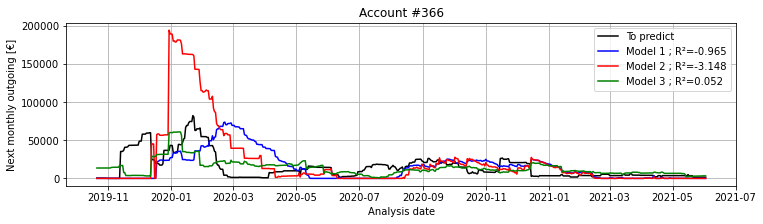

Account #367
No sufficient history for validation of prediction model
Account #368
No sufficient history for validation of prediction model
Account #369


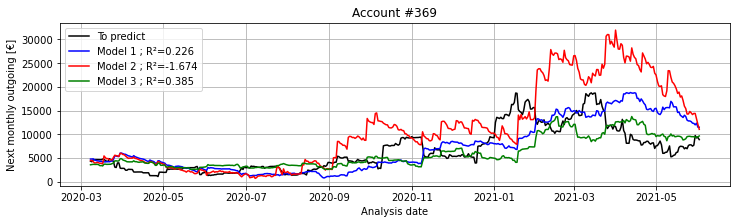

Account #370
No sufficient history for validation of prediction model
Account #371
No sufficient history for validation of prediction model
Account #372
No sufficient history for validation of prediction model
Account #373


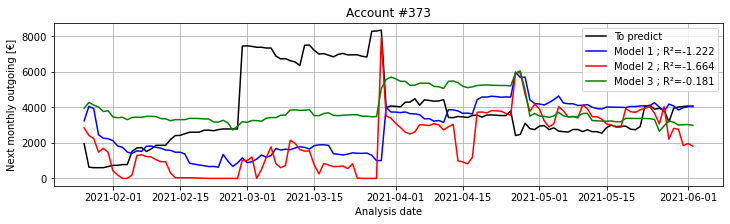

Account #374
No sufficient history for validation of prediction model
Account #375


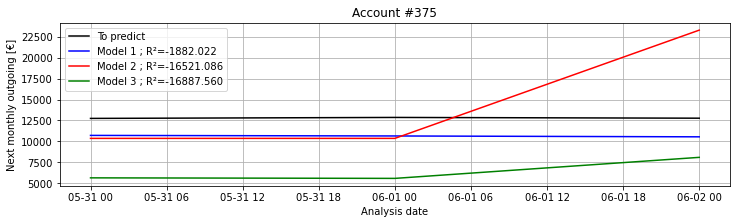

Account #376
No sufficient history for validation of prediction model
Account #377
No sufficient history for validation of prediction model
Account #378


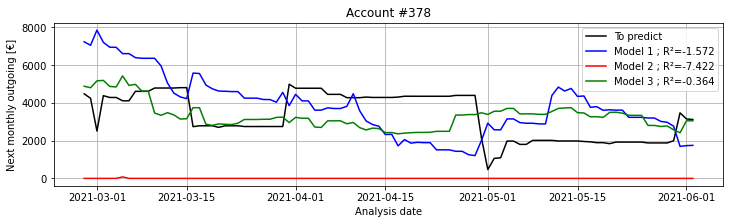

Account #379
No sufficient history for validation of prediction model
Account #380


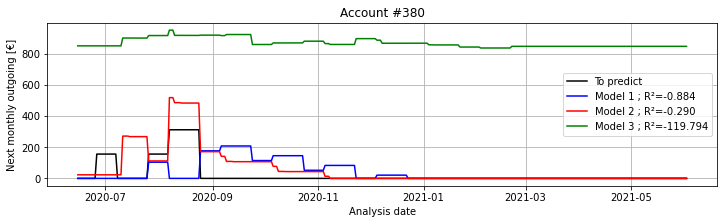

Account #381


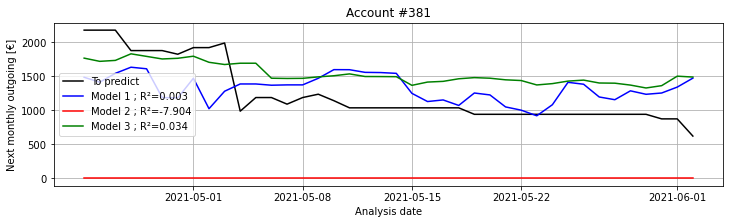

Account #382
No sufficient history for validation of prediction model
Account #383


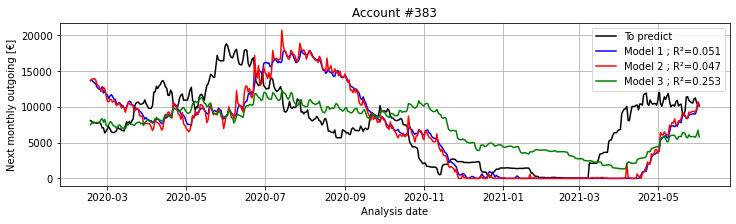

Account #384
No sufficient history for validation of prediction model
Account #385


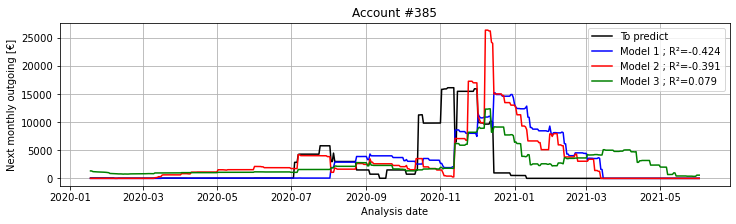

Account #386
No sufficient history for validation of prediction model
Account #387


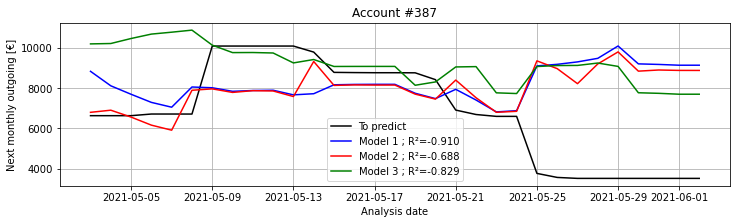

Account #388


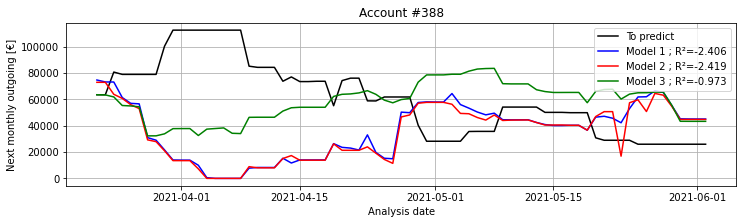

Account #389
No sufficient history for validation of prediction model
Account #390


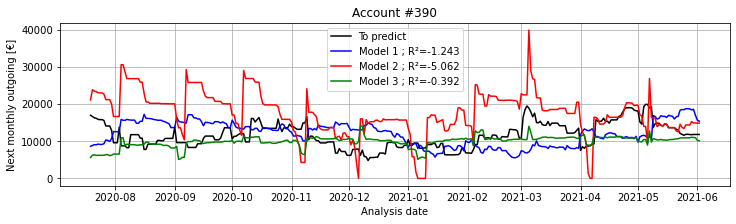

Account #391


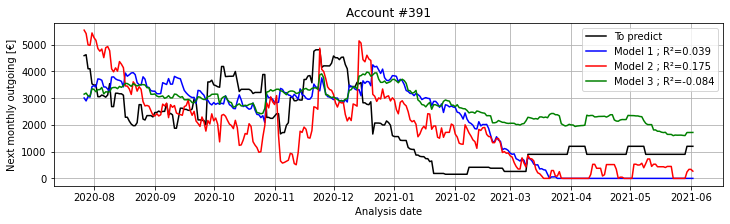

Account #392


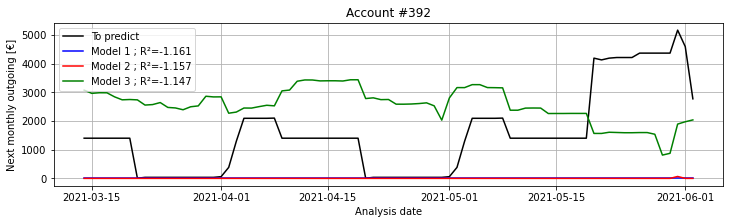

Account #393


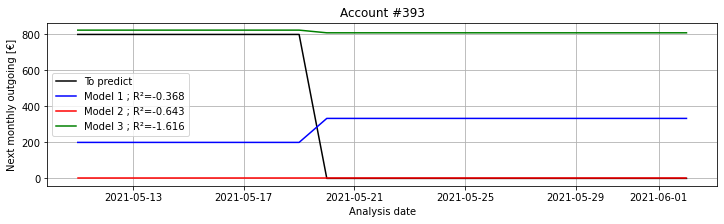

Account #394


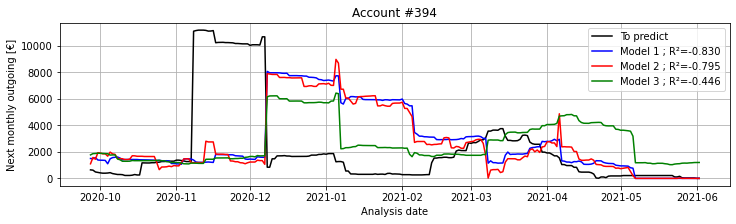

Account #395


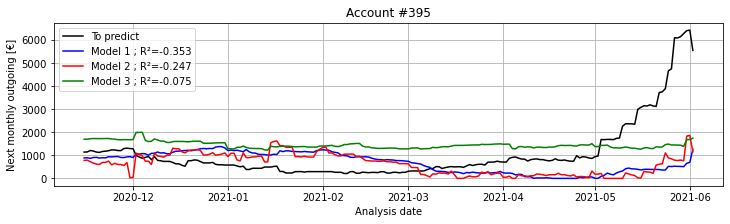

Account #396


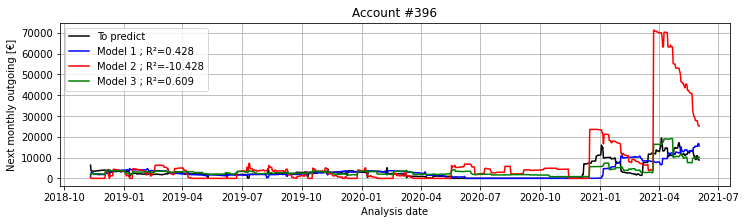

Account #397


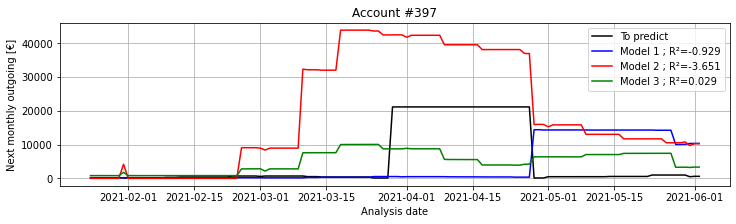

Account #398


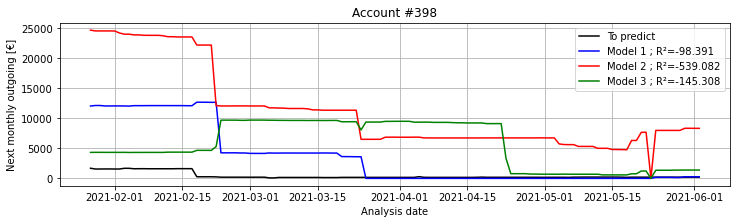

Account #399


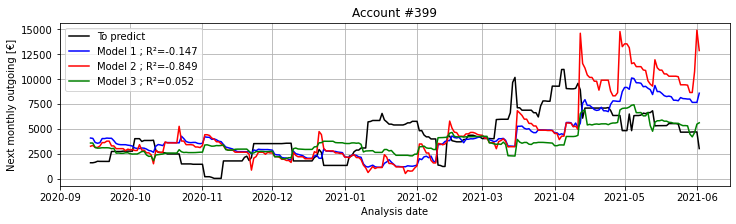

Account #400


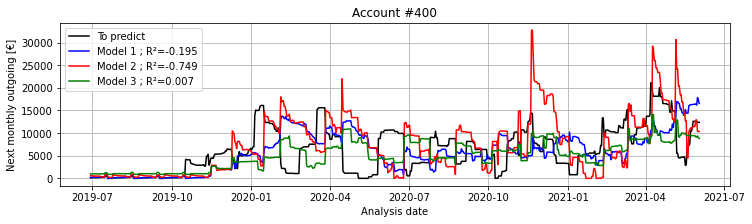

Account #401


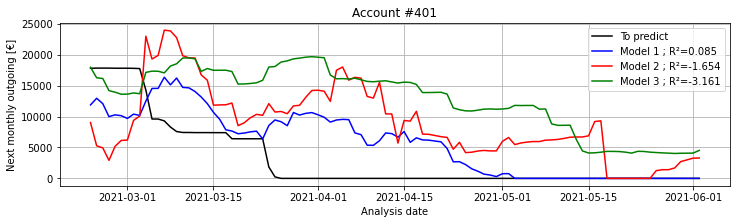

Account #402
No sufficient history for validation of prediction model
Account #403


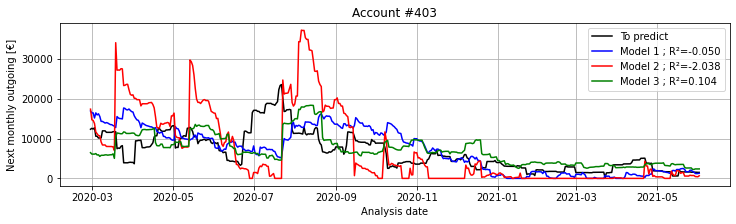

Account #404


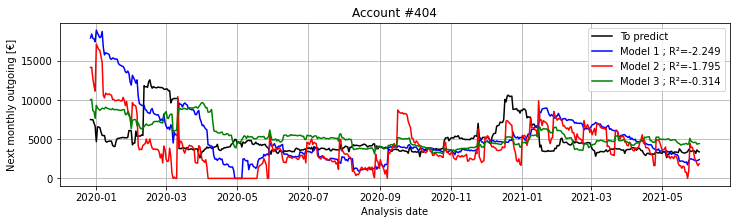

Account #405


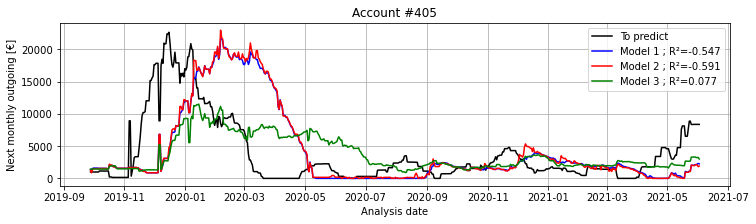

Account #406
No sufficient history for validation of prediction model
Account #407
No sufficient history for validation of prediction model
Account #408


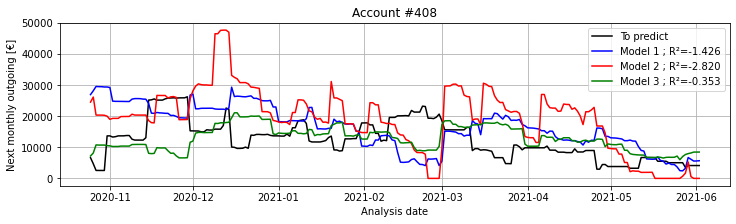

Account #409
No sufficient history for validation of prediction model
Account #410


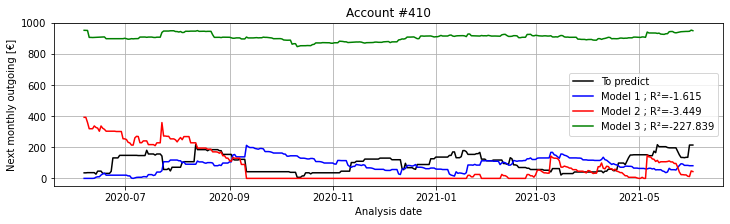

Account #411
No sufficient history for validation of prediction model
Account #412
No sufficient history for validation of prediction model
Account #413


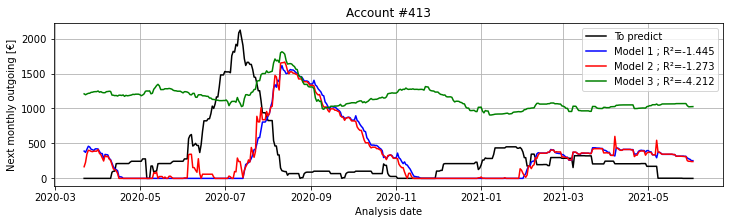

Account #414


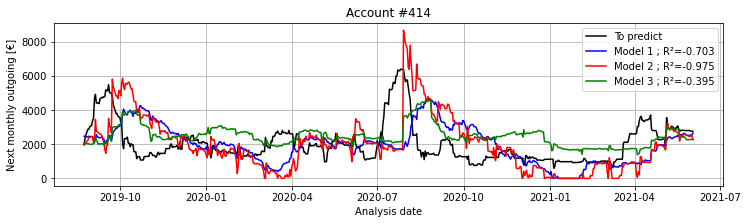

Account #415


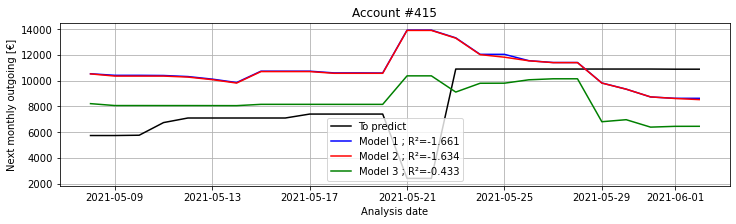

Account #416


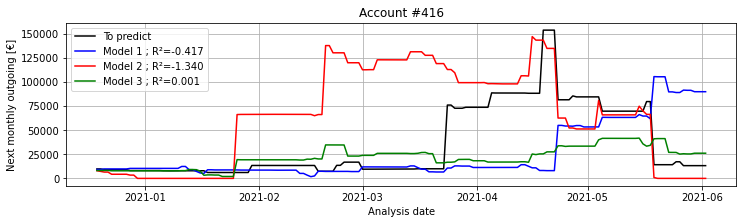

Account #417
No sufficient history for validation of prediction model
Account #418


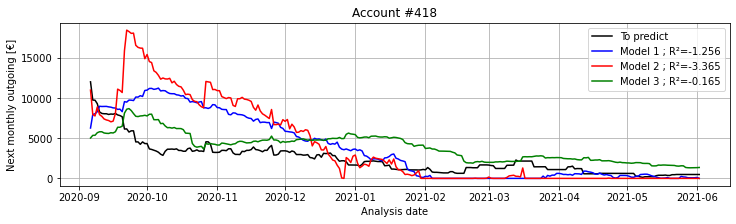

Account #419
No sufficient history for validation of prediction model
Account #420


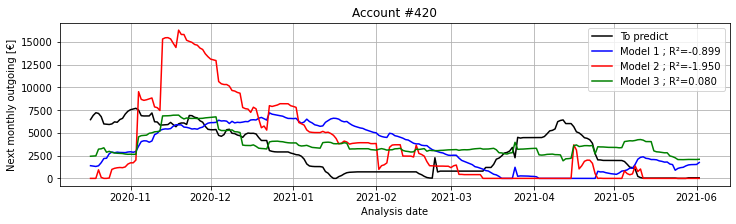

Account #421
No sufficient history for validation of prediction model
Account #422
No sufficient history for validation of prediction model
Account #423
No sufficient history for validation of prediction model
Account #424


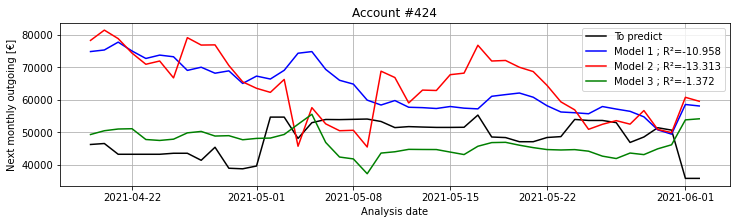

Account #425


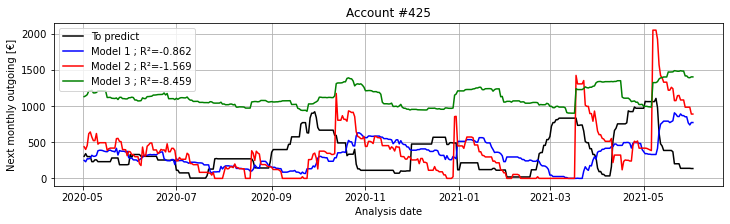

Account #426


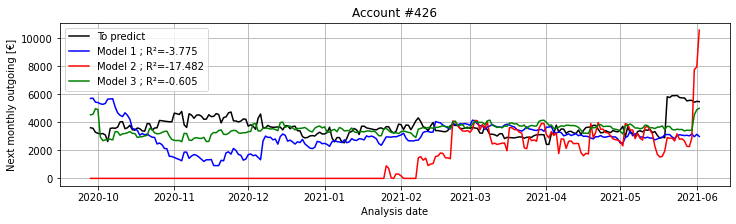

Account #427


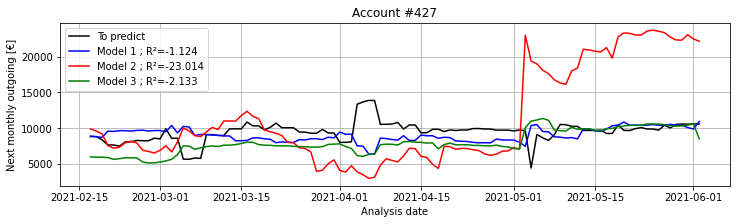

Account #428


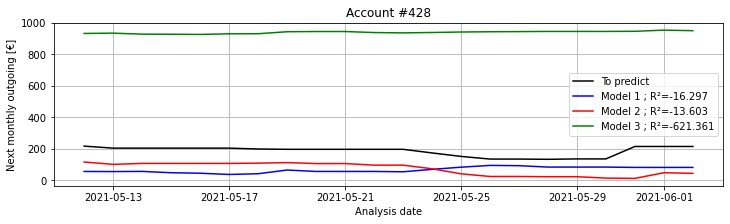

Account #429


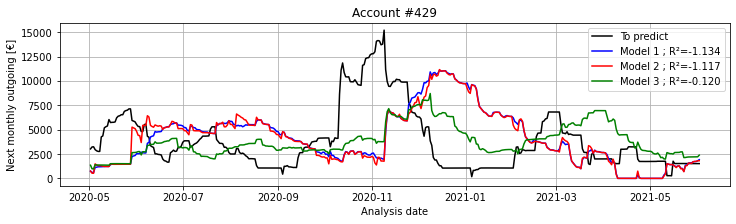

Account #430
No sufficient history for validation of prediction model
Account #431


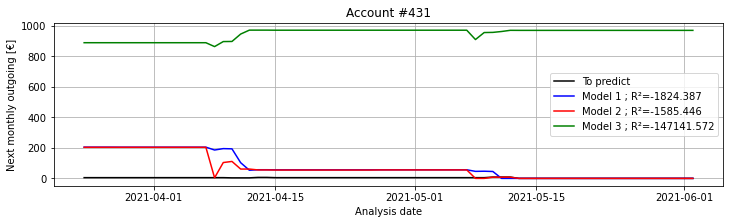

Account #432


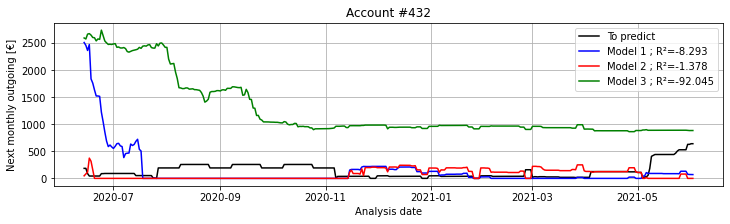

Account #433
No sufficient history for validation of prediction model
Account #434


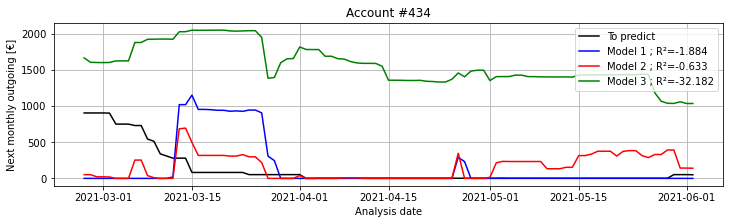

Account #435
No sufficient history for validation of prediction model
Account #436


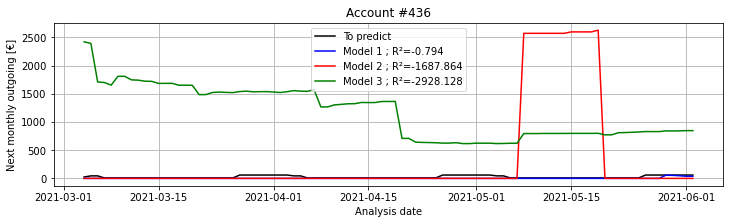

Account #437


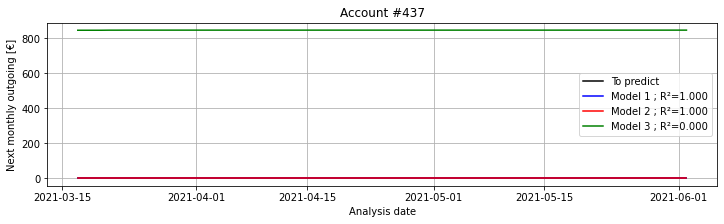

Account #438
No sufficient history for validation of prediction model
Account #439


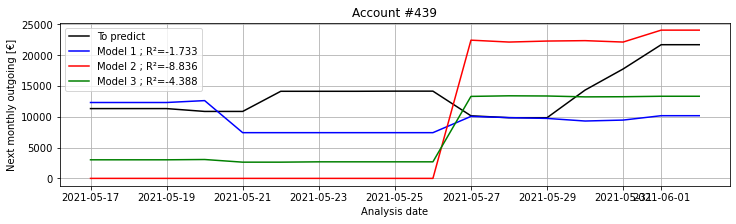

Account #440


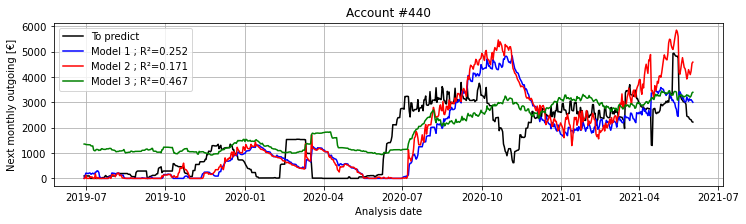

Account #441
No sufficient history for validation of prediction model
Account #442
No sufficient history for validation of prediction model
Account #443
No sufficient history for validation of prediction model
Account #444


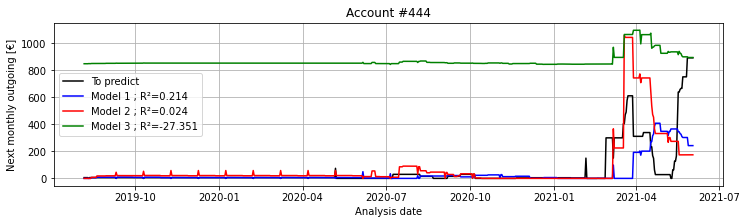

Account #445


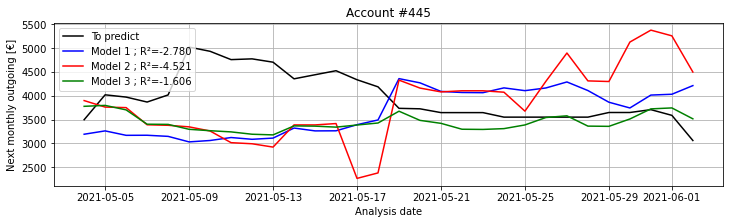

Account #446


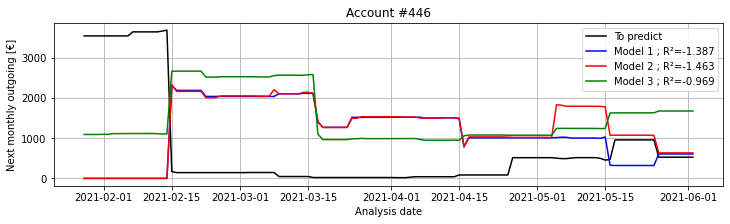

Account #447


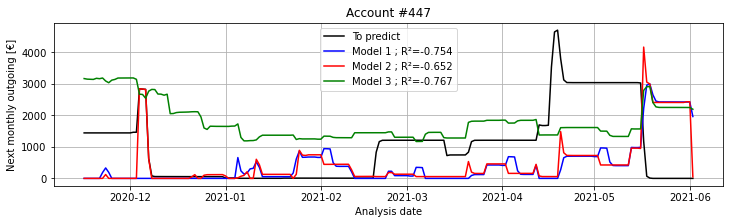

Account #448


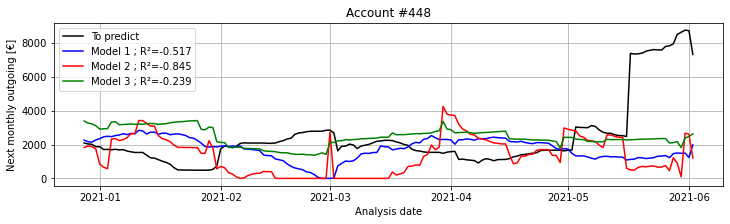

Account #449
No sufficient history for validation of prediction model
Account #450
No sufficient history for validation of prediction model
Account #451


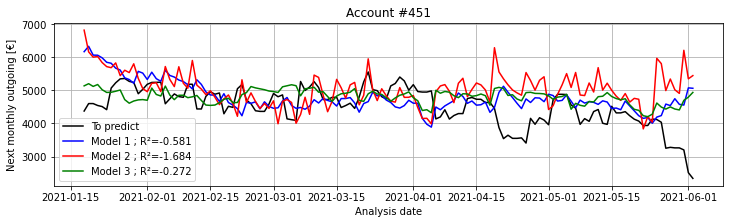

Account #452


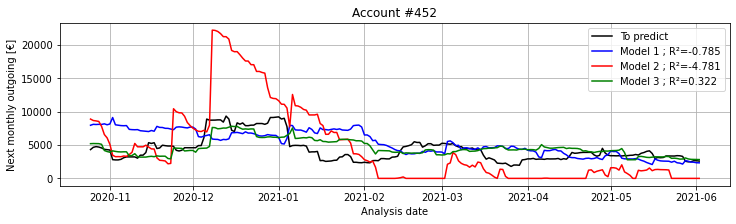

Account #453


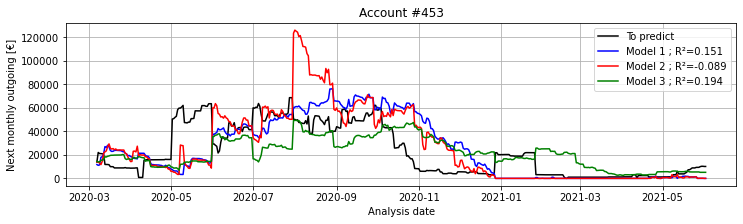

Account #454


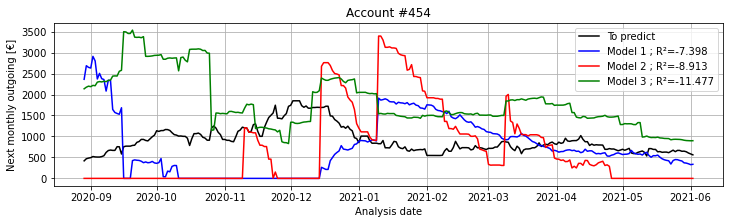

Account #455
No sufficient history for validation of prediction model
Account #456
No sufficient history for validation of prediction model
Account #457


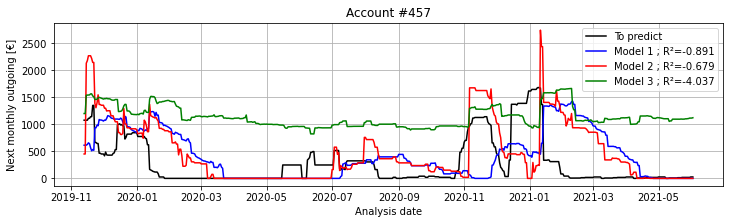

Account #458


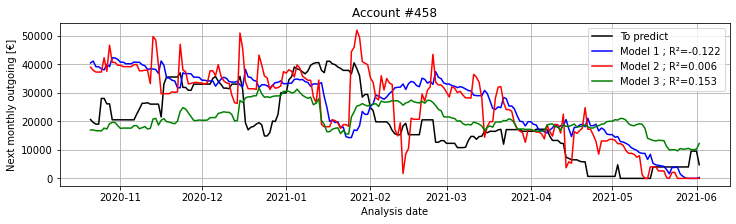

Account #459


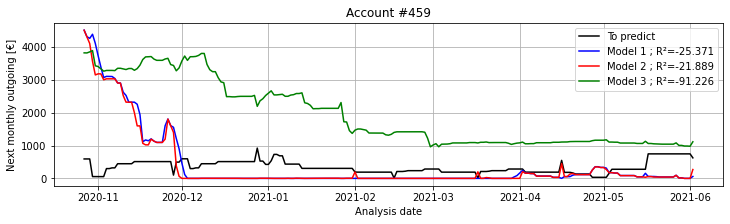

Account #460
No sufficient history for validation of prediction model
Account #461


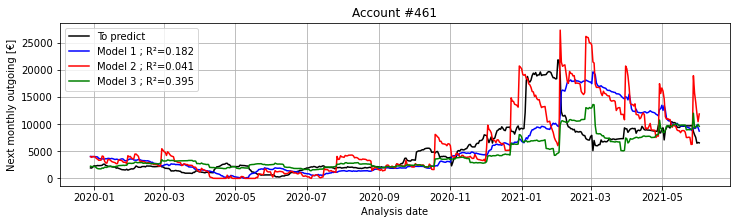

Account #462


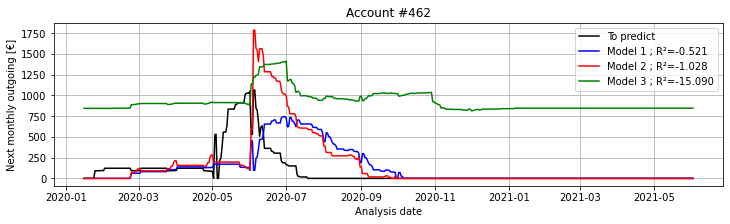

Account #463
No sufficient history for validation of prediction model
Account #464


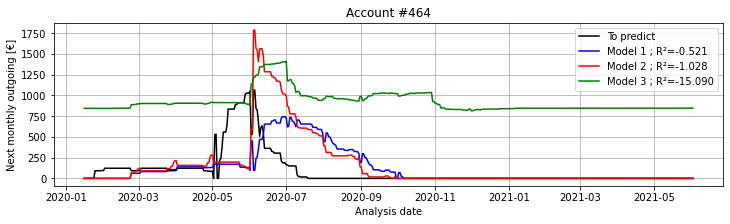

Account #465
No sufficient history for validation of prediction model
Account #466


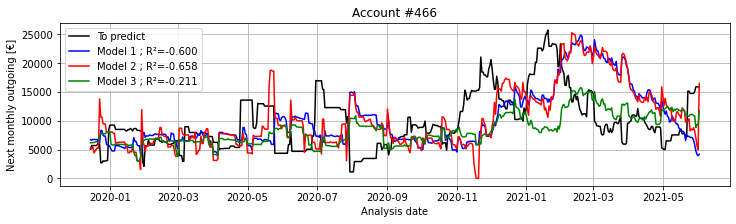

Account #467
No sufficient history for validation of prediction model
Account #468
No sufficient history for validation of prediction model
Account #469
No sufficient history for validation of prediction model
Account #470
No sufficient history for validation of prediction model
Account #471


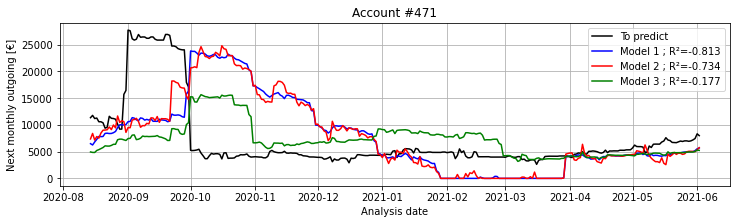

Account #472


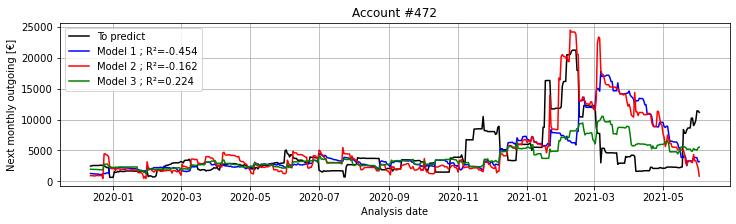

Account #473
No sufficient history for validation of prediction model
Account #474
No sufficient history for validation of prediction model
Account #475


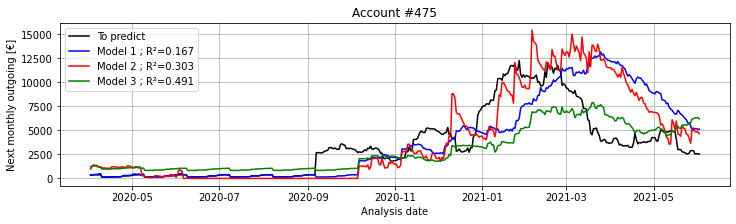

Account #476
No sufficient history for validation of prediction model
Account #477


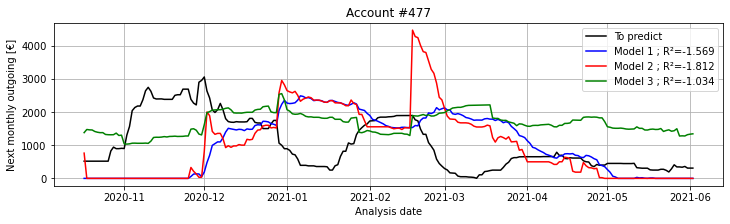

Account #478


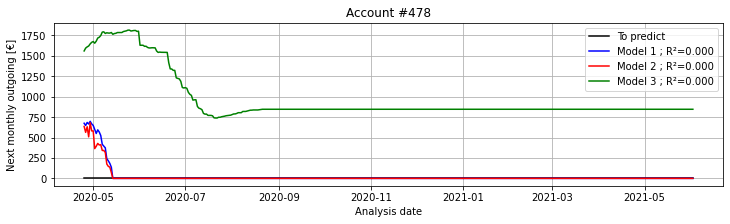

Account #479


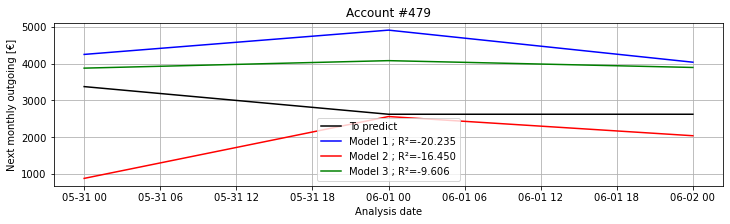

Account #480


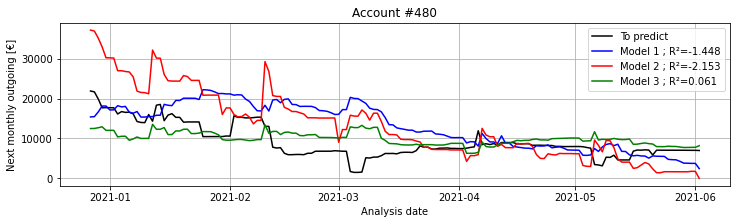

Account #481


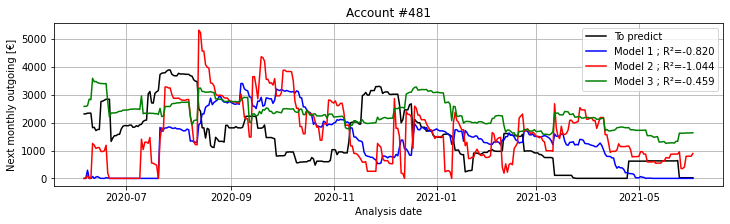

Account #482
No sufficient history for validation of prediction model
Account #483
No sufficient history for validation of prediction model
Account #484


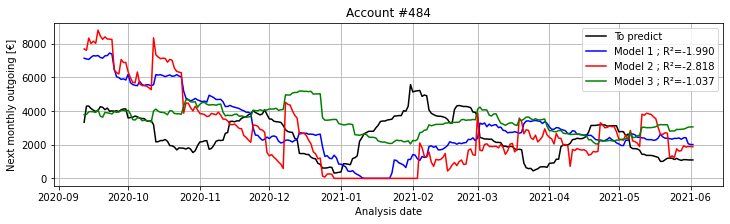

Account #485


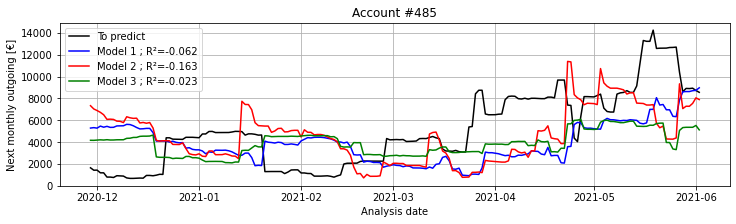

Account #486


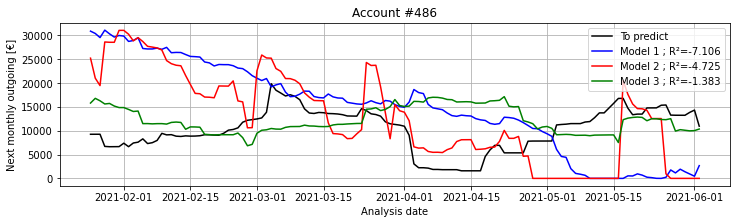

Account #487
No sufficient history for validation of prediction model
Account #488
No sufficient history for validation of prediction model
Account #489


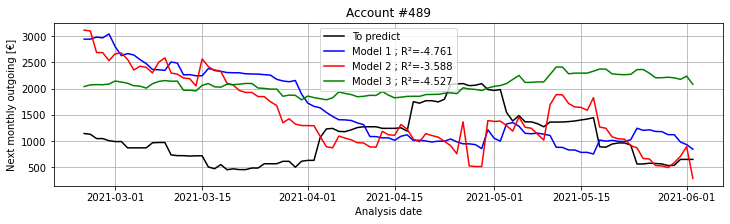

Account #490


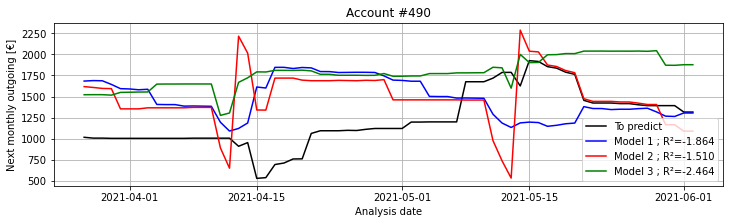

Account #491


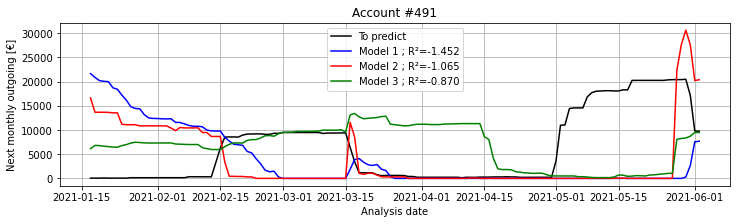

Account #492


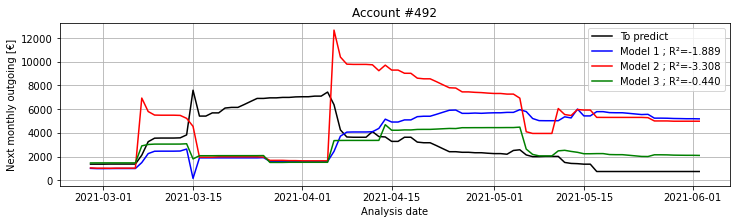

Account #493
No sufficient history for validation of prediction model
Account #494


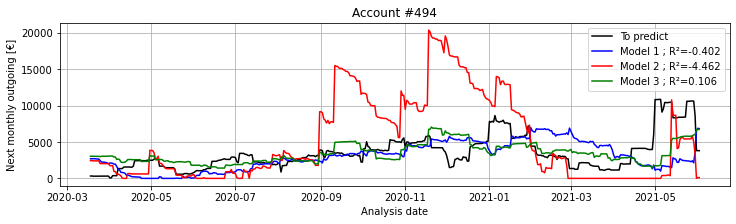

Account #495


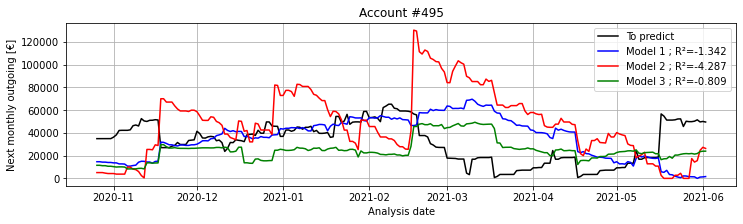

Account #496
No sufficient history for validation of prediction model
Account #497
No sufficient history for validation of prediction model
Account #498


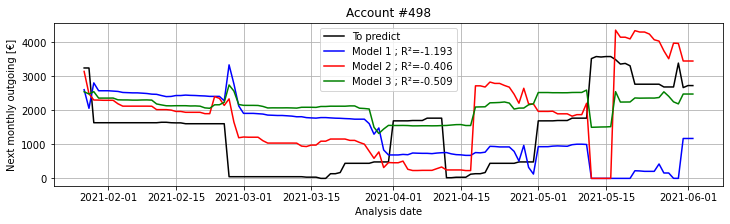

Account #499


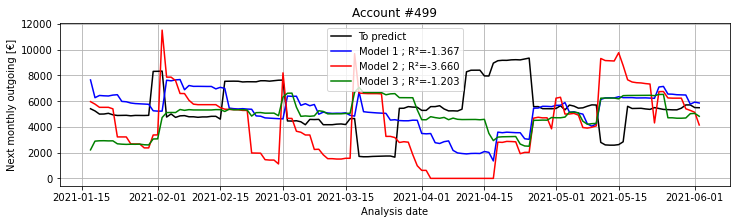

Account #500
No sufficient history for validation of prediction model
Account #501


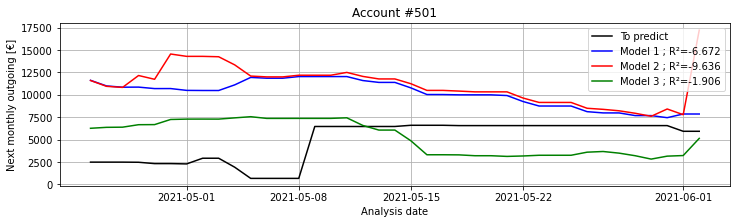

Account #502
No sufficient history for validation of prediction model
Account #503


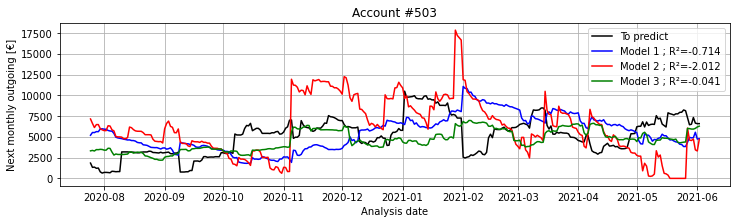

Account #504
No sufficient history for validation of prediction model
Account #505
No sufficient history for validation of prediction model
Account #506
No sufficient history for validation of prediction model
Account #507


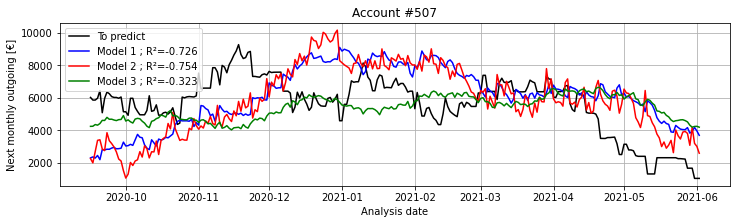

Account #508


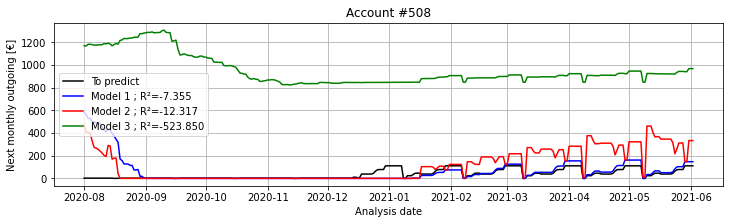

Account #509
No sufficient history for validation of prediction model
Account #510


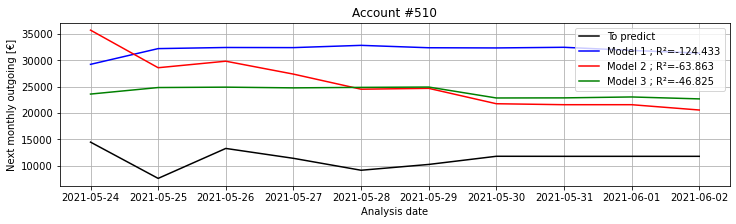

Account #511
No sufficient history for validation of prediction model
Account #512


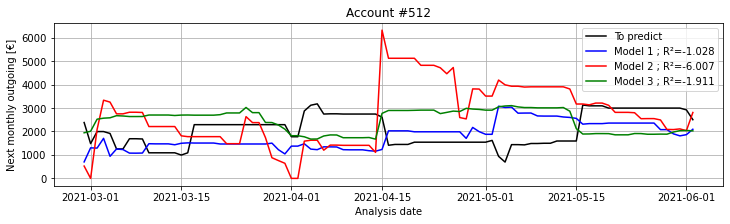

Account #513


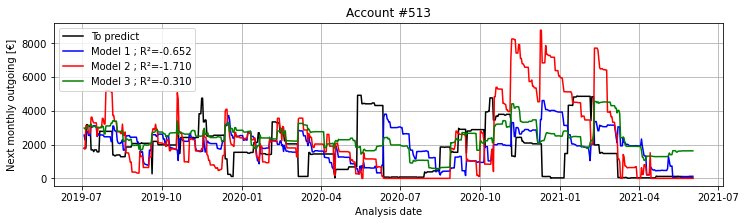

Account #514


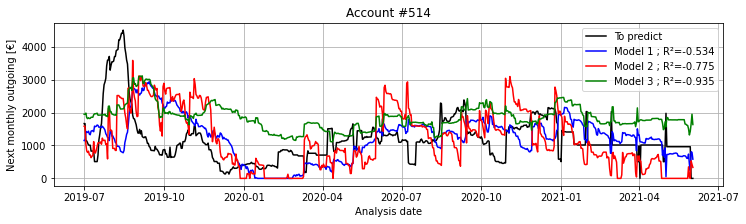

Account #515
No sufficient history for validation of prediction model
Account #516


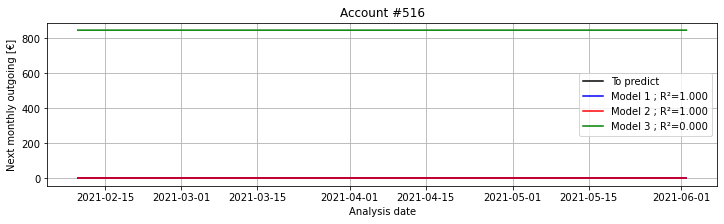

Account #517
No sufficient history for validation of prediction model
Account #518
No sufficient history for validation of prediction model
Account #519


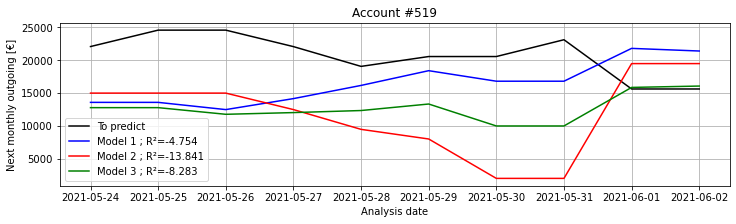

Account #520


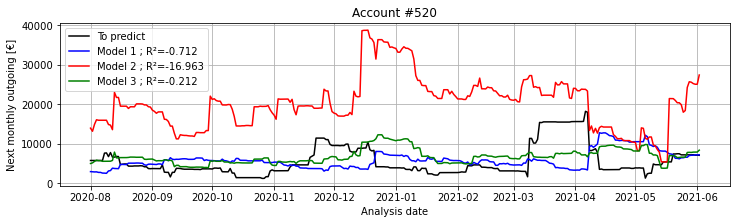

Account #521


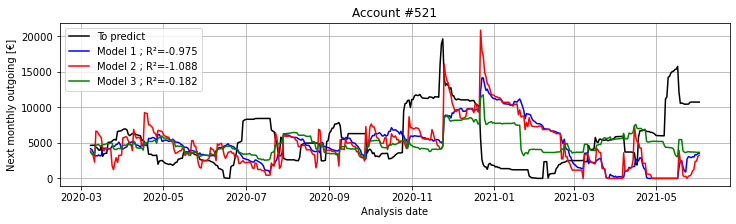

Account #522


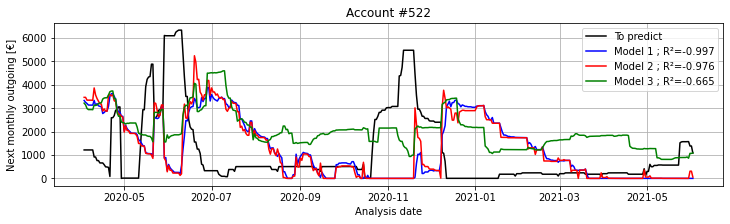

Account #523


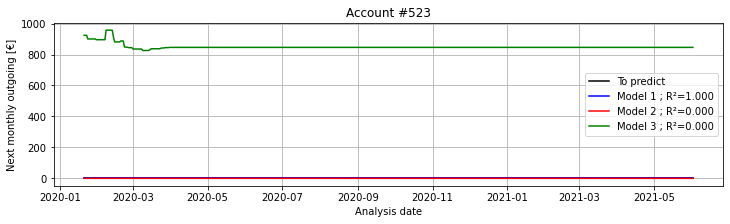

Account #524


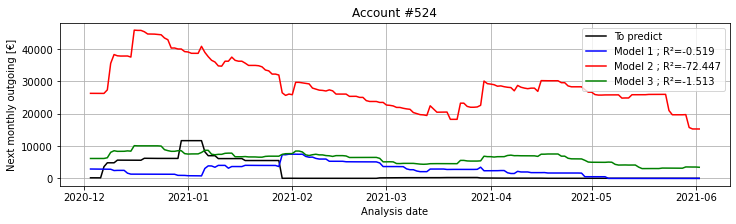

Account #525
No sufficient history for validation of prediction model
Account #526


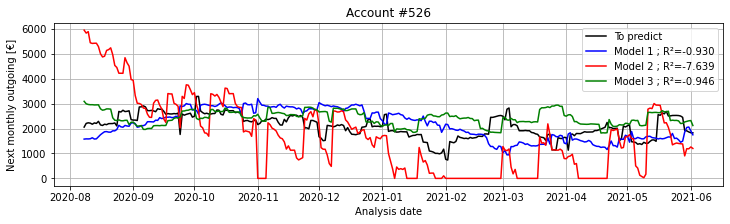

Account #527


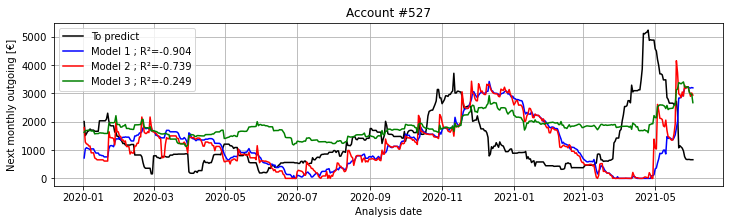

Account #528


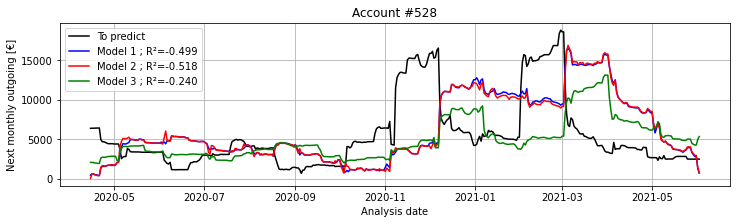

Account #529


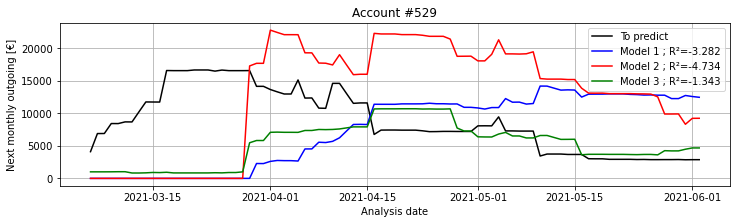

Account #530


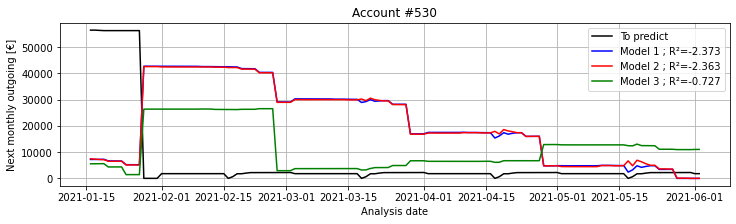

Account #531
No sufficient history for validation of prediction model
Account #532
No sufficient history for validation of prediction model
Account #533
No sufficient history for validation of prediction model
Account #534
No sufficient history for validation of prediction model
Account #535


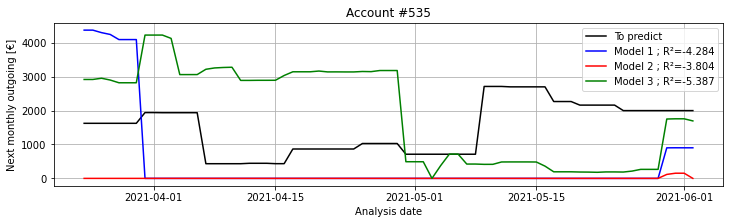

Account #536


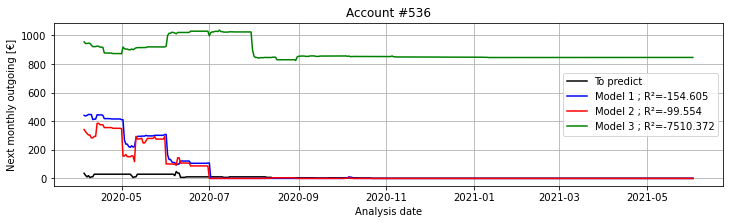

Account #537


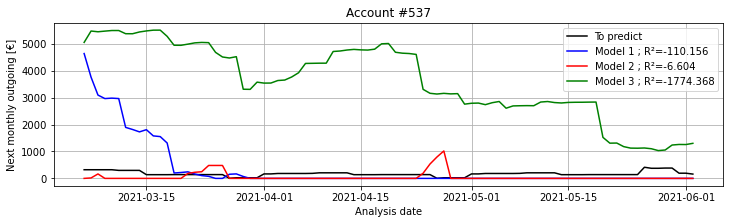

Account #538
No sufficient history for validation of prediction model
Account #539


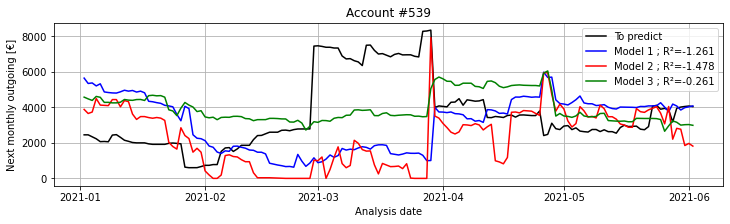

Account #540
No sufficient history for validation of prediction model
Account #541


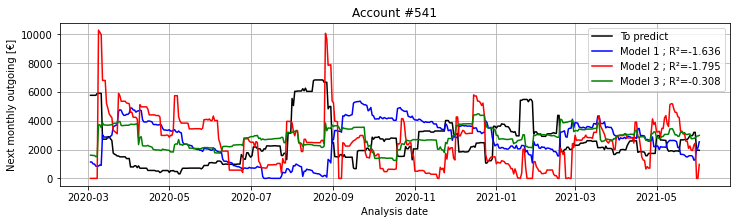

Account #542
No sufficient history for validation of prediction model
Account #543


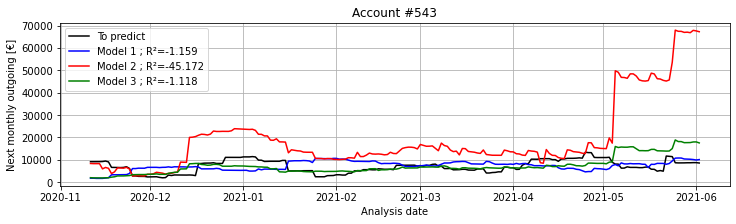

Account #544
No sufficient history for validation of prediction model
Account #545


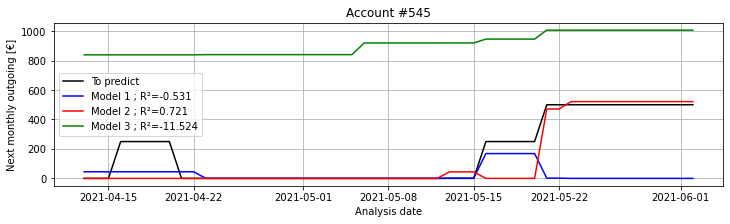

Account #546


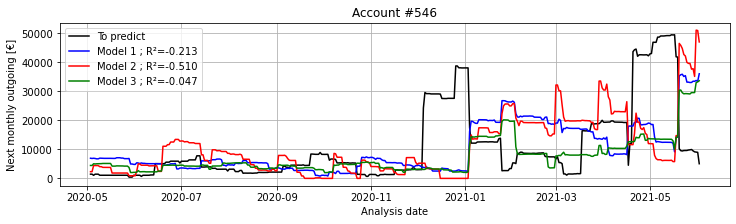

Account #547


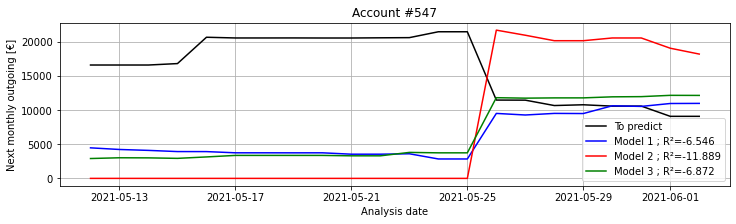

Account #548
No sufficient history for validation of prediction model
Account #549


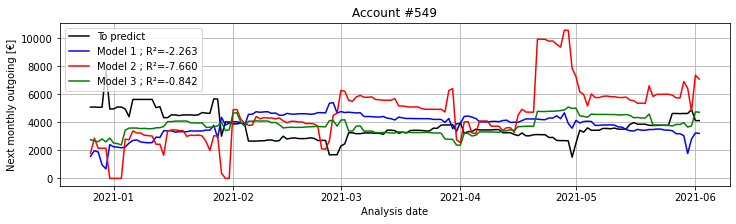

Account #550
No sufficient history for validation of prediction model
Account #551
No sufficient history for validation of prediction model
Account #552


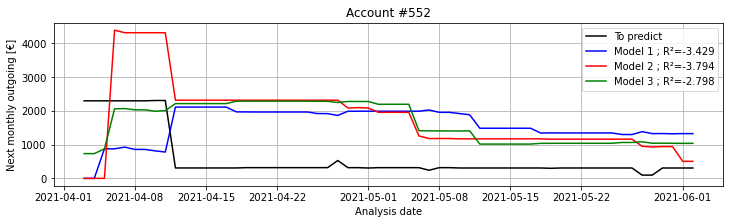

Account #553


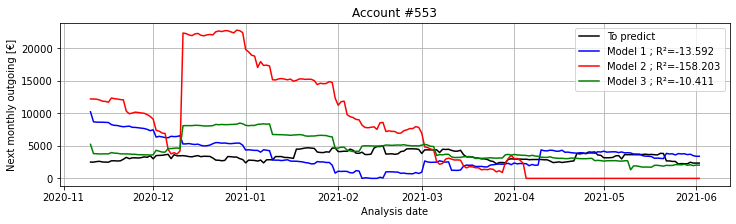

Account #554
No sufficient history for validation of prediction model
Account #555


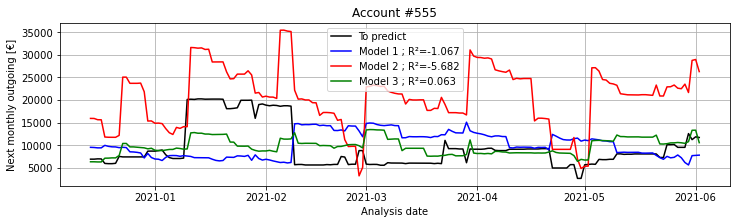

Account #556


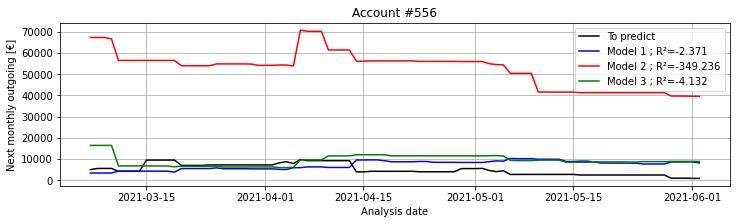

Account #557


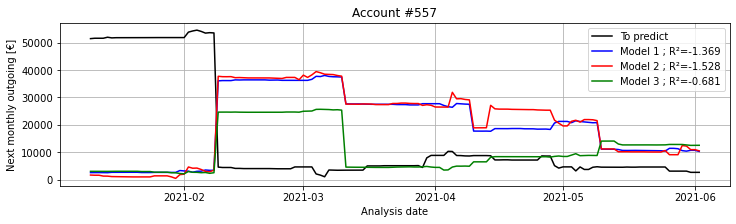

Account #558


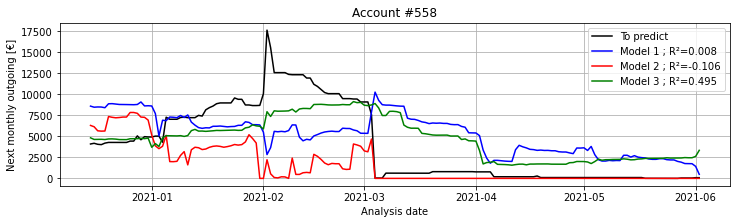

Account #559
No sufficient history for validation of prediction model
Account #560
No sufficient history for validation of prediction model
Account #561
No sufficient history for validation of prediction model
Account #562


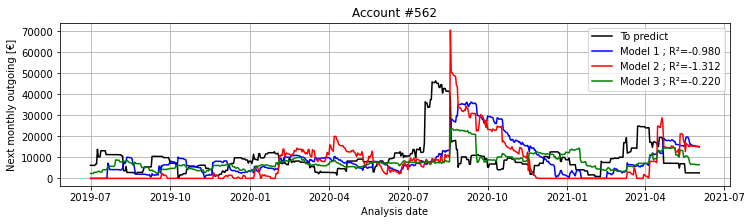

Account #563
No sufficient history for validation of prediction model
Account #564


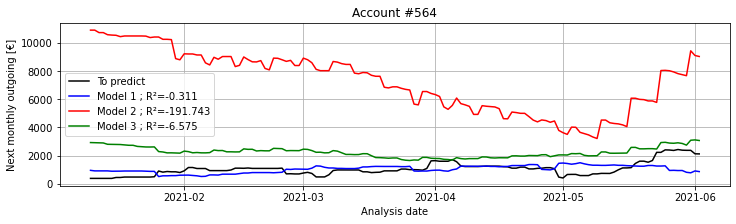

Account #565


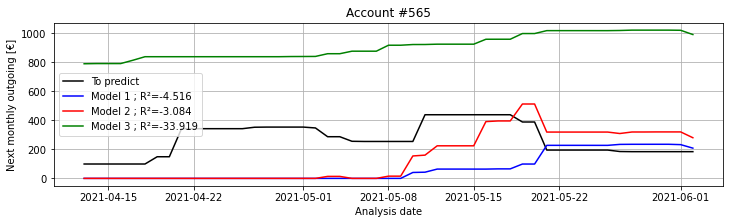

Account #566


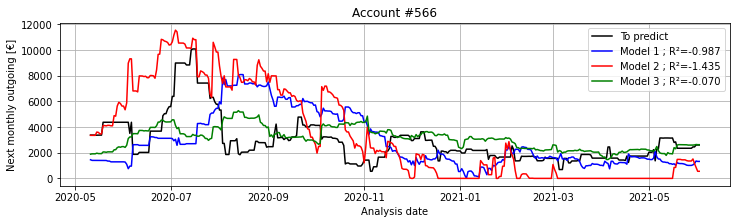

Account #567


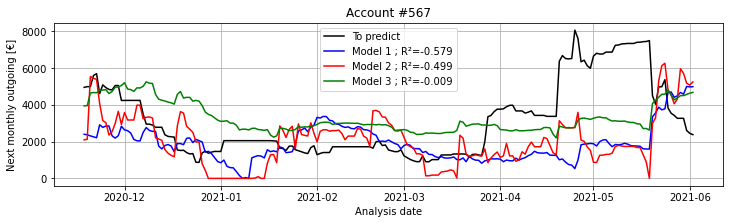

Account #568


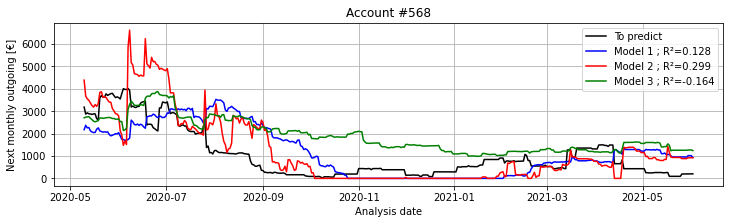

Account #569


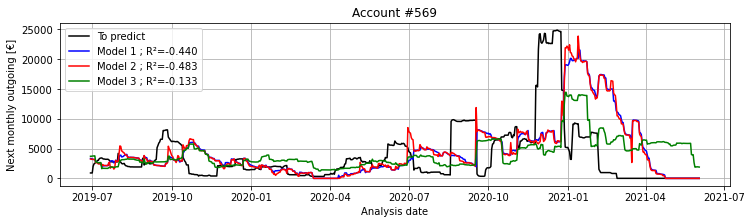

Account #570
No sufficient history for validation of prediction model
Account #571
No sufficient history for validation of prediction model
Account #572


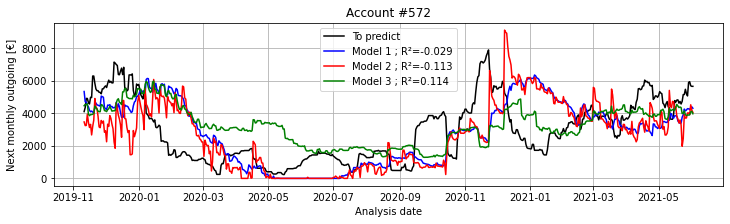

Account #573


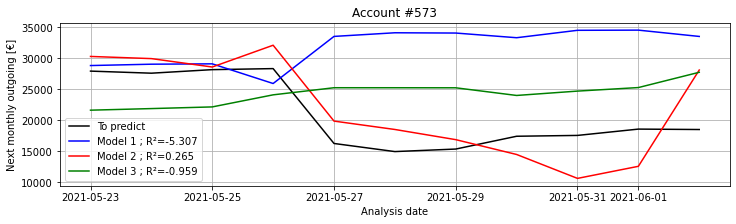

Account #574


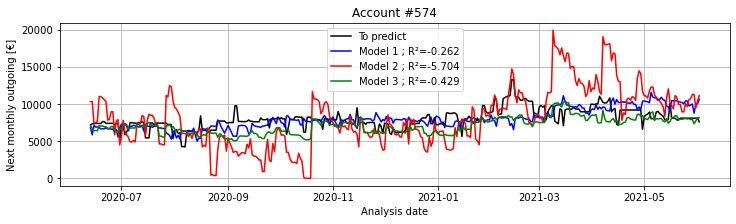

Account #575


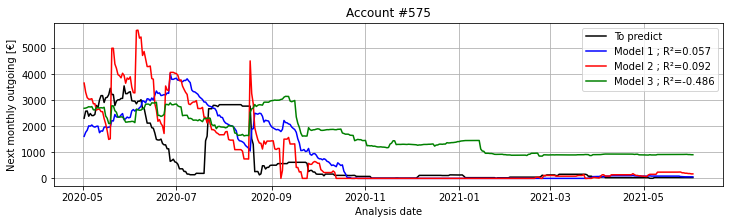

Account #576


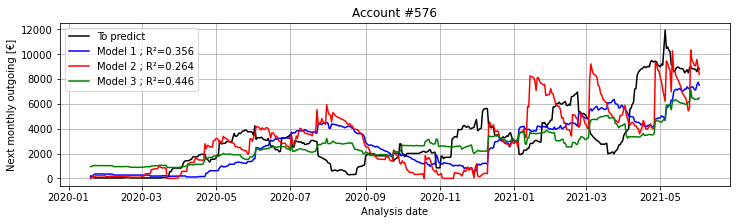

Account #577
No sufficient history for validation of prediction model
Account #578


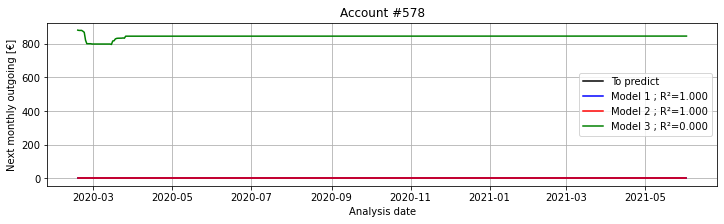

Account #579


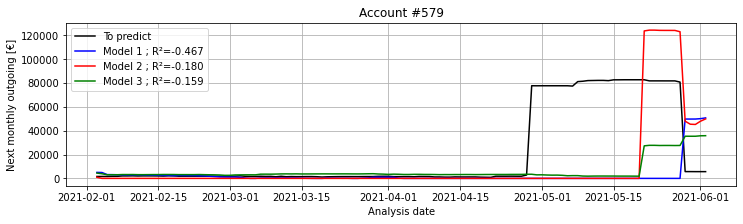

Account #580


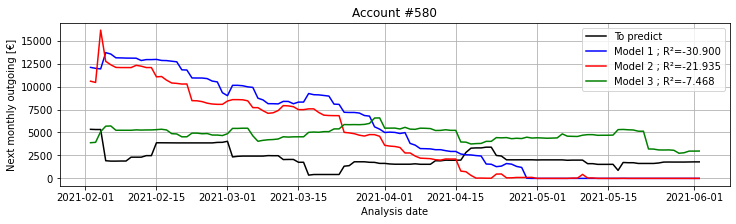

Account #581


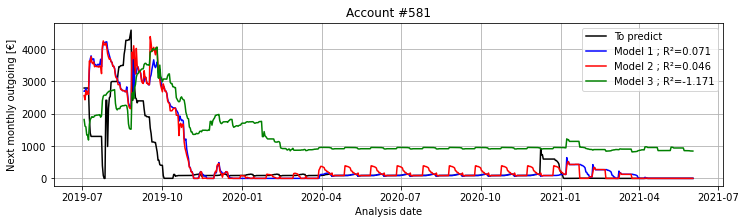

Account #582
No sufficient history for validation of prediction model
Account #583
No sufficient history for validation of prediction model
Account #584


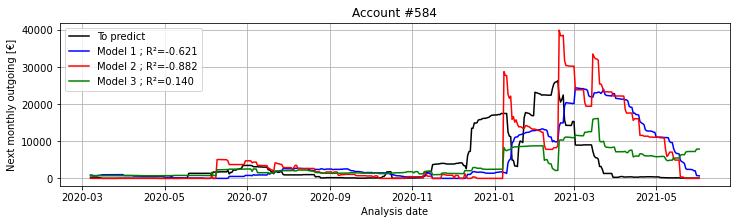

Account #585
No sufficient history for validation of prediction model
Account #586


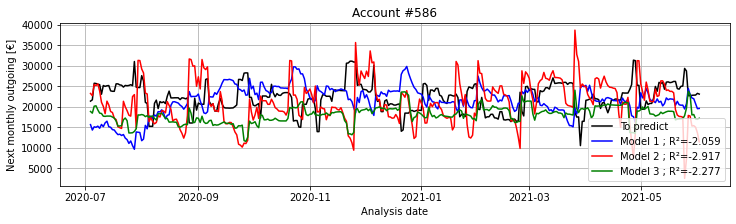

Account #587
No sufficient history for validation of prediction model
Account #588


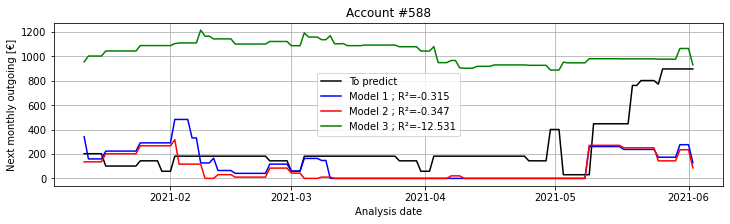

Account #589


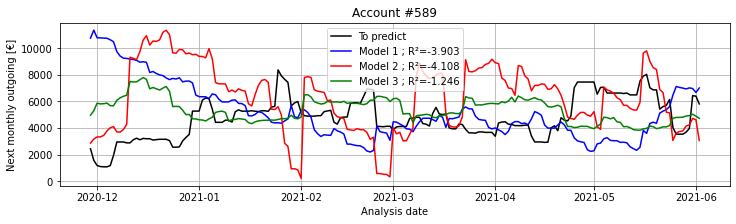

Account #590


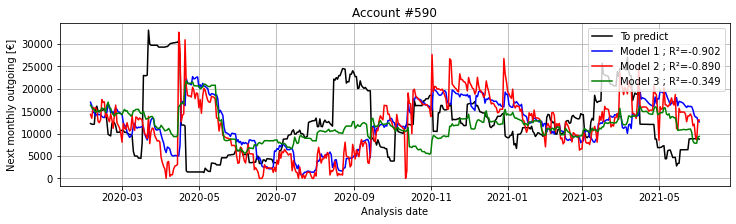

Account #591


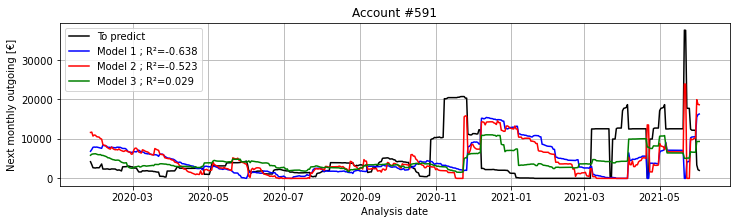

Account #592


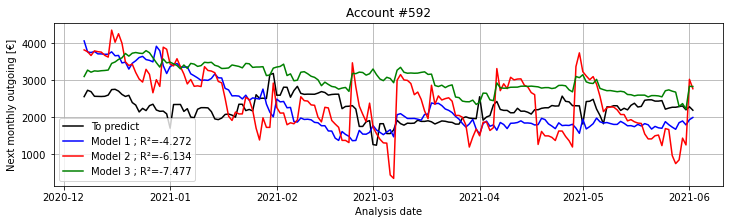

Account #593
No sufficient history for validation of prediction model
Account #594


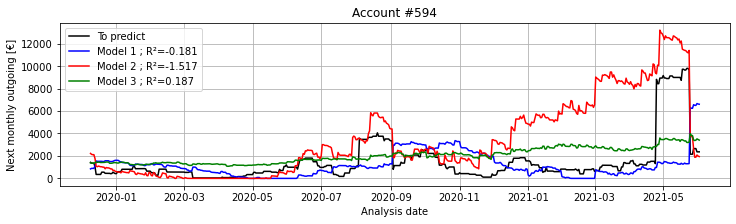

Account #595


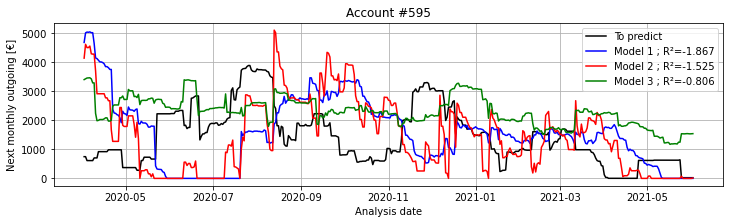

Account #596
No sufficient history for validation of prediction model
Account #597


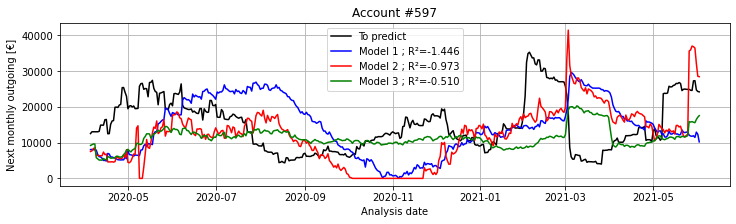

Account #598
No sufficient history for validation of prediction model
Account #599
No sufficient history for validation of prediction model
Account #600
No sufficient history for validation of prediction model
Account #601
No sufficient history for validation of prediction model
Account #602
No sufficient history for validation of prediction model
Account #603


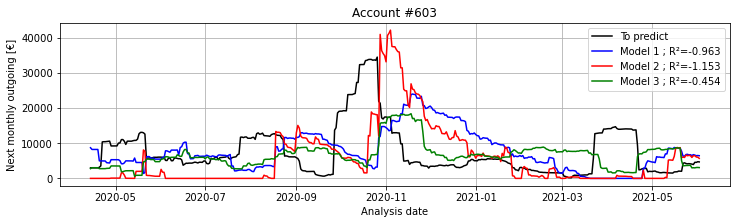

Account #604
No sufficient history for validation of prediction model
Account #605


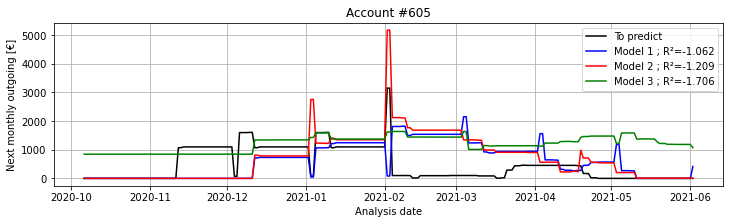

Account #606


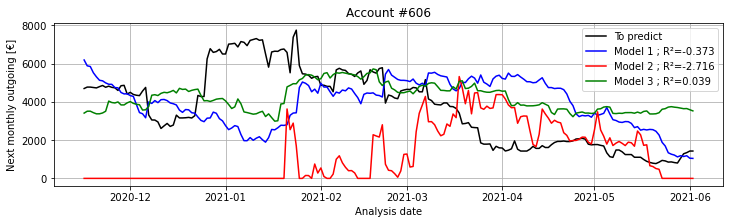

Account #607


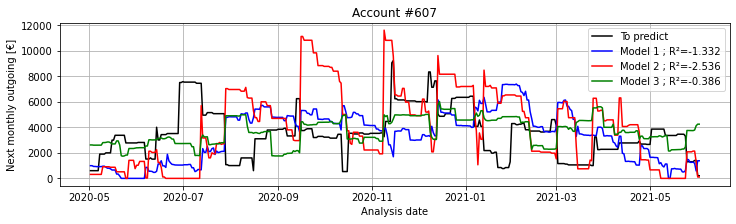

Account #608


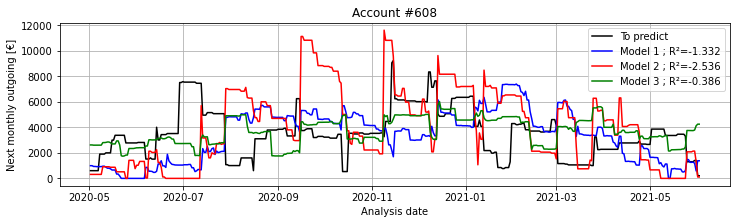

Account #609


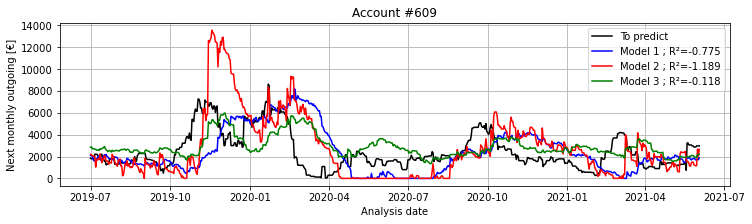

Account #610


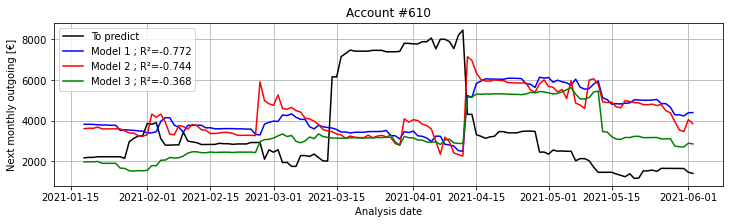

Account #611


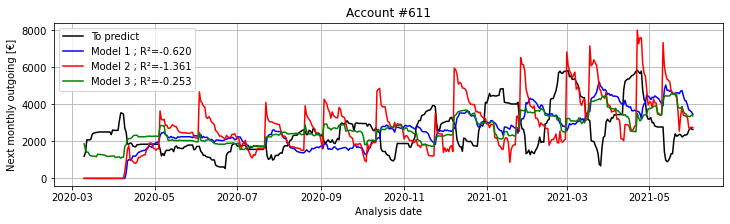

Account #612


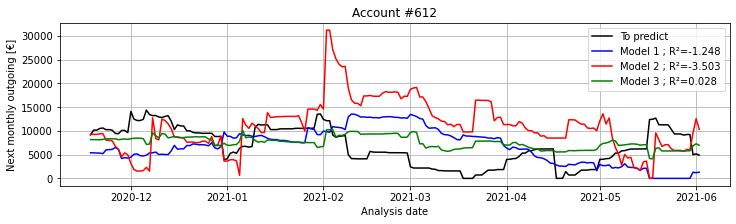

Account #613
No sufficient history for validation of prediction model
Account #614
No sufficient history for validation of prediction model
Account #615


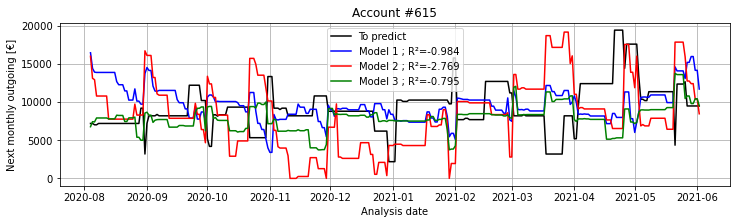

Account #616


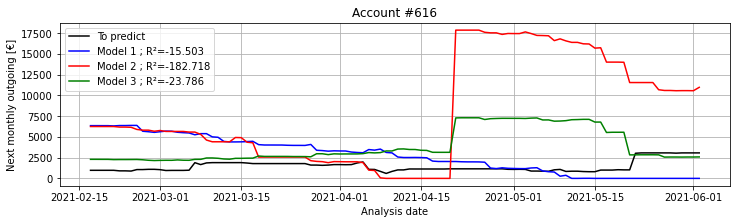

Account #617


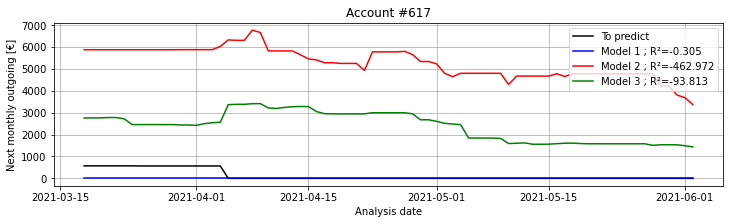

Account #618
No sufficient history for validation of prediction model
Account #619


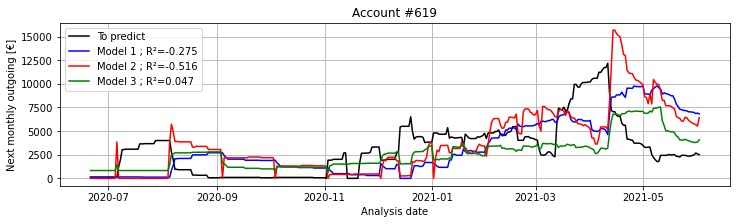

Account #620
No sufficient history for validation of prediction model
Account #621
No sufficient history for validation of prediction model
Account #622
No sufficient history for validation of prediction model
Account #623


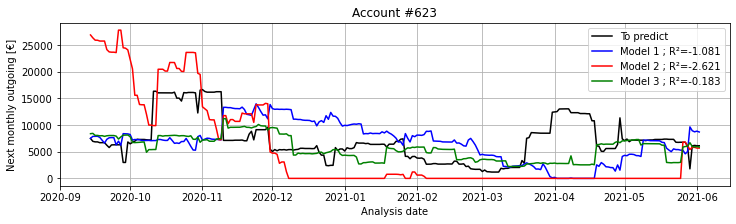

Account #624


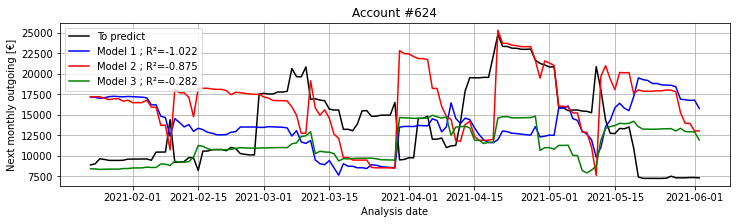

Account #625


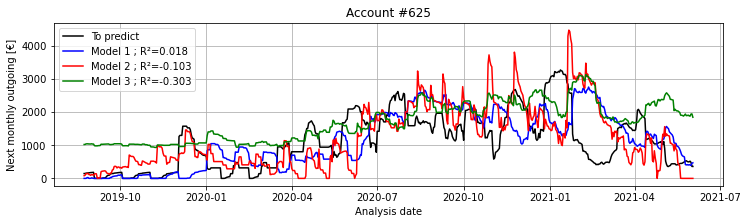

Account #626


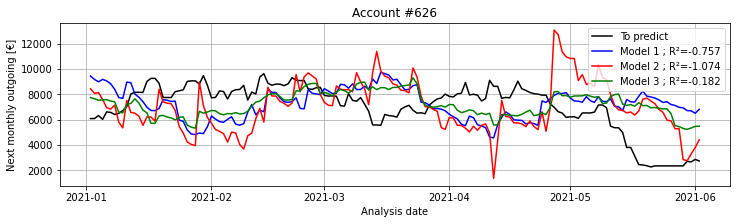

Account #627


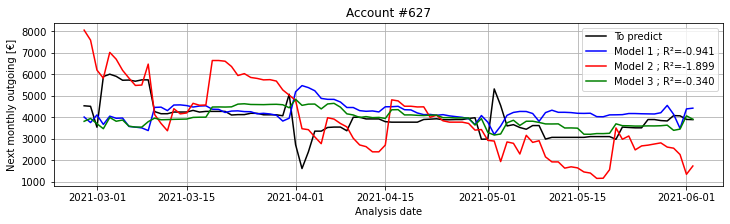

Account #628


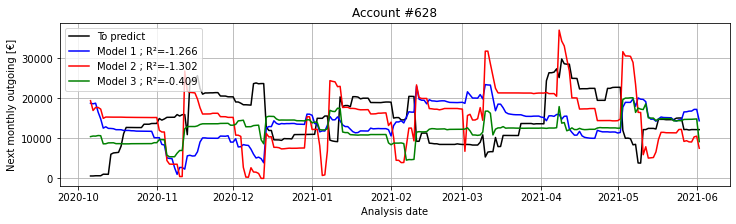

Account #629


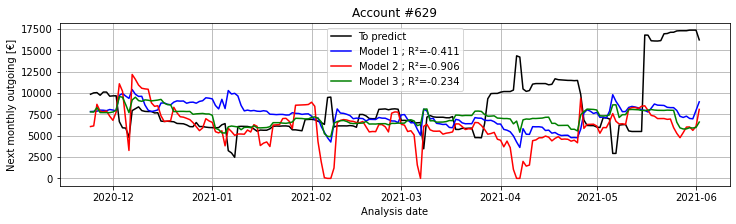

Account #630
No sufficient history for validation of prediction model
Account #631
No sufficient history for validation of prediction model
Account #632


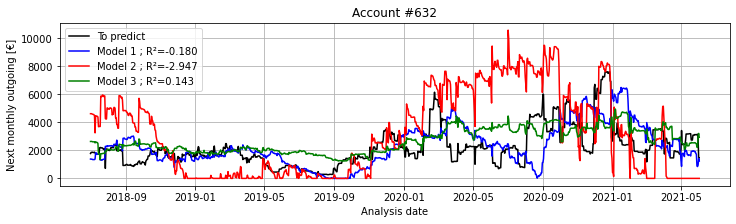

Account #633


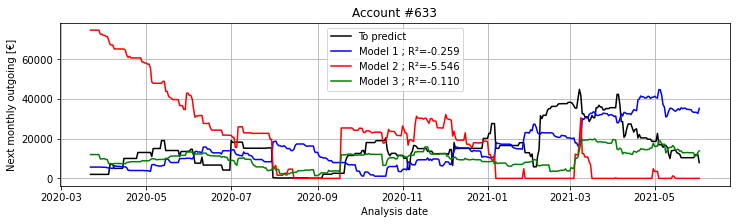

Account #634


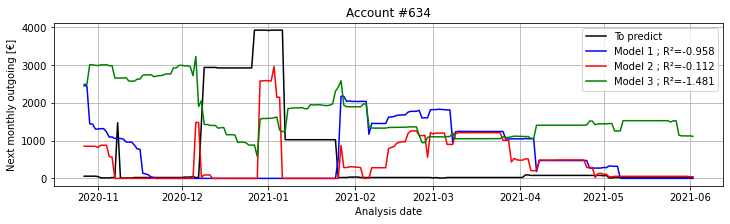

Account #635
No sufficient history for validation of prediction model
Account #636
No sufficient history for validation of prediction model
Account #637


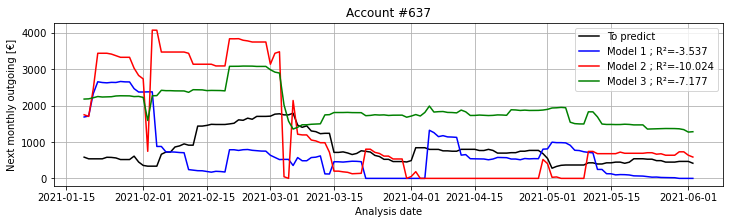

Account #638
No sufficient history for validation of prediction model
Account #639


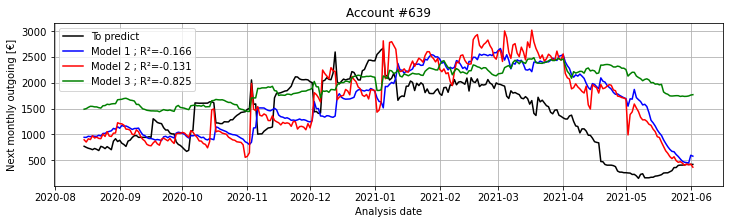

Account #640


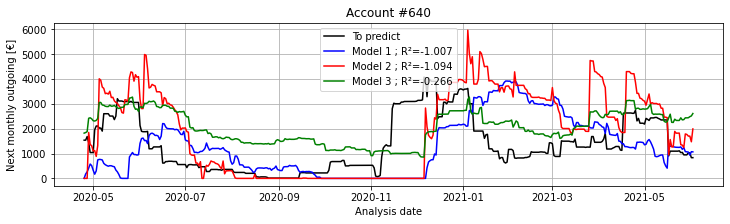

Account #641


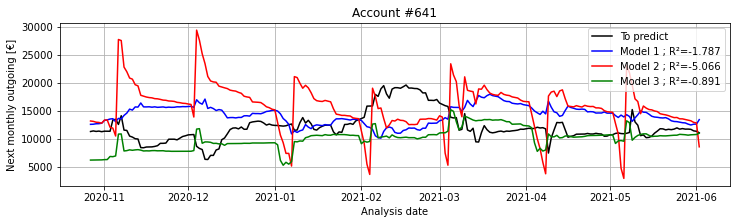

Account #642
No sufficient history for validation of prediction model
Account #643


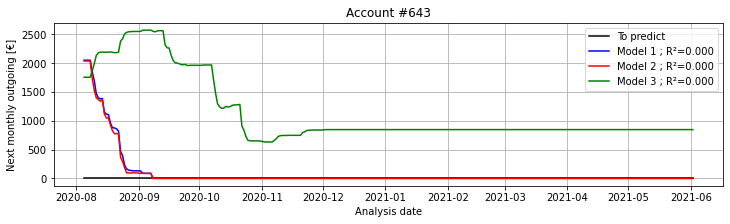

Account #644


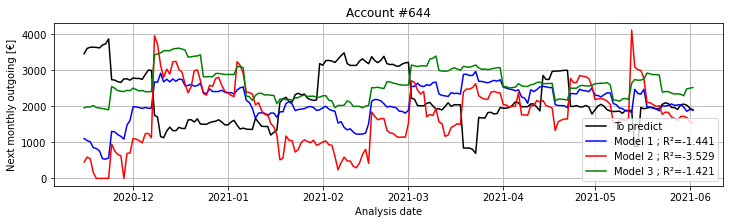

Account #645
No sufficient history for validation of prediction model
Account #646


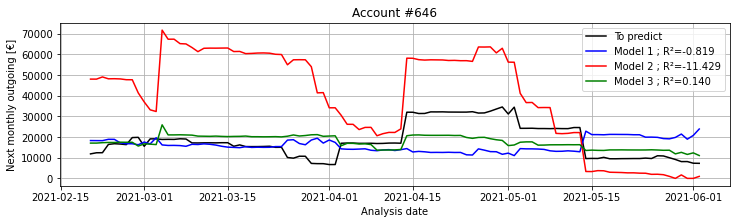

Account #647
No sufficient history for validation of prediction model
Account #648
No sufficient history for validation of prediction model
Account #649


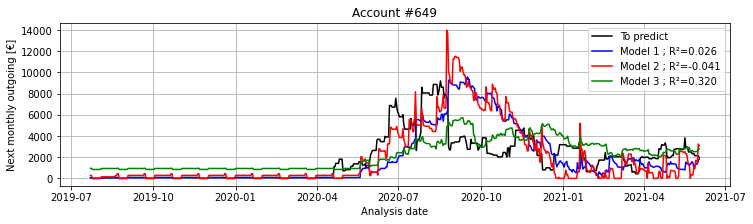

Account #650


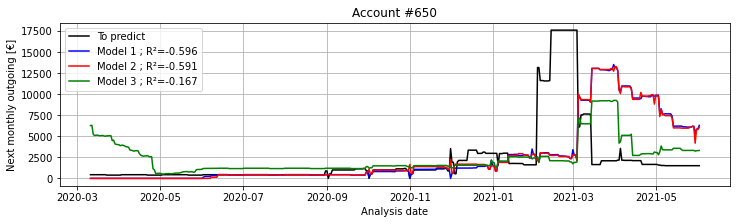

Account #651


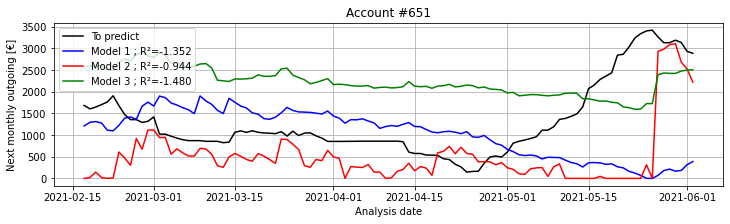

Account #652


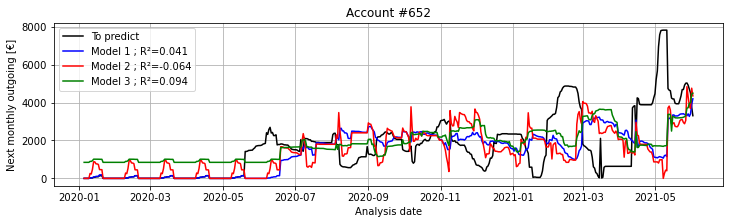

Account #653
No sufficient history for validation of prediction model
Account #654
No sufficient history for validation of prediction model
Account #655


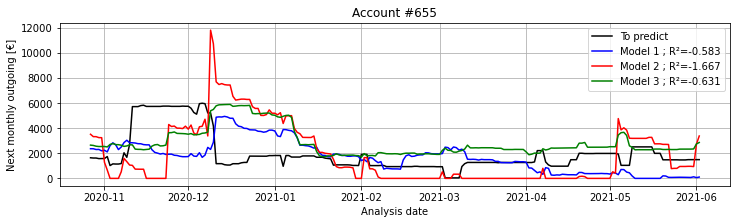

Account #656
No sufficient history for validation of prediction model
Account #657


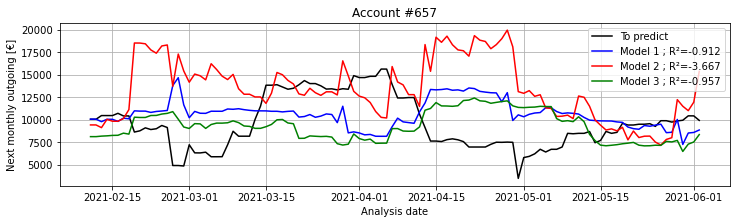

Account #658


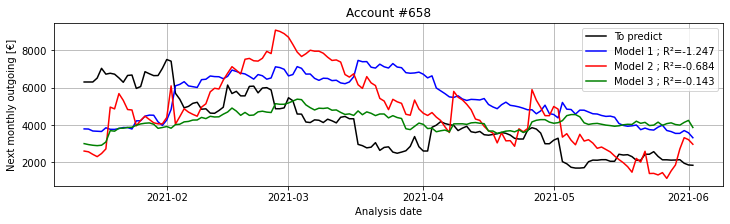

Account #659
No sufficient history for validation of prediction model
Account #660


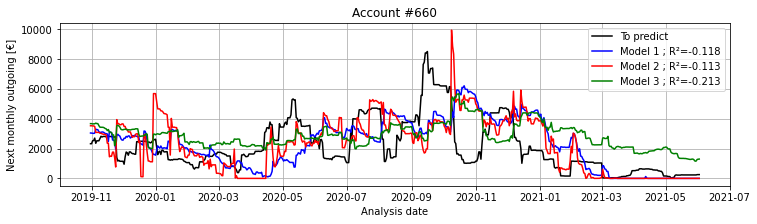

Account #661


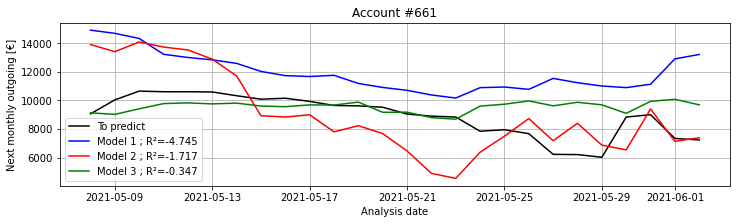

Account #662


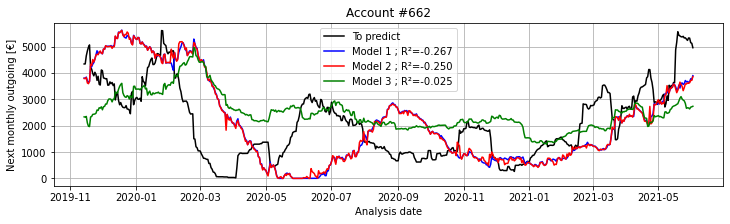

Account #663


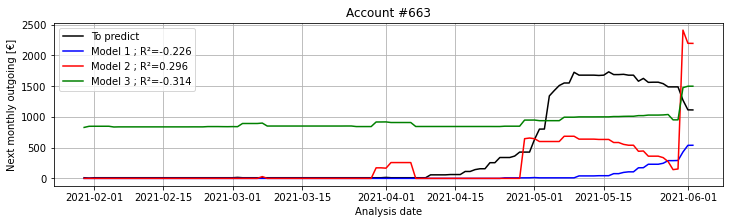

Account #664
No sufficient history for validation of prediction model
Account #665
No sufficient history for validation of prediction model
Account #666


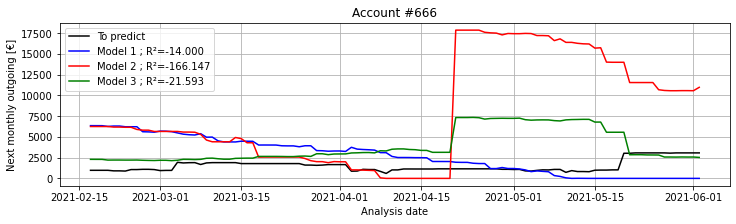

Account #667
No sufficient history for validation of prediction model
Account #668


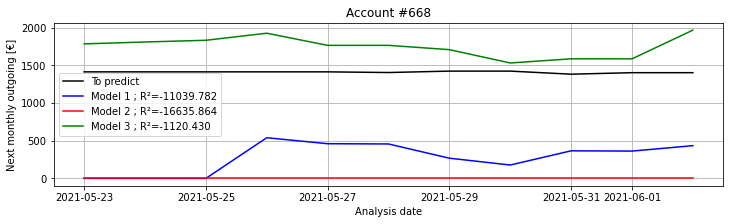

Account #669


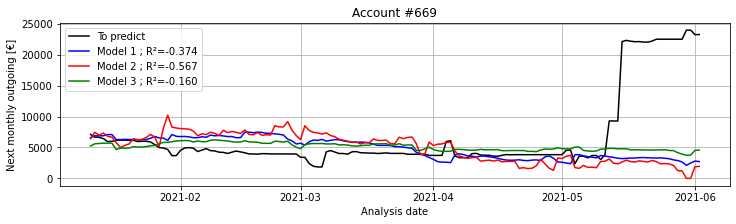

Account #670
No sufficient history for validation of prediction model
Account #671


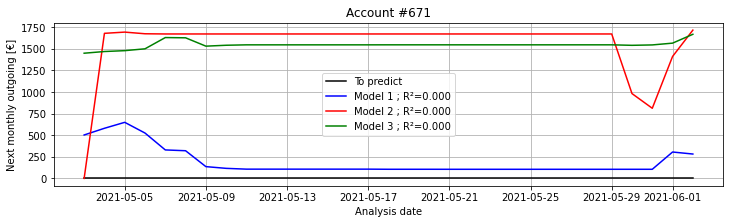

Account #672


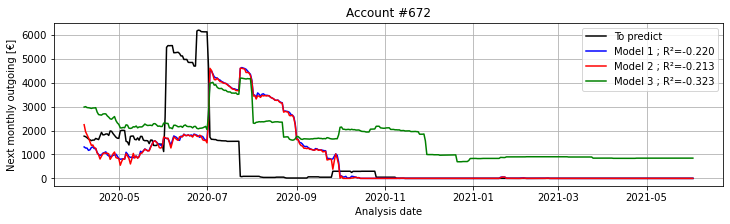

Account #673
No sufficient history for validation of prediction model
Account #674
No sufficient history for validation of prediction model
Account #675
No sufficient history for validation of prediction model
Account #676
No sufficient history for validation of prediction model
Account #677


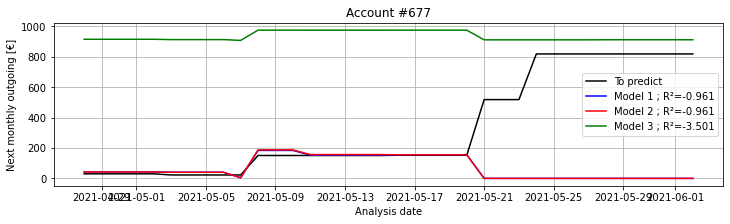

Account #678


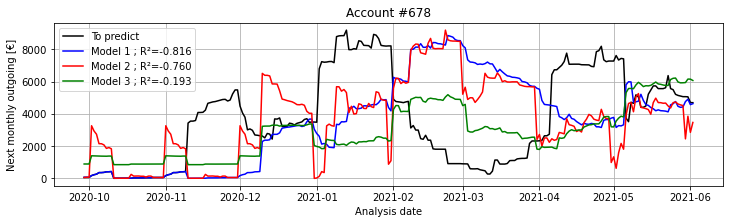

Account #679


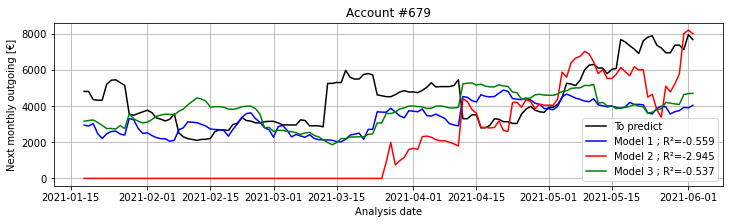

Account #680
No sufficient history for validation of prediction model
Account #681


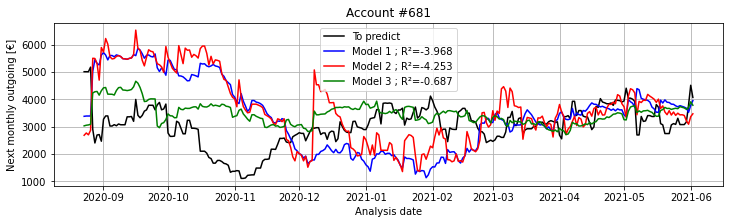

Account #682


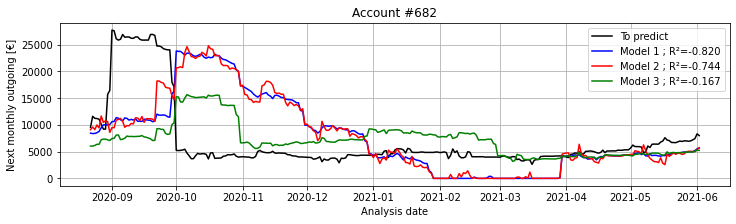

Account #683


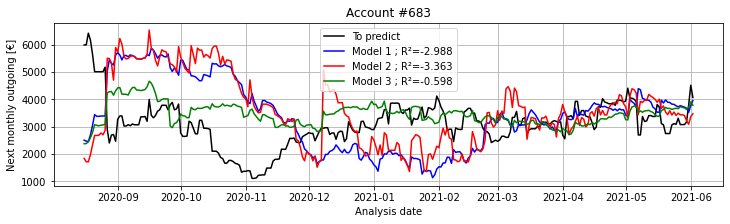

Account #684


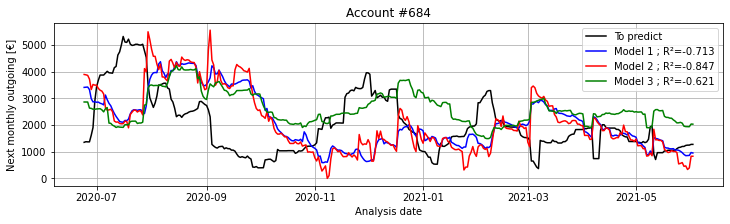

Account #685


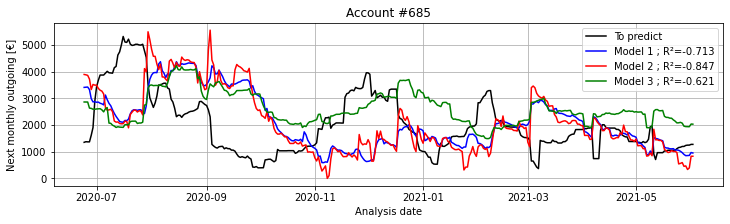

Account #686


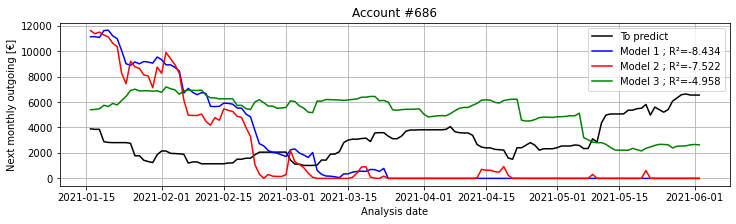

Account #687
No sufficient history for validation of prediction model
Account #688


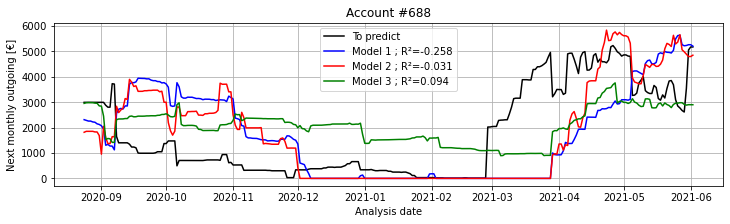

Account #689
No sufficient history for validation of prediction model
Account #690


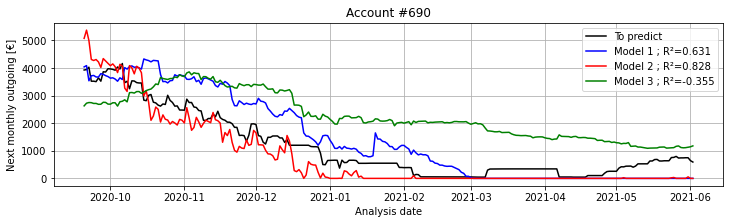

Account #691


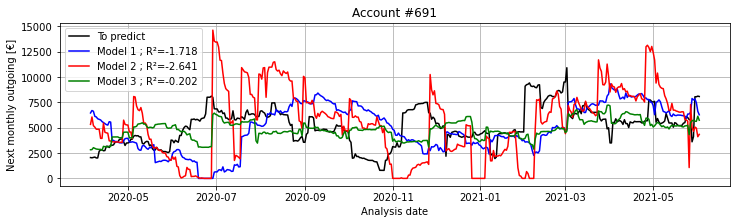

Account #692


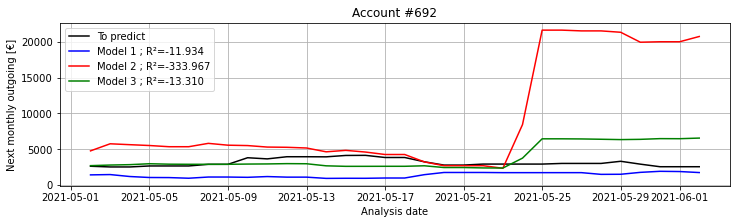

Account #693


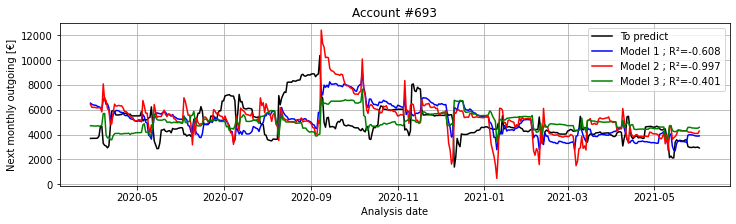

Account #694


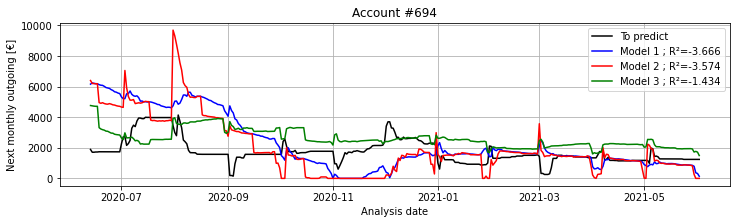

Account #695


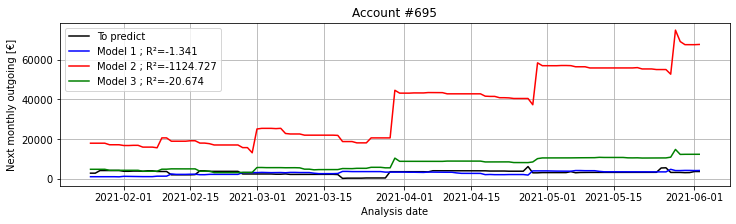

Account #696


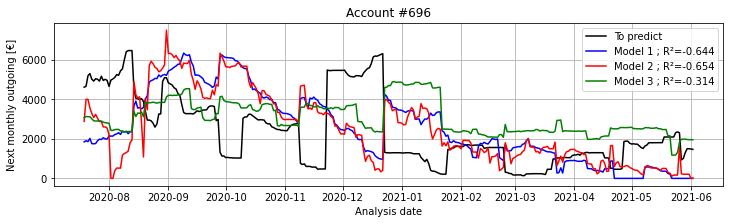

Account #697


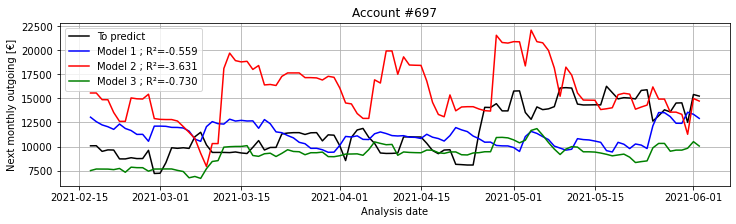

Account #698


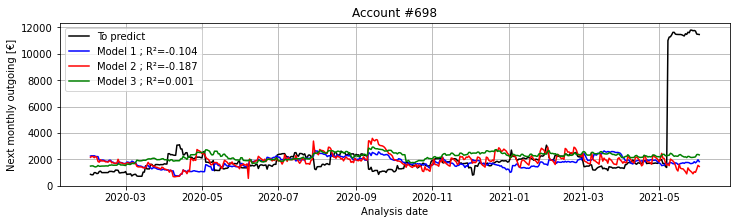

Account #699
No sufficient history for validation of prediction model
Account #700


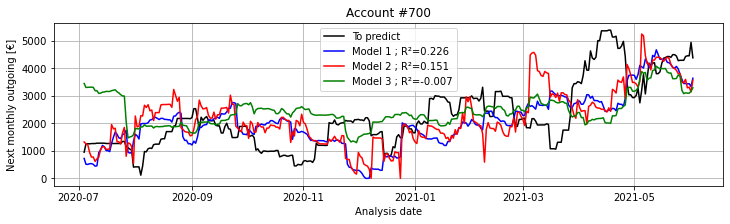

Account #701


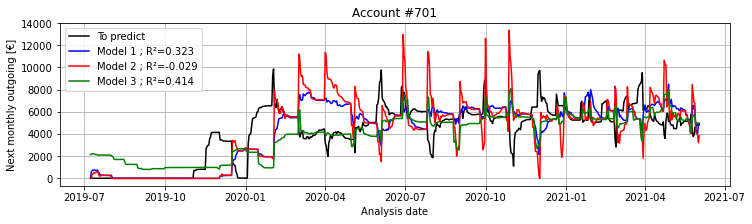

Account #702


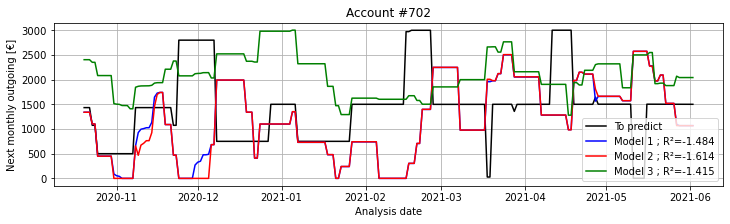

Account #703


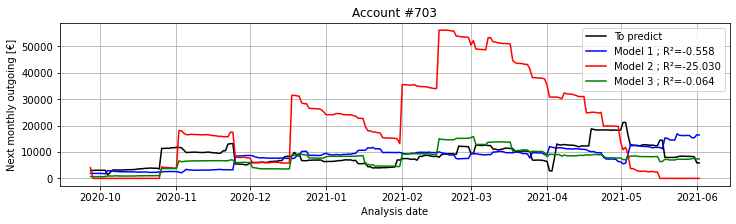

Account #704


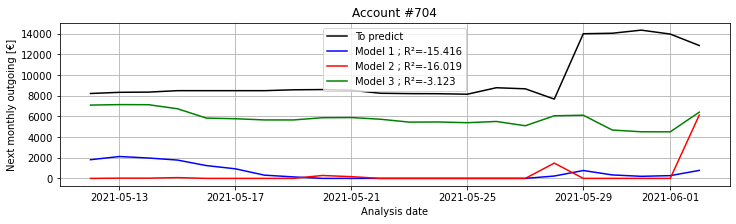

Account #705


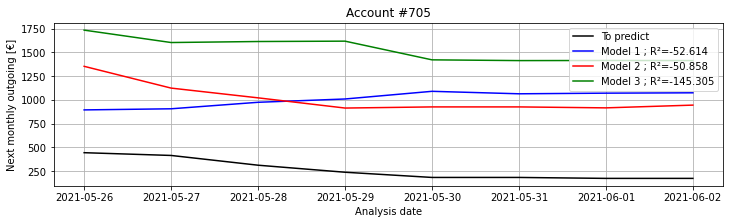

Account #706


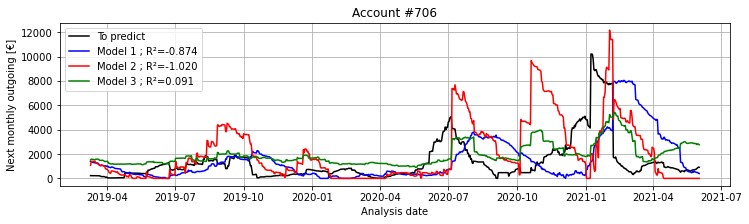

Account #707


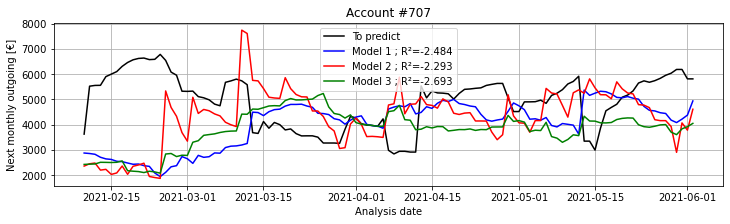

Account #708


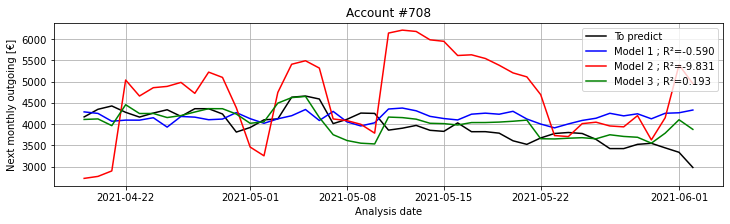

Account #709


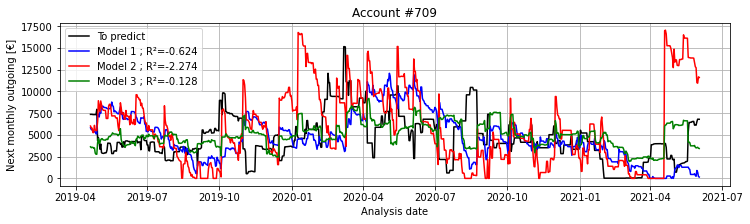

Account #710


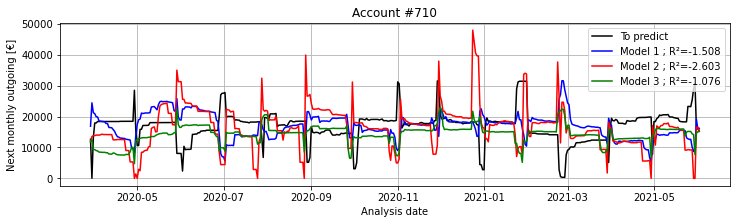

Account #711
No sufficient history for validation of prediction model
Account #712


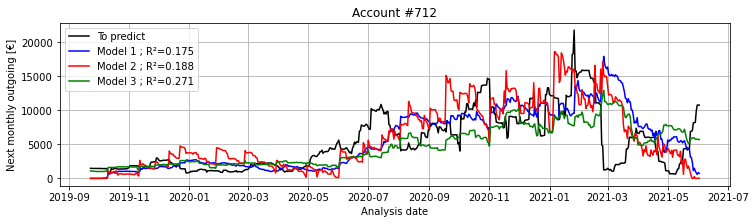

Account #713


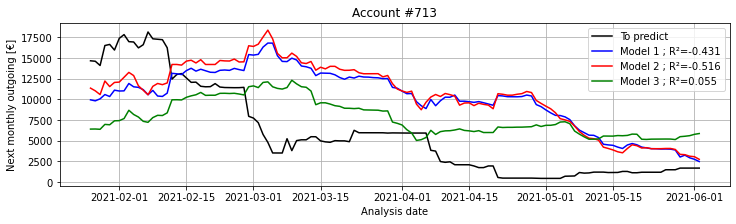

Account #714


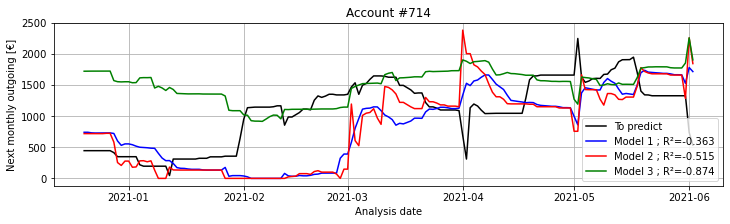

Account #715


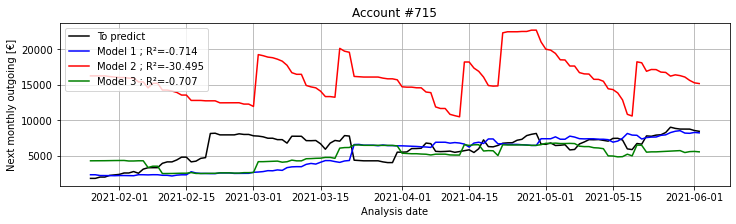

Account #716


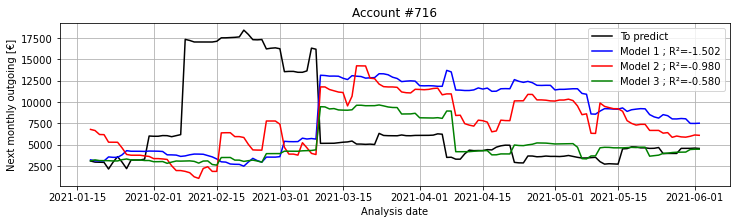

Account #717
No sufficient history for validation of prediction model
Account #718
No sufficient history for validation of prediction model
Account #719


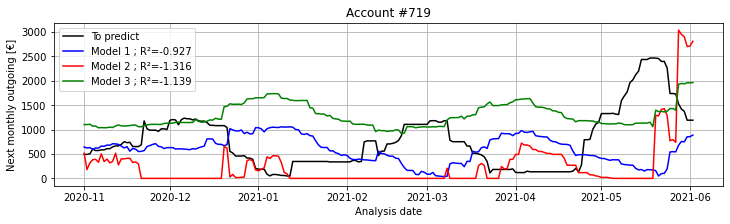

Account #720


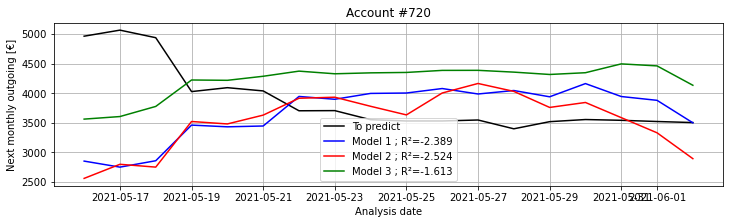

Account #721
No sufficient history for validation of prediction model
Account #722


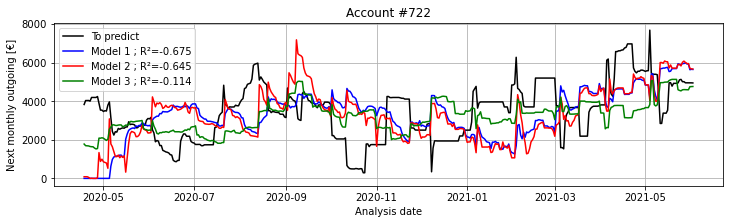

Account #723


C:\Anaconda3\envs\DataScientist\lib\site-packages\sklearn\metrics\_regression.py:781: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
C:\Anaconda3\envs\DataScientist\lib\site-packages\sklearn\metrics\_regression.py:781: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
C:\Anaconda3\envs\DataScientist\lib\site-packages\sklearn\metrics\_regression.py:781: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


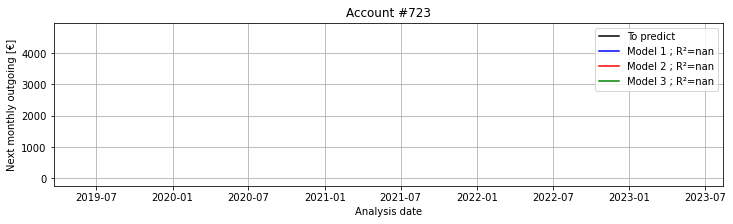

Account #724
No sufficient history for validation of prediction model
Account #725


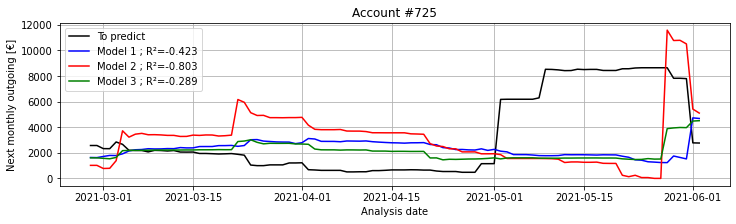

Account #726
No sufficient history for validation of prediction model
Account #727


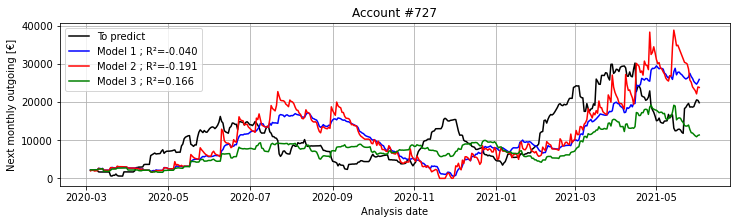

Account #728
No sufficient history for validation of prediction model
Account #729


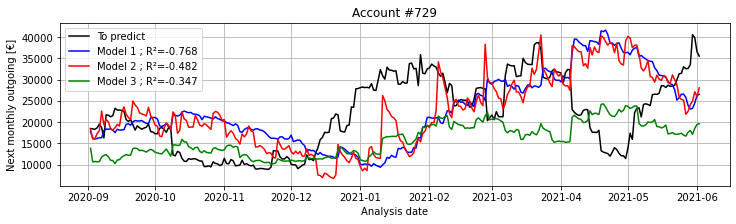

Account #730
No sufficient history for validation of prediction model
Account #731


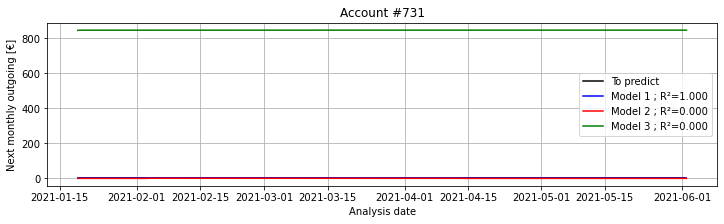

Account #732


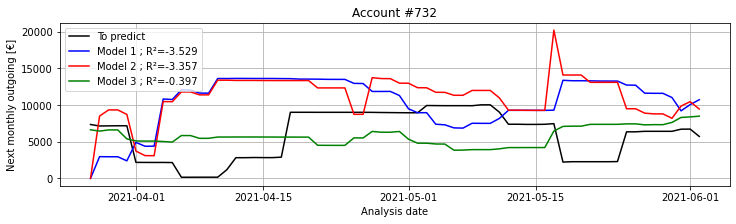

Account #733


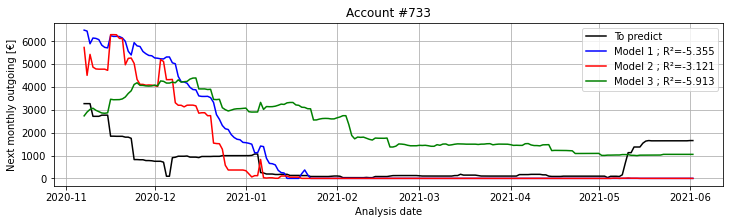

Account #734


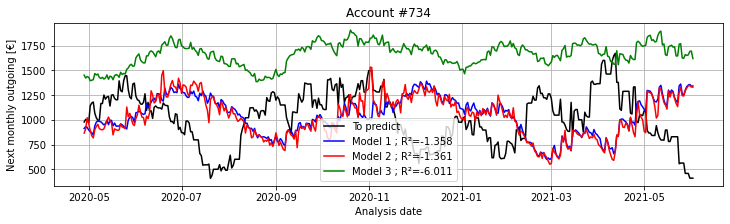

Account #735


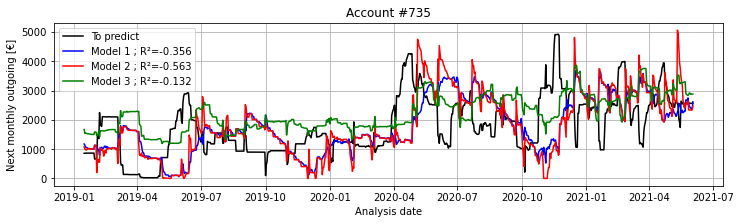

Account #736


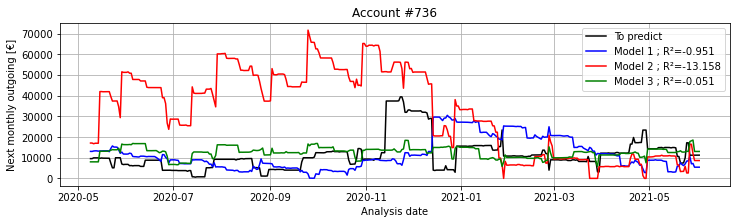

Account #737


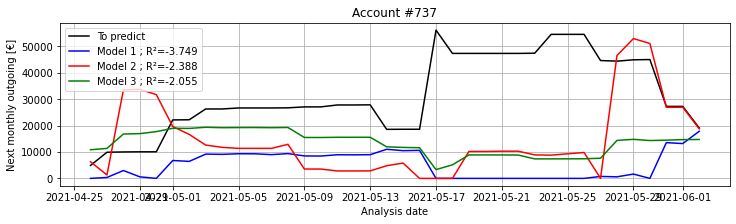

Account #738


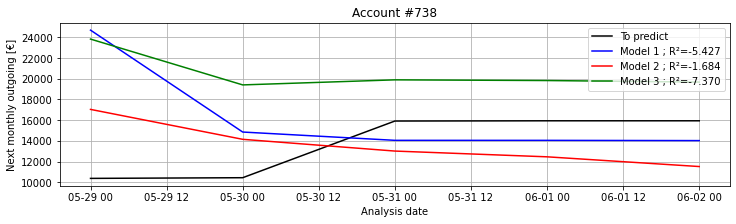

Account #739
No sufficient history for validation of prediction model
Account #740


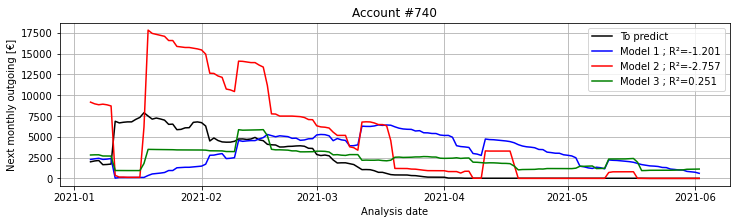

Account #741


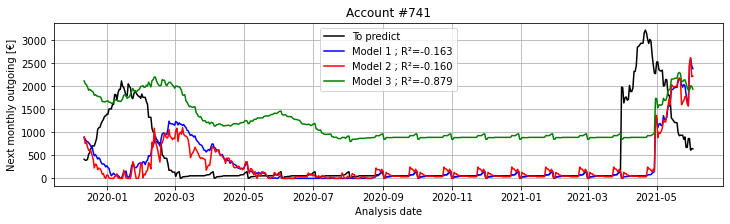

Account #742


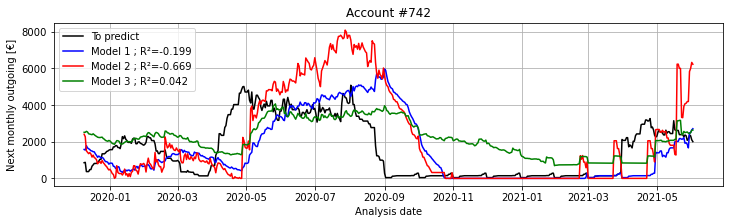

Account #743


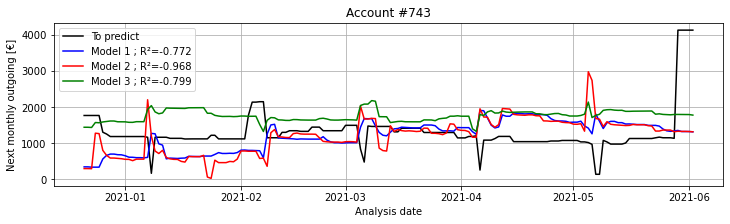

Account #744
No sufficient history for validation of prediction model
Account #745
No sufficient history for validation of prediction model
Account #746


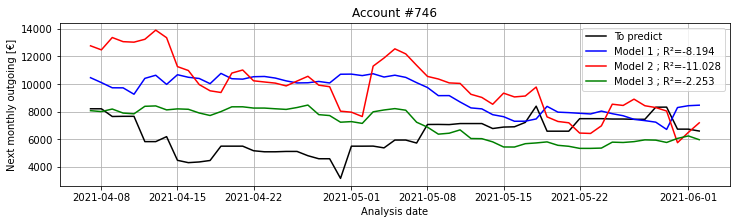

Account #747
No sufficient history for validation of prediction model
Account #748
No sufficient history for validation of prediction model
Account #749


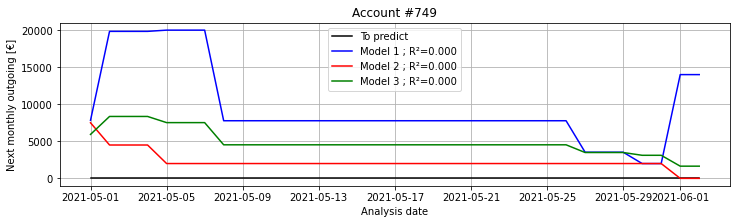

Account #750


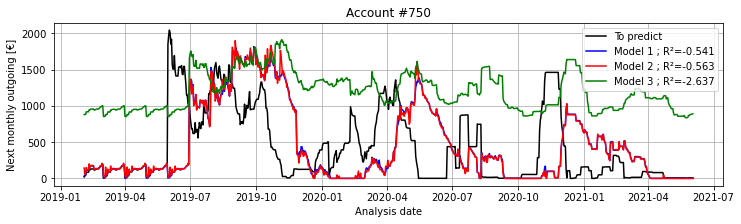

Account #751
No sufficient history for validation of prediction model
Account #752
No sufficient history for validation of prediction model
Account #753


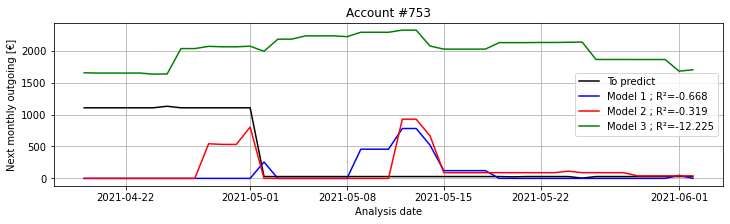

Account #754
No sufficient history for validation of prediction model
Account #755


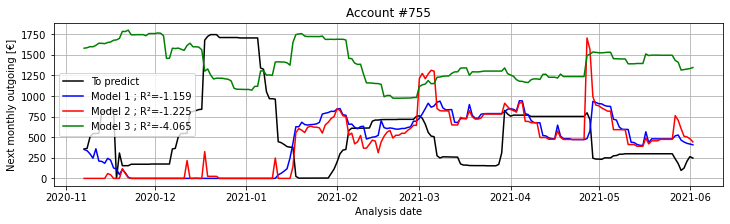

Account #756


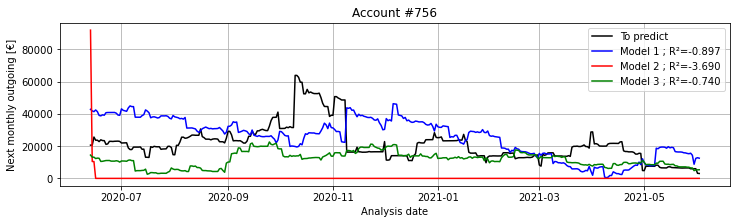

Account #757
No sufficient history for validation of prediction model
Account #758
No sufficient history for validation of prediction model
Account #759
No sufficient history for validation of prediction model
Account #760


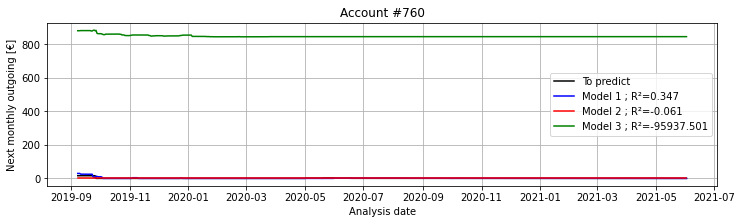

Account #761


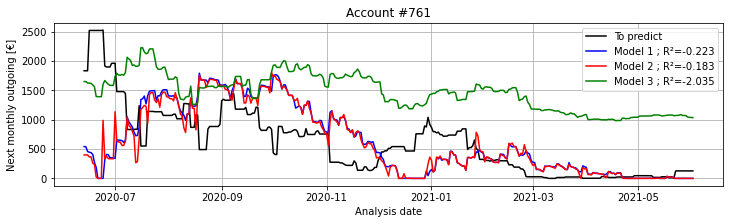

Account #762


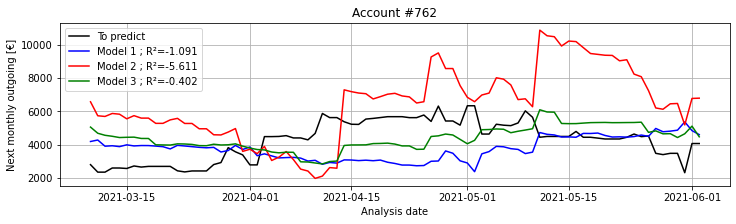

Account #763


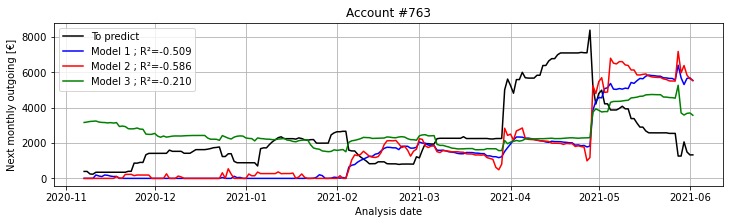

Account #764
No sufficient history for validation of prediction model
Account #765
No sufficient history for validation of prediction model
Account #766


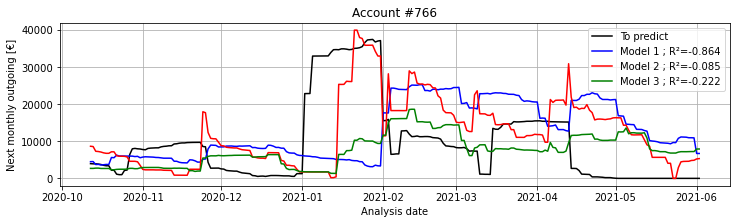

Account #767
No sufficient history for validation of prediction model
Account #768


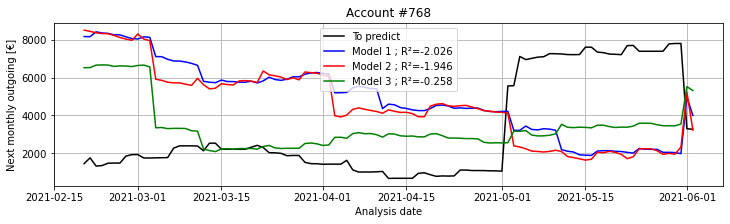

Account #769
No sufficient history for validation of prediction model
Account #770


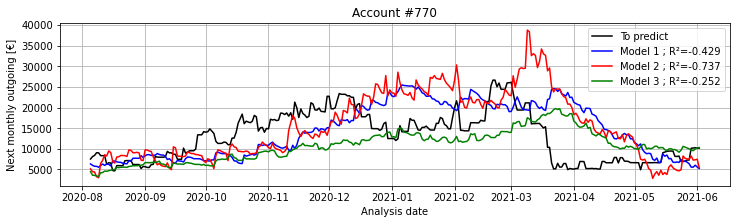

Account #771


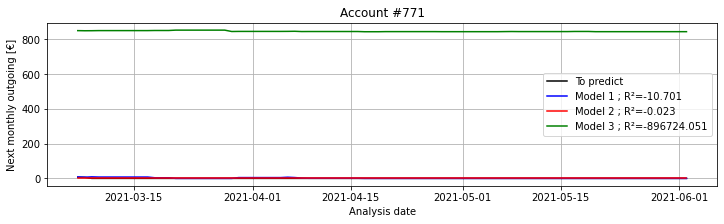

Account #772


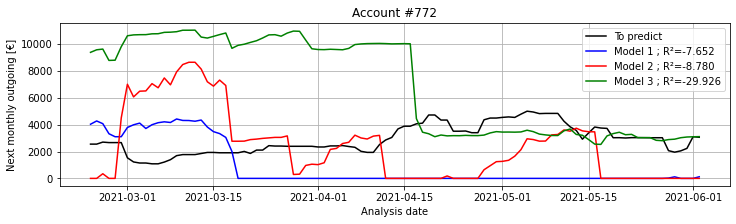

Account #773


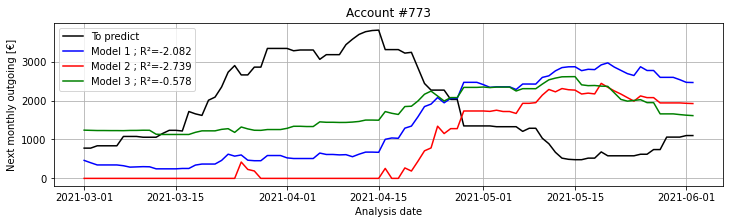

Account #774


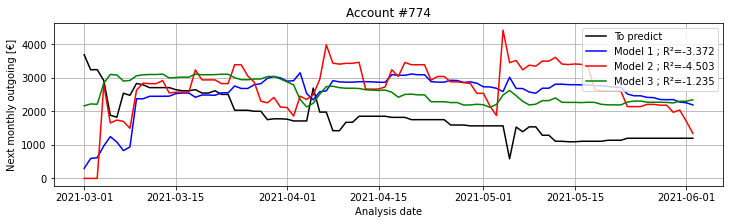

Account #775


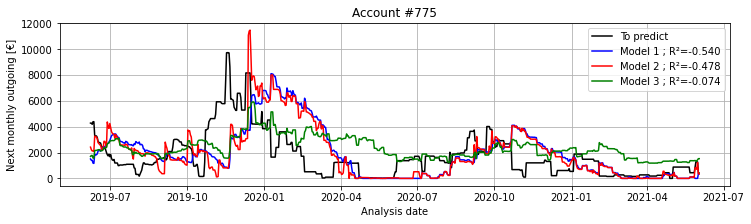

Account #776


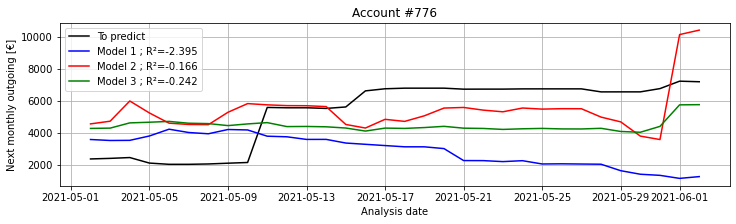

Account #777


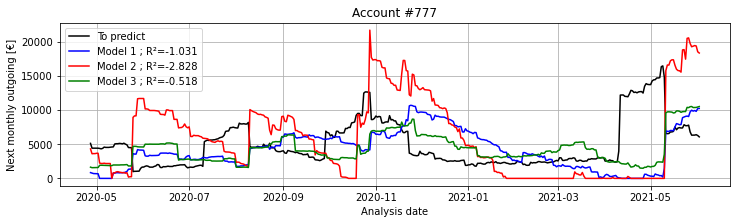

Account #778


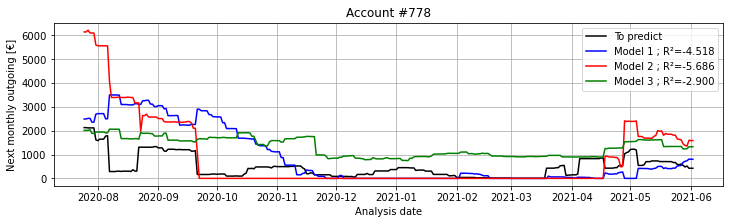

Account #779
No sufficient history for validation of prediction model
Account #780
No sufficient history for validation of prediction model
Account #781


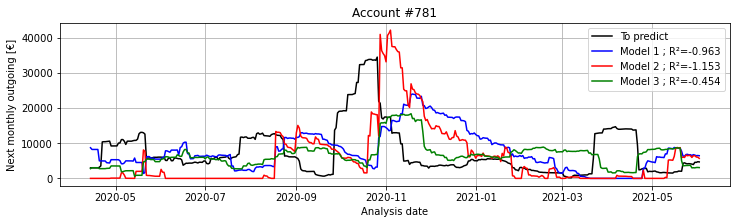

Account #782


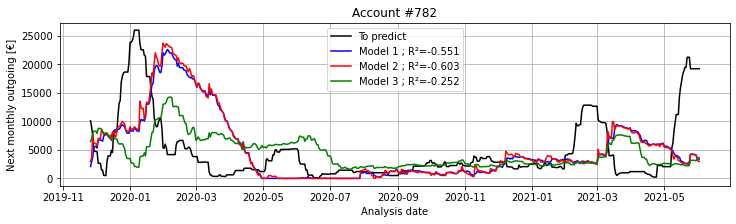

Account #783


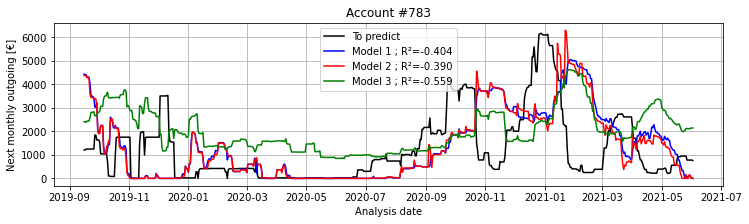

Account #784
No sufficient history for validation of prediction model
Account #785


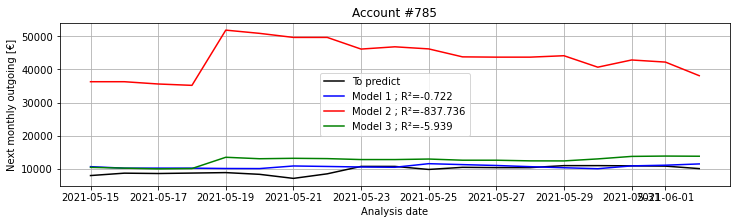

Account #786


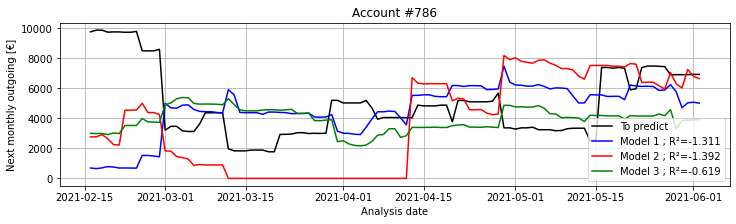

Account #787
No sufficient history for validation of prediction model
Account #788


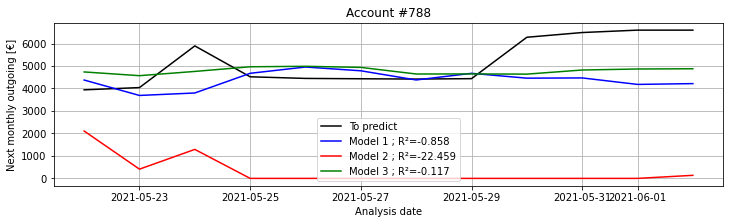

Account #789
No sufficient history for validation of prediction model
Account #790


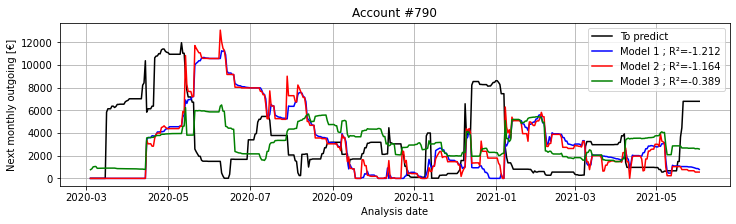

Account #791


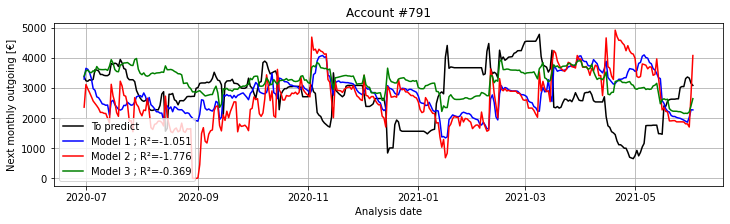

Account #792


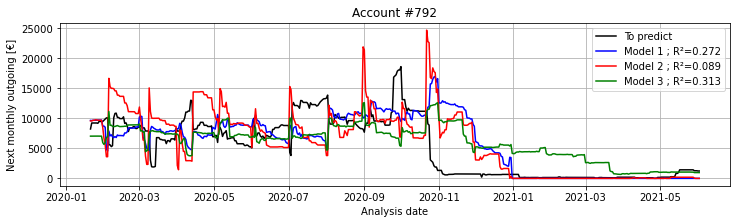

Account #793
No sufficient history for validation of prediction model
Account #794


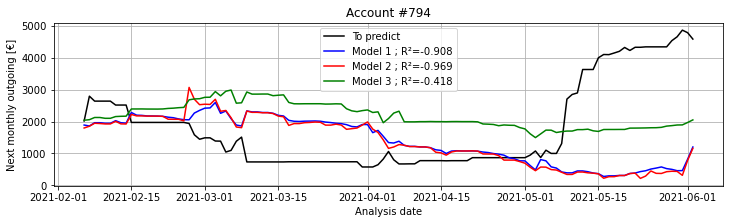

Account #795
No sufficient history for validation of prediction model
Account #796


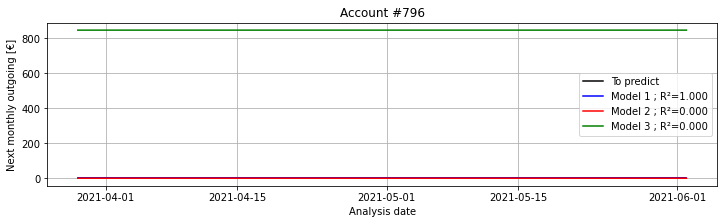

Account #797


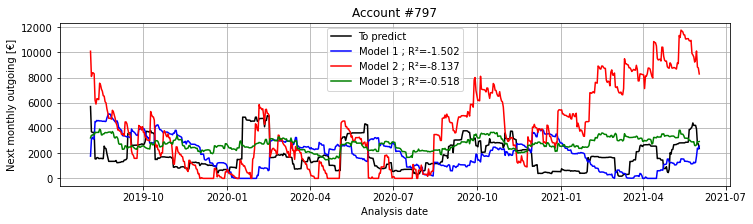

Account #798


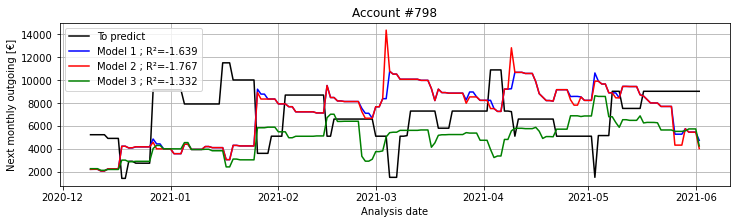

Account #799
No sufficient history for validation of prediction model
Account #800


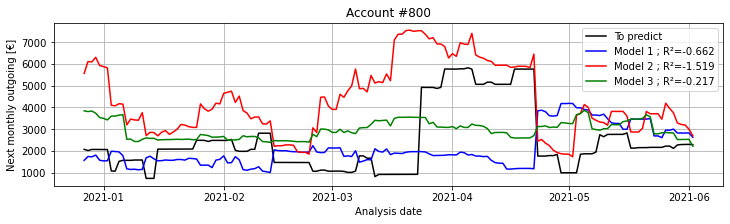

Account #801


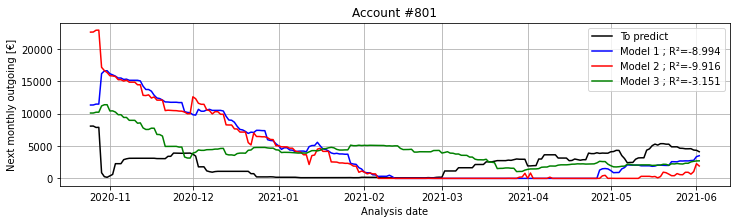

Account #802


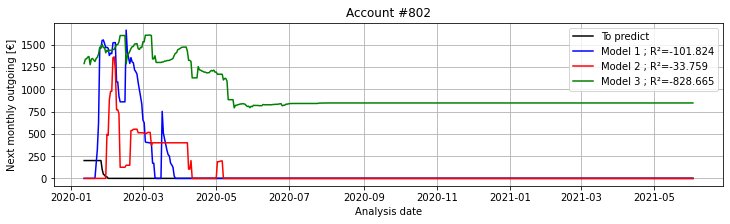

Account #803
No sufficient history for validation of prediction model
Account #804
No sufficient history for validation of prediction model
Account #805


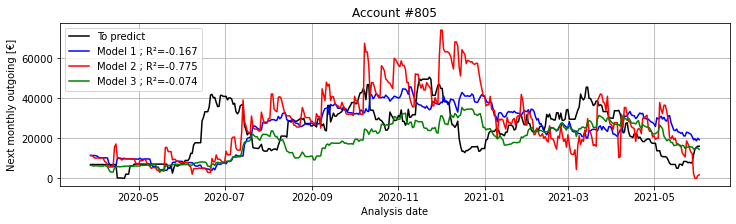

Account #806
No sufficient history for validation of prediction model
Account #807


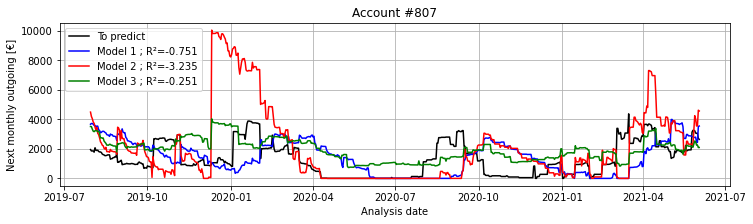

Account #808


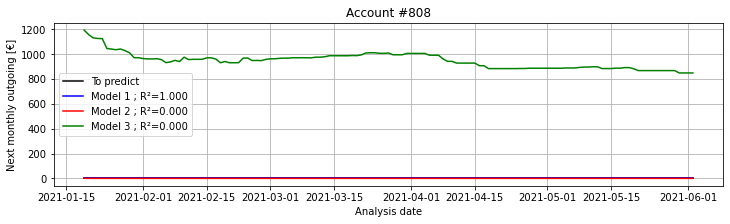

Account #809


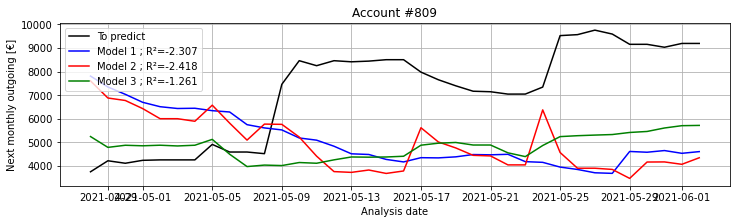

Account #810


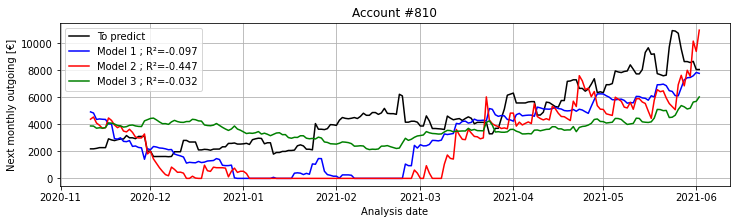

Account #811


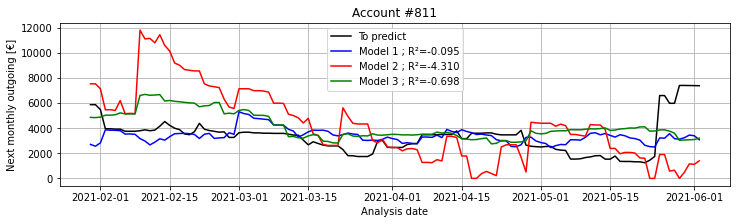

Account #812
No sufficient history for validation of prediction model
Account #813


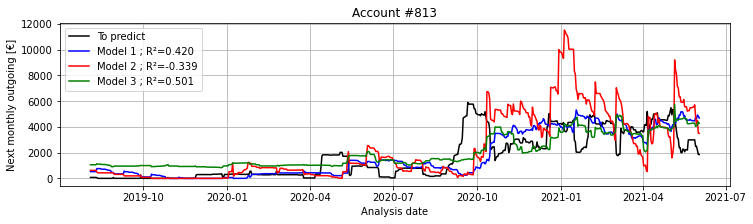

Account #814


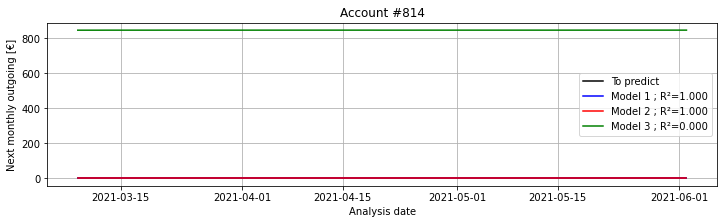

Account #815


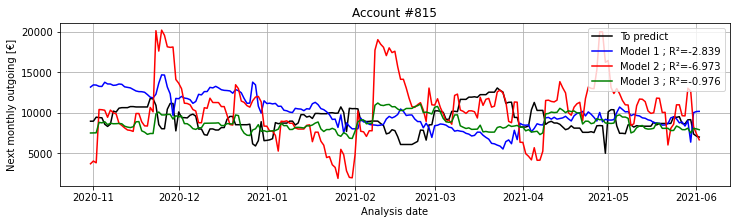

Account #816


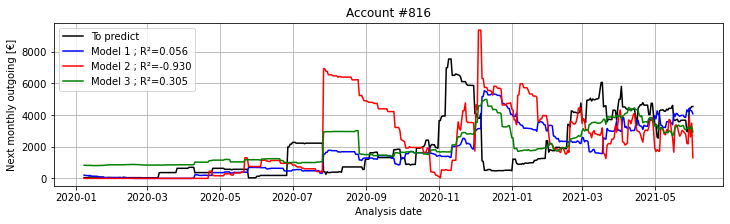

Account #817


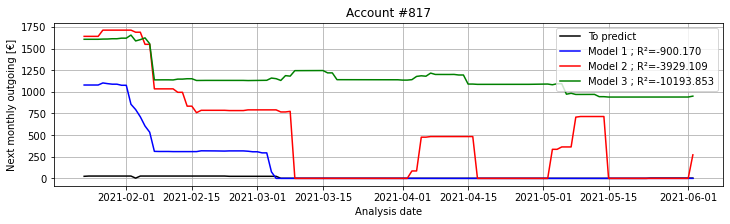

Account #818
No sufficient history for validation of prediction model
Account #819


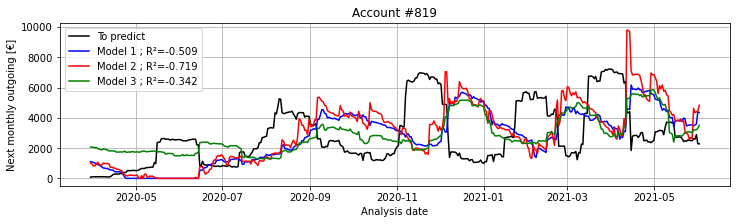

Account #820


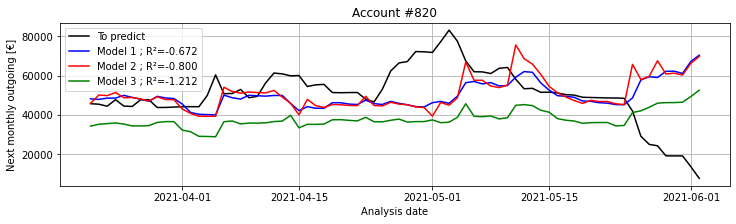

Account #821


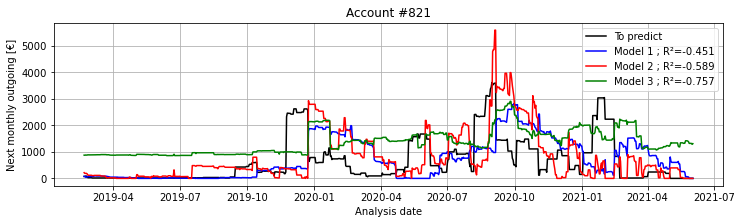

Account #822
No sufficient history for validation of prediction model
Account #823


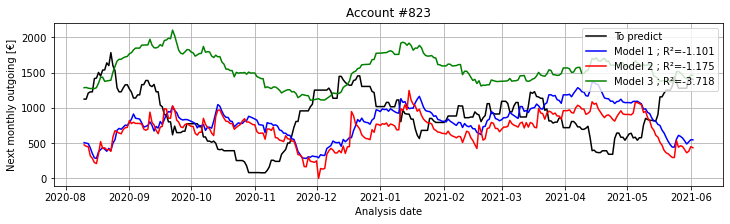

Account #824


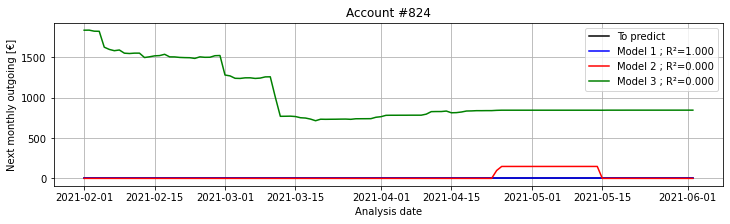

Account #825


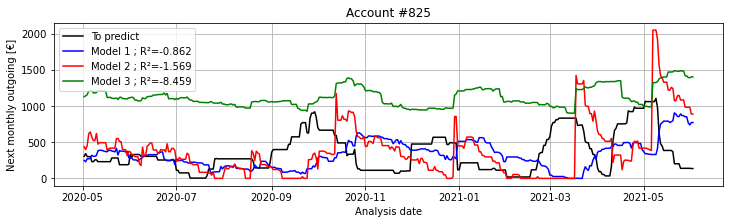

Account #826


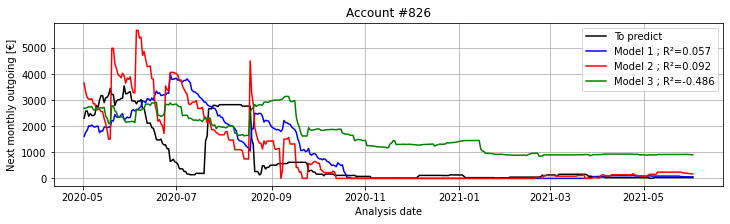

Account #827


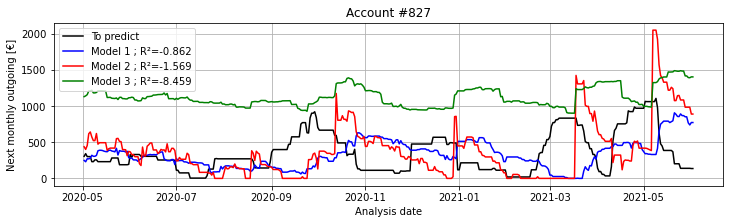

Account #828


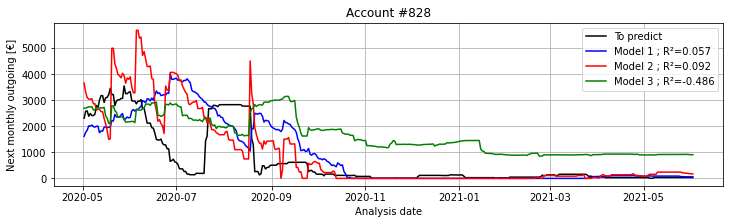

Account #829
No sufficient history for validation of prediction model
Account #830


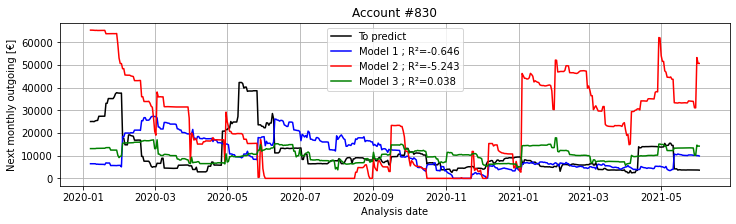

Account #831


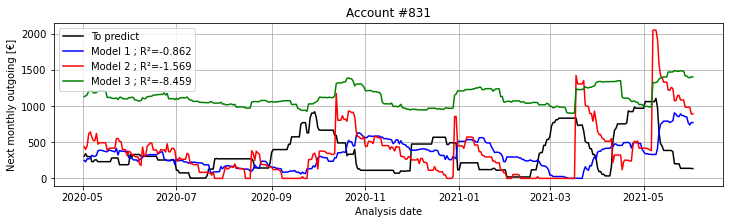

Account #832


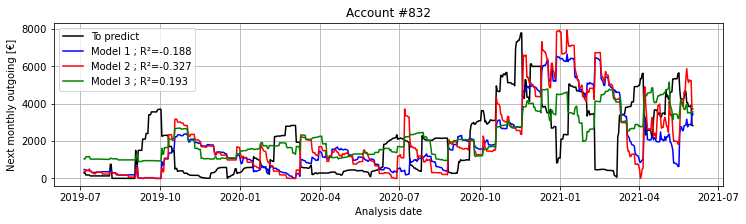

Account #833
No sufficient history for validation of prediction model
Account #834


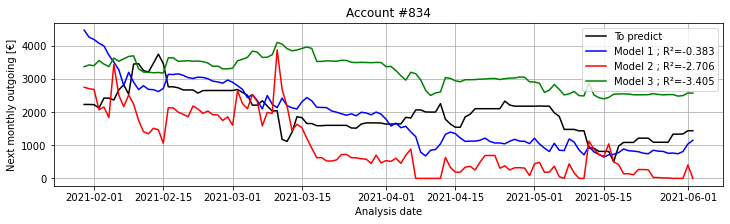

Account #835


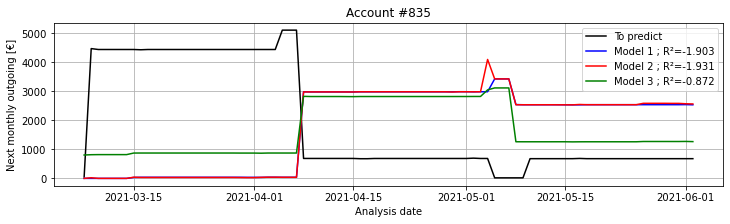

Account #836


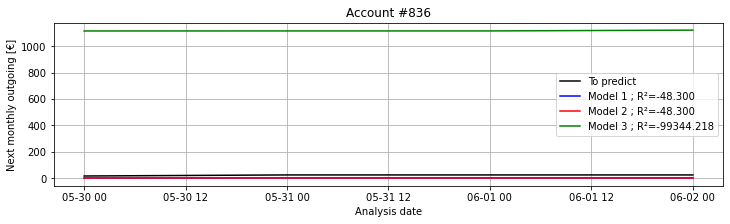

Account #837
No sufficient history for validation of prediction model
Account #838


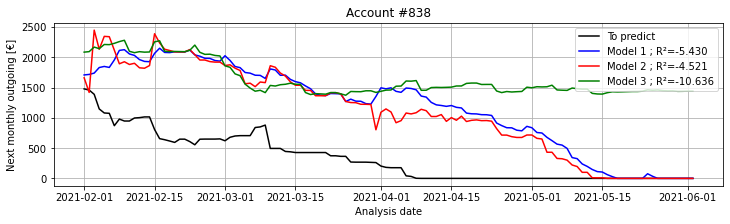

Account #839
No sufficient history for validation of prediction model
Account #840


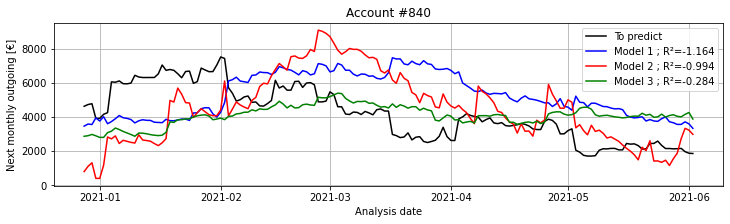

Account #841


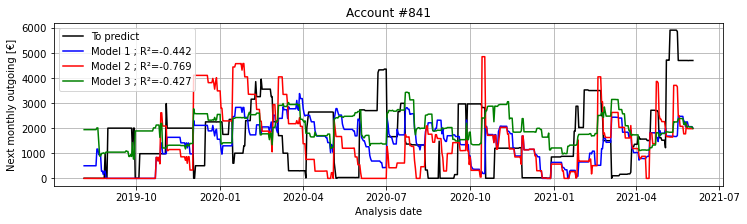

Account #842


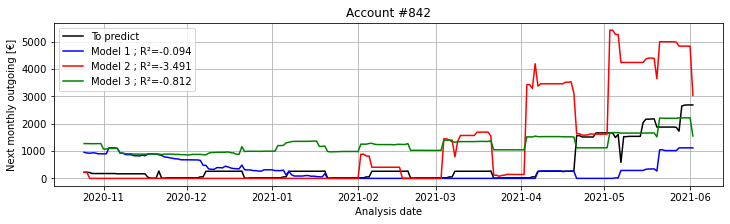

Account #843


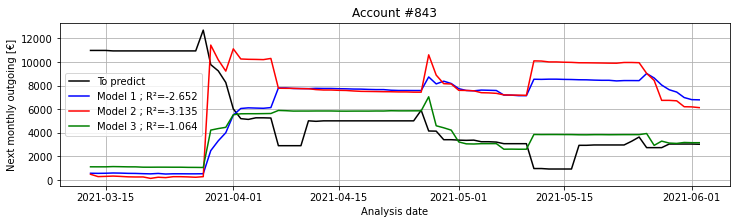

Account #844


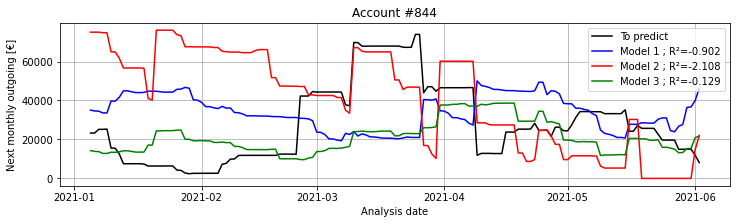

Account #845


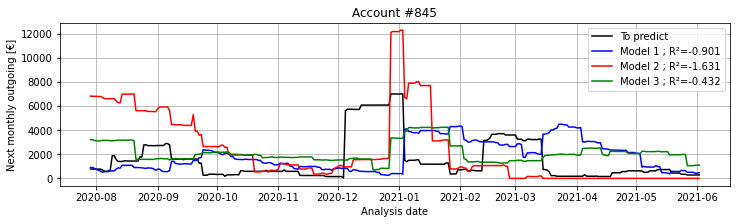

Account #846


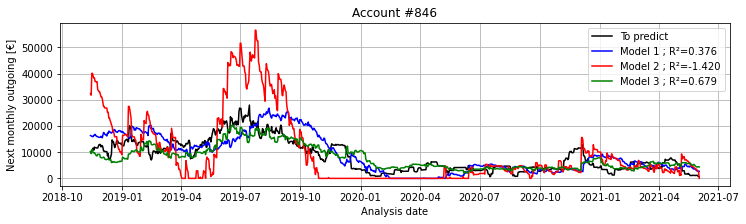

Account #847


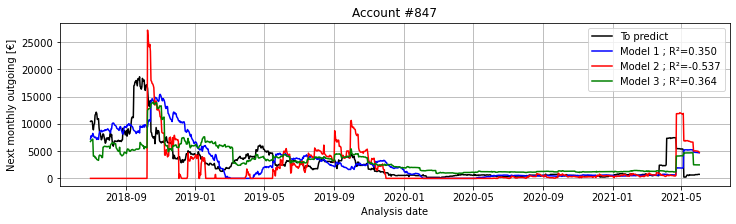

Account #848


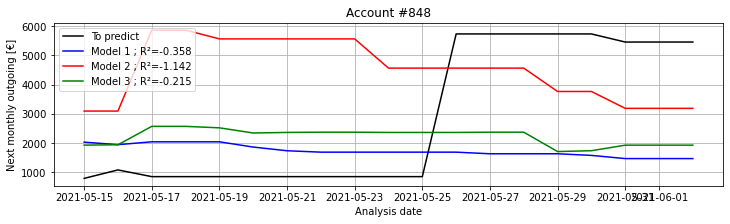

Account #849


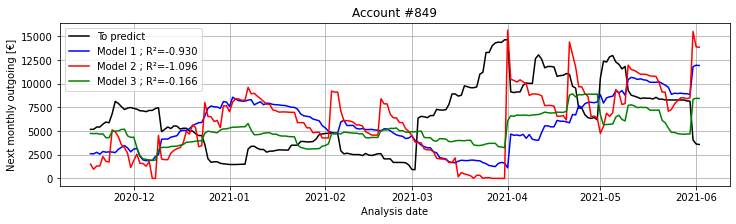

Account #850
No sufficient history for validation of prediction model
Account #851


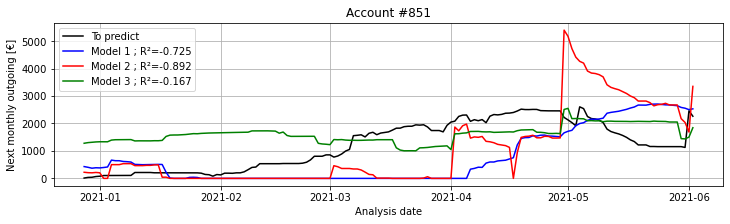

Account #852


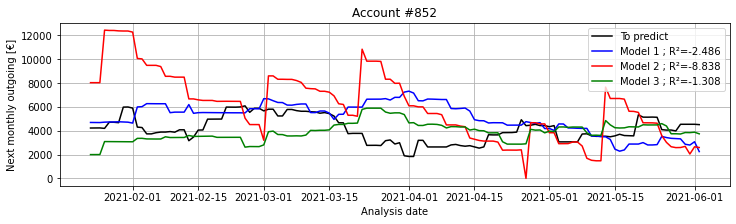

Account #853


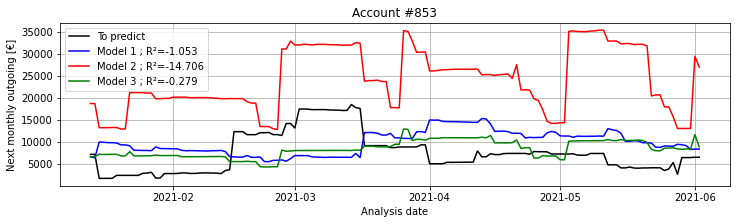

Account #854
No sufficient history for validation of prediction model
Account #855


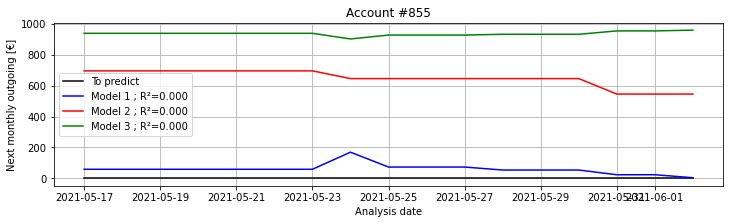

Account #856


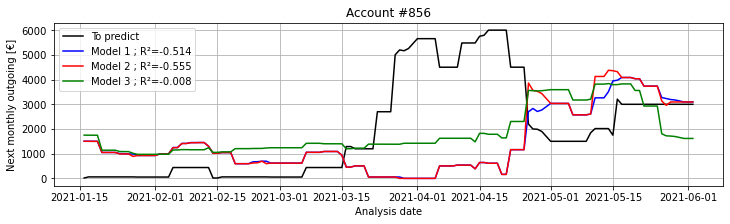

Account #857


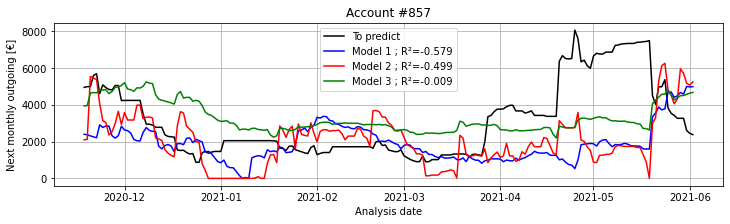

Account #858


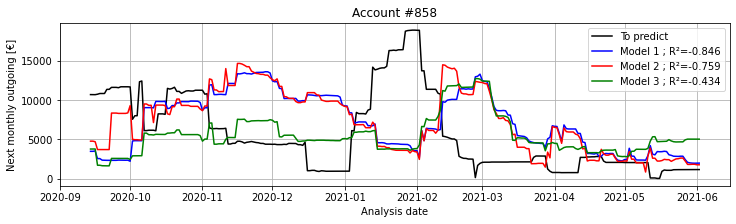

Account #859
No sufficient history for validation of prediction model
Account #860
No sufficient history for validation of prediction model
Account #861


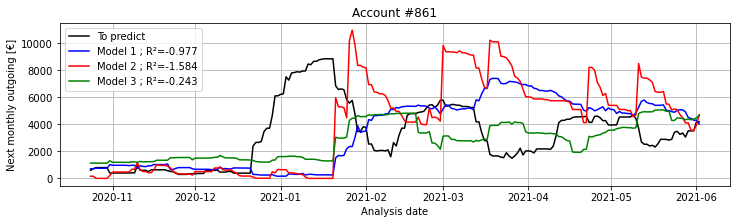

Account #862


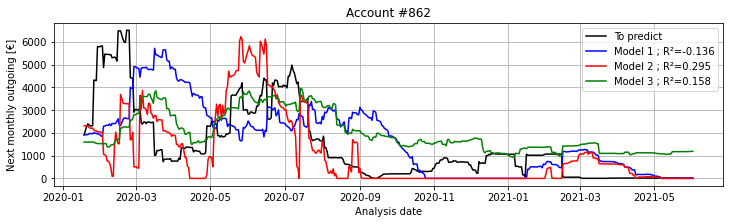

Account #863
No sufficient history for validation of prediction model
Account #864


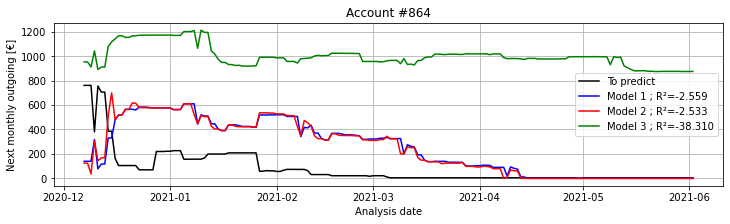

Account #865
No sufficient history for validation of prediction model
Account #866


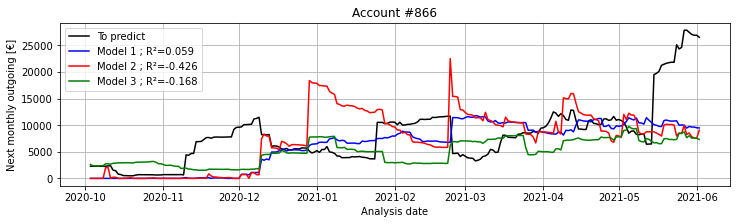

Account #867


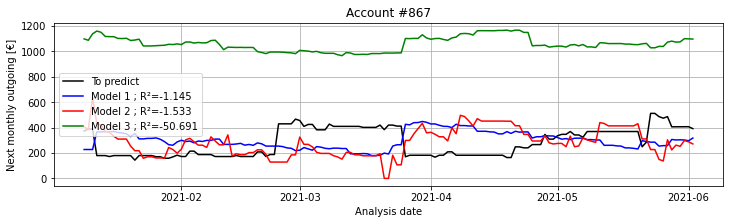

Account #868


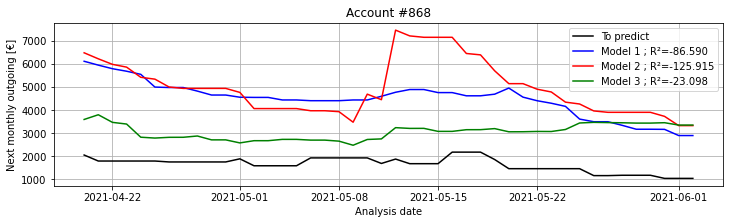

Account #869


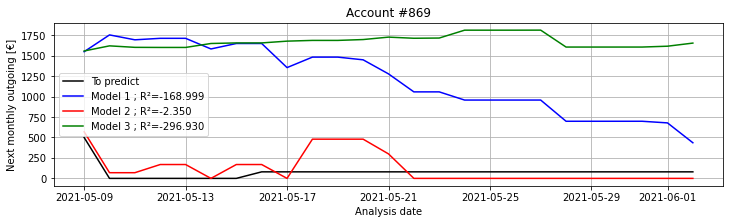

Account #870


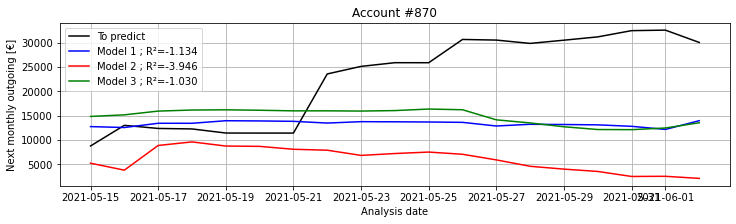

Account #871
No sufficient history for validation of prediction model
Account #872


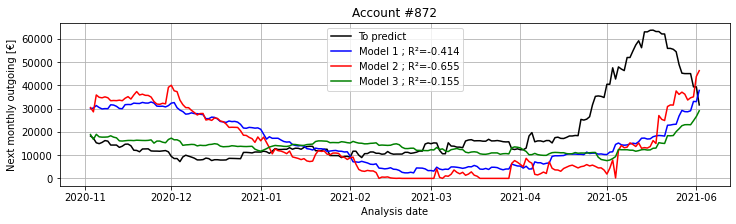

Account #873


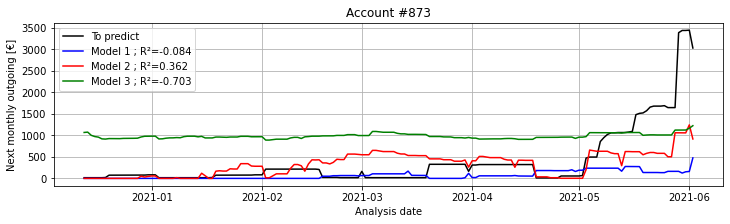

Account #874


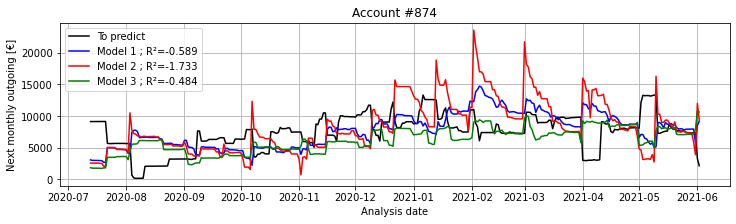

Account #875
No sufficient history for validation of prediction model
Account #876


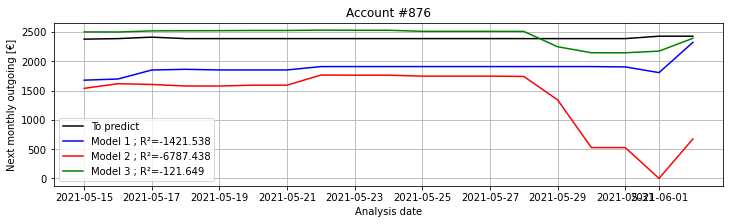

Account #877
No sufficient history for validation of prediction model
Account #878


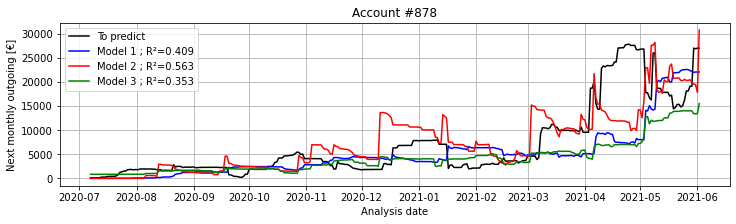

Account #879


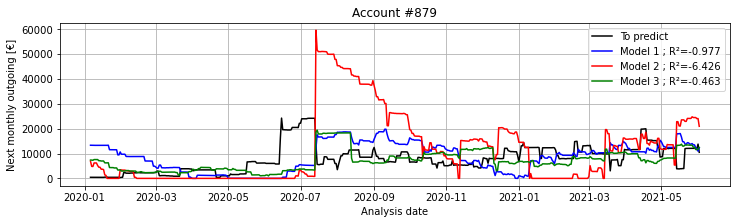

Account #880


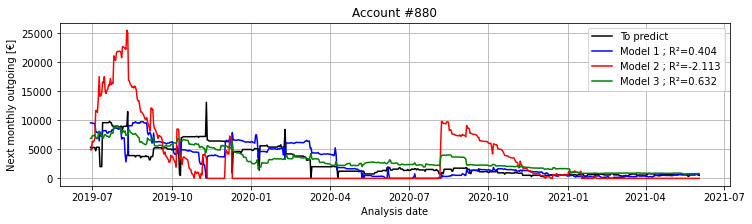

Account #881


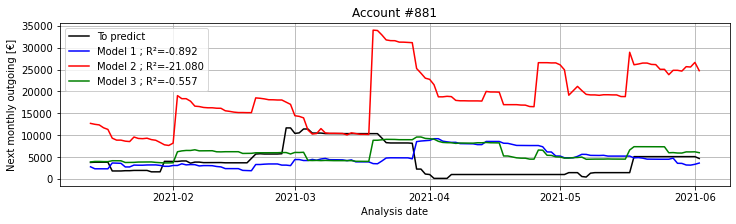

Account #882
No sufficient history for validation of prediction model
Account #883


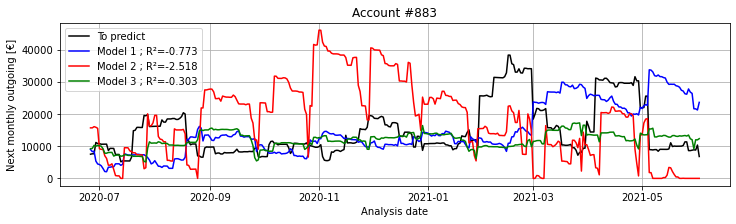

Account #884


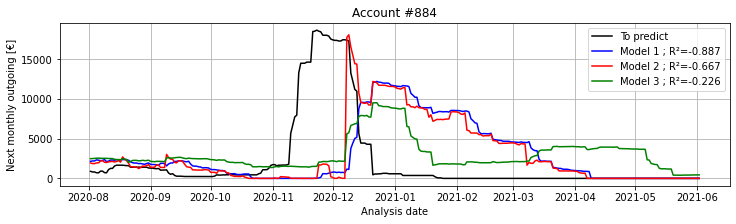

Account #885


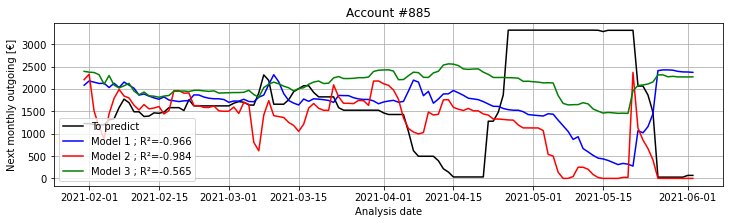

Account #886


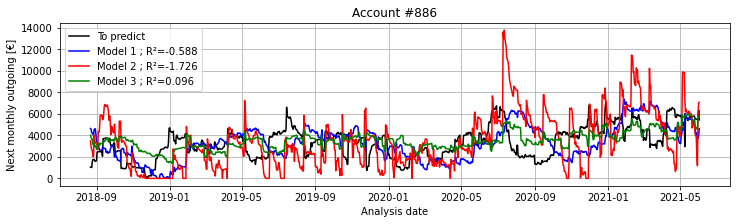

Account #887


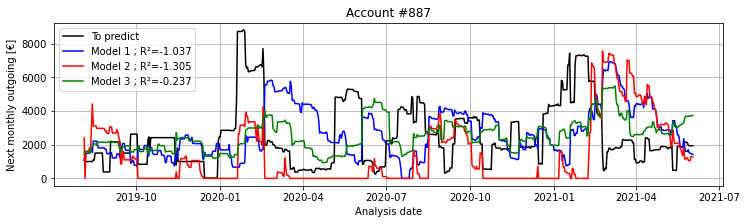

Account #888
No sufficient history for validation of prediction model
Account #889


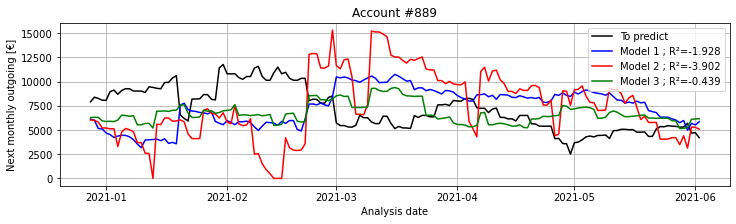

Account #890


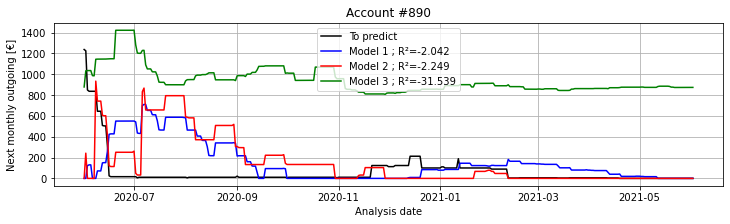

Account #891


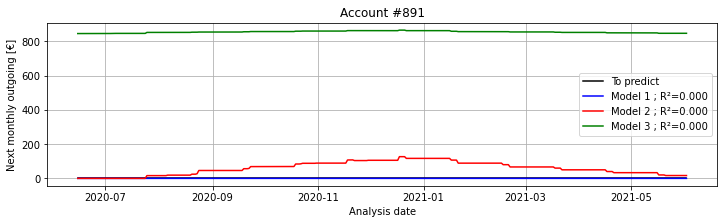

Account #892


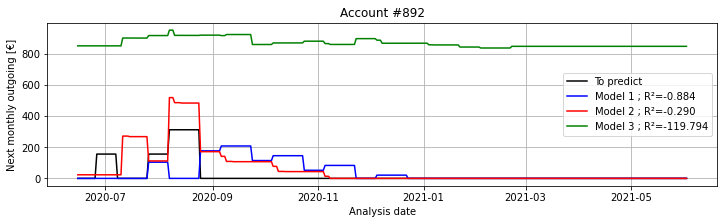

Account #893


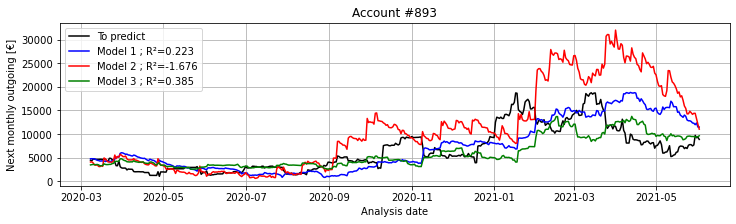

Account #894


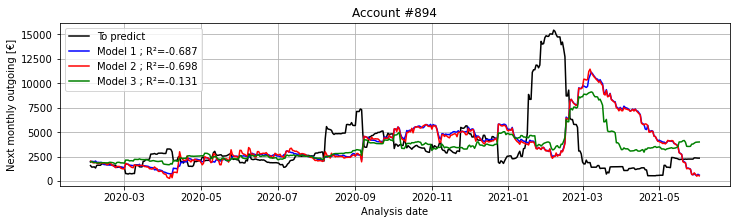

Account #895


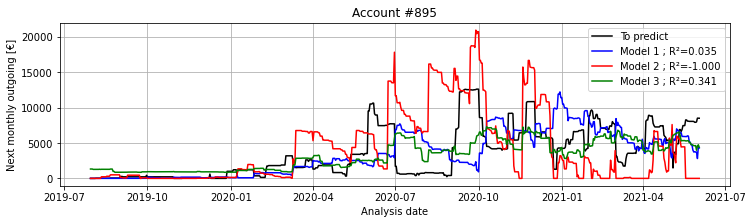

Account #896
No sufficient history for validation of prediction model
Account #897


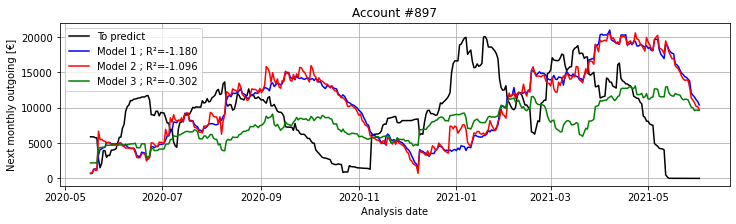

Account #898
No sufficient history for validation of prediction model
Account #899


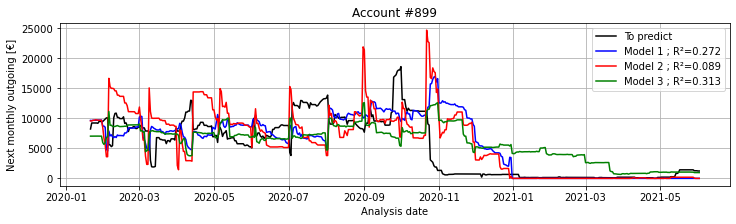

Account #900
No sufficient history for validation of prediction model
Account #901
No sufficient history for validation of prediction model
Account #902


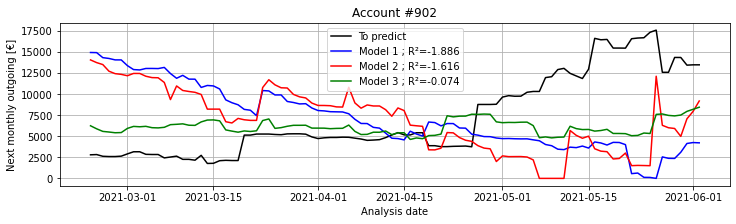

Account #903
No sufficient history for validation of prediction model
Account #904


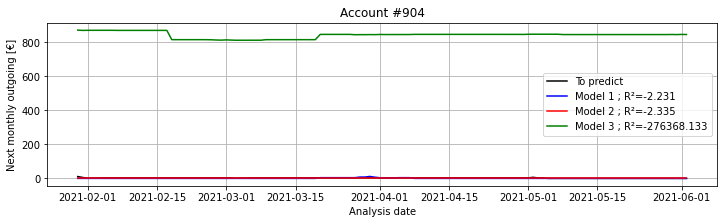

Account #905
No sufficient history for validation of prediction model
Account #906
No sufficient history for validation of prediction model
Account #907


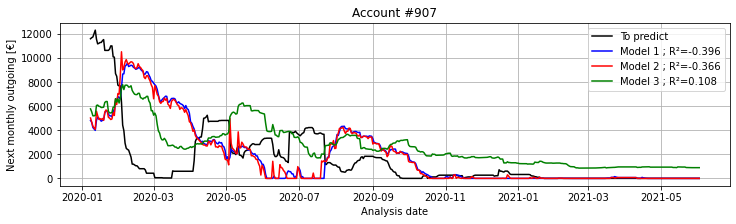

Account #908


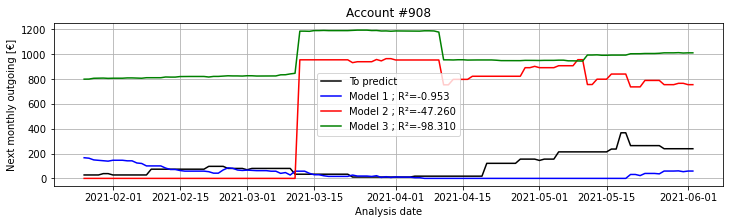

Account #909
No sufficient history for validation of prediction model
Account #910


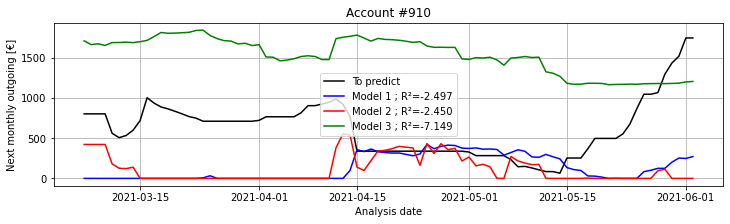

Account #911


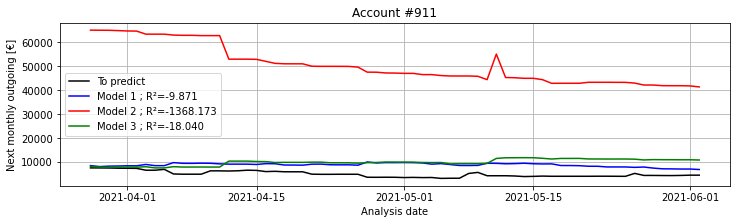

Account #912


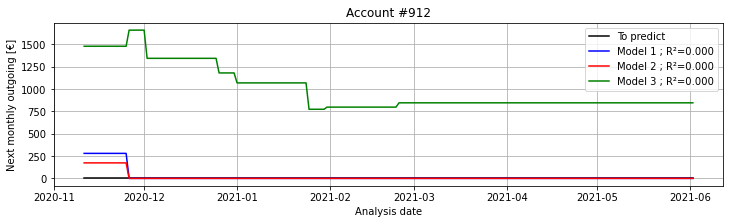

Account #913


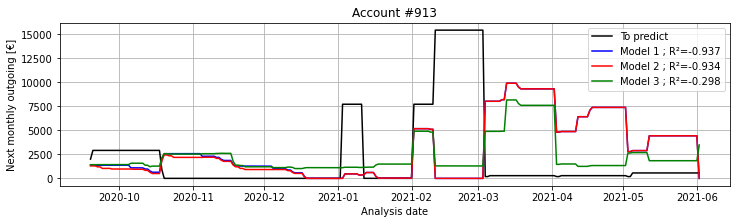

Account #914
No sufficient history for validation of prediction model
Account #915


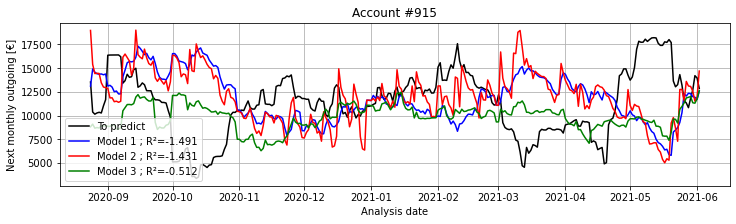

Account #916
No sufficient history for validation of prediction model
Account #917


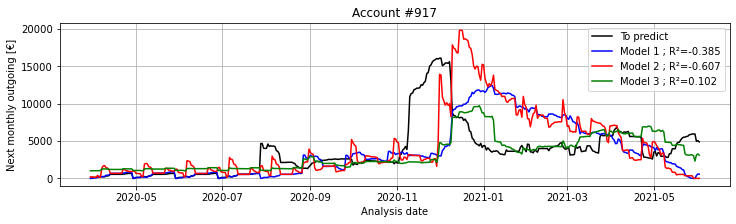

Account #918


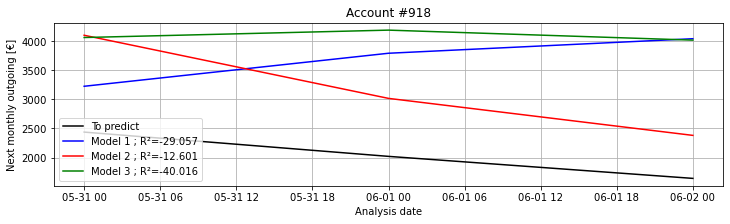

Account #919


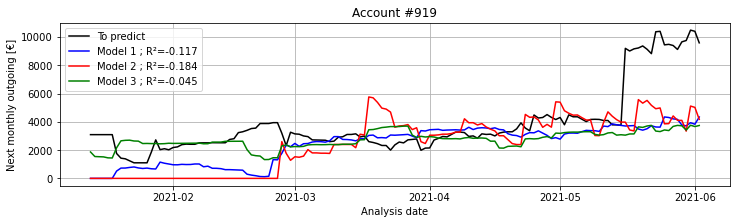

Account #920


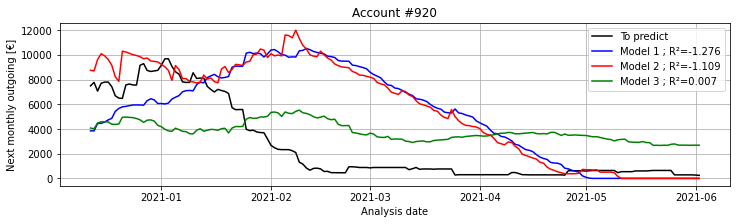

Account #921


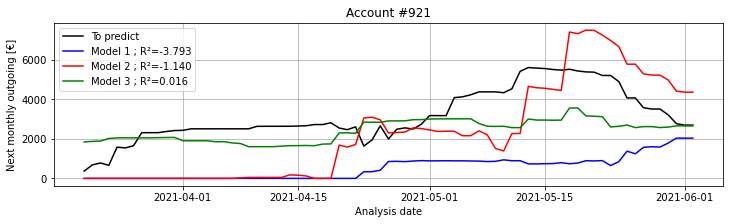

Account #922


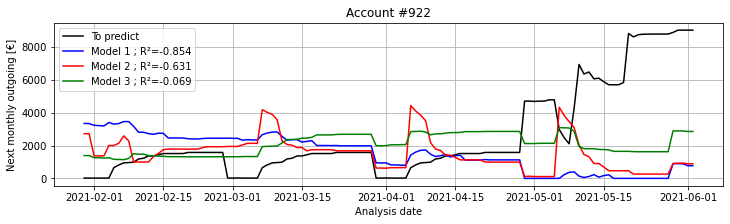

Account #923
No sufficient history for validation of prediction model
Account #924
No sufficient history for validation of prediction model
Account #925


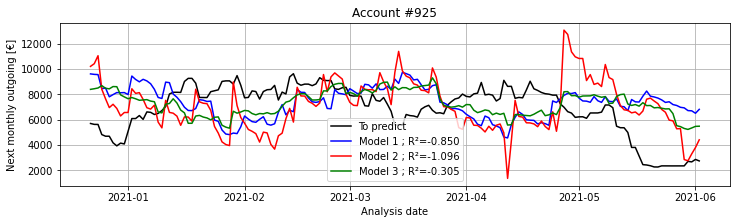

Account #926
No sufficient history for validation of prediction model
Account #927
No sufficient history for validation of prediction model
Account #928


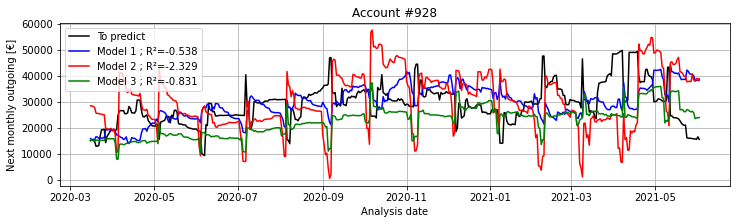

Account #929


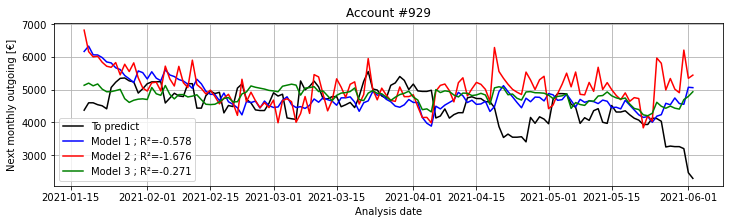

Account #930
No sufficient history for validation of prediction model
Account #931


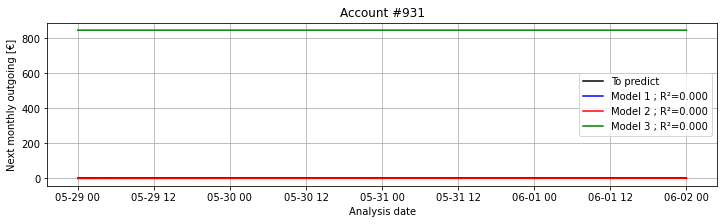

Account #932
No sufficient history for validation of prediction model
Account #933
No sufficient history for validation of prediction model
Account #934


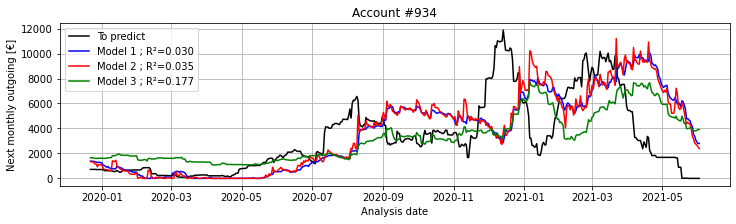

Account #935
No sufficient history for validation of prediction model
Account #936
No sufficient history for validation of prediction model
Account #937


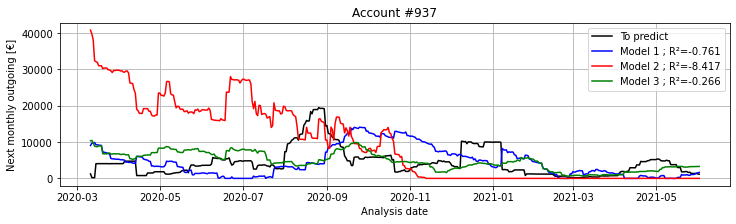

Account #938


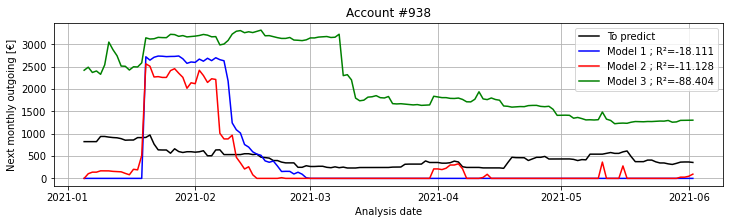

Account #939


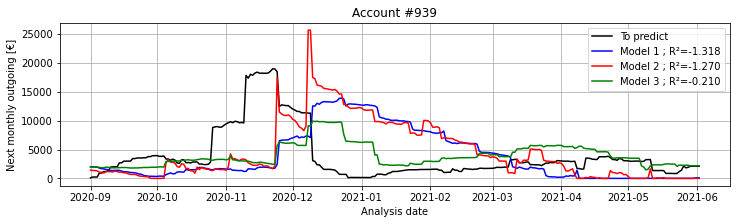

Account #940
No sufficient history for validation of prediction model
Account #941


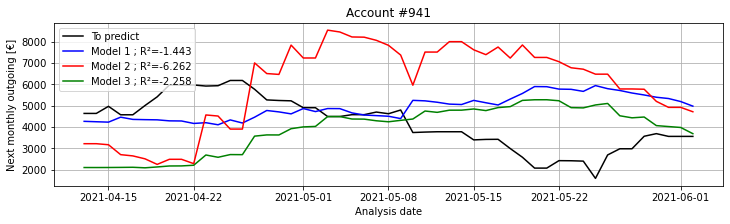

Account #942


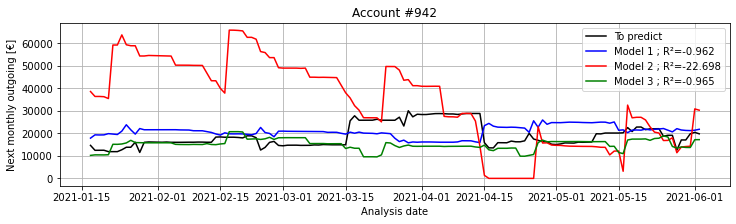

Account #943
No sufficient history for validation of prediction model
Account #944
No sufficient history for validation of prediction model
Account #945
No sufficient history for validation of prediction model
Account #946


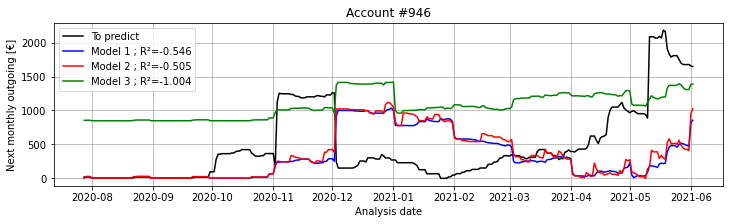

Account #947


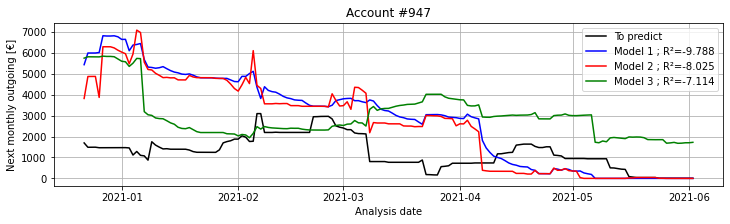

Account #948
No sufficient history for validation of prediction model
Account #949
No sufficient history for validation of prediction model
Account #950
No sufficient history for validation of prediction model
Account #951


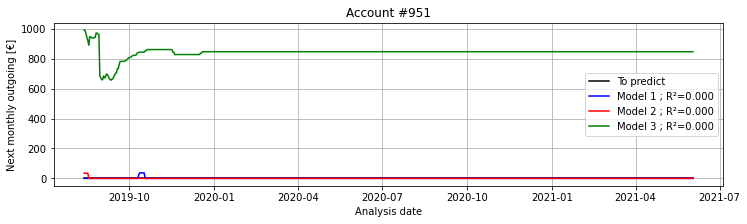

Account #952
No sufficient history for validation of prediction model
Account #953


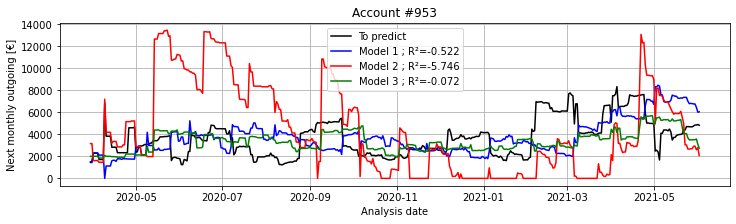

Account #954


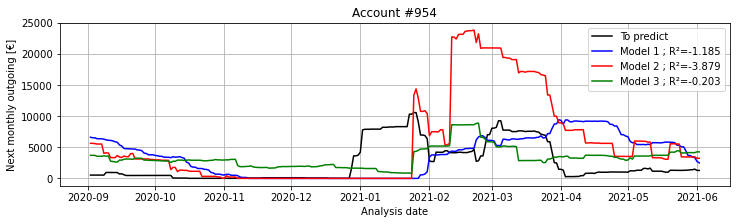

Account #955
No sufficient history for validation of prediction model
Account #956
No sufficient history for validation of prediction model
Account #957
No sufficient history for validation of prediction model
Account #958


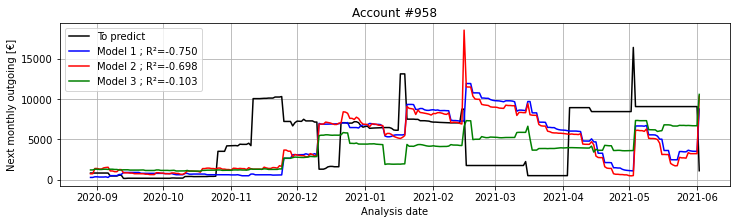

Account #959
No sufficient history for validation of prediction model
Account #960


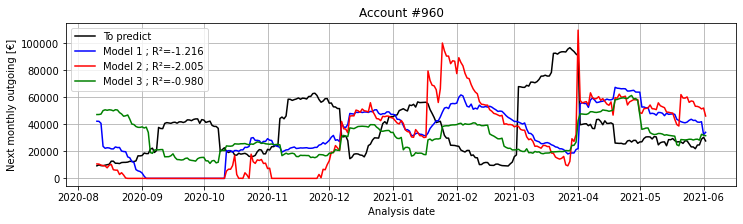

Account #961


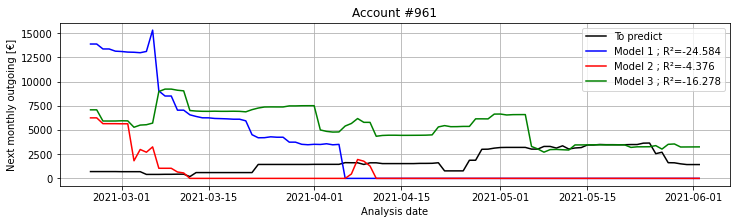

Account #962


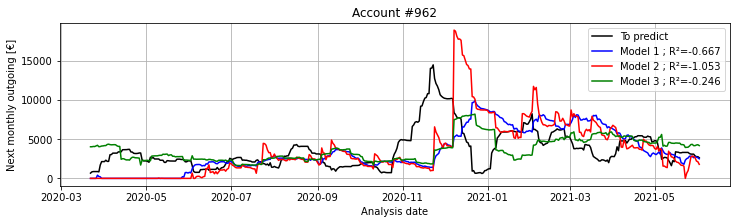

Account #963


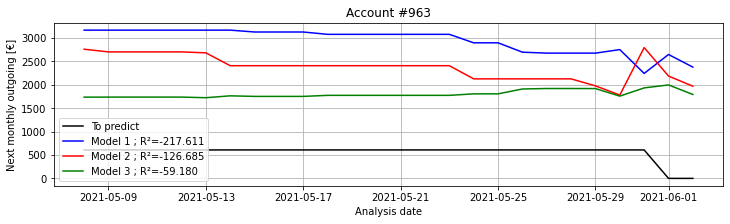

Account #964


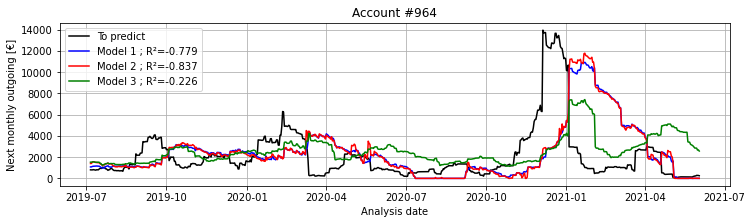

Account #965


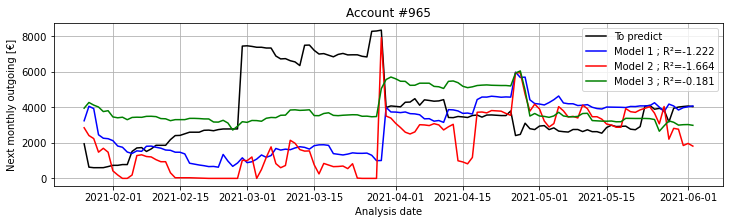

Account #966


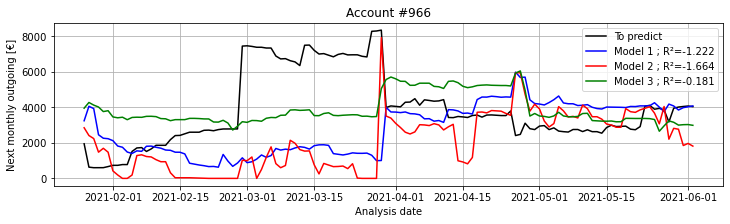

Account #967


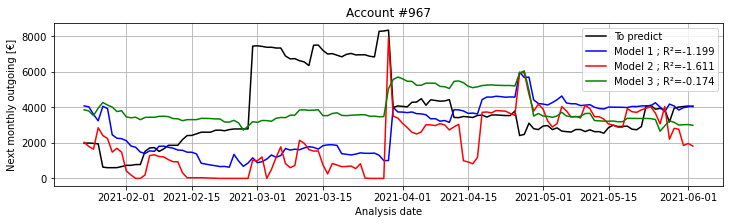

Account #968


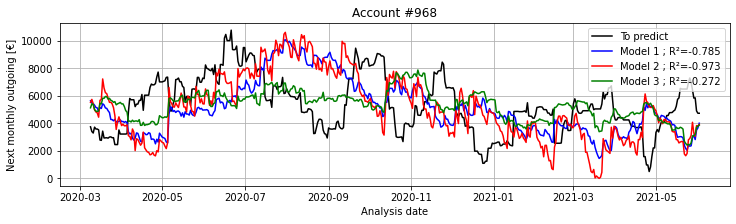

Account #969
No sufficient history for validation of prediction model
Account #970
No sufficient history for validation of prediction model
Account #971


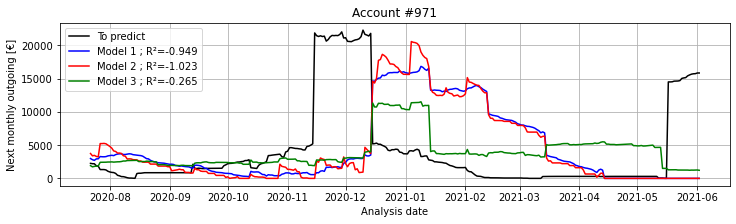

Account #972


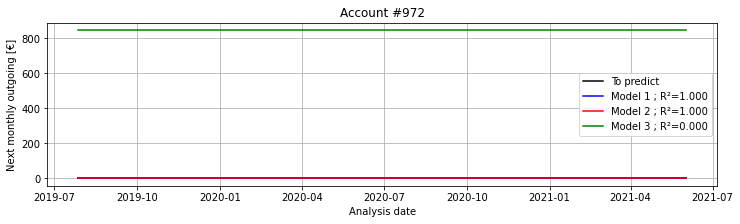

Account #973


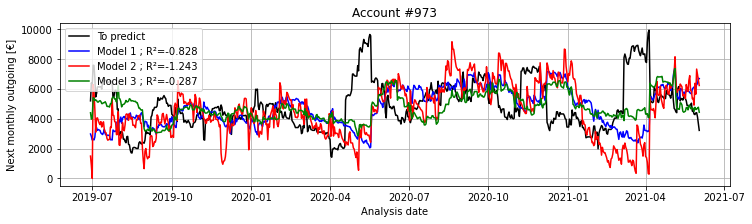

Account #974
No sufficient history for validation of prediction model
Account #975


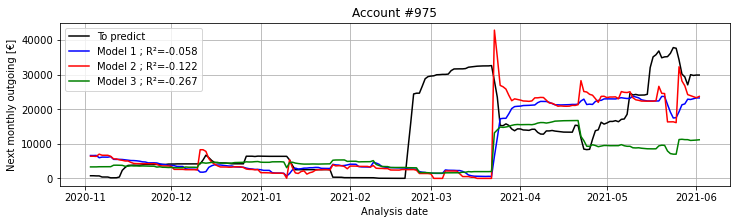

Account #976


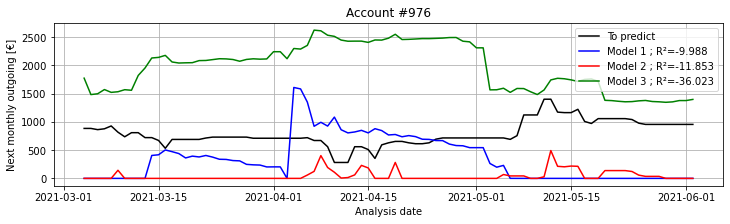

Account #977


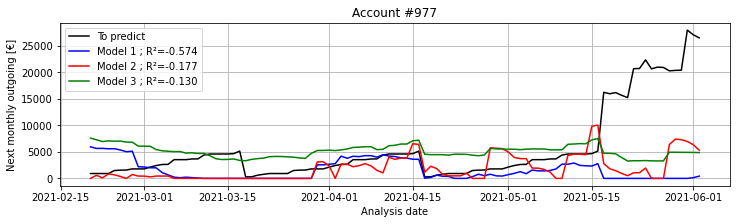

Account #978
No sufficient history for validation of prediction model
Account #979


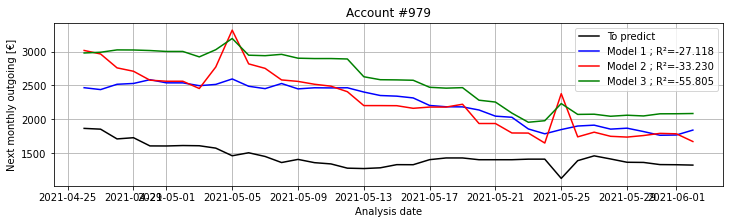

Account #980


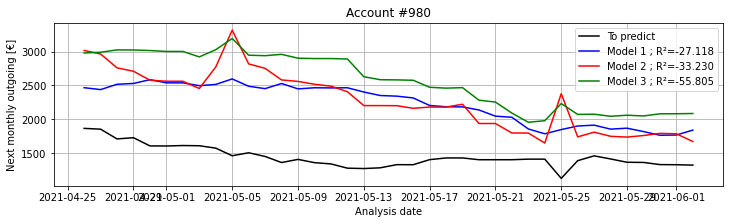

Account #981
No sufficient history for validation of prediction model
Account #982


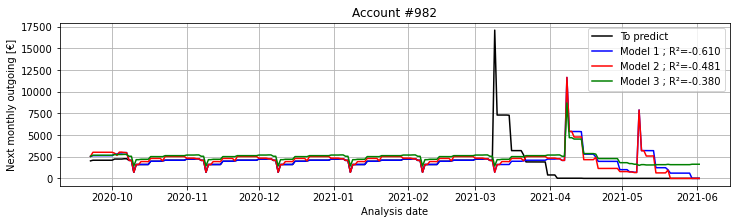

Account #983


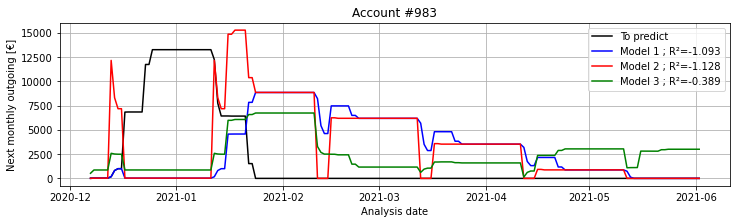

Account #984


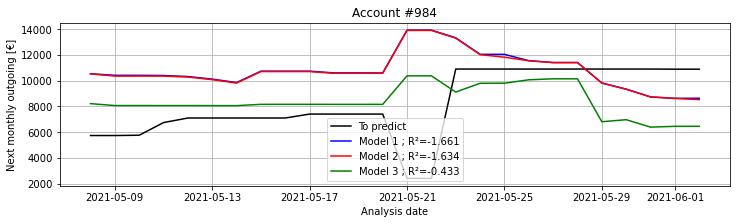

Account #985
No sufficient history for validation of prediction model
Account #986
No sufficient history for validation of prediction model
Account #987
No sufficient history for validation of prediction model
Account #988
No sufficient history for validation of prediction model
Account #989
No sufficient history for validation of prediction model
Account #990


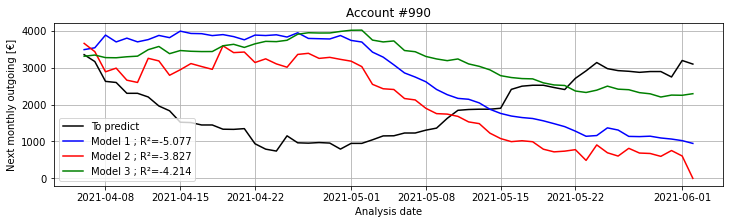

Account #991
No sufficient history for validation of prediction model
Account #992


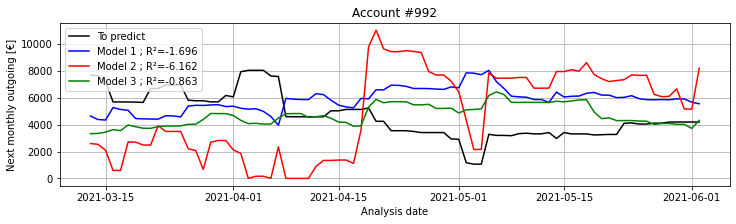

Account #993


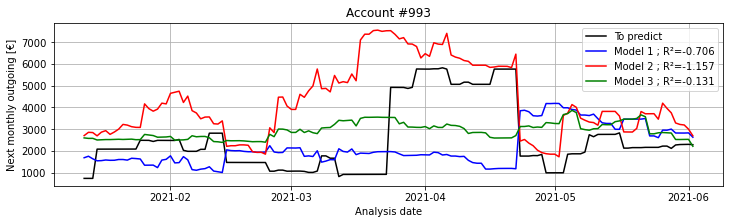

Account #994


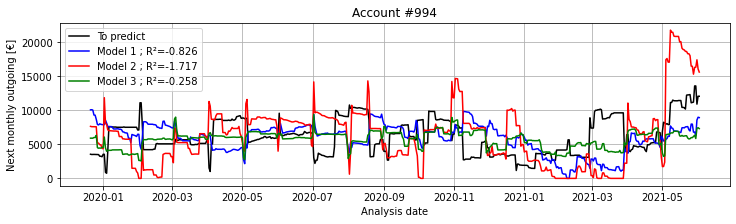

Account #995


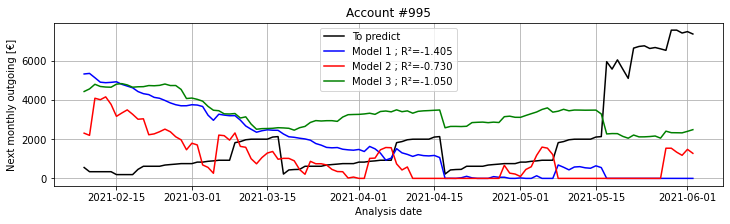

Account #996


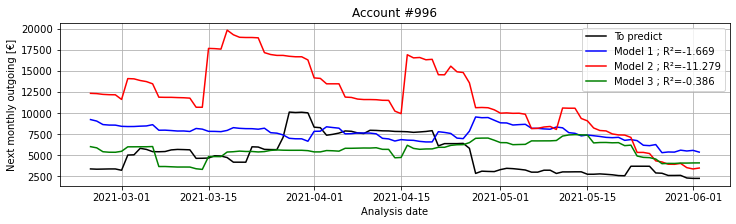

Account #997


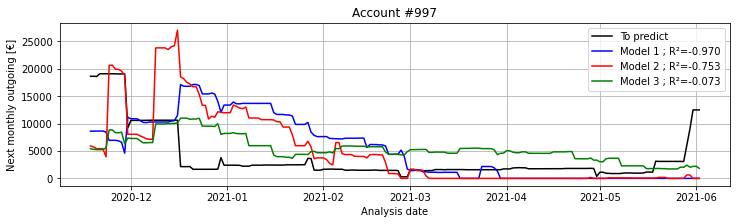

Account #998
No sufficient history for validation of prediction model
Account #999
No sufficient history for validation of prediction model
Account #1000
No sufficient history for validation of prediction model
Account #1001


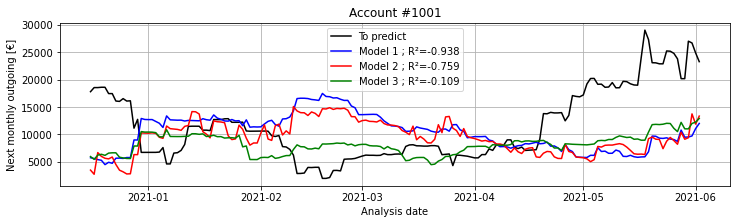

Account #1002


C:\Anaconda3\envs\DataScientist\lib\site-packages\sklearn\metrics\_regression.py:781: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
C:\Anaconda3\envs\DataScientist\lib\site-packages\sklearn\metrics\_regression.py:781: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
C:\Anaconda3\envs\DataScientist\lib\site-packages\sklearn\metrics\_regression.py:781: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


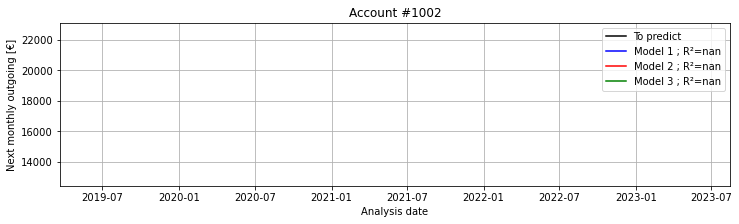

Account #1003


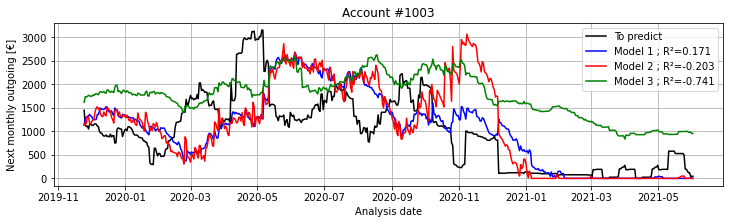

Account #1004
No sufficient history for validation of prediction model
Account #1005


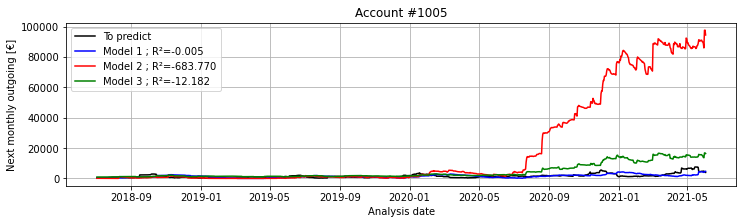

Account #1006


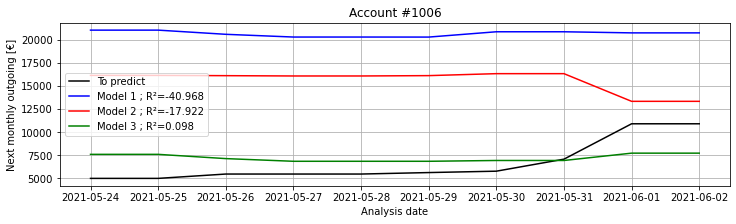

Account #1007


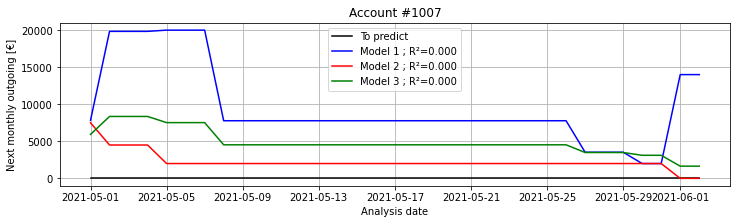

Account #1008
No sufficient history for validation of prediction model
Account #1009


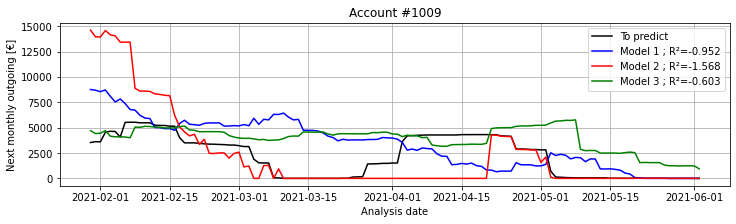

Account #1010


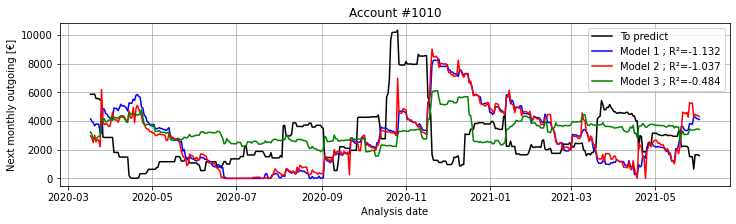

Account #1011


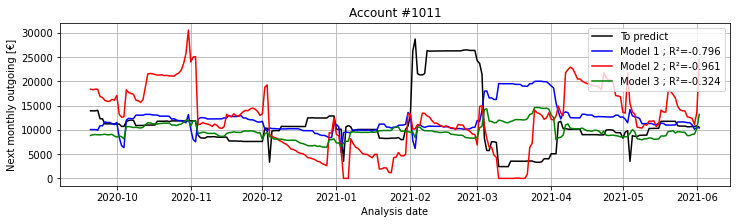

Account #1012


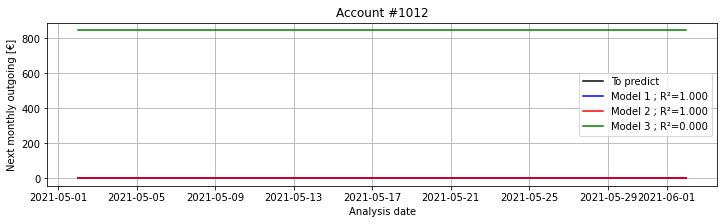

Account #1013


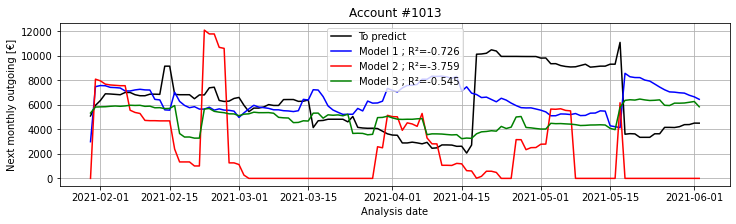

Account #1014


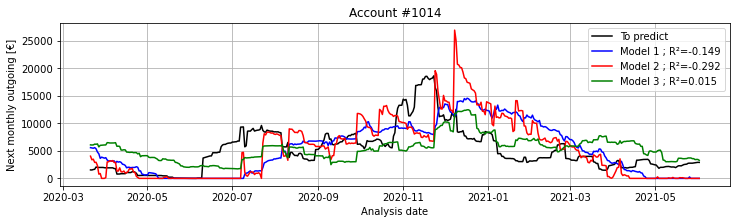

Account #1015
No sufficient history for validation of prediction model
Account #1016
No sufficient history for validation of prediction model
Account #1017


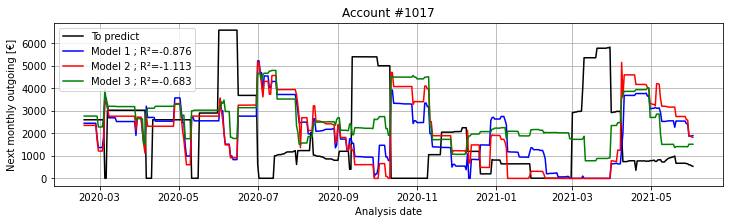

Account #1018


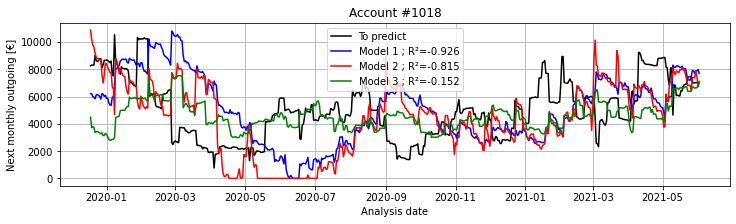

Account #1019
No sufficient history for validation of prediction model
Account #1020


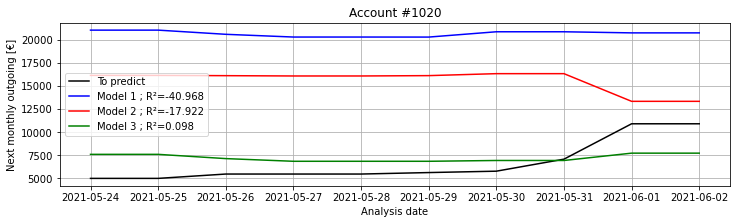

Account #1021


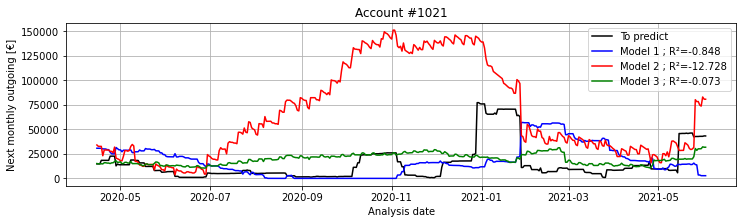

Account #1022


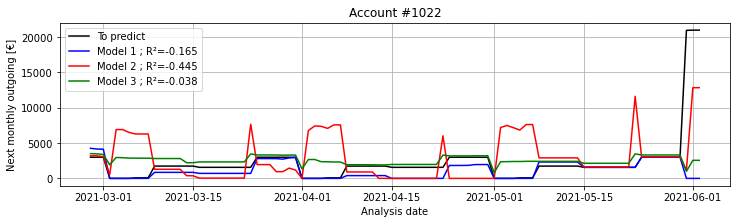

Account #1023


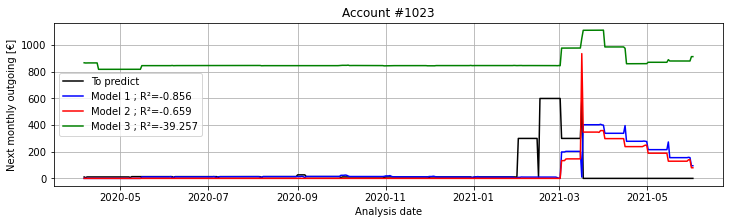

Account #1024


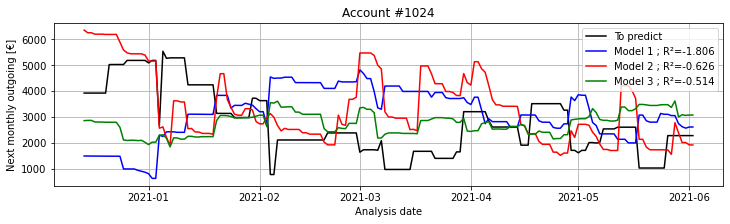

Account #1025


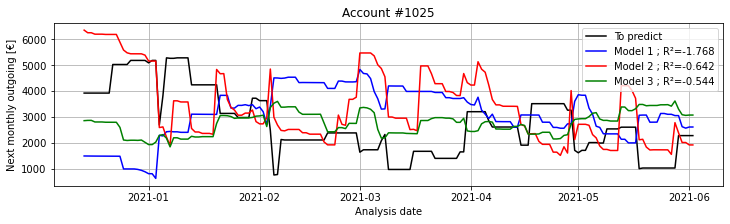

Account #1026


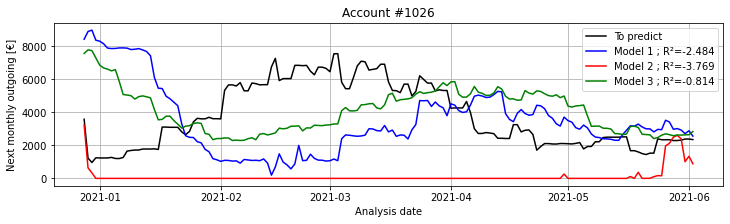

Account #1027


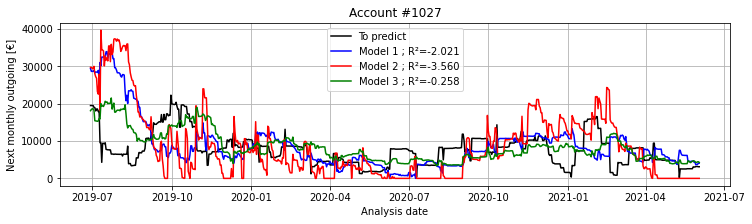

Account #1028


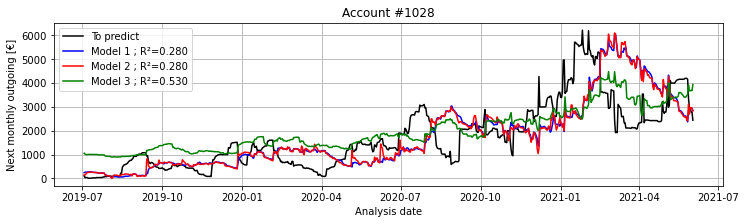

Account #1029
No sufficient history for validation of prediction model
Account #1030


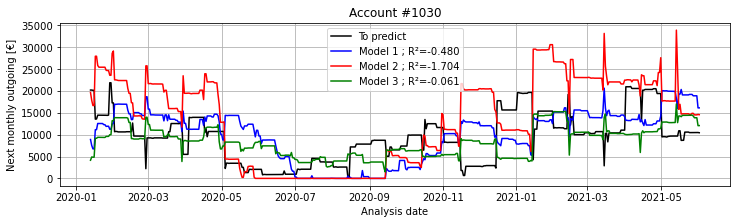

Account #1031


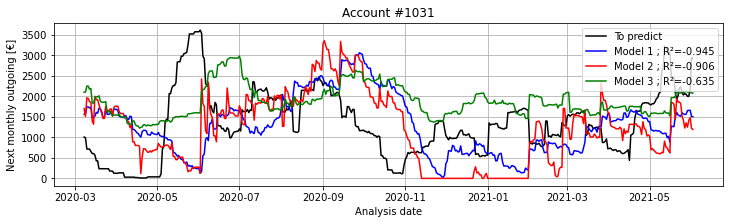

Account #1032


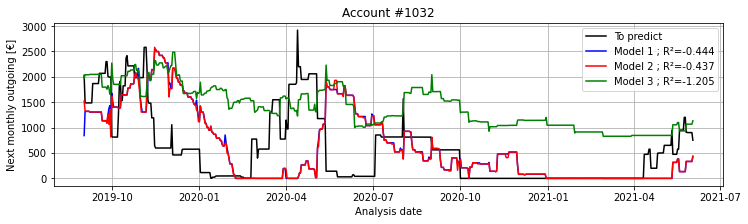

Account #1033


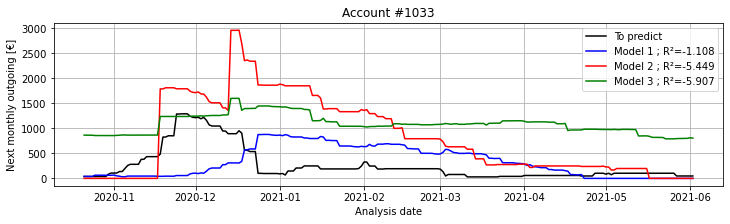

Account #1034


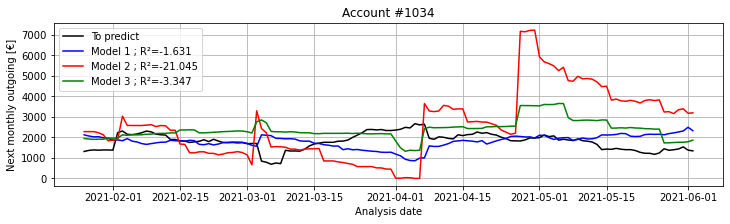

Account #1035
No sufficient history for validation of prediction model
Account #1036
No sufficient history for validation of prediction model
Account #1037


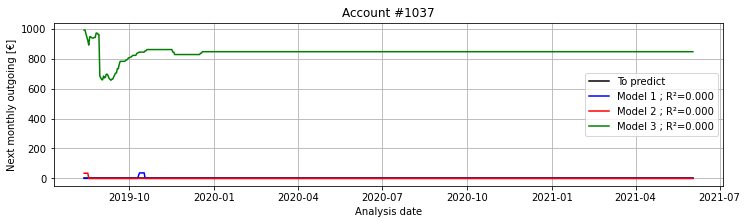

Account #1038


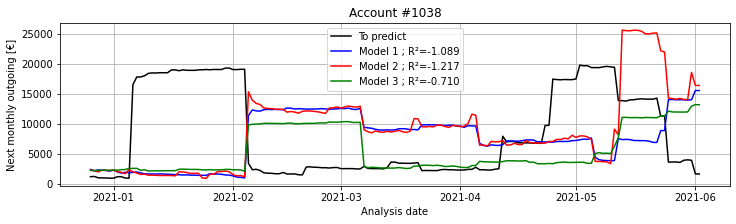

Account #1039


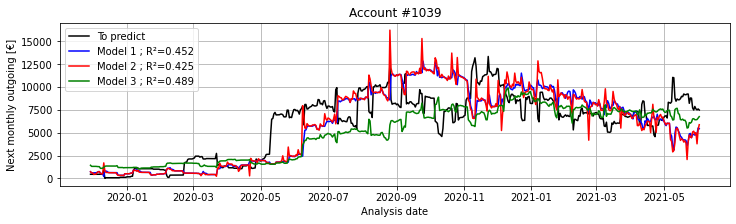

Account #1040


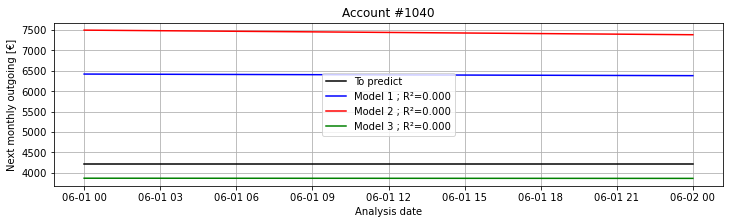

Account #1041


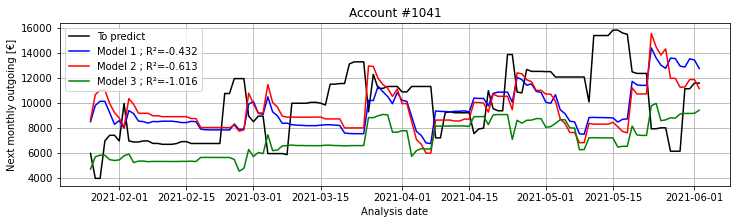

Account #1042


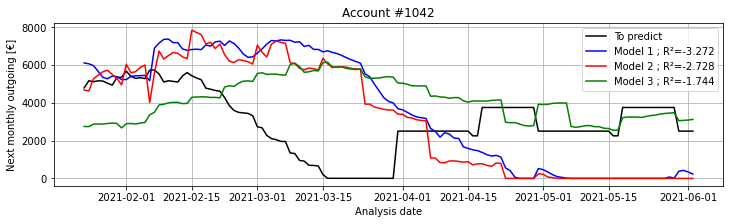

Account #1043


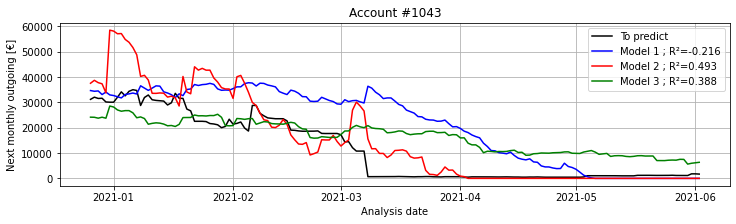

Account #1044


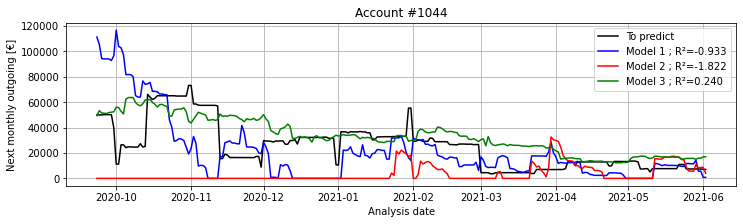

Account #1045


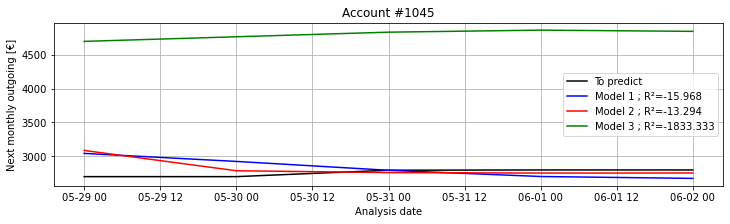

Account #1046
No sufficient history for validation of prediction model
Account #1047
No sufficient history for validation of prediction model
Account #1048
No sufficient history for validation of prediction model
Account #1049
No sufficient history for validation of prediction model
Account #1050


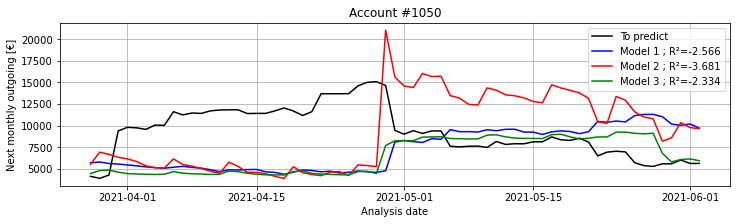

Account #1051


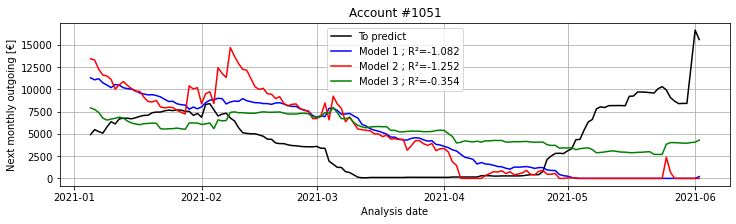

Account #1052


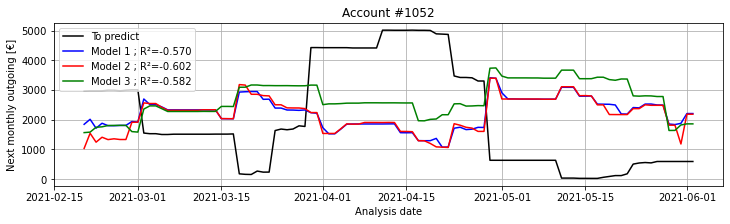

Account #1053


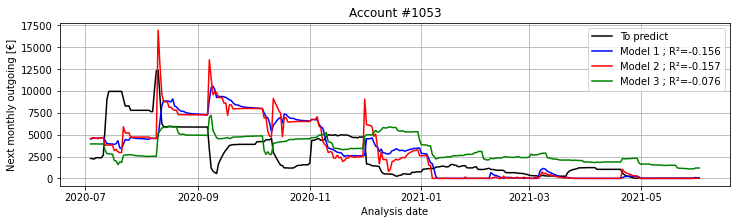

Account #1054


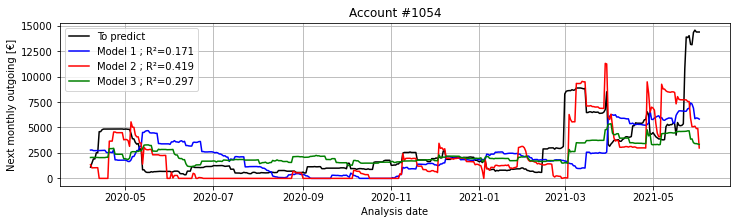

Account #1055


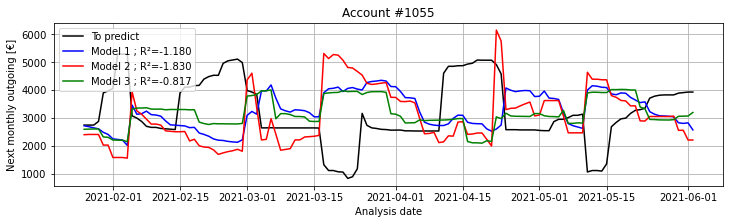

Account #1056


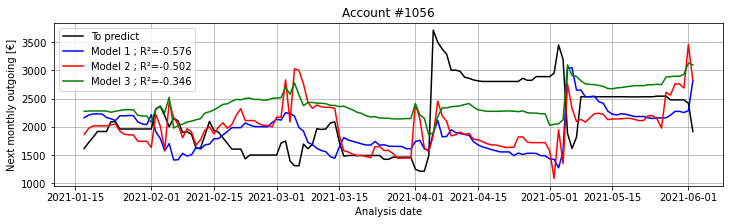

Account #1057


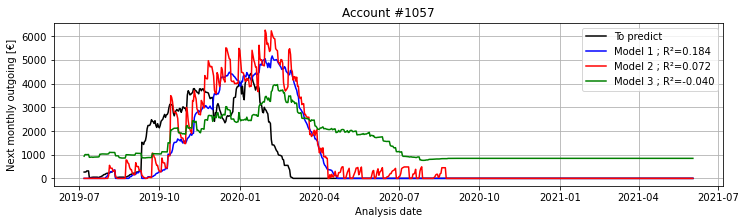

Account #1058


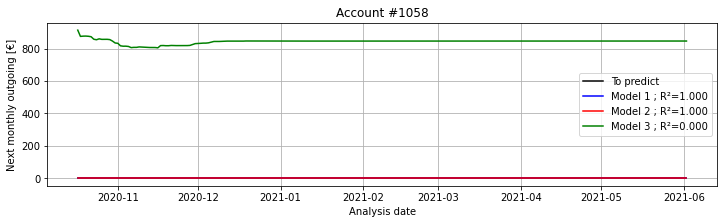

Account #1059


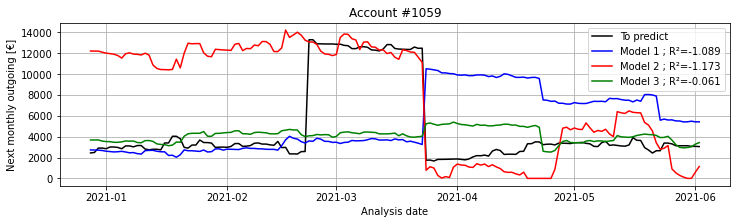

Account #1060
No sufficient history for validation of prediction model
Account #1061


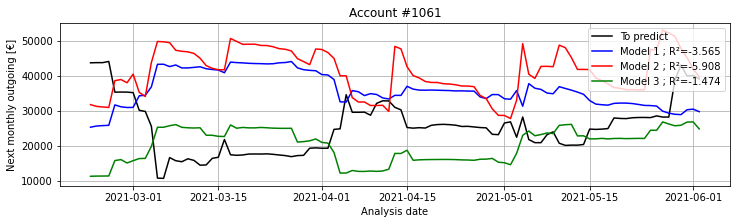

Account #1062


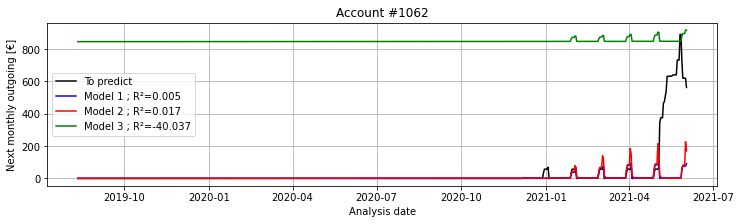

Account #1063


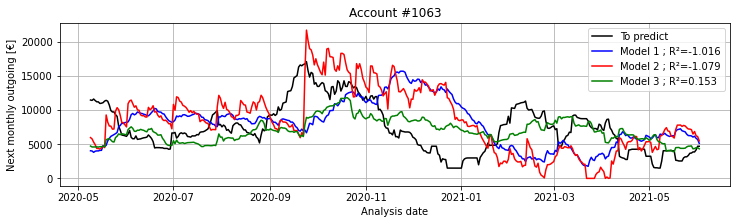

Account #1064
No sufficient history for validation of prediction model
Account #1065


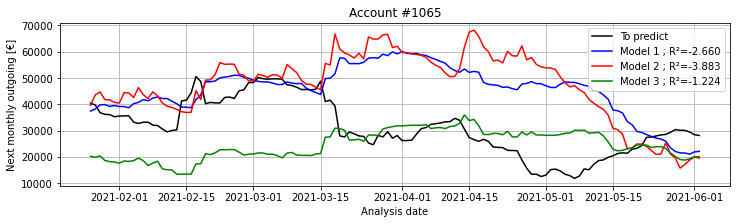

Account #1066
No sufficient history for validation of prediction model
Account #1067


C:\Anaconda3\envs\DataScientist\lib\site-packages\sklearn\metrics\_regression.py:781: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
C:\Anaconda3\envs\DataScientist\lib\site-packages\sklearn\metrics\_regression.py:781: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
C:\Anaconda3\envs\DataScientist\lib\site-packages\sklearn\metrics\_regression.py:781: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


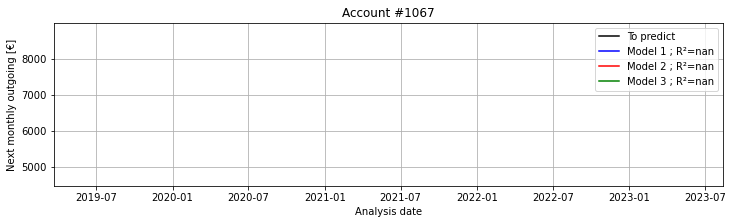

Account #1068
No sufficient history for validation of prediction model
Account #1069


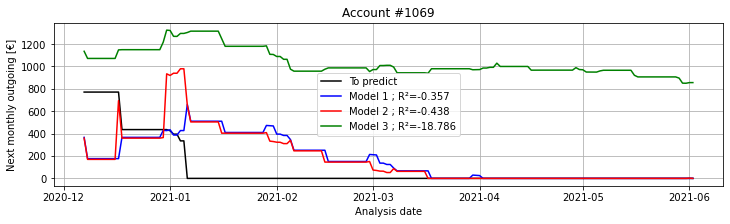

Account #1070
No sufficient history for validation of prediction model
Account #1071


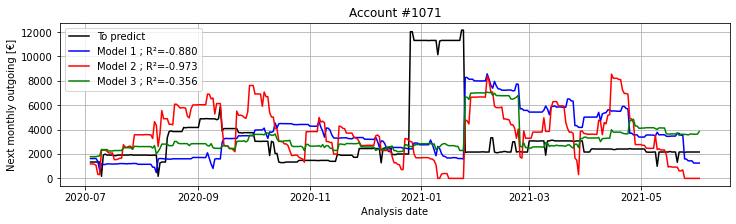

Account #1072


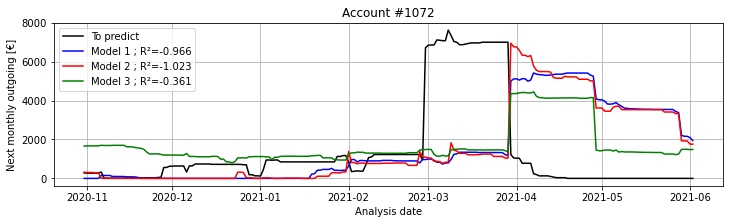

Account #1073
No sufficient history for validation of prediction model
Account #1074


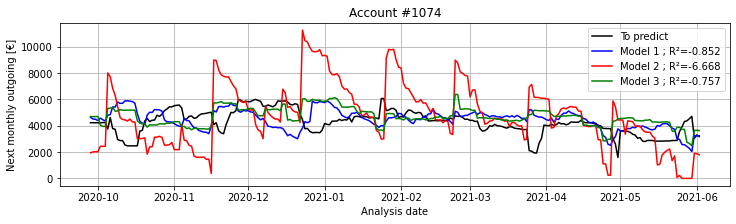

Account #1075


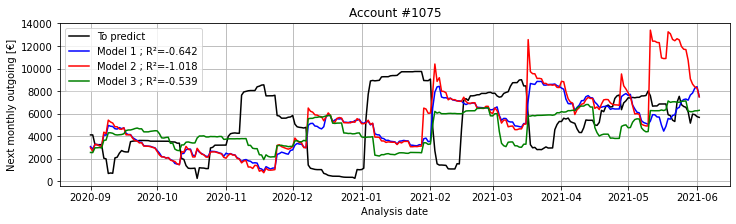

Account #1076


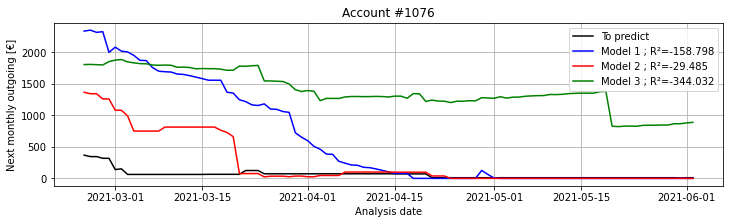

Account #1077


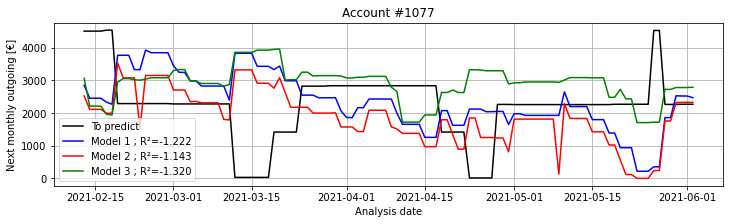

Account #1078


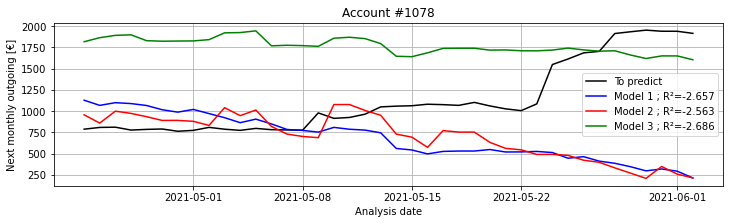

Account #1079


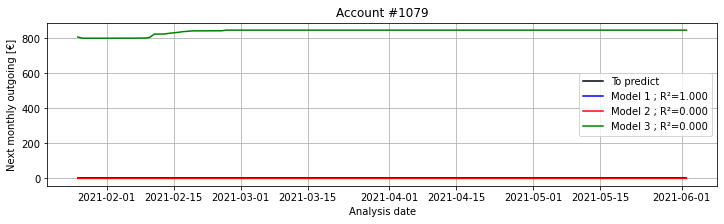

Account #1080


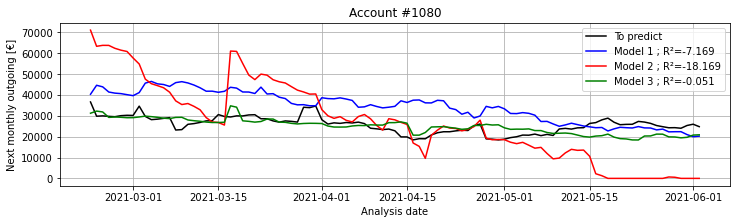

Account #1081
No sufficient history for validation of prediction model
Account #1082


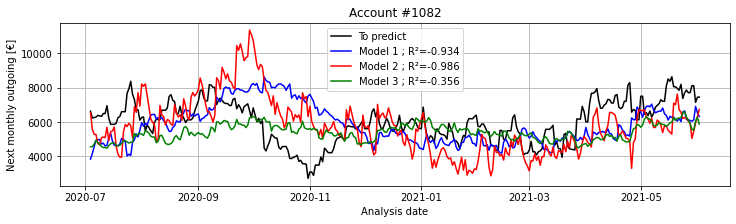

Account #1083


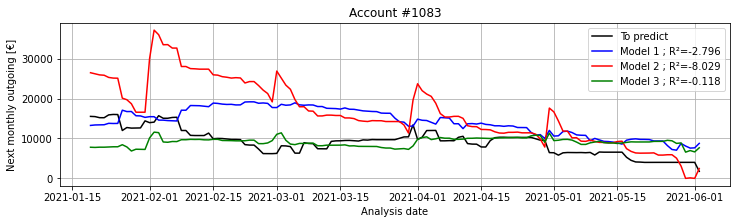

Account #1084


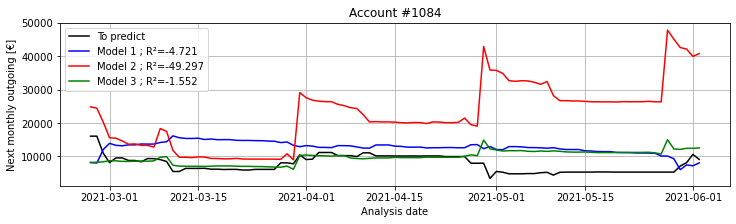

Account #1085


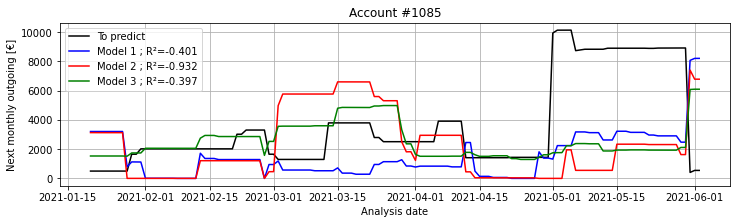

Account #1086


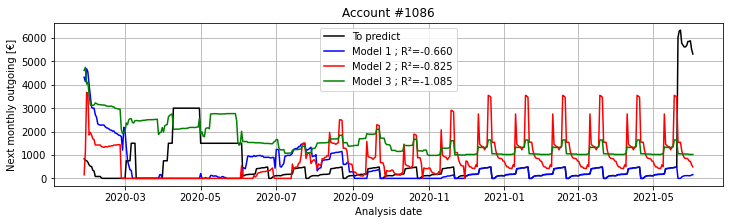

Account #1087
No sufficient history for validation of prediction model
Account #1088


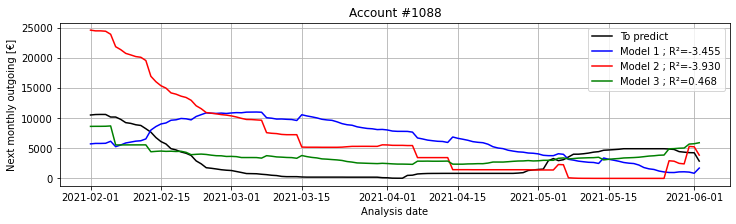

Account #1089
No sufficient history for validation of prediction model
Account #1090
No sufficient history for validation of prediction model
Account #1091
No sufficient history for validation of prediction model
Account #1092


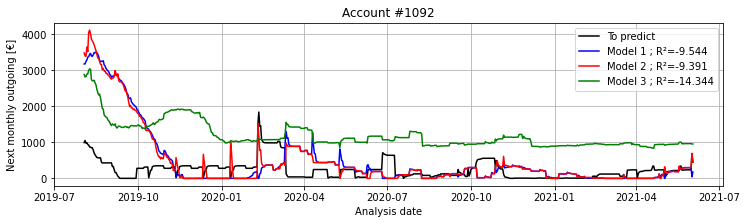

Account #1093
No sufficient history for validation of prediction model
Account #1094
No sufficient history for validation of prediction model
Account #1095


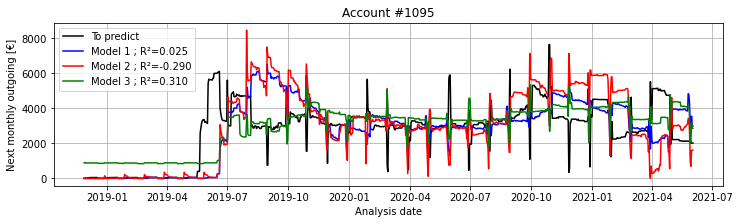

Account #1096
No sufficient history for validation of prediction model
Account #1097


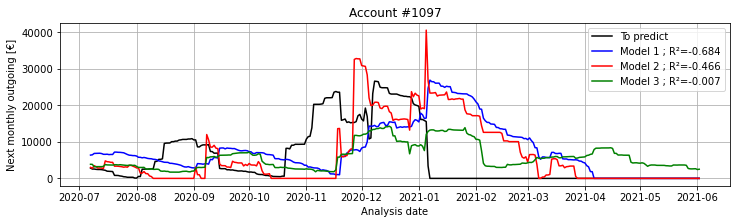

Account #1098
No sufficient history for validation of prediction model
Account #1099


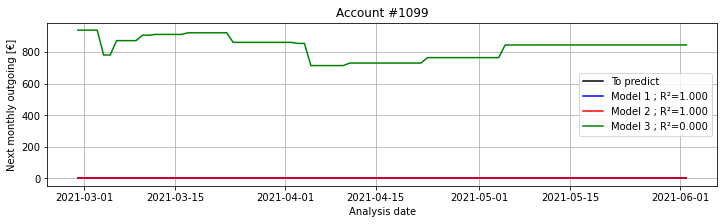

Account #1100


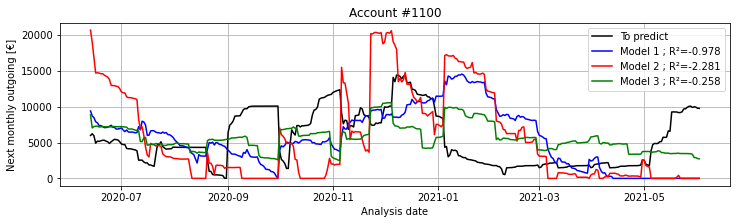

Account #1101


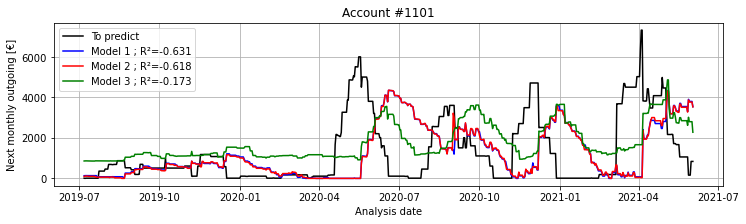

Account #1102


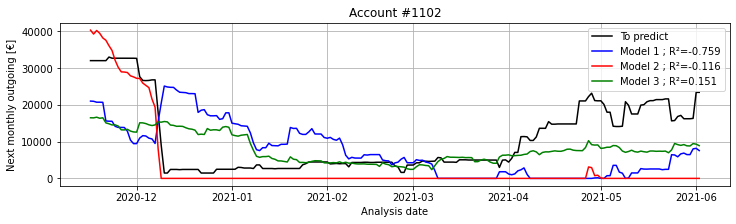

Account #1103


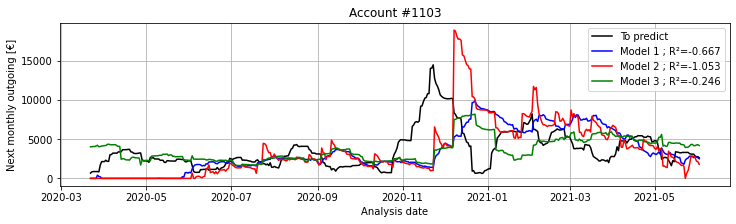

Account #1104


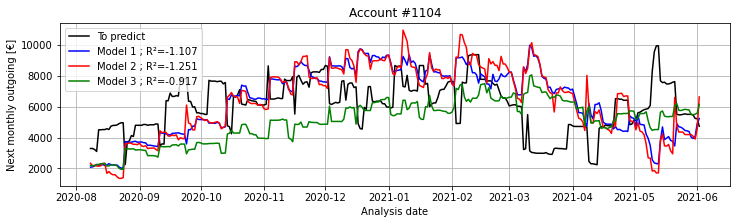

Account #1105


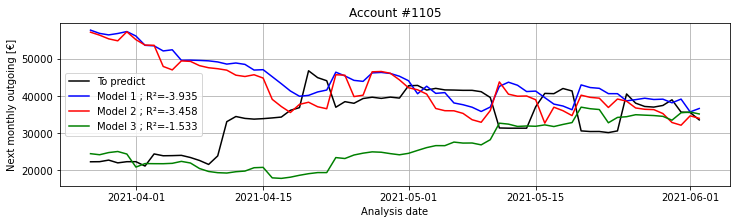

Account #1106


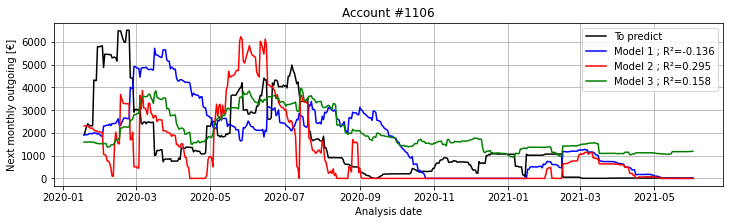

Account #1107


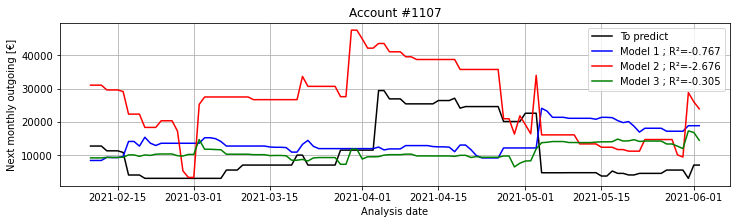

Account #1108


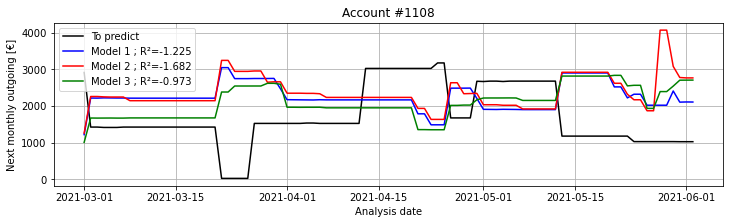

Account #1109
No sufficient history for validation of prediction model
Account #1110


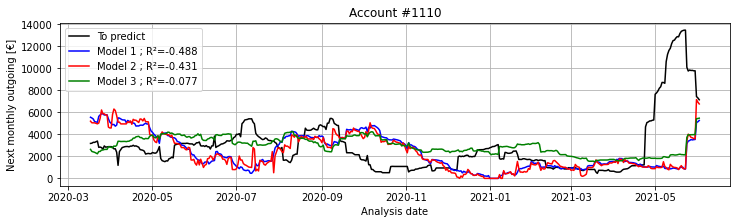

Account #1111


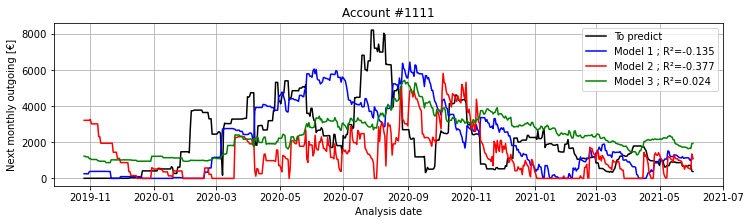

Account #1112
No sufficient history for validation of prediction model
Account #1113
No sufficient history for validation of prediction model
Account #1114


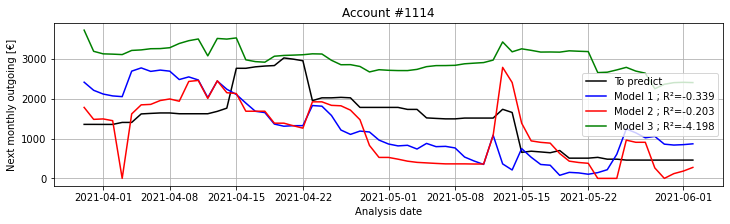

Account #1115


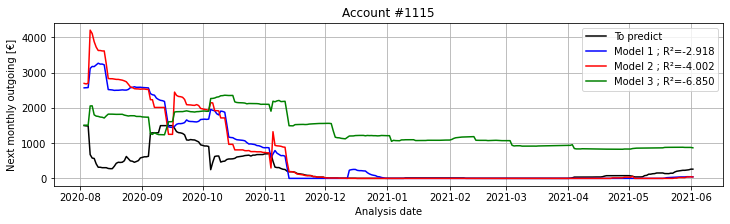

Account #1116


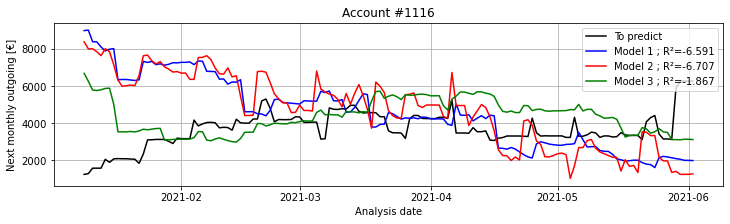

Account #1117


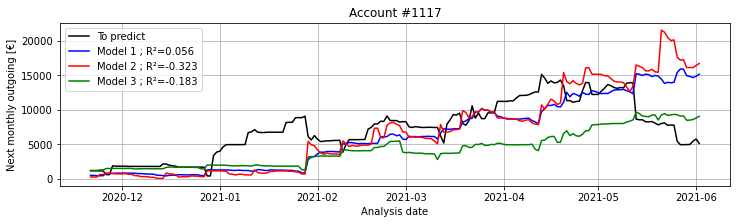

Account #1118
No sufficient history for validation of prediction model
Account #1119


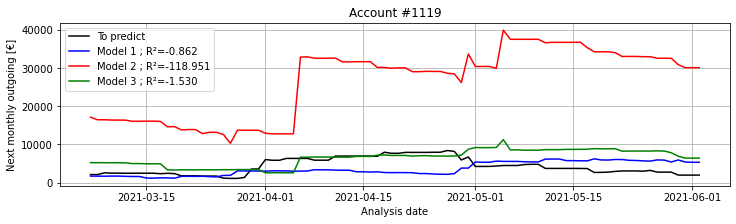

Account #1120


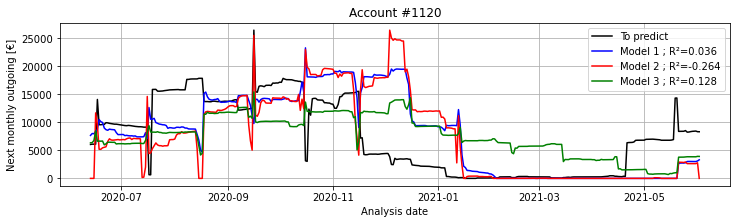

Account #1121


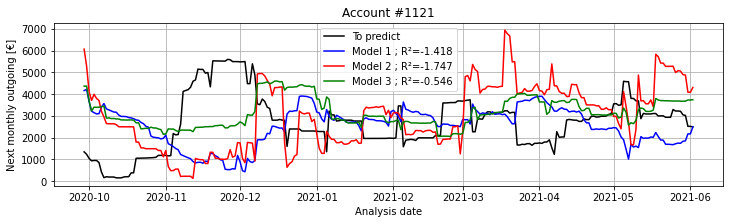

Account #1122
No sufficient history for validation of prediction model
Account #1123


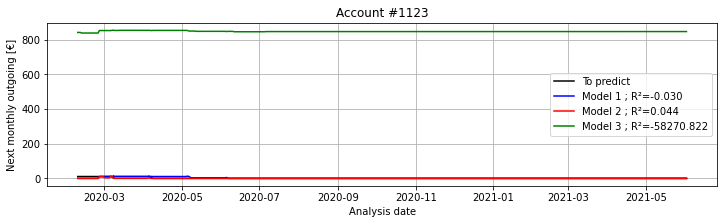

Account #1124


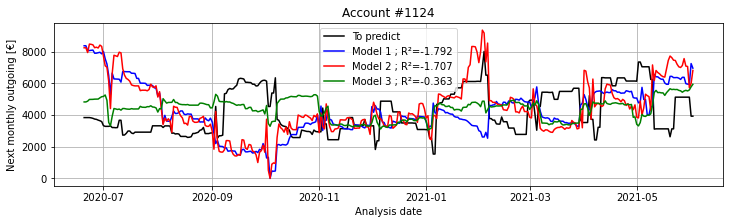

Account #1125


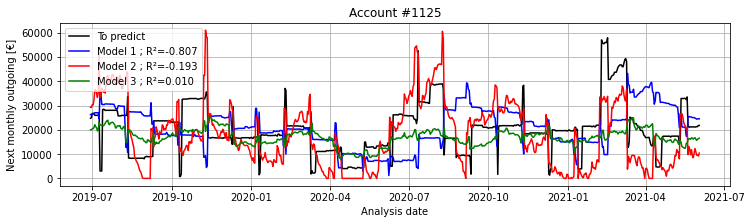

Account #1126


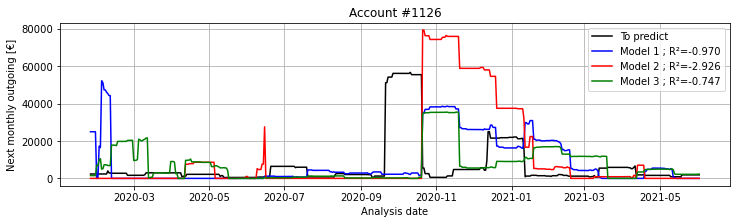

Account #1127


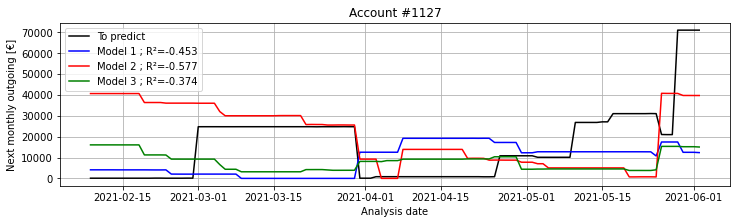

Account #1128


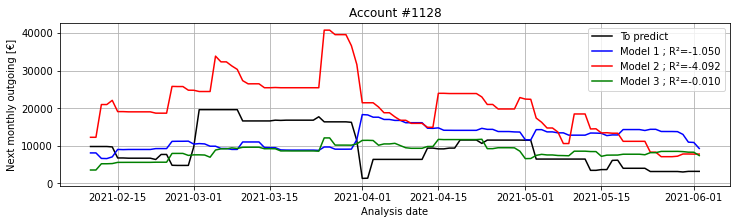

Account #1129


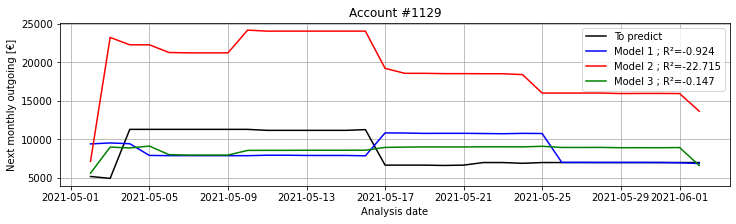

Account #1130
No sufficient history for validation of prediction model
Account #1131


C:\Anaconda3\envs\DataScientist\lib\site-packages\sklearn\metrics\_regression.py:781: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
C:\Anaconda3\envs\DataScientist\lib\site-packages\sklearn\metrics\_regression.py:781: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
C:\Anaconda3\envs\DataScientist\lib\site-packages\sklearn\metrics\_regression.py:781: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


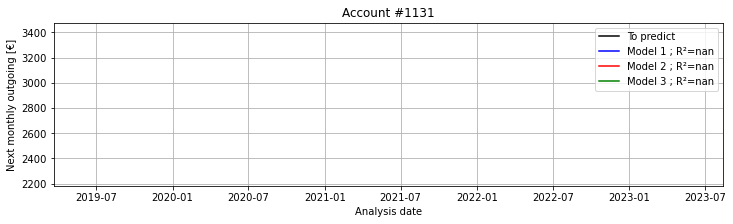

Account #1132


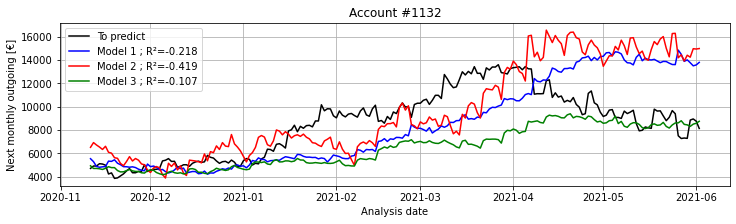

Account #1133


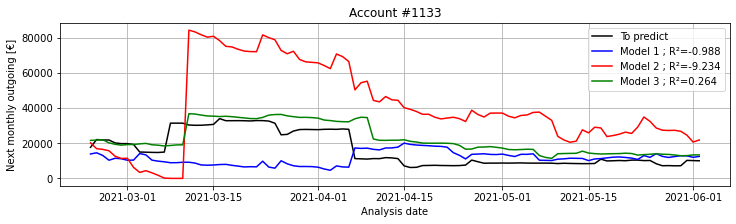

Account #1134
No sufficient history for validation of prediction model
Account #1135
No sufficient history for validation of prediction model
Account #1136


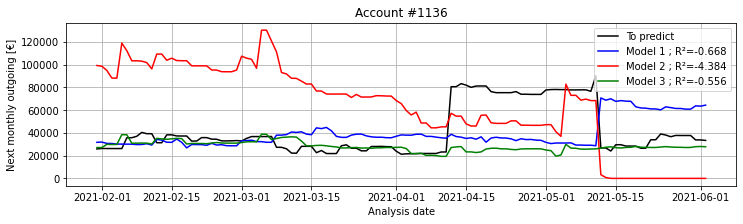

Account #1137


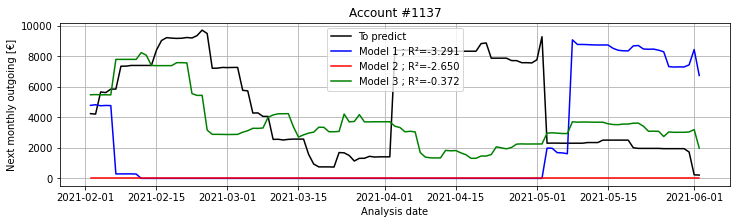

Account #1138


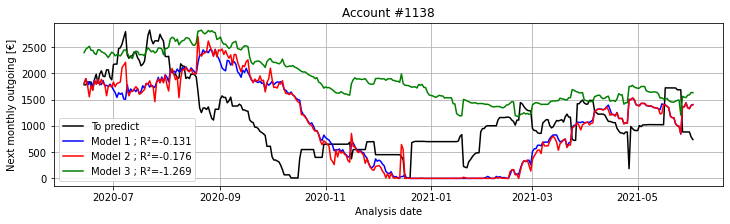

Account #1139
No sufficient history for validation of prediction model
Account #1140


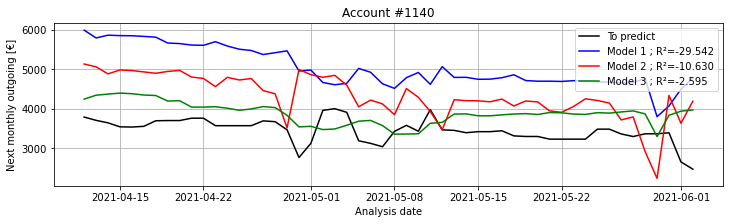

Account #1141


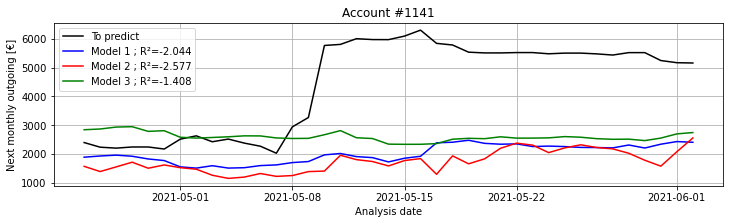

Account #1142


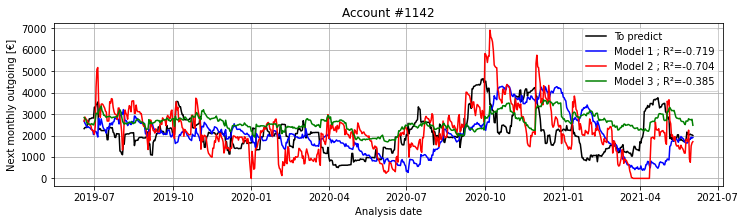

Account #1143
No sufficient history for validation of prediction model
Account #1144


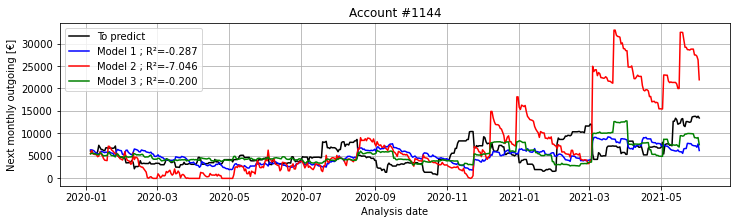

Account #1145


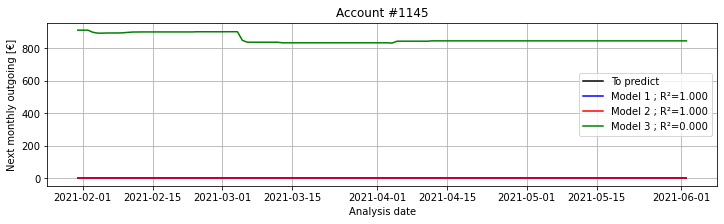

Account #1146


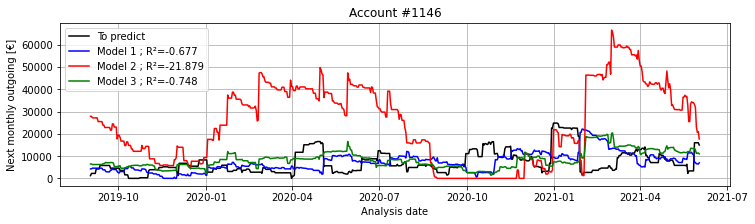

Account #1147


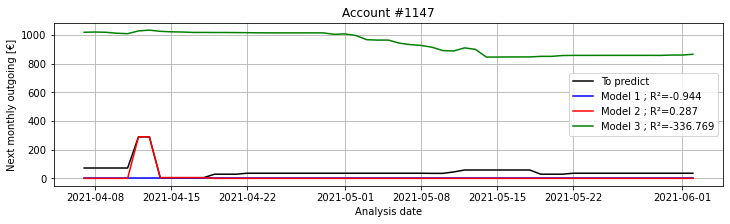

Account #1148


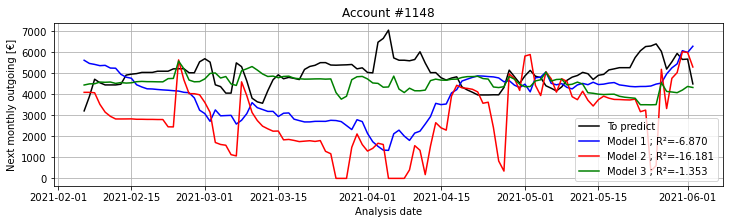

Account #1149


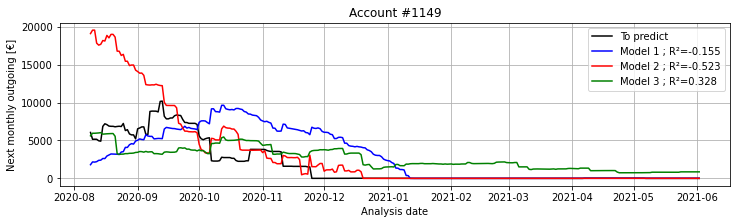

Account #1150
No sufficient history for validation of prediction model
Account #1151
No sufficient history for validation of prediction model
Account #1152
No sufficient history for validation of prediction model
Account #1153


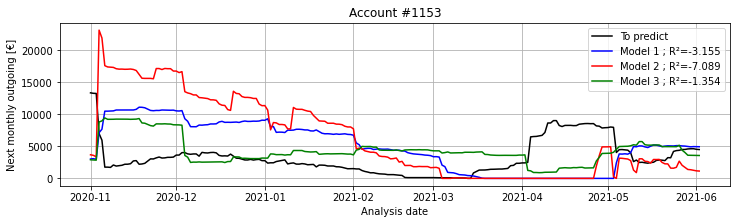

Account #1154


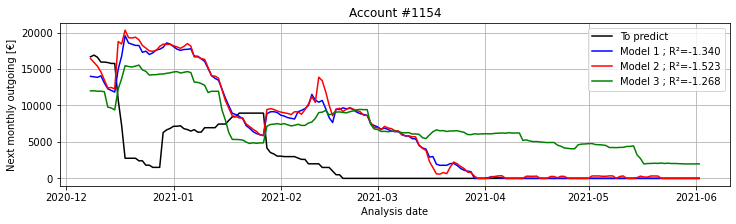

Account #1155


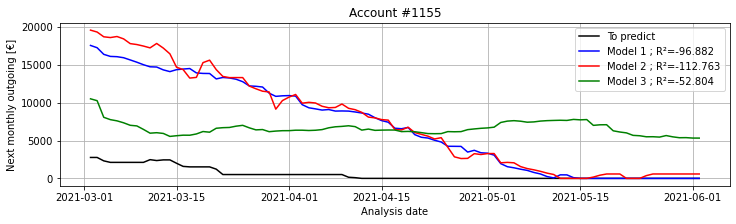

Account #1156


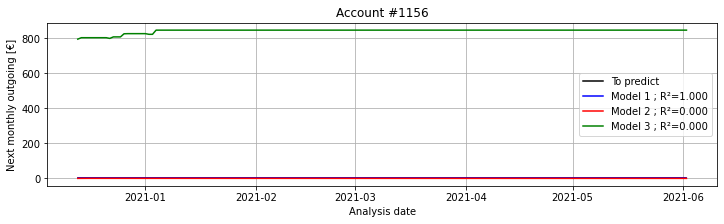

Account #1157


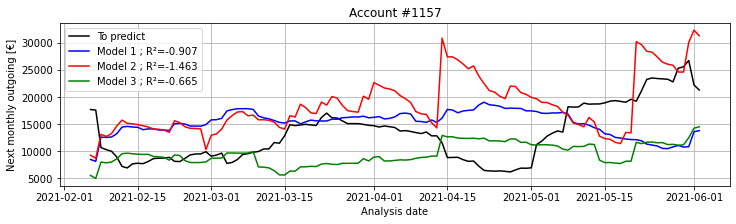

Account #1158
No sufficient history for validation of prediction model
Account #1159


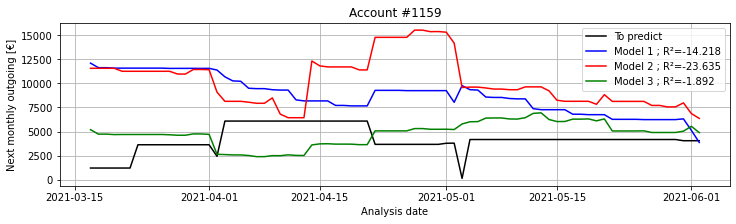

Account #1160
No sufficient history for validation of prediction model
Account #1161


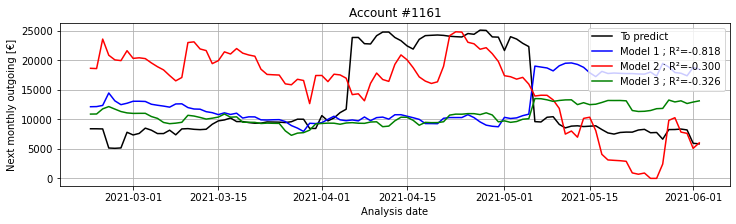

Account #1162


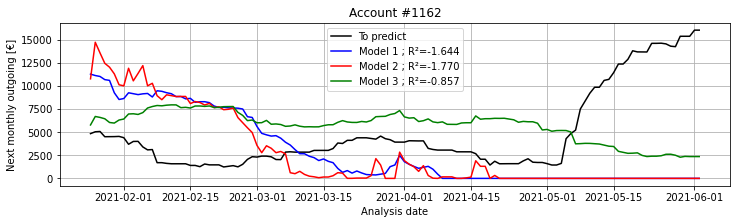

Account #1163


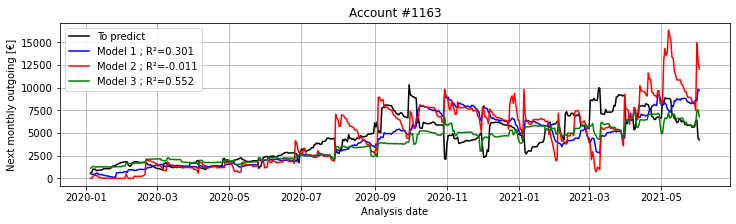

Account #1164


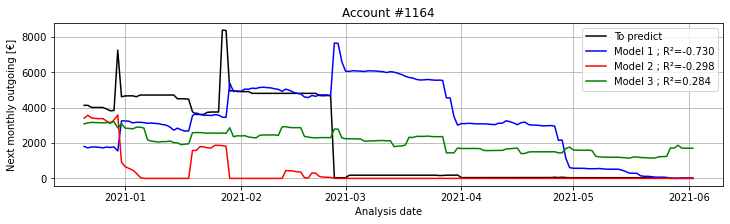

Account #1165


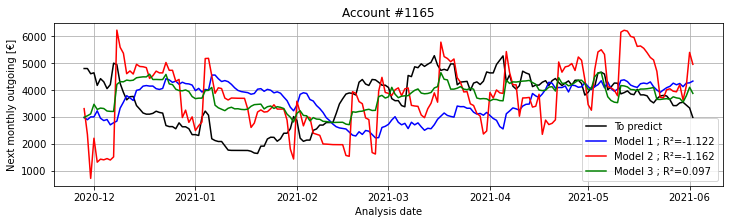

Account #1166


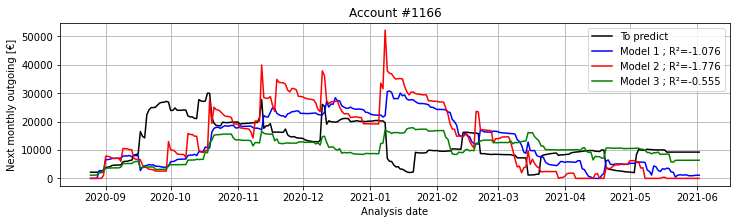

Account #1167


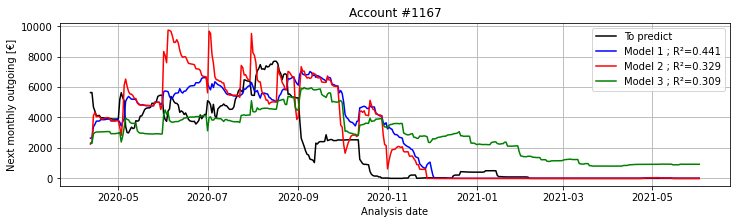

Account #1168


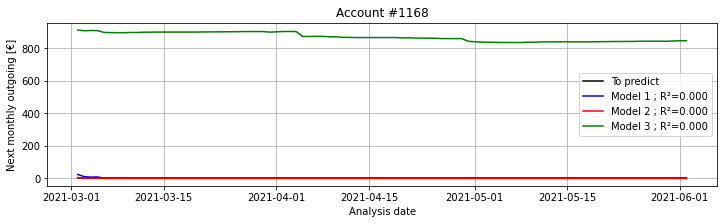

Account #1169


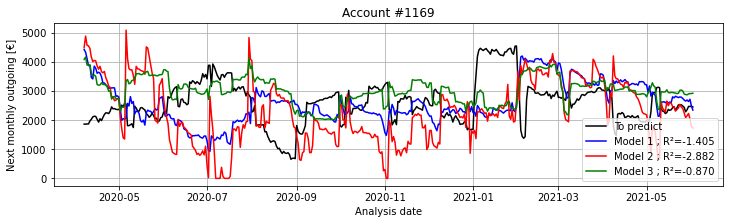

Account #1170


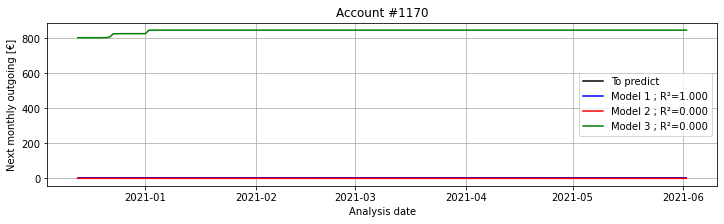

Account #1171


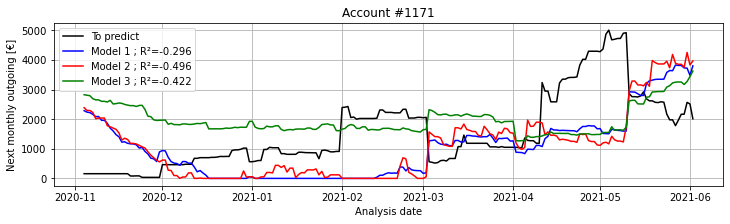

Account #1172


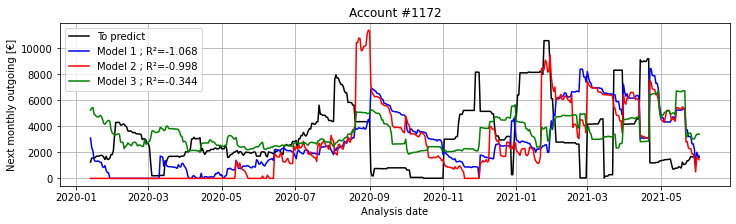

Account #1173


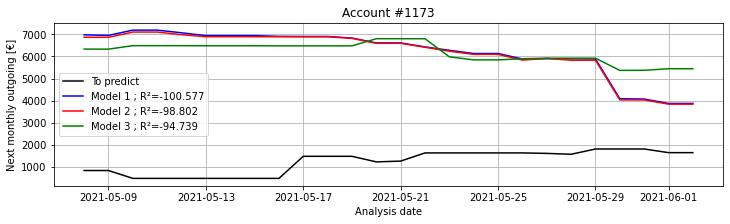

Account #1174


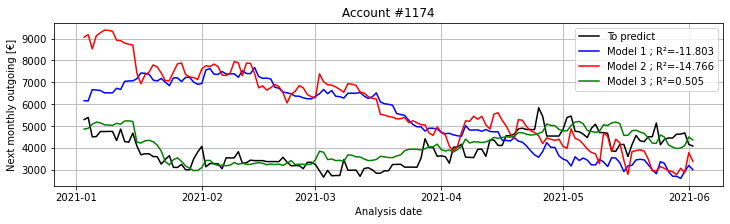

Account #1175
No sufficient history for validation of prediction model
Account #1176
No sufficient history for validation of prediction model
Account #1177


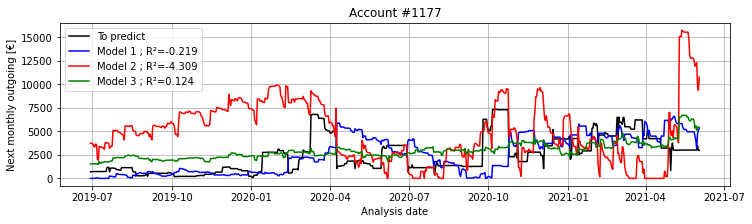

Account #1178


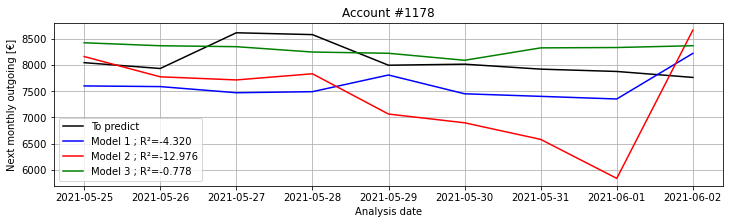

Account #1179


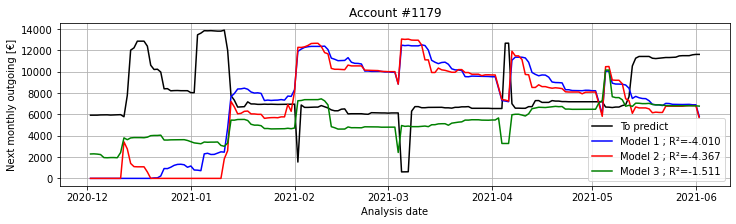

Account #1180


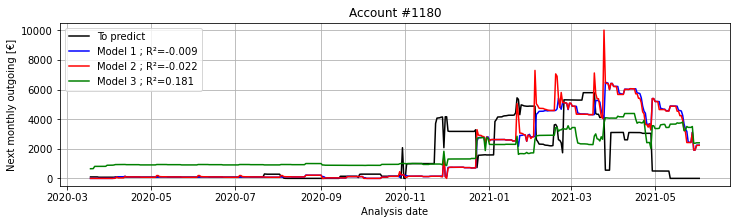

Account #1181


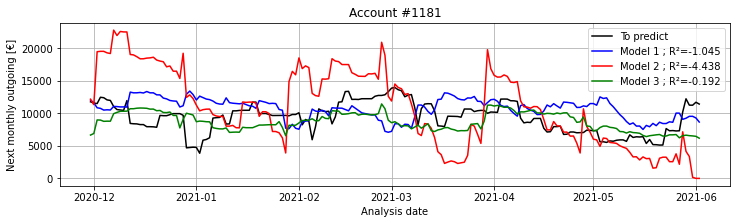

Account #1182


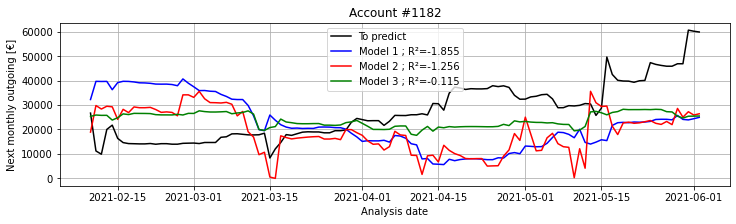

Account #1183


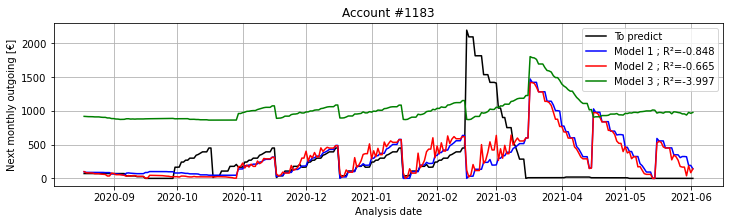

Account #1184


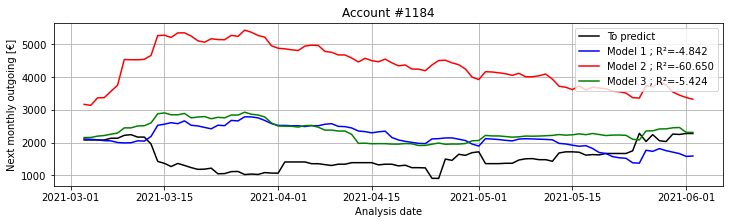

Account #1185
No sufficient history for validation of prediction model
Account #1186


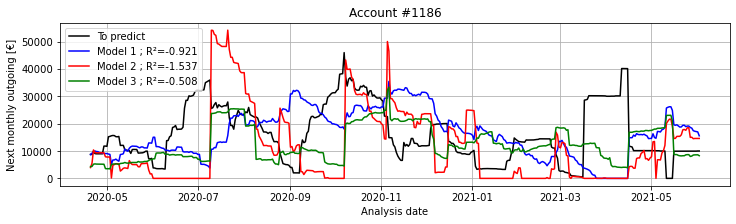

Account #1187
No sufficient history for validation of prediction model
Account #1188
No sufficient history for validation of prediction model
Account #1189
No sufficient history for validation of prediction model
Account #1190


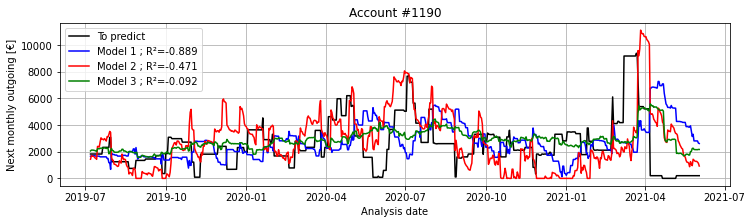

Account #1191


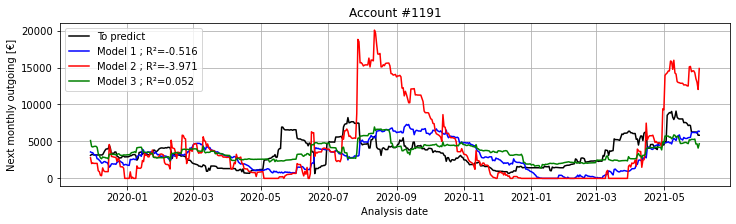

Account #1192
No sufficient history for validation of prediction model
Account #1193


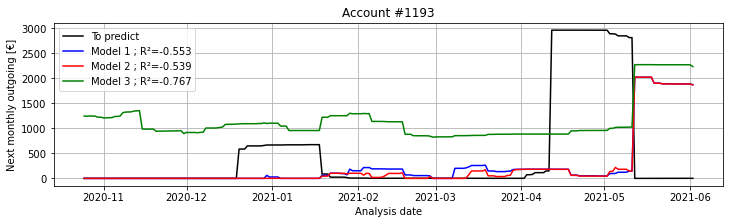

Account #1194


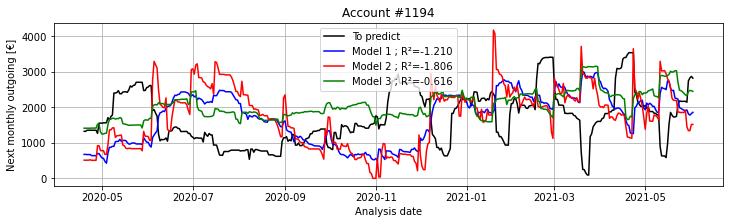

Account #1195


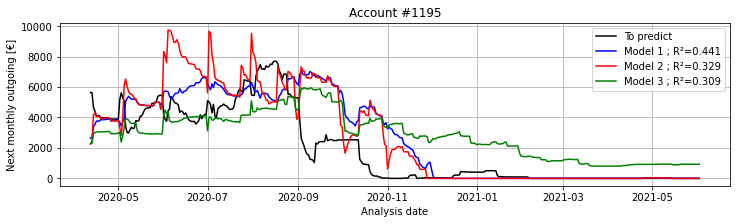

Account #1196
No sufficient history for validation of prediction model
Account #1197


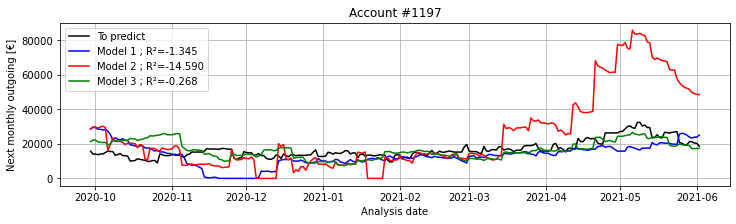

Account #1198


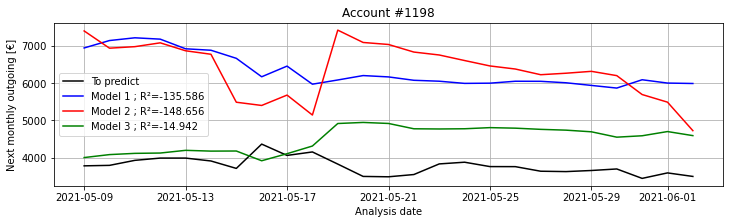

Account #1199


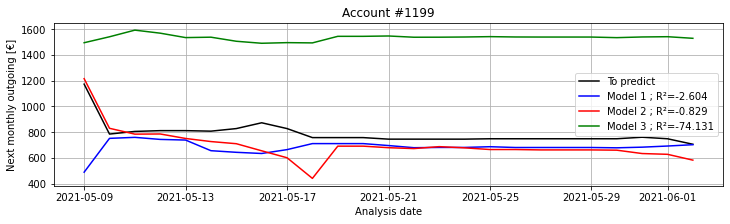

Account #1200


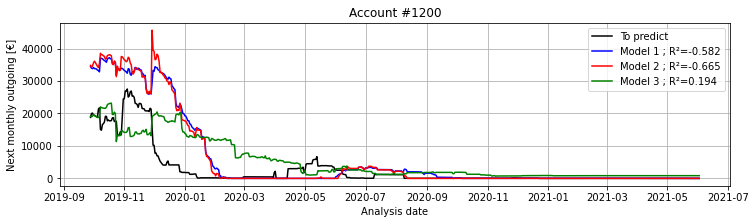

Account #1201
No sufficient history for validation of prediction model
Account #1202


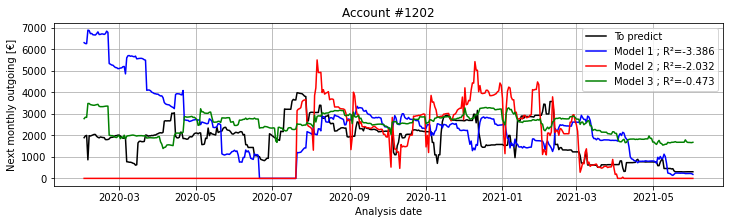

Account #1203


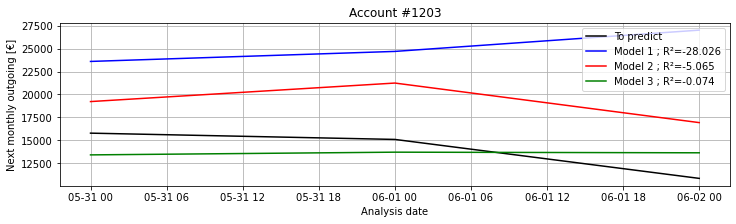

Account #1204


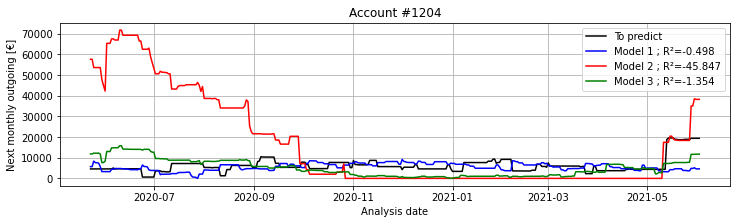

Account #1205


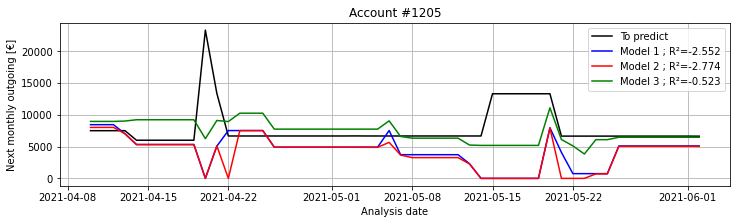

Account #1206


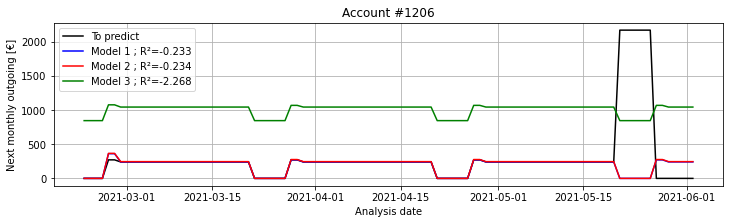

Account #1207


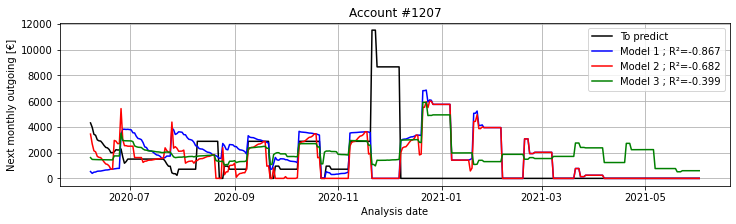

Account #1208


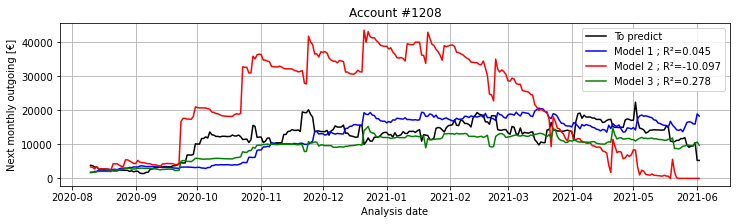

Account #1209


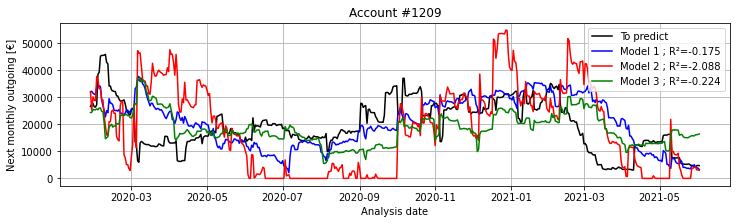

Account #1210


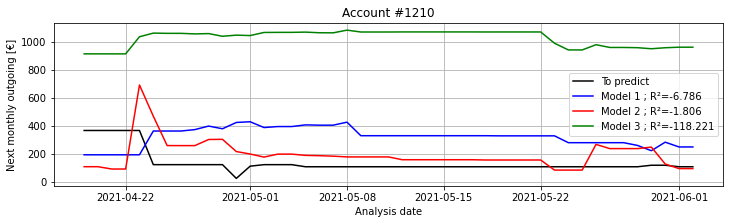

Account #1211


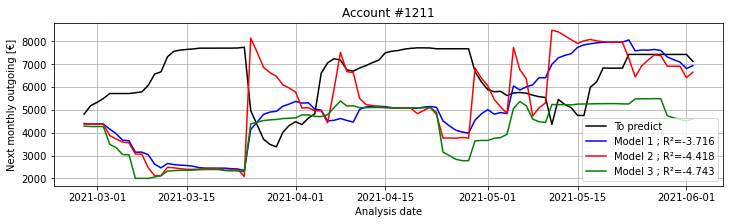

Account #1212


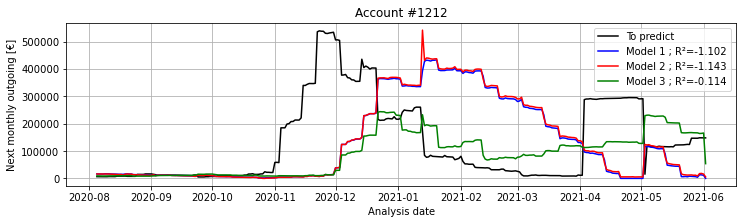

Account #1213


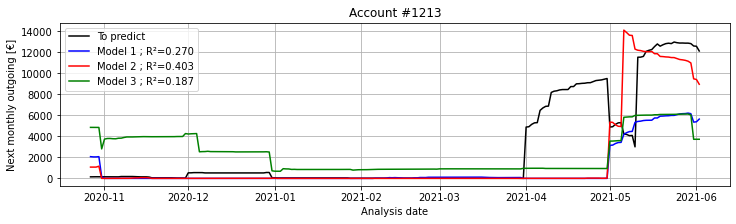

Account #1214


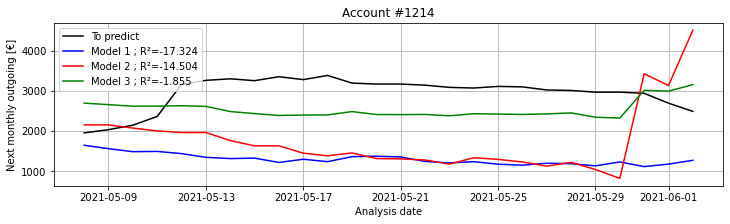

Account #1215


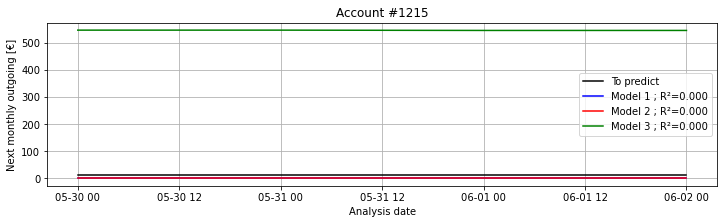

Account #1216


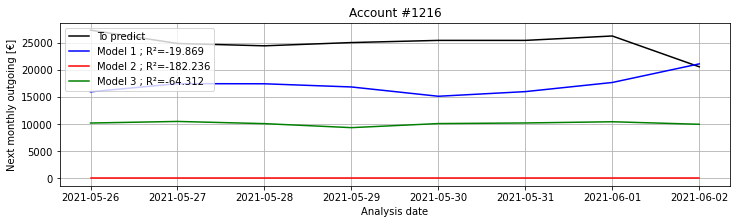

Account #1217


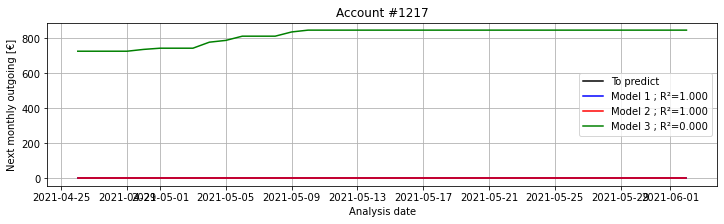

Account #1218


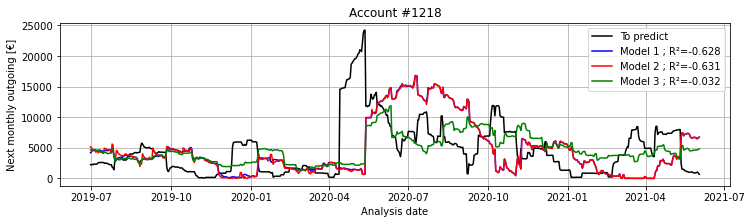

Account #1219


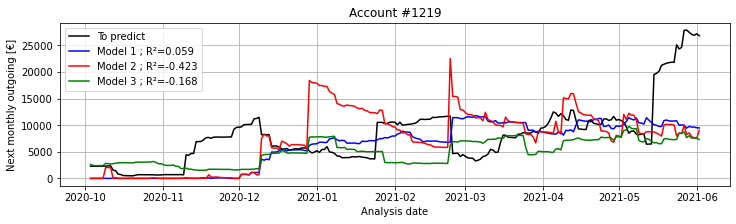

Account #1220


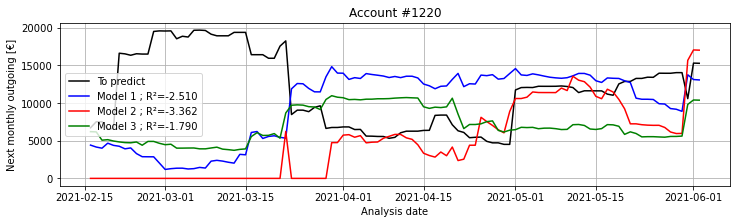

Account #1221


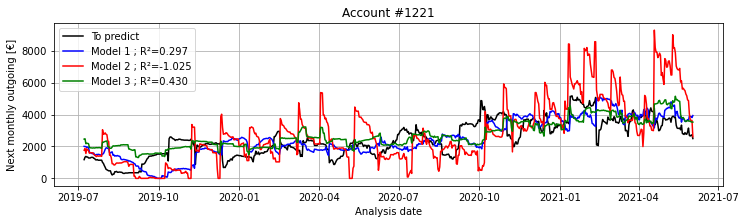

Account #1222
No sufficient history for validation of prediction model
Account #1223


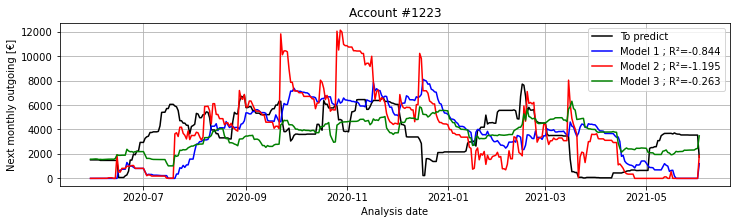

Account #1224


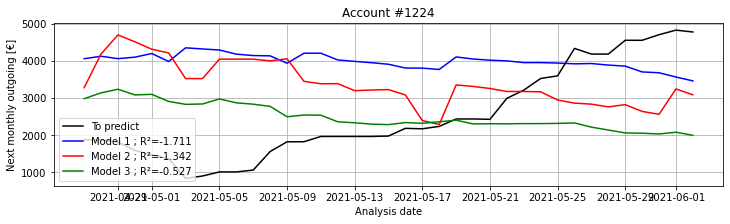

Account #1225


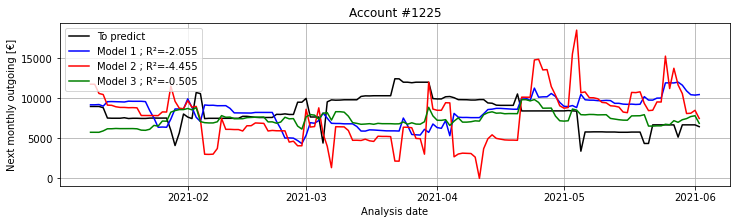

Account #1226


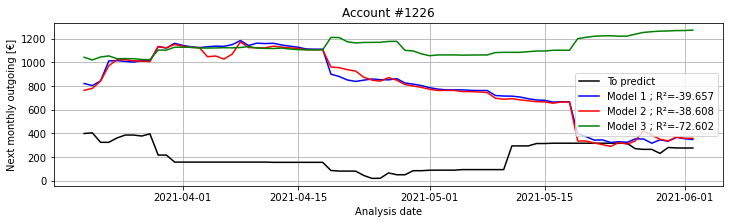

Account #1227


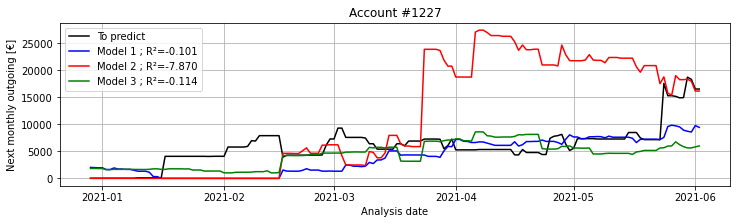

Account #1228


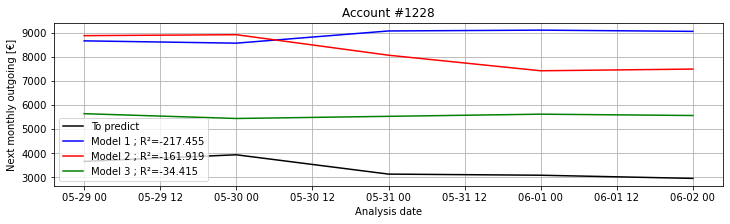

Account #1229


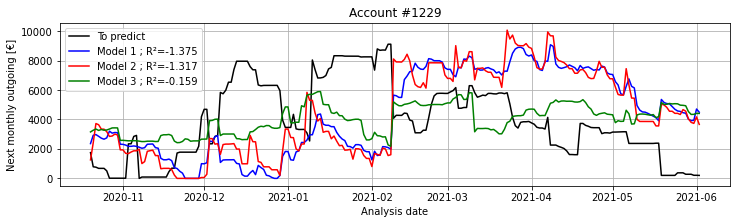

Account #1230


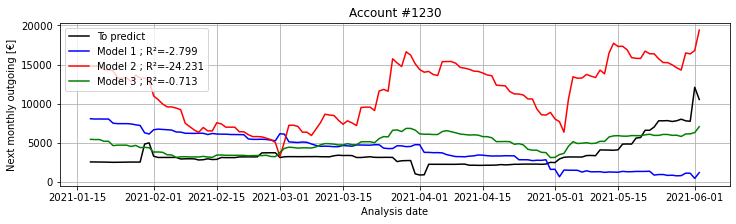

Account #1231
No sufficient history for validation of prediction model
Account #1232


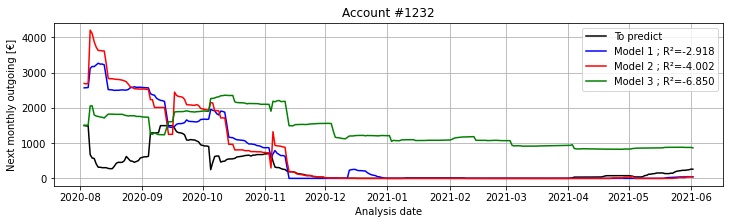

Account #1233


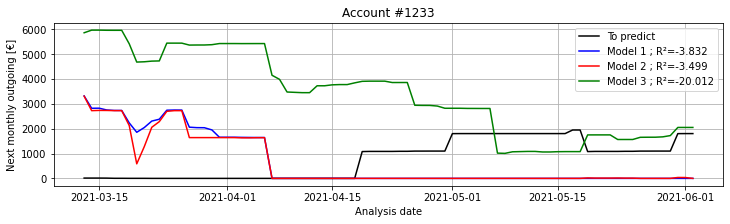

Account #1234


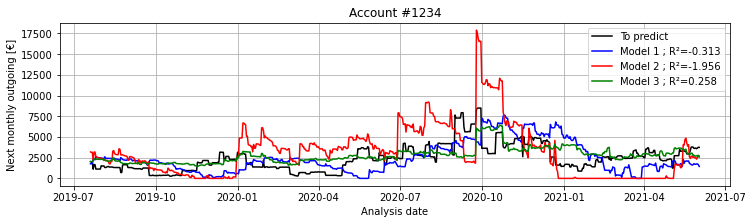

Account #1235


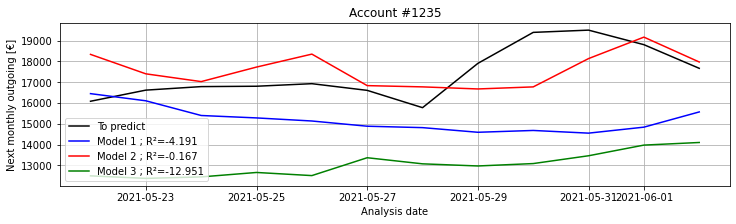

Account #1236
No sufficient history for validation of prediction model
Account #1237


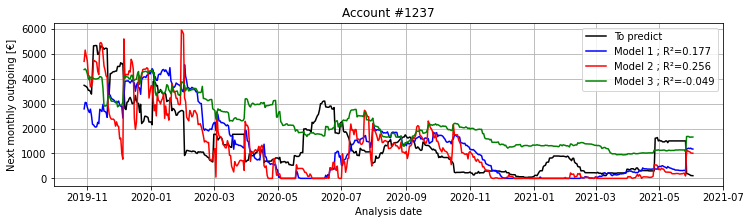

Account #1238


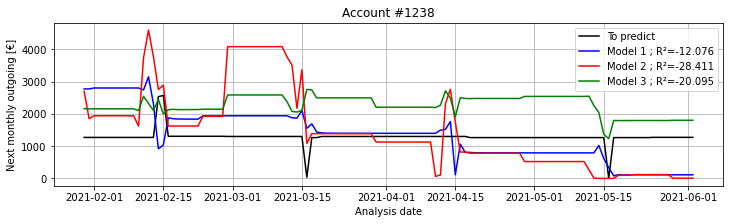

Account #1239
No sufficient history for validation of prediction model
Account #1240


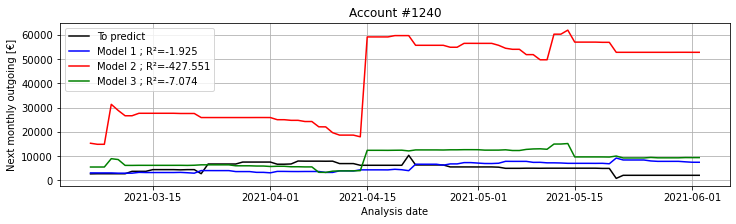

Account #1241


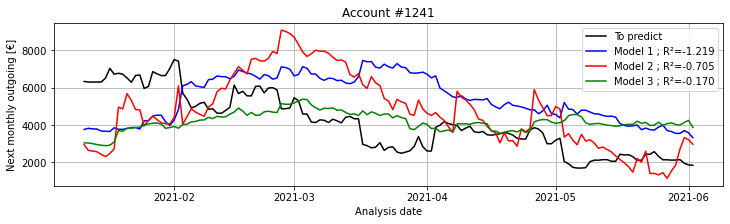

Account #1242


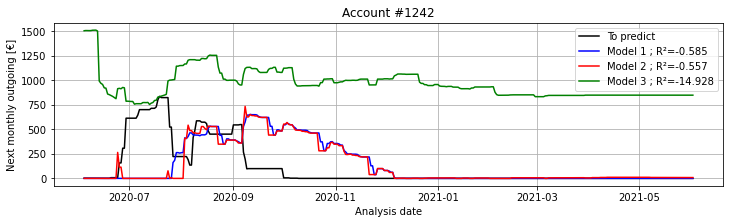

Account #1243


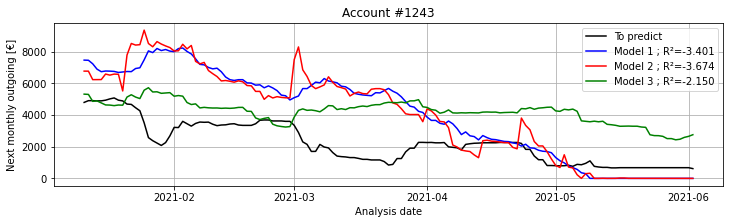

Account #1244


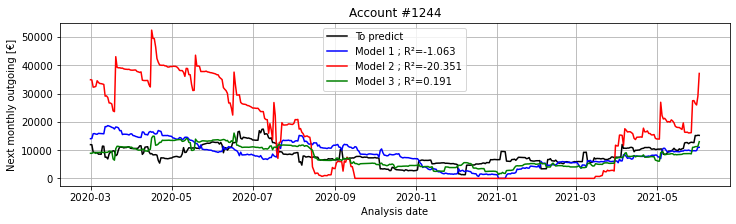

Account #1245


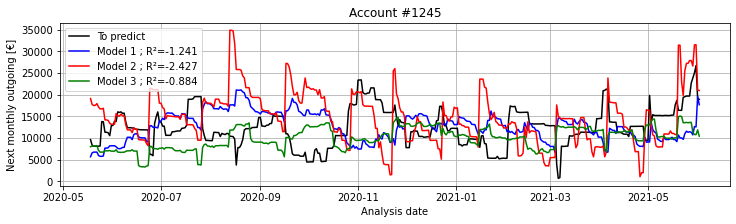

Account #1246


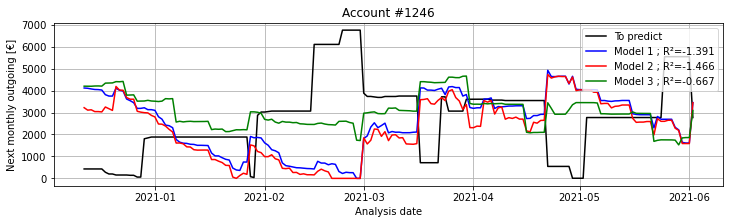

Account #1247


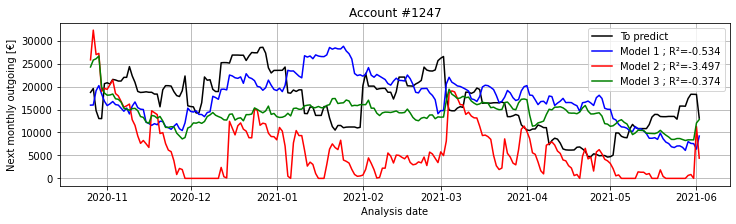

Account #1248


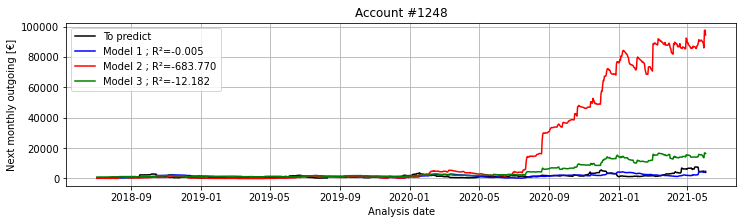

Account #1249


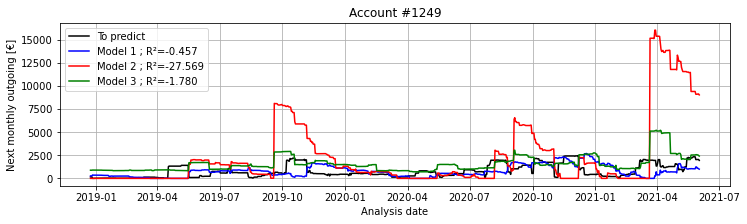

Account #1250


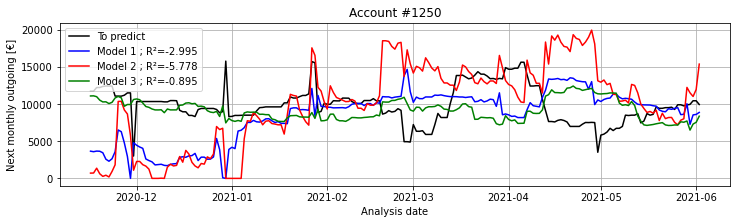

Account #1251


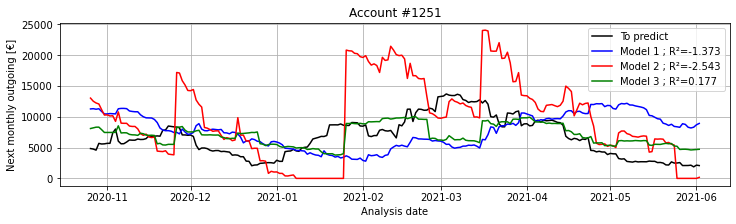

Account #1252


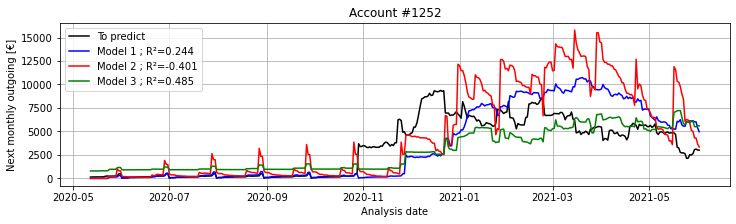

Account #1253


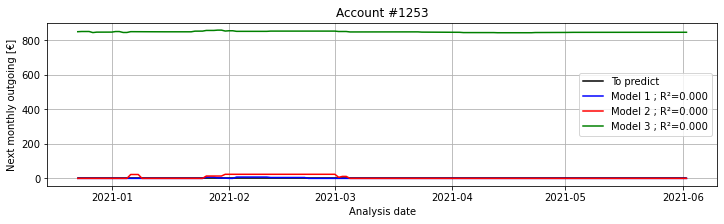

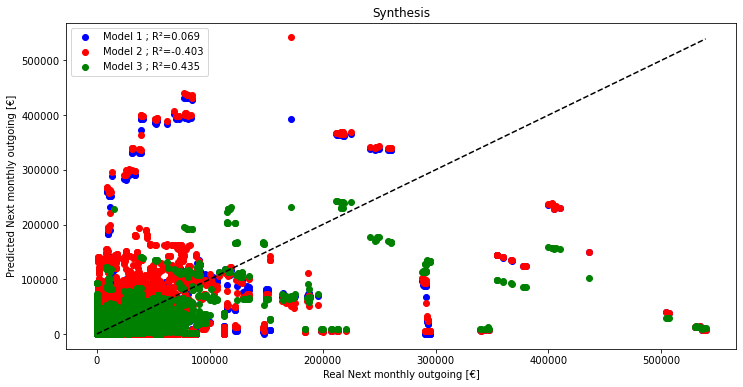

In [4]:
#Initialisation
Y_real=np.array([]) #Real values of next monthly outgoing
Y_predict_mdl_1=np.array([]) #Predicted values of next monthly outgoing by model n°1 (Linear model based on studied account ; Extrapolate outgoing)
Y_predict_mdl_2=np.array([]) #Predicted values of next monthly outgoing by model n°2 (Linear model based on studied account ; Extrapolate income and ensure stable balance)
Y_predict_mdl_3=np.array([]) #Predicted values of next monthly outgoing by model n°3 (Linear model based on large sample of accounts)

#Loop on accounts
for my_id in range(len(accounts.index)):
    print("Account #{}".format(my_id))
    #Account info
    my_account=accounts[accounts.id==my_id]
    #Transactions history
    my_transactions=transactions[transactions.account_id==my_id]
    
    #Account synthesis
    my_account_synthesis=Acc.Account_synthesis(my_account,my_transactions)
    #Get real next monthly outgoing, for all possible analysis date
    X_analysis_date, Y_next_monthly_outgoing = my_account_synthesis.monthly_outgoing_to_predict()
    
    if not(X_analysis_date is None):
        #Loop on analysis date
        Y_mdl_1=np.array([]) #Predicted values, model n°1
        Y_mdl_2=np.array([]) #Predicted values, model n°2
        Y_mdl_3=np.array([]) #Predicted values, model n°3
        for analysis_date in X_analysis_date:
            my_account_synthesis.get_last_6_month(analysis_date)
            Y_mdl_1 = np.hstack((Y_mdl_1,my_account_synthesis.predict_next_monthly_outgoing("Linear model based on studied account ; Extrapolate outgoing")))
            Y_mdl_2 = np.hstack((Y_mdl_2,my_account_synthesis.predict_next_monthly_outgoing("Linear model based on studied account ; Extrapolate income and ensure stable balance")))
            Y_mdl_3 = np.hstack((Y_mdl_3,my_account_synthesis.predict_next_monthly_outgoing("Linear model based on large sample of accounts")))
        
        #R² scores
        R2_score_mdl_1 = metrics.r2_score(Y_next_monthly_outgoing,Y_mdl_1)
        R2_score_mdl_2 = metrics.r2_score(Y_next_monthly_outgoing,Y_mdl_2)
        R2_score_mdl_3 = metrics.r2_score(Y_next_monthly_outgoing,Y_mdl_3)
        
        plt.figure(figsize=(12,3))
        plt.grid()
        plt.plot(X_analysis_date,Y_next_monthly_outgoing,'k-',label="To predict")
        plt.plot(X_analysis_date,Y_mdl_1,'b-',label="Model 1 ; R²={:.3f}".format(R2_score_mdl_1))
        plt.plot(X_analysis_date,Y_mdl_2,'r-',label="Model 2 ; R²={:.3f}".format(R2_score_mdl_2))
        plt.plot(X_analysis_date,Y_mdl_3,'g-',label="Model 3 ; R²={:.3f}".format(R2_score_mdl_3))
        plt.xlabel("Analysis date")
        plt.ylabel("Next monthly outgoing [€]")
        plt.legend()
        plt.title("Account #{:d}".format(my_id))
        plt.show()
        
        #Concatenation of all results
        Y_real = np.hstack((Y_real,Y_next_monthly_outgoing))
        Y_predict_mdl_1 = np.hstack((Y_predict_mdl_1,Y_mdl_1))
        Y_predict_mdl_2 = np.hstack((Y_predict_mdl_2,Y_mdl_2))
        Y_predict_mdl_3 = np.hstack((Y_predict_mdl_3,Y_mdl_3))

#R² scores
R2_score_mdl_1 = metrics.r2_score(Y_real,Y_predict_mdl_1)
R2_score_mdl_2 = metrics.r2_score(Y_real,Y_predict_mdl_2)
R2_score_mdl_3 = metrics.r2_score(Y_real,Y_predict_mdl_3)

#Synthesis plot
plt.figure(figsize=(12,6))
plt.scatter(Y_real,Y_predict_mdl_1,c='b',label="Model 1 ; R²={:.3f}".format(R2_score_mdl_1))
plt.scatter(Y_real,Y_predict_mdl_2,c='r',label="Model 2 ; R²={:.3f}".format(R2_score_mdl_2))
plt.scatter(Y_real,Y_predict_mdl_3,c='g',label="Model 3 ; R²={:.3f}".format(R2_score_mdl_3))
plt.plot(np.array([0,np.amax(Y_real)]),np.array([0,np.amax(Y_real)]),'k--')
plt.xlabel("Real Next monthly outgoing [€]")
plt.ylabel("Predicted Next monthly outgoing [€]")
plt.legend()
plt.title("Synthesis")
plt.show()

> These results show that linear model based on large sample of account is much more better than the 2 other ones
  
Let's compare some other scores

In [6]:
#MAE
print("Mean absolute error - model n°1:",metrics.mean_absolute_error(Y_real,Y_predict_mdl_1))
print("Mean absolute error - model n°2:",metrics.mean_absolute_error(Y_real,Y_predict_mdl_2))
print("Mean absolute error - model n°3:",metrics.mean_absolute_error(Y_real,Y_predict_mdl_3))

Mean absolute error - model n°1: 3121.2342775373677
Mean absolute error - model n°2: 4244.636447480526
Mean absolute error - model n°3: 2732.605064476326


In [7]:
#MAPE
print("Mean absolute percentage error - model n°1:",metrics.mean_absolute_percentage_error(Y_real,Y_predict_mdl_1))
print("Mean absolute percentage error - model n°2:",metrics.mean_absolute_percentage_error(Y_real,Y_predict_mdl_2))
print("Mean absolute percentage error - model n°3:",metrics.mean_absolute_percentage_error(Y_real,Y_predict_mdl_3))


Mean absolute percentage error - model n°1: 1.538830367715074e+17
Mean absolute percentage error - model n°2: 2.1123193360231123e+17
Mean absolute percentage error - model n°3: 4.55559583589583e+17


In [8]:
#MSE
print("Mean squared error - model n°1:",metrics.mean_squared_error(Y_real,Y_predict_mdl_1))
print("Mean squared error - model n°2:",metrics.mean_squared_error(Y_real,Y_predict_mdl_2))
print("Mean squared error - model n°3:",metrics.mean_squared_error(Y_real,Y_predict_mdl_3))

Mean squared error - model n°1: 102357775.25004828
Mean squared error - model n°2: 154194072.49617976
Mean squared error - model n°3: 62153590.400489144


In [9]:
#MSLE
print("Mean squared log error - model n°1:",metrics.mean_squared_log_error(Y_real,Y_predict_mdl_1))
print("Mean squared log error - model n°2:",metrics.mean_squared_log_error(Y_real,Y_predict_mdl_2))
print("Mean squared log error - model n°3:",metrics.mean_squared_log_error(Y_real,Y_predict_mdl_3))

Mean squared log error - model n°1: 5.818249519308603
Mean squared log error - model n°2: 9.464879765682284
Mean squared log error - model n°3: 6.376183283122409


> Based on these score, the best model is not so evident as in the R² score. Even if model 3 is better using a MSE score, model 1 is better using MSLE score. As there are some huge values of monthly outgoing, more difficult to predict, errors on these point will lead to high impact to MSE score, whereas it will no impact a lot the MSLE score.

Let's plot error versus real next monthly outgoing

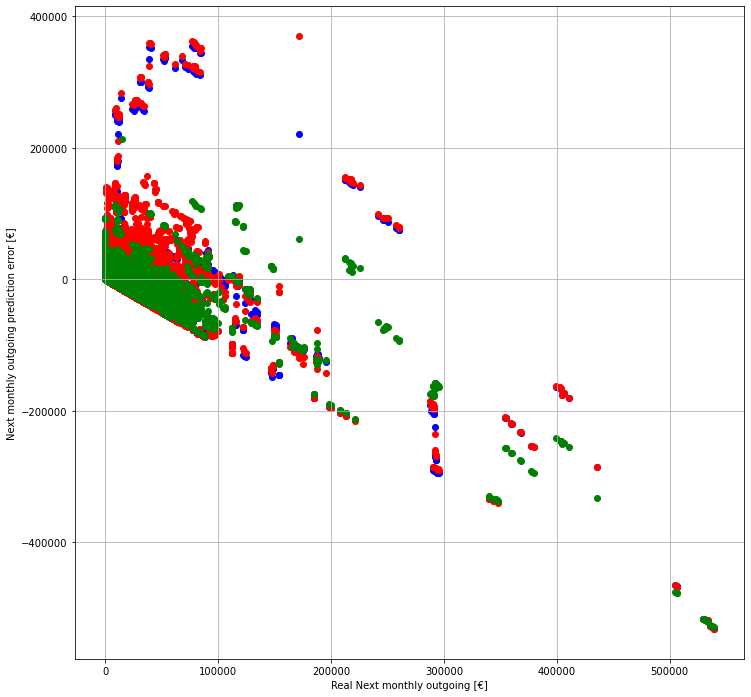

In [15]:
plt.figure(figsize=(12,12))
plt.scatter(Y_real,Y_predict_mdl_1-Y_real,c='b',label="Model 1")
plt.scatter(Y_real,Y_predict_mdl_2-Y_real,c='r',label="Model 2")
plt.scatter(Y_real,Y_predict_mdl_3-Y_real,c='g',label="Model 3")
plt.xlabel("Real Next monthly outgoing [€]")
plt.ylabel("Next monthly outgoing prediction error [€]")
plt.grid()
plt.show()

> Prediction is more and more difficult with higher outgoing

In order to have a better view on model accuracy, we will analyse the error distribution for the 3 models.

In [17]:
# Creation of a DataFrame
err_df=pd.DataFrame({"Absolute error model 1":abs(Y_predict_mdl_1-Y_real),"Absolute error model 2":abs(Y_predict_mdl_2-Y_real),"Absolute error model 3":abs(Y_predict_mdl_3-Y_real)})
err_df.head()

,Absolute error model 1,Absolute error model 2,Absolute error model 3
0,2872.130000,3225.940000,1209.446447
1,1846.190000,2195.253333,1103.436043
2,1448.056667,1695.253333,651.781615
3,1671.920000,1878.710000,809.310639
4,2752.926000,2951.710000,1880.694754


In [18]:
#Statistic analysis
err_df.describe()

,Absolute error model 1,Absolute error model 2,Absolute error model 3
count,224034.000000,224034.000000,224034.000000
mean,3121.234278,4244.636447,2732.605064
std,9623.725123,11669.521917,7395.045913
min,0.000000,0.000000,0.017504
25%,279.117333,310.828000,758.005379
50%,1130.324000,1326.470000,1166.736635
75%,3113.014000,3865.525833,2592.114395
max,532162.917333,532115.953333,529191.093730


> This confirms that there is a match between model 1 and 3 ; 50% of cases are better predicted with model 1 ; model 3 is better is we include 75% of cases and more. Model 3 is better fitted for high monthly outgoing

***
## Conclusion

Difference between a basic linear model based on considered account only (model 1), and a linear model fitted on a large sample of accounts (model 3), is not so big. As model 1 is very easy to fit and interpret, and as it gives better result for more than 50% of cases, we will use it for deployment through FastAPI.  
To improve prediction, we could:
 * See if it's efficient to "filter" transactions (i.e. do not take into account big and ponctual transactions into last 6 months outgoing computation).
 * See if it's possible to obtain data useful for transactions or user classification: it could be used to identify recurrent transactions, build model based on user profile (profession, ...)
 * Test other kind of models